In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

train_file = "train2_50_9.csv"
val_file = "val2_50_9.csv"
matlab_file = 'FD002-9.mat'
rul_file = "rul2_50_SEQ_9.csv"
fleet_Rul_File = "rul2_50_9.csv"
test_file = "test2_50_9.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
#fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

train = pd.read_csv(train_file, index_col=False)
val = pd.read_csv(val_file, index_col=False)
mat = spio.loadmat(matlab_file, squeeze_me=True)

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [8]:
#Load Hyperparameters Obtained by BayesOpt

lr = mat['lr']
ep = mat['ep']
batch = mat['batch']
pad = mat['Pad']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

lr,ep,batch,pad,L2,unit1,size1,drop1

(0.0005807494367923822, 1e-08, 72, 367, 0.0001, 45, 47, 0.050571271067112455)

In [9]:
#Xtrain to Numpy multidimensional array

xtrain_cut = train.drop(['Fleet','Cycle','RUL'], axis=1)
xtrain = np.zeros((train['Fleet'].max(),pad,xtrain_cut.shape[1]))
for i in range(train['Fleet'].max()):
    df_xtrain = train.loc[train['Fleet']==i+1]
    df_xtrain = df_xtrain.drop(['Fleet','Cycle','RUL'], axis=1)
    np_xtrain = df_xtrain.values
    result = np.zeros((pad,df_xtrain.shape[1]))
    result[:np_xtrain.shape[0],:np_xtrain.shape[1]] = np_xtrain
    xtrain[i] = result
xtrain.shape

(260, 367, 9)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain_cut = train[['RUL']]
ytrain = np.zeros((train['Fleet'].max(),pad,1))
for i in range(train['Fleet'].max()):
    df_ytrain = train.loc[train['Fleet']==i+1]
    df_ytrain = df_ytrain[['RUL']]
    np_ytrain = df_ytrain.values
    result = np.zeros((pad,df_ytrain.shape[1]))
    result[:np_ytrain.shape[0],:np_ytrain.shape[1]] = np_ytrain
    ytrain[i] = result
ytrain.shape

(260, 367, 1)

In [11]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros(train['Fleet'].max())
for i in range(train['Fleet'].max()):
    df_ytrain2 = train.loc[train['Fleet']==i+1]
    df_ytrain2 = df_ytrain2[['RUL']].values
    ytrain2[i] = df_ytrain2[0]
ytrain2.shape

(260,)

In [12]:
#Xval to Numpy multidimensional array

xval_cut = val.drop(['RUL','Fleet','Cycle'], axis=1)
xval = np.zeros((val['Fleet'].max(),pad,xval_cut.shape[1]))
for i in range(val['Fleet'].max()):
    df_xval = val.loc[val['Fleet']==i+1]
    df_xval = df_xval.drop(['Fleet','Cycle','RUL'], axis=1)
    np_xval = df_xval.values
    result = np.zeros((pad,df_xval.shape[1]))
    result[:np_xval.shape[0],:np_xval.shape[1]] = np_xval
    xval[i] = result
xval.shape

(260, 367, 9)

In [13]:
#Yval to Numpy multidimensional array - for sequential prediction 

yval_cut = val[['RUL']]
yval = np.zeros((val['Fleet'].max(),pad,1))
for i in range(val['Fleet'].max()):
    df_yval = val.loc[val['Fleet']==i+1]
    df_yval = df_yval[['RUL']]
    np_yval = df_yval.values
    result = np.zeros((pad,df_yval.shape[1]))
    result[:np_yval.shape[0],:np_yval.shape[1]] = np_yval
    yval[i] = result
yval.shape

(260, 367, 1)

In [14]:
#Yval2 to Numpy multidimensional array - for SHAP 

yval2 = np.zeros(train['Fleet'].max())
for i in range(train['Fleet'].max()):
    df_yval2 = train.loc[train['Fleet']==i+1]
    df_yval2 = df_yval2[['RUL']].values
    yval2[i] = df_yval2[0]
yval2.shape

(260,)

In [15]:
#xtest to Numpy multidimensional array 

test = pd.read_csv(test_file, index_col=False)
xtest_cut = test.drop(['Fleet','Cycle'], axis=1)
xtest = np.zeros((test['Fleet'].max(),pad,xtest_cut.shape[1]))
for i in range(test['Fleet'].max()):
    df_xtest = test.loc[test['Fleet']==i+1]
    df_xtest = df_xtest.drop(['Fleet','Cycle'], axis=1)
    np_xtest = df_xtest.values
    result = np.zeros((pad,df_xtest.shape[1]))
    result[:np_xtest.shape[0],:np_xtest.shape[1]] = np_xtest
    xtest[i] = result

In [16]:
#Verify shapes of array

xtrain.shape,ytrain.shape, ytrain2.shape,xval.shape,yval.shape,yval2.shape,xtest.shape

((260, 367, 9),
 (260, 367, 1),
 (260,),
 (260, 367, 9),
 (260, 367, 1),
 (260,),
 (259, 367, 9))

In [17]:
xtrain = xtrain.astype(np.float32)
ytrain = ytrain.astype(np.float32)
ytrain2 = ytrain2.astype(np.float32)
xval = xval.astype(np.float32)
yval = yval.astype(np.float32)
yval2 = yval2.astype(np.float32)
xtest = xtest.astype(np.float32)

In [18]:
#Set ytrain,yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain,ytrain2]
x_val = xval
y_val = [yval,yval,yval2]
x_test = xtest

In [19]:
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display

In [20]:
# Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

#Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [21]:
#Define probabilistic LSTM

#LSTM layers

inputs = tf.keras.Input(shape=(pad,9),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

#Output 3 = Slicer output layer

layer7 = Dense(1)(layer2)
layer8 = Lambda(lambda t: t[:,-1],name='out3')(layer7)

model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6,layer8])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 367, 9)]     0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 367, 45)      9900        input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 367, 47)      2162        lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 367, 2)       96          dense[0][0]                      
_______________________________________________________________________________________

In [22]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint/2_50_9_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [23]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik,'out3':'mean_squared_error'},loss_weights=[0.5,0.5,0],optimizer= 'Adam')

In [24]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
#Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [25]:
#Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 181.17687, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_9_ckpt

Epoch 00002: val_loss improved from 181.17687 to 174.19749, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_9_ckpt

Epoch 00003: val_loss improved from 174.19749 to 170.85557, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_9_ckpt

Epoch 00004: val_loss improved from 170.85557 to 162.66462, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_9_ckpt

Epoc


Epoch 00070: val_loss improved from 26.74206 to 24.01569, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_9_ckpt

Epoch 00071: val_loss did not improve from 24.01569

Epoch 00072: val_loss improved from 24.01569 to 21.48690, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_9_ckpt

Epoch 00073: val_loss did not improve from 21.48690

Epoch 00074: val_loss did not improve from 21.48690

Epoch 00075: val_loss did not improve from 21.48690

Epoch 00076: val_loss did not improve from 21.48690

Epoch 00077: val_loss did not improve from 21.48690

Epoch 00078: val_loss did not improve from 21.48690

Epoch 00079: val_loss did not improve from 21.48690

Epoch 00080: val_loss did not improve from 21.48690

Epoch 00081: val_loss did not improve from 21.48690

Epoch 00082: val_loss did not i


Epoch 00197: val_loss did not improve from 13.56136

Epoch 00198: val_loss did not improve from 13.56136

Epoch 00199: val_loss did not improve from 13.56136

Epoch 00200: val_loss did not improve from 13.56136

Epoch 00201: val_loss did not improve from 13.56136

Epoch 00202: val_loss did not improve from 13.56136

Epoch 00203: val_loss did not improve from 13.56136

Epoch 00204: val_loss did not improve from 13.56136

Epoch 00205: val_loss did not improve from 13.56136

Epoch 00206: val_loss did not improve from 13.56136

Epoch 00207: val_loss did not improve from 13.56136

Epoch 00208: val_loss did not improve from 13.56136

Epoch 00209: val_loss did not improve from 13.56136

Epoch 00210: val_loss did not improve from 13.56136

Epoch 00211: val_loss did not improve from 13.56136

Epoch 00212: val_loss did not improve from 13.56136

Epoch 00213: val_loss did not improve from 13.56136

Epoch 00214: val_loss did not improve from 13.56136

Epoch 00215: val_loss did not improve from 13


Epoch 00330: val_loss did not improve from 10.73417

Epoch 00331: val_loss did not improve from 10.73417

Epoch 00332: val_loss did not improve from 10.73417

Epoch 00333: val_loss did not improve from 10.73417

Epoch 00334: val_loss did not improve from 10.73417

Epoch 00335: val_loss did not improve from 10.73417

Epoch 00336: val_loss did not improve from 10.73417

Epoch 00337: val_loss did not improve from 10.73417

Epoch 00338: val_loss did not improve from 10.73417

Epoch 00339: val_loss did not improve from 10.73417

Epoch 00340: val_loss did not improve from 10.73417

Epoch 00341: val_loss did not improve from 10.73417

Epoch 00342: val_loss did not improve from 10.73417

Epoch 00343: val_loss did not improve from 10.73417

Epoch 00344: val_loss did not improve from 10.73417

Epoch 00345: val_loss did not improve from 10.73417

Epoch 00346: val_loss did not improve from 10.73417

Epoch 00347: val_loss did not improve from 10.73417

Epoch 00348: val_loss did not improve from 10


Epoch 00471: val_loss did not improve from 9.13038

Epoch 00472: val_loss did not improve from 9.13038

Epoch 00473: val_loss did not improve from 9.13038

Epoch 00474: val_loss did not improve from 9.13038

Epoch 00475: val_loss did not improve from 9.13038

Epoch 00476: val_loss did not improve from 9.13038

Epoch 00477: val_loss did not improve from 9.13038

Epoch 00478: val_loss did not improve from 9.13038

Epoch 00479: val_loss did not improve from 9.13038

Epoch 00480: val_loss did not improve from 9.13038

Epoch 00481: val_loss did not improve from 9.13038

Epoch 00482: val_loss did not improve from 9.13038

Epoch 00483: val_loss did not improve from 9.13038

Epoch 00484: val_loss did not improve from 9.13038

Epoch 00485: val_loss did not improve from 9.13038

Epoch 00486: val_loss did not improve from 9.13038

Epoch 00487: val_loss did not improve from 9.13038

Epoch 00488: val_loss did not improve from 9.13038

Epoch 00489: val_loss did not improve from 9.13038

Epoch 00490


Epoch 00616: val_loss did not improve from 8.05682

Epoch 00617: val_loss did not improve from 8.05682

Epoch 00618: val_loss did not improve from 8.05682

Epoch 00619: val_loss did not improve from 8.05682

Epoch 00620: val_loss did not improve from 8.05682

Epoch 00621: val_loss did not improve from 8.05682

Epoch 00622: val_loss did not improve from 8.05682

Epoch 00623: val_loss did not improve from 8.05682

Epoch 00624: val_loss did not improve from 8.05682

Epoch 00625: val_loss did not improve from 8.05682

Epoch 00626: val_loss did not improve from 8.05682

Epoch 00627: val_loss did not improve from 8.05682

Epoch 00628: val_loss did not improve from 8.05682

Epoch 00629: val_loss did not improve from 8.05682

Epoch 00630: val_loss did not improve from 8.05682

Epoch 00631: val_loss did not improve from 8.05682

Epoch 00632: val_loss improved from 8.05682 to 7.89607, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turb


Epoch 00768: val_loss improved from 7.45214 to 7.41711, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_9_ckpt

Epoch 00769: val_loss did not improve from 7.41711

Epoch 00770: val_loss did not improve from 7.41711

Epoch 00771: val_loss did not improve from 7.41711

Epoch 00772: val_loss did not improve from 7.41711

Epoch 00773: val_loss did not improve from 7.41711

Epoch 00774: val_loss did not improve from 7.41711

Epoch 00775: val_loss did not improve from 7.41711

Epoch 00776: val_loss did not improve from 7.41711

Epoch 00777: val_loss did not improve from 7.41711

Epoch 00778: val_loss did not improve from 7.41711

Epoch 00779: val_loss did not improve from 7.41711

Epoch 00780: val_loss did not improve from 7.41711

Epoch 00781: val_loss did not improve from 7.41711

Epoch 00782: val_loss did not improve from 7.41711

Epoch 00783: val_loss did not improve from 7.41711

Ep


Epoch 00920: val_loss did not improve from 6.62551

Epoch 00921: val_loss did not improve from 6.62551

Epoch 00922: val_loss did not improve from 6.62551

Epoch 00923: val_loss did not improve from 6.62551

Epoch 00924: val_loss did not improve from 6.62551

Epoch 00925: val_loss did not improve from 6.62551

Epoch 00926: val_loss did not improve from 6.62551

Epoch 00927: val_loss did not improve from 6.62551

Epoch 00928: val_loss did not improve from 6.62551

Epoch 00929: val_loss did not improve from 6.62551

Epoch 00930: val_loss did not improve from 6.62551

Epoch 00931: val_loss did not improve from 6.62551

Epoch 00932: val_loss did not improve from 6.62551

Epoch 00933: val_loss did not improve from 6.62551

Epoch 00934: val_loss did not improve from 6.62551

Epoch 00935: val_loss did not improve from 6.62551

Epoch 00936: val_loss did not improve from 6.62551

Epoch 00937: val_loss did not improve from 6.62551

Epoch 00938: val_loss did not improve from 6.62551

Epoch 00939


Epoch 01078: val_loss did not improve from 6.62551

Epoch 01079: val_loss did not improve from 6.62551

Epoch 01080: val_loss did not improve from 6.62551

Epoch 01081: val_loss did not improve from 6.62551

Epoch 01082: val_loss did not improve from 6.62551

Epoch 01083: val_loss did not improve from 6.62551

Epoch 01084: val_loss did not improve from 6.62551

Epoch 01085: val_loss did not improve from 6.62551

Epoch 01086: val_loss did not improve from 6.62551

Epoch 01087: val_loss did not improve from 6.62551

Epoch 01088: val_loss did not improve from 6.62551

Epoch 01089: val_loss did not improve from 6.62551

Epoch 01090: val_loss did not improve from 6.62551

Epoch 01091: val_loss did not improve from 6.62551

Epoch 01092: val_loss did not improve from 6.62551

Epoch 01093: val_loss did not improve from 6.62551

Epoch 01094: val_loss did not improve from 6.62551

Epoch 01095: val_loss did not improve from 6.62551

Epoch 01096: val_loss did not improve from 6.62551

Epoch 01097


Epoch 01233: val_loss did not improve from 6.28027

Epoch 01234: val_loss did not improve from 6.28027

Epoch 01235: val_loss did not improve from 6.28027

Epoch 01236: val_loss did not improve from 6.28027

Epoch 01237: val_loss did not improve from 6.28027

Epoch 01238: val_loss did not improve from 6.28027

Epoch 01239: val_loss did not improve from 6.28027

Epoch 01240: val_loss did not improve from 6.28027

Epoch 01241: val_loss did not improve from 6.28027

Epoch 01242: val_loss did not improve from 6.28027

Epoch 01243: val_loss did not improve from 6.28027

Epoch 01244: val_loss did not improve from 6.28027

Epoch 01245: val_loss did not improve from 6.28027

Epoch 01246: val_loss did not improve from 6.28027

Epoch 01247: val_loss did not improve from 6.28027

Epoch 01248: val_loss did not improve from 6.28027

Epoch 01249: val_loss did not improve from 6.28027

Epoch 01250: val_loss did not improve from 6.28027

Epoch 01251: val_loss did not improve from 6.28027

Epoch 01252


Epoch 01391: val_loss did not improve from 6.28027

Epoch 01392: val_loss did not improve from 6.28027

Epoch 01393: val_loss did not improve from 6.28027

Epoch 01394: val_loss did not improve from 6.28027

Epoch 01395: val_loss did not improve from 6.28027

Epoch 01396: val_loss did not improve from 6.28027

Epoch 01397: val_loss did not improve from 6.28027

Epoch 01398: val_loss did not improve from 6.28027

Epoch 01399: val_loss did not improve from 6.28027

Epoch 01400: val_loss did not improve from 6.28027

Epoch 01401: val_loss did not improve from 6.28027

Epoch 01402: val_loss did not improve from 6.28027

Epoch 01403: val_loss did not improve from 6.28027

Epoch 01404: val_loss did not improve from 6.28027

Epoch 01405: val_loss did not improve from 6.28027

Epoch 01406: val_loss did not improve from 6.28027

Epoch 01407: val_loss did not improve from 6.28027

Epoch 01408: val_loss did not improve from 6.28027

Epoch 01409: val_loss did not improve from 6.28027

Epoch 01410


Epoch 01549: val_loss did not improve from 6.28027

Epoch 01550: val_loss did not improve from 6.28027

Epoch 01551: val_loss did not improve from 6.28027

Epoch 01552: val_loss did not improve from 6.28027

Epoch 01553: val_loss did not improve from 6.28027

Epoch 01554: val_loss did not improve from 6.28027

Epoch 01555: val_loss did not improve from 6.28027

Epoch 01556: val_loss did not improve from 6.28027

Epoch 01557: val_loss did not improve from 6.28027

Epoch 01558: val_loss did not improve from 6.28027

Epoch 01559: val_loss did not improve from 6.28027

Epoch 01560: val_loss did not improve from 6.28027

Epoch 01561: val_loss did not improve from 6.28027

Epoch 01562: val_loss did not improve from 6.28027

Epoch 01563: val_loss did not improve from 6.28027

Epoch 01564: val_loss did not improve from 6.28027

Epoch 01565: val_loss did not improve from 6.28027

Epoch 01566: val_loss did not improve from 6.28027

Epoch 01567: val_loss did not improve from 6.28027

Epoch 01568


Epoch 01707: val_loss did not improve from 6.28027

Epoch 01708: val_loss did not improve from 6.28027

Epoch 01709: val_loss did not improve from 6.28027

Epoch 01710: val_loss did not improve from 6.28027

Epoch 01711: val_loss did not improve from 6.28027

Epoch 01712: val_loss did not improve from 6.28027

Epoch 01713: val_loss did not improve from 6.28027

Epoch 01714: val_loss did not improve from 6.28027

Epoch 01715: val_loss did not improve from 6.28027

Epoch 01716: val_loss did not improve from 6.28027

Epoch 01717: val_loss did not improve from 6.28027

Epoch 01718: val_loss did not improve from 6.28027

Epoch 01719: val_loss did not improve from 6.28027

Epoch 01720: val_loss did not improve from 6.28027

Epoch 01721: val_loss did not improve from 6.28027

Epoch 01722: val_loss did not improve from 6.28027

Epoch 01723: val_loss did not improve from 6.28027

Epoch 01724: val_loss did not improve from 6.28027

Epoch 01725: val_loss did not improve from 6.28027

Epoch 01726


Epoch 01865: val_loss did not improve from 6.28027

Epoch 01866: val_loss did not improve from 6.28027

Epoch 01867: val_loss did not improve from 6.28027

Epoch 01868: val_loss did not improve from 6.28027

Epoch 01869: val_loss did not improve from 6.28027

Epoch 01870: val_loss did not improve from 6.28027

Epoch 01871: val_loss did not improve from 6.28027

Epoch 01872: val_loss did not improve from 6.28027

Epoch 01873: val_loss did not improve from 6.28027

Epoch 01874: val_loss did not improve from 6.28027

Epoch 01875: val_loss did not improve from 6.28027

Epoch 01876: val_loss did not improve from 6.28027

Epoch 01877: val_loss did not improve from 6.28027

Epoch 01878: val_loss did not improve from 6.28027

Epoch 01879: val_loss did not improve from 6.28027

Epoch 01880: val_loss did not improve from 6.28027

Epoch 01881: val_loss did not improve from 6.28027

Epoch 01882: val_loss did not improve from 6.28027

Epoch 01883: val_loss did not improve from 6.28027

Epoch 01884


Epoch 02020: val_loss did not improve from 6.27714

Epoch 02021: val_loss did not improve from 6.27714

Epoch 02022: val_loss did not improve from 6.27714

Epoch 02023: val_loss did not improve from 6.27714

Epoch 02024: val_loss did not improve from 6.27714

Epoch 02025: val_loss did not improve from 6.27714

Epoch 02026: val_loss did not improve from 6.27714

Epoch 02027: val_loss did not improve from 6.27714

Epoch 02028: val_loss did not improve from 6.27714

Epoch 02029: val_loss did not improve from 6.27714

Epoch 02030: val_loss did not improve from 6.27714

Epoch 02031: val_loss did not improve from 6.27714

Epoch 02032: val_loss did not improve from 6.27714

Epoch 02033: val_loss did not improve from 6.27714

Epoch 02034: val_loss did not improve from 6.27714

Epoch 02035: val_loss did not improve from 6.27714

Epoch 02036: val_loss did not improve from 6.27714

Epoch 02037: val_loss did not improve from 6.27714

Epoch 02038: val_loss did not improve from 6.27714

Epoch 02039


Epoch 02175: val_loss did not improve from 6.26894

Epoch 02176: val_loss did not improve from 6.26894

Epoch 02177: val_loss did not improve from 6.26894

Epoch 02178: val_loss did not improve from 6.26894

Epoch 02179: val_loss did not improve from 6.26894

Epoch 02180: val_loss did not improve from 6.26894

Epoch 02181: val_loss did not improve from 6.26894

Epoch 02182: val_loss did not improve from 6.26894

Epoch 02183: val_loss did not improve from 6.26894

Epoch 02184: val_loss did not improve from 6.26894

Epoch 02185: val_loss did not improve from 6.26894

Epoch 02186: val_loss did not improve from 6.26894

Epoch 02187: val_loss did not improve from 6.26894

Epoch 02188: val_loss did not improve from 6.26894

Epoch 02189: val_loss did not improve from 6.26894

Epoch 02190: val_loss did not improve from 6.26894

Epoch 02191: val_loss did not improve from 6.26894

Epoch 02192: val_loss did not improve from 6.26894

Epoch 02193: val_loss did not improve from 6.26894

Epoch 02194


Epoch 02333: val_loss did not improve from 6.26894

Epoch 02334: val_loss did not improve from 6.26894

Epoch 02335: val_loss did not improve from 6.26894

Epoch 02336: val_loss did not improve from 6.26894

Epoch 02337: val_loss did not improve from 6.26894

Epoch 02338: val_loss did not improve from 6.26894

Epoch 02339: val_loss did not improve from 6.26894

Epoch 02340: val_loss did not improve from 6.26894

Epoch 02341: val_loss did not improve from 6.26894

Epoch 02342: val_loss did not improve from 6.26894

Epoch 02343: val_loss did not improve from 6.26894

Epoch 02344: val_loss did not improve from 6.26894

Epoch 02345: val_loss did not improve from 6.26894

Epoch 02346: val_loss did not improve from 6.26894

Epoch 02347: val_loss did not improve from 6.26894

Epoch 02348: val_loss did not improve from 6.26894

Epoch 02349: val_loss did not improve from 6.26894

Epoch 02350: val_loss did not improve from 6.26894

Epoch 02351: val_loss did not improve from 6.26894

Epoch 02352


Epoch 02485: val_loss did not improve from 5.72230

Epoch 02486: val_loss did not improve from 5.72230

Epoch 02487: val_loss did not improve from 5.72230

Epoch 02488: val_loss did not improve from 5.72230

Epoch 02489: val_loss did not improve from 5.72230

Epoch 02490: val_loss did not improve from 5.72230

Epoch 02491: val_loss did not improve from 5.72230

Epoch 02492: val_loss did not improve from 5.72230

Epoch 02493: val_loss did not improve from 5.72230

Epoch 02494: val_loss did not improve from 5.72230

Epoch 02495: val_loss did not improve from 5.72230

Epoch 02496: val_loss did not improve from 5.72230

Epoch 02497: val_loss did not improve from 5.72230

Epoch 02498: val_loss did not improve from 5.72230

Epoch 02499: val_loss did not improve from 5.72230

Epoch 02500: val_loss did not improve from 5.72230

Epoch 02501: val_loss did not improve from 5.72230

Epoch 02502: val_loss did not improve from 5.72230

Epoch 02503: val_loss did not improve from 5.72230

Epoch 02504


Epoch 02643: val_loss did not improve from 5.72230

Epoch 02644: val_loss did not improve from 5.72230

Epoch 02645: val_loss did not improve from 5.72230

Epoch 02646: val_loss did not improve from 5.72230

Epoch 02647: val_loss did not improve from 5.72230

Epoch 02648: val_loss did not improve from 5.72230

Epoch 02649: val_loss did not improve from 5.72230

Epoch 02650: val_loss did not improve from 5.72230

Epoch 02651: val_loss did not improve from 5.72230

Epoch 02652: val_loss did not improve from 5.72230

Epoch 02653: val_loss did not improve from 5.72230

Epoch 02654: val_loss did not improve from 5.72230

Epoch 02655: val_loss did not improve from 5.72230

Epoch 02656: val_loss did not improve from 5.72230

Epoch 02657: val_loss did not improve from 5.72230

Epoch 02658: val_loss did not improve from 5.72230

Epoch 02659: val_loss did not improve from 5.72230

Epoch 02660: val_loss did not improve from 5.72230

Epoch 02661: val_loss did not improve from 5.72230

Epoch 02662


Epoch 02798: val_loss did not improve from 5.60177

Epoch 02799: val_loss did not improve from 5.60177

Epoch 02800: val_loss did not improve from 5.60177

Epoch 02801: val_loss did not improve from 5.60177

Epoch 02802: val_loss did not improve from 5.60177

Epoch 02803: val_loss did not improve from 5.60177

Epoch 02804: val_loss did not improve from 5.60177

Epoch 02805: val_loss did not improve from 5.60177

Epoch 02806: val_loss did not improve from 5.60177

Epoch 02807: val_loss did not improve from 5.60177

Epoch 02808: val_loss did not improve from 5.60177

Epoch 02809: val_loss did not improve from 5.60177

Epoch 02810: val_loss did not improve from 5.60177

Epoch 02811: val_loss did not improve from 5.60177

Epoch 02812: val_loss did not improve from 5.60177

Epoch 02813: val_loss did not improve from 5.60177

Epoch 02814: val_loss did not improve from 5.60177

Epoch 02815: val_loss did not improve from 5.60177

Epoch 02816: val_loss did not improve from 5.60177

Epoch 02817


Epoch 02950: val_loss did not improve from 5.52278

Epoch 02951: val_loss did not improve from 5.52278

Epoch 02952: val_loss did not improve from 5.52278

Epoch 02953: val_loss did not improve from 5.52278

Epoch 02954: val_loss did not improve from 5.52278

Epoch 02955: val_loss did not improve from 5.52278

Epoch 02956: val_loss did not improve from 5.52278

Epoch 02957: val_loss did not improve from 5.52278

Epoch 02958: val_loss did not improve from 5.52278

Epoch 02959: val_loss did not improve from 5.52278

Epoch 02960: val_loss did not improve from 5.52278

Epoch 02961: val_loss did not improve from 5.52278

Epoch 02962: val_loss did not improve from 5.52278

Epoch 02963: val_loss did not improve from 5.52278

Epoch 02964: val_loss did not improve from 5.52278

Epoch 02965: val_loss did not improve from 5.52278

Epoch 02966: val_loss did not improve from 5.52278

Epoch 02967: val_loss did not improve from 5.52278

Epoch 02968: val_loss did not improve from 5.52278

Epoch 02969


Epoch 03105: val_loss did not improve from 5.40292

Epoch 03106: val_loss did not improve from 5.40292

Epoch 03107: val_loss did not improve from 5.40292

Epoch 03108: val_loss did not improve from 5.40292

Epoch 03109: val_loss did not improve from 5.40292

Epoch 03110: val_loss did not improve from 5.40292

Epoch 03111: val_loss did not improve from 5.40292

Epoch 03112: val_loss did not improve from 5.40292

Epoch 03113: val_loss did not improve from 5.40292

Epoch 03114: val_loss did not improve from 5.40292

Epoch 03115: val_loss did not improve from 5.40292

Epoch 03116: val_loss did not improve from 5.40292

Epoch 03117: val_loss did not improve from 5.40292

Epoch 03118: val_loss did not improve from 5.40292

Epoch 03119: val_loss did not improve from 5.40292

Epoch 03120: val_loss did not improve from 5.40292

Epoch 03121: val_loss did not improve from 5.40292

Epoch 03122: val_loss did not improve from 5.40292

Epoch 03123: val_loss did not improve from 5.40292

Epoch 03124


Epoch 03260: val_loss did not improve from 5.25636

Epoch 03261: val_loss did not improve from 5.25636

Epoch 03262: val_loss did not improve from 5.25636

Epoch 03263: val_loss did not improve from 5.25636

Epoch 03264: val_loss did not improve from 5.25636

Epoch 03265: val_loss did not improve from 5.25636

Epoch 03266: val_loss did not improve from 5.25636

Epoch 03267: val_loss did not improve from 5.25636

Epoch 03268: val_loss did not improve from 5.25636

Epoch 03269: val_loss did not improve from 5.25636

Epoch 03270: val_loss did not improve from 5.25636

Epoch 03271: val_loss did not improve from 5.25636

Epoch 03272: val_loss did not improve from 5.25636

Epoch 03273: val_loss did not improve from 5.25636

Epoch 03274: val_loss did not improve from 5.25636

Epoch 03275: val_loss did not improve from 5.25636

Epoch 03276: val_loss did not improve from 5.25636

Epoch 03277: val_loss did not improve from 5.25636

Epoch 03278: val_loss did not improve from 5.25636

Epoch 03279


Epoch 03418: val_loss did not improve from 5.25636

Epoch 03419: val_loss did not improve from 5.25636

Epoch 03420: val_loss did not improve from 5.25636

Epoch 03421: val_loss did not improve from 5.25636

Epoch 03422: val_loss did not improve from 5.25636

Epoch 03423: val_loss did not improve from 5.25636

Epoch 03424: val_loss did not improve from 5.25636

Epoch 03425: val_loss did not improve from 5.25636

Epoch 03426: val_loss did not improve from 5.25636

Epoch 03427: val_loss did not improve from 5.25636

Epoch 03428: val_loss did not improve from 5.25636

Epoch 03429: val_loss did not improve from 5.25636

Epoch 03430: val_loss did not improve from 5.25636

Epoch 03431: val_loss did not improve from 5.25636

Epoch 03432: val_loss did not improve from 5.25636

Epoch 03433: val_loss did not improve from 5.25636

Epoch 03434: val_loss did not improve from 5.25636

Epoch 03435: val_loss did not improve from 5.25636

Epoch 03436: val_loss did not improve from 5.25636

Epoch 03437


Epoch 03573: val_loss did not improve from 5.14651

Epoch 03574: val_loss did not improve from 5.14651

Epoch 03575: val_loss did not improve from 5.14651

Epoch 03576: val_loss did not improve from 5.14651

Epoch 03577: val_loss did not improve from 5.14651

Epoch 03578: val_loss did not improve from 5.14651

Epoch 03579: val_loss did not improve from 5.14651

Epoch 03580: val_loss did not improve from 5.14651

Epoch 03581: val_loss did not improve from 5.14651

Epoch 03582: val_loss did not improve from 5.14651

Epoch 03583: val_loss did not improve from 5.14651

Epoch 03584: val_loss did not improve from 5.14651

Epoch 03585: val_loss did not improve from 5.14651

Epoch 03586: val_loss did not improve from 5.14651

Epoch 03587: val_loss did not improve from 5.14651

Epoch 03588: val_loss did not improve from 5.14651

Epoch 03589: val_loss did not improve from 5.14651

Epoch 03590: val_loss did not improve from 5.14651

Epoch 03591: val_loss did not improve from 5.14651

Epoch 03592


Epoch 03731: val_loss did not improve from 5.14651

Epoch 03732: val_loss did not improve from 5.14651

Epoch 03733: val_loss did not improve from 5.14651

Epoch 03734: val_loss did not improve from 5.14651

Epoch 03735: val_loss did not improve from 5.14651

Epoch 03736: val_loss did not improve from 5.14651

Epoch 03737: val_loss did not improve from 5.14651

Epoch 03738: val_loss did not improve from 5.14651

Epoch 03739: val_loss did not improve from 5.14651

Epoch 03740: val_loss did not improve from 5.14651

Epoch 03741: val_loss did not improve from 5.14651

Epoch 03742: val_loss did not improve from 5.14651

Epoch 03743: val_loss did not improve from 5.14651

Epoch 03744: val_loss did not improve from 5.14651

Epoch 03745: val_loss did not improve from 5.14651

Epoch 03746: val_loss did not improve from 5.14651

Epoch 03747: val_loss did not improve from 5.14651

Epoch 03748: val_loss did not improve from 5.14651

Epoch 03749: val_loss did not improve from 5.14651

Epoch 03750


Epoch 03889: val_loss did not improve from 5.14651

Epoch 03890: val_loss did not improve from 5.14651

Epoch 03891: val_loss did not improve from 5.14651

Epoch 03892: val_loss did not improve from 5.14651

Epoch 03893: val_loss improved from 5.14651 to 4.91112, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_9_ckpt

Epoch 03894: val_loss did not improve from 4.91112

Epoch 03895: val_loss did not improve from 4.91112

Epoch 03896: val_loss did not improve from 4.91112

Epoch 03897: val_loss did not improve from 4.91112

Epoch 03898: val_loss did not improve from 4.91112

Epoch 03899: val_loss did not improve from 4.91112

Epoch 03900: val_loss did not improve from 4.91112

Epoch 03901: val_loss did not improve from 4.91112

Epoch 03902: val_loss did not improve from 4.91112

Epoch 03903: val_loss did not improve from 4.91112

Epoch 03904: val_loss did not improve from 4.91112

Ep


Epoch 04041: val_loss did not improve from 4.86067

Epoch 04042: val_loss did not improve from 4.86067

Epoch 04043: val_loss did not improve from 4.86067

Epoch 04044: val_loss did not improve from 4.86067

Epoch 04045: val_loss did not improve from 4.86067

Epoch 04046: val_loss did not improve from 4.86067

Epoch 04047: val_loss improved from 4.86067 to 4.67904, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_9_ckpt

Epoch 04048: val_loss did not improve from 4.67904

Epoch 04049: val_loss did not improve from 4.67904

Epoch 04050: val_loss did not improve from 4.67904

Epoch 04051: val_loss did not improve from 4.67904

Epoch 04052: val_loss did not improve from 4.67904

Epoch 04053: val_loss did not improve from 4.67904

Epoch 04054: val_loss improved from 4.67904 to 4.46404, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PRO


Epoch 04193: val_loss did not improve from 4.46404

Epoch 04194: val_loss did not improve from 4.46404

Epoch 04195: val_loss did not improve from 4.46404

Epoch 04196: val_loss did not improve from 4.46404

Epoch 04197: val_loss did not improve from 4.46404

Epoch 04198: val_loss did not improve from 4.46404

Epoch 04199: val_loss did not improve from 4.46404

Epoch 04200: val_loss did not improve from 4.46404

Epoch 04201: val_loss did not improve from 4.46404

Epoch 04202: val_loss did not improve from 4.46404

Epoch 04203: val_loss did not improve from 4.46404

Epoch 04204: val_loss did not improve from 4.46404

Epoch 04205: val_loss did not improve from 4.46404

Epoch 04206: val_loss did not improve from 4.46404

Epoch 04207: val_loss did not improve from 4.46404

Epoch 04208: val_loss did not improve from 4.46404

Epoch 04209: val_loss did not improve from 4.46404

Epoch 04210: val_loss did not improve from 4.46404

Epoch 04211: val_loss did not improve from 4.46404

Epoch 04212


Epoch 04351: val_loss did not improve from 4.46404

Epoch 04352: val_loss did not improve from 4.46404

Epoch 04353: val_loss did not improve from 4.46404

Epoch 04354: val_loss did not improve from 4.46404

Epoch 04355: val_loss did not improve from 4.46404

Epoch 04356: val_loss did not improve from 4.46404

Epoch 04357: val_loss did not improve from 4.46404

Epoch 04358: val_loss did not improve from 4.46404

Epoch 04359: val_loss did not improve from 4.46404

Epoch 04360: val_loss did not improve from 4.46404

Epoch 04361: val_loss did not improve from 4.46404

Epoch 04362: val_loss did not improve from 4.46404

Epoch 04363: val_loss did not improve from 4.46404

Epoch 04364: val_loss did not improve from 4.46404

Epoch 04365: val_loss did not improve from 4.46404

Epoch 04366: val_loss did not improve from 4.46404

Epoch 04367: val_loss did not improve from 4.46404

Epoch 04368: val_loss did not improve from 4.46404

Epoch 04369: val_loss did not improve from 4.46404

Epoch 04370


Epoch 04509: val_loss did not improve from 4.46404

Epoch 04510: val_loss did not improve from 4.46404

Epoch 04511: val_loss did not improve from 4.46404

Epoch 04512: val_loss did not improve from 4.46404

Epoch 04513: val_loss did not improve from 4.46404

Epoch 04514: val_loss did not improve from 4.46404

Epoch 04515: val_loss did not improve from 4.46404

Epoch 04516: val_loss did not improve from 4.46404

Epoch 04517: val_loss did not improve from 4.46404

Epoch 04518: val_loss did not improve from 4.46404

Epoch 04519: val_loss did not improve from 4.46404

Epoch 04520: val_loss did not improve from 4.46404

Epoch 04521: val_loss did not improve from 4.46404

Epoch 04522: val_loss did not improve from 4.46404

Epoch 04523: val_loss did not improve from 4.46404

Epoch 04524: val_loss did not improve from 4.46404

Epoch 04525: val_loss did not improve from 4.46404

Epoch 04526: val_loss did not improve from 4.46404

Epoch 04527: val_loss did not improve from 4.46404

Epoch 04528


Epoch 04664: val_loss did not improve from 4.35975

Epoch 04665: val_loss did not improve from 4.35975

Epoch 04666: val_loss did not improve from 4.35975

Epoch 04667: val_loss did not improve from 4.35975

Epoch 04668: val_loss did not improve from 4.35975

Epoch 04669: val_loss did not improve from 4.35975

Epoch 04670: val_loss did not improve from 4.35975

Epoch 04671: val_loss did not improve from 4.35975

Epoch 04672: val_loss did not improve from 4.35975

Epoch 04673: val_loss did not improve from 4.35975

Epoch 04674: val_loss did not improve from 4.35975

Epoch 04675: val_loss did not improve from 4.35975

Epoch 04676: val_loss did not improve from 4.35975

Epoch 04677: val_loss did not improve from 4.35975

Epoch 04678: val_loss did not improve from 4.35975

Epoch 04679: val_loss did not improve from 4.35975

Epoch 04680: val_loss did not improve from 4.35975

Epoch 04681: val_loss did not improve from 4.35975

Epoch 04682: val_loss did not improve from 4.35975

Epoch 04683


Epoch 04822: val_loss did not improve from 4.35975

Epoch 04823: val_loss did not improve from 4.35975

Epoch 04824: val_loss did not improve from 4.35975

Epoch 04825: val_loss did not improve from 4.35975

Epoch 04826: val_loss did not improve from 4.35975

Epoch 04827: val_loss did not improve from 4.35975

Epoch 04828: val_loss did not improve from 4.35975

Epoch 04829: val_loss did not improve from 4.35975

Epoch 04830: val_loss did not improve from 4.35975

Epoch 04831: val_loss did not improve from 4.35975

Epoch 04832: val_loss did not improve from 4.35975

Epoch 04833: val_loss did not improve from 4.35975

Epoch 04834: val_loss did not improve from 4.35975

Epoch 04835: val_loss did not improve from 4.35975

Epoch 04836: val_loss did not improve from 4.35975

Epoch 04837: val_loss did not improve from 4.35975

Epoch 04838: val_loss did not improve from 4.35975

Epoch 04839: val_loss did not improve from 4.35975

Epoch 04840: val_loss did not improve from 4.35975

Epoch 04841


Epoch 04980: val_loss did not improve from 4.35975

Epoch 04981: val_loss did not improve from 4.35975

Epoch 04982: val_loss did not improve from 4.35975

Epoch 04983: val_loss did not improve from 4.35975

Epoch 04984: val_loss did not improve from 4.35975

Epoch 04985: val_loss did not improve from 4.35975

Epoch 04986: val_loss did not improve from 4.35975

Epoch 04987: val_loss did not improve from 4.35975

Epoch 04988: val_loss did not improve from 4.35975

Epoch 04989: val_loss did not improve from 4.35975

Epoch 04990: val_loss did not improve from 4.35975

Epoch 04991: val_loss did not improve from 4.35975

Epoch 04992: val_loss did not improve from 4.35975

Epoch 04993: val_loss did not improve from 4.35975

Epoch 04994: val_loss did not improve from 4.35975

Epoch 04995: val_loss did not improve from 4.35975

Epoch 04996: val_loss did not improve from 4.35975

Epoch 04997: val_loss did not improve from 4.35975

Epoch 04998: val_loss did not improve from 4.35975

Epoch 04999


Epoch 05138: val_loss did not improve from 4.35975

Epoch 05139: val_loss did not improve from 4.35975

Epoch 05140: val_loss did not improve from 4.35975

Epoch 05141: val_loss did not improve from 4.35975

Epoch 05142: val_loss did not improve from 4.35975

Epoch 05143: val_loss did not improve from 4.35975

Epoch 05144: val_loss did not improve from 4.35975

Epoch 05145: val_loss did not improve from 4.35975

Epoch 05146: val_loss did not improve from 4.35975

Epoch 05147: val_loss did not improve from 4.35975

Epoch 05148: val_loss did not improve from 4.35975

Epoch 05149: val_loss did not improve from 4.35975

Epoch 05150: val_loss did not improve from 4.35975

Epoch 05151: val_loss did not improve from 4.35975

Epoch 05152: val_loss did not improve from 4.35975

Epoch 05153: val_loss did not improve from 4.35975

Epoch 05154: val_loss did not improve from 4.35975

Epoch 05155: val_loss did not improve from 4.35975

Epoch 05156: val_loss did not improve from 4.35975

Epoch 05157


Epoch 05296: val_loss did not improve from 4.35975

Epoch 05297: val_loss did not improve from 4.35975

Epoch 05298: val_loss did not improve from 4.35975

Epoch 05299: val_loss did not improve from 4.35975

Epoch 05300: val_loss did not improve from 4.35975

Epoch 05301: val_loss did not improve from 4.35975

Epoch 05302: val_loss did not improve from 4.35975

Epoch 05303: val_loss did not improve from 4.35975

Epoch 05304: val_loss did not improve from 4.35975

Epoch 05305: val_loss did not improve from 4.35975

Epoch 05306: val_loss did not improve from 4.35975

Epoch 05307: val_loss did not improve from 4.35975

Epoch 05308: val_loss did not improve from 4.35975

Epoch 05309: val_loss did not improve from 4.35975

Epoch 05310: val_loss did not improve from 4.35975

Epoch 05311: val_loss did not improve from 4.35975

Epoch 05312: val_loss did not improve from 4.35975

Epoch 05313: val_loss did not improve from 4.35975

Epoch 05314: val_loss did not improve from 4.35975

Epoch 05315


Epoch 05454: val_loss did not improve from 4.35975

Epoch 05455: val_loss did not improve from 4.35975

Epoch 05456: val_loss did not improve from 4.35975

Epoch 05457: val_loss did not improve from 4.35975

Epoch 05458: val_loss did not improve from 4.35975

Epoch 05459: val_loss did not improve from 4.35975

Epoch 05460: val_loss did not improve from 4.35975

Epoch 05461: val_loss did not improve from 4.35975

Epoch 05462: val_loss did not improve from 4.35975

Epoch 05463: val_loss did not improve from 4.35975

Epoch 05464: val_loss did not improve from 4.35975

Epoch 05465: val_loss did not improve from 4.35975

Epoch 05466: val_loss did not improve from 4.35975

Epoch 05467: val_loss did not improve from 4.35975

Epoch 05468: val_loss did not improve from 4.35975

Epoch 05469: val_loss did not improve from 4.35975

Epoch 05470: val_loss did not improve from 4.35975

Epoch 05471: val_loss did not improve from 4.35975

Epoch 05472: val_loss did not improve from 4.35975

Epoch 05473


Epoch 05612: val_loss did not improve from 4.35975

Epoch 05613: val_loss did not improve from 4.35975

Epoch 05614: val_loss did not improve from 4.35975

Epoch 05615: val_loss did not improve from 4.35975

Epoch 05616: val_loss did not improve from 4.35975

Epoch 05617: val_loss did not improve from 4.35975

Epoch 05618: val_loss did not improve from 4.35975

Epoch 05619: val_loss did not improve from 4.35975

Epoch 05620: val_loss did not improve from 4.35975

Epoch 05621: val_loss did not improve from 4.35975

Epoch 05622: val_loss did not improve from 4.35975

Epoch 05623: val_loss did not improve from 4.35975

Epoch 05624: val_loss did not improve from 4.35975

Epoch 05625: val_loss did not improve from 4.35975

Epoch 05626: val_loss did not improve from 4.35975

Epoch 05627: val_loss did not improve from 4.35975

Epoch 05628: val_loss did not improve from 4.35975

Epoch 05629: val_loss did not improve from 4.35975

Epoch 05630: val_loss did not improve from 4.35975

Epoch 05631


Epoch 05770: val_loss did not improve from 4.35975

Epoch 05771: val_loss did not improve from 4.35975

Epoch 05772: val_loss did not improve from 4.35975

Epoch 05773: val_loss did not improve from 4.35975

Epoch 05774: val_loss did not improve from 4.35975

Epoch 05775: val_loss did not improve from 4.35975

Epoch 05776: val_loss did not improve from 4.35975

Epoch 05777: val_loss did not improve from 4.35975

Epoch 05778: val_loss did not improve from 4.35975

Epoch 05779: val_loss did not improve from 4.35975

Epoch 05780: val_loss did not improve from 4.35975

Epoch 05781: val_loss did not improve from 4.35975

Epoch 05782: val_loss did not improve from 4.35975

Epoch 05783: val_loss did not improve from 4.35975

Epoch 05784: val_loss did not improve from 4.35975

Epoch 05785: val_loss did not improve from 4.35975

Epoch 05786: val_loss did not improve from 4.35975

Epoch 05787: val_loss did not improve from 4.35975

Epoch 05788: val_loss did not improve from 4.35975

Epoch 05789


Epoch 05928: val_loss did not improve from 4.35975

Epoch 05929: val_loss did not improve from 4.35975

Epoch 05930: val_loss did not improve from 4.35975

Epoch 05931: val_loss did not improve from 4.35975

Epoch 05932: val_loss did not improve from 4.35975

Epoch 05933: val_loss did not improve from 4.35975

Epoch 05934: val_loss did not improve from 4.35975

Epoch 05935: val_loss did not improve from 4.35975

Epoch 05936: val_loss did not improve from 4.35975

Epoch 05937: val_loss did not improve from 4.35975

Epoch 05938: val_loss did not improve from 4.35975

Epoch 05939: val_loss did not improve from 4.35975

Epoch 05940: val_loss did not improve from 4.35975

Epoch 05941: val_loss did not improve from 4.35975

Epoch 05942: val_loss did not improve from 4.35975

Epoch 05943: val_loss did not improve from 4.35975

Epoch 05944: val_loss did not improve from 4.35975

Epoch 05945: val_loss did not improve from 4.35975

Epoch 05946: val_loss did not improve from 4.35975

Epoch 05947


Epoch 06086: val_loss did not improve from 4.35975

Epoch 06087: val_loss did not improve from 4.35975

Epoch 06088: val_loss did not improve from 4.35975

Epoch 06089: val_loss did not improve from 4.35975

Epoch 06090: val_loss did not improve from 4.35975

Epoch 06091: val_loss did not improve from 4.35975

Epoch 06092: val_loss did not improve from 4.35975

Epoch 06093: val_loss did not improve from 4.35975

Epoch 06094: val_loss did not improve from 4.35975

Epoch 06095: val_loss did not improve from 4.35975

Epoch 06096: val_loss did not improve from 4.35975

Epoch 06097: val_loss did not improve from 4.35975

Epoch 06098: val_loss did not improve from 4.35975

Epoch 06099: val_loss did not improve from 4.35975

Epoch 06100: val_loss did not improve from 4.35975

Epoch 06101: val_loss did not improve from 4.35975

Epoch 06102: val_loss did not improve from 4.35975

Epoch 06103: val_loss did not improve from 4.35975

Epoch 06104: val_loss did not improve from 4.35975

Epoch 06105


Epoch 06244: val_loss did not improve from 4.35975

Epoch 06245: val_loss did not improve from 4.35975

Epoch 06246: val_loss did not improve from 4.35975

Epoch 06247: val_loss did not improve from 4.35975

Epoch 06248: val_loss did not improve from 4.35975

Epoch 06249: val_loss did not improve from 4.35975

Epoch 06250: val_loss did not improve from 4.35975

Epoch 06251: val_loss did not improve from 4.35975

Epoch 06252: val_loss did not improve from 4.35975

Epoch 06253: val_loss did not improve from 4.35975

Epoch 06254: val_loss did not improve from 4.35975

Epoch 06255: val_loss did not improve from 4.35975

Epoch 06256: val_loss did not improve from 4.35975

Epoch 06257: val_loss did not improve from 4.35975

Epoch 06258: val_loss did not improve from 4.35975

Epoch 06259: val_loss did not improve from 4.35975

Epoch 06260: val_loss did not improve from 4.35975

Epoch 06261: val_loss did not improve from 4.35975

Epoch 06262: val_loss did not improve from 4.35975

Epoch 06263


Epoch 06402: val_loss did not improve from 4.35975

Epoch 06403: val_loss did not improve from 4.35975

Epoch 06404: val_loss did not improve from 4.35975

Epoch 06405: val_loss did not improve from 4.35975

Epoch 06406: val_loss did not improve from 4.35975

Epoch 06407: val_loss did not improve from 4.35975

Epoch 06408: val_loss did not improve from 4.35975

Epoch 06409: val_loss did not improve from 4.35975

Epoch 06410: val_loss did not improve from 4.35975

Epoch 06411: val_loss did not improve from 4.35975

Epoch 06412: val_loss did not improve from 4.35975

Epoch 06413: val_loss did not improve from 4.35975

Epoch 06414: val_loss did not improve from 4.35975

Epoch 06415: val_loss did not improve from 4.35975

Epoch 06416: val_loss did not improve from 4.35975

Epoch 06417: val_loss did not improve from 4.35975

Epoch 06418: val_loss did not improve from 4.35975

Epoch 06419: val_loss did not improve from 4.35975

Epoch 06420: val_loss did not improve from 4.35975

Epoch 06421


Epoch 06560: val_loss did not improve from 4.35975

Epoch 06561: val_loss did not improve from 4.35975

Epoch 06562: val_loss did not improve from 4.35975

Epoch 06563: val_loss did not improve from 4.35975

Epoch 06564: val_loss did not improve from 4.35975

Epoch 06565: val_loss did not improve from 4.35975

Epoch 06566: val_loss did not improve from 4.35975

Epoch 06567: val_loss did not improve from 4.35975

Epoch 06568: val_loss did not improve from 4.35975

Epoch 06569: val_loss did not improve from 4.35975

Epoch 06570: val_loss did not improve from 4.35975

Epoch 06571: val_loss did not improve from 4.35975

Epoch 06572: val_loss did not improve from 4.35975

Epoch 06573: val_loss did not improve from 4.35975

Epoch 06574: val_loss did not improve from 4.35975

Epoch 06575: val_loss did not improve from 4.35975

Epoch 06576: val_loss did not improve from 4.35975

Epoch 06577: val_loss did not improve from 4.35975

Epoch 06578: val_loss did not improve from 4.35975

Epoch 06579


Epoch 06718: val_loss did not improve from 4.35975

Epoch 06719: val_loss did not improve from 4.35975

Epoch 06720: val_loss did not improve from 4.35975

Epoch 06721: val_loss did not improve from 4.35975

Epoch 06722: val_loss did not improve from 4.35975

Epoch 06723: val_loss did not improve from 4.35975

Epoch 06724: val_loss did not improve from 4.35975

Epoch 06725: val_loss did not improve from 4.35975

Epoch 06726: val_loss did not improve from 4.35975

Epoch 06727: val_loss did not improve from 4.35975

Epoch 06728: val_loss did not improve from 4.35975

Epoch 06729: val_loss did not improve from 4.35975

Epoch 06730: val_loss did not improve from 4.35975

Epoch 06731: val_loss did not improve from 4.35975

Epoch 06732: val_loss did not improve from 4.35975

Epoch 06733: val_loss did not improve from 4.35975

Epoch 06734: val_loss did not improve from 4.35975

Epoch 06735: val_loss did not improve from 4.35975

Epoch 06736: val_loss did not improve from 4.35975

Epoch 06737


Epoch 06876: val_loss did not improve from 4.35975

Epoch 06877: val_loss did not improve from 4.35975

Epoch 06878: val_loss did not improve from 4.35975

Epoch 06879: val_loss did not improve from 4.35975

Epoch 06880: val_loss did not improve from 4.35975

Epoch 06881: val_loss did not improve from 4.35975

Epoch 06882: val_loss did not improve from 4.35975

Epoch 06883: val_loss did not improve from 4.35975

Epoch 06884: val_loss did not improve from 4.35975

Epoch 06885: val_loss did not improve from 4.35975

Epoch 06886: val_loss did not improve from 4.35975

Epoch 06887: val_loss did not improve from 4.35975

Epoch 06888: val_loss did not improve from 4.35975

Epoch 06889: val_loss did not improve from 4.35975

Epoch 06890: val_loss did not improve from 4.35975

Epoch 06891: val_loss did not improve from 4.35975

Epoch 06892: val_loss did not improve from 4.35975

Epoch 06893: val_loss did not improve from 4.35975

Epoch 06894: val_loss did not improve from 4.35975

Epoch 06895


Epoch 07034: val_loss did not improve from 4.35975

Epoch 07035: val_loss did not improve from 4.35975

Epoch 07036: val_loss did not improve from 4.35975

Epoch 07037: val_loss did not improve from 4.35975

Epoch 07038: val_loss did not improve from 4.35975

Epoch 07039: val_loss did not improve from 4.35975

Epoch 07040: val_loss did not improve from 4.35975

Epoch 07041: val_loss did not improve from 4.35975

Epoch 07042: val_loss did not improve from 4.35975

Epoch 07043: val_loss did not improve from 4.35975

Epoch 07044: val_loss did not improve from 4.35975

Epoch 07045: val_loss did not improve from 4.35975

Epoch 07046: val_loss did not improve from 4.35975

Epoch 07047: val_loss did not improve from 4.35975

Epoch 07048: val_loss did not improve from 4.35975

Epoch 07049: val_loss did not improve from 4.35975

Epoch 07050: val_loss did not improve from 4.35975

Epoch 07051: val_loss did not improve from 4.35975

Epoch 07052: val_loss did not improve from 4.35975

Epoch 07053


Epoch 07192: val_loss did not improve from 4.35975

Epoch 07193: val_loss did not improve from 4.35975

Epoch 07194: val_loss did not improve from 4.35975

Epoch 07195: val_loss did not improve from 4.35975

Epoch 07196: val_loss did not improve from 4.35975

Epoch 07197: val_loss did not improve from 4.35975

Epoch 07198: val_loss did not improve from 4.35975

Epoch 07199: val_loss did not improve from 4.35975

Epoch 07200: val_loss did not improve from 4.35975

Epoch 07201: val_loss did not improve from 4.35975

Epoch 07202: val_loss did not improve from 4.35975

Epoch 07203: val_loss did not improve from 4.35975

Epoch 07204: val_loss did not improve from 4.35975

Epoch 07205: val_loss did not improve from 4.35975

Epoch 07206: val_loss did not improve from 4.35975

Epoch 07207: val_loss did not improve from 4.35975

Epoch 07208: val_loss did not improve from 4.35975

Epoch 07209: val_loss did not improve from 4.35975

Epoch 07210: val_loss did not improve from 4.35975

Epoch 07211


Epoch 07350: val_loss did not improve from 4.35975

Epoch 07351: val_loss did not improve from 4.35975

Epoch 07352: val_loss did not improve from 4.35975

Epoch 07353: val_loss did not improve from 4.35975

Epoch 07354: val_loss did not improve from 4.35975

Epoch 07355: val_loss did not improve from 4.35975

Epoch 07356: val_loss did not improve from 4.35975

Epoch 07357: val_loss did not improve from 4.35975

Epoch 07358: val_loss did not improve from 4.35975

Epoch 07359: val_loss did not improve from 4.35975

Epoch 07360: val_loss did not improve from 4.35975

Epoch 07361: val_loss did not improve from 4.35975

Epoch 07362: val_loss did not improve from 4.35975

Epoch 07363: val_loss did not improve from 4.35975

Epoch 07364: val_loss did not improve from 4.35975

Epoch 07365: val_loss did not improve from 4.35975

Epoch 07366: val_loss did not improve from 4.35975

Epoch 07367: val_loss did not improve from 4.35975

Epoch 07368: val_loss did not improve from 4.35975

Epoch 07369


Epoch 07508: val_loss did not improve from 4.35975

Epoch 07509: val_loss did not improve from 4.35975

Epoch 07510: val_loss did not improve from 4.35975

Epoch 07511: val_loss did not improve from 4.35975

Epoch 07512: val_loss did not improve from 4.35975

Epoch 07513: val_loss did not improve from 4.35975

Epoch 07514: val_loss did not improve from 4.35975

Epoch 07515: val_loss did not improve from 4.35975

Epoch 07516: val_loss did not improve from 4.35975

Epoch 07517: val_loss did not improve from 4.35975

Epoch 07518: val_loss did not improve from 4.35975

Epoch 07519: val_loss did not improve from 4.35975

Epoch 07520: val_loss did not improve from 4.35975

Epoch 07521: val_loss did not improve from 4.35975

Epoch 07522: val_loss did not improve from 4.35975

Epoch 07523: val_loss did not improve from 4.35975

Epoch 07524: val_loss did not improve from 4.35975

Epoch 07525: val_loss did not improve from 4.35975

Epoch 07526: val_loss did not improve from 4.35975

Epoch 07527


Epoch 07666: val_loss did not improve from 4.35975

Epoch 07667: val_loss did not improve from 4.35975

Epoch 07668: val_loss did not improve from 4.35975

Epoch 07669: val_loss did not improve from 4.35975

Epoch 07670: val_loss did not improve from 4.35975

Epoch 07671: val_loss did not improve from 4.35975

Epoch 07672: val_loss did not improve from 4.35975

Epoch 07673: val_loss did not improve from 4.35975

Epoch 07674: val_loss did not improve from 4.35975

Epoch 07675: val_loss did not improve from 4.35975

Epoch 07676: val_loss did not improve from 4.35975

Epoch 07677: val_loss did not improve from 4.35975

Epoch 07678: val_loss did not improve from 4.35975

Epoch 07679: val_loss did not improve from 4.35975

Epoch 07680: val_loss did not improve from 4.35975

Epoch 07681: val_loss did not improve from 4.35975

Epoch 07682: val_loss did not improve from 4.35975

Epoch 07683: val_loss did not improve from 4.35975

Epoch 07684: val_loss did not improve from 4.35975

Epoch 07685


Epoch 07824: val_loss did not improve from 4.35975

Epoch 07825: val_loss did not improve from 4.35975

Epoch 07826: val_loss did not improve from 4.35975

Epoch 07827: val_loss did not improve from 4.35975

Epoch 07828: val_loss did not improve from 4.35975

Epoch 07829: val_loss did not improve from 4.35975

Epoch 07830: val_loss did not improve from 4.35975

Epoch 07831: val_loss did not improve from 4.35975

Epoch 07832: val_loss did not improve from 4.35975

Epoch 07833: val_loss did not improve from 4.35975

Epoch 07834: val_loss did not improve from 4.35975

Epoch 07835: val_loss did not improve from 4.35975

Epoch 07836: val_loss did not improve from 4.35975

Epoch 07837: val_loss did not improve from 4.35975

Epoch 07838: val_loss did not improve from 4.35975

Epoch 07839: val_loss did not improve from 4.35975

Epoch 07840: val_loss did not improve from 4.35975

Epoch 07841: val_loss did not improve from 4.35975

Epoch 07842: val_loss did not improve from 4.35975

Epoch 07843


Epoch 07982: val_loss did not improve from 4.35975

Epoch 07983: val_loss did not improve from 4.35975

Epoch 07984: val_loss did not improve from 4.35975

Epoch 07985: val_loss did not improve from 4.35975

Epoch 07986: val_loss did not improve from 4.35975

Epoch 07987: val_loss did not improve from 4.35975

Epoch 07988: val_loss did not improve from 4.35975

Epoch 07989: val_loss did not improve from 4.35975

Epoch 07990: val_loss did not improve from 4.35975

Epoch 07991: val_loss did not improve from 4.35975

Epoch 07992: val_loss did not improve from 4.35975

Epoch 07993: val_loss did not improve from 4.35975

Epoch 07994: val_loss did not improve from 4.35975

Epoch 07995: val_loss did not improve from 4.35975

Epoch 07996: val_loss did not improve from 4.35975

Epoch 07997: val_loss did not improve from 4.35975

Epoch 07998: val_loss did not improve from 4.35975

Epoch 07999: val_loss did not improve from 4.35975

Epoch 08000: val_loss did not improve from 4.35975

Epoch 08001


Epoch 08140: val_loss did not improve from 4.35975

Epoch 08141: val_loss did not improve from 4.35975

Epoch 08142: val_loss did not improve from 4.35975

Epoch 08143: val_loss did not improve from 4.35975

Epoch 08144: val_loss did not improve from 4.35975

Epoch 08145: val_loss did not improve from 4.35975

Epoch 08146: val_loss did not improve from 4.35975

Epoch 08147: val_loss did not improve from 4.35975

Epoch 08148: val_loss did not improve from 4.35975

Epoch 08149: val_loss did not improve from 4.35975

Epoch 08150: val_loss did not improve from 4.35975

Epoch 08151: val_loss did not improve from 4.35975

Epoch 08152: val_loss did not improve from 4.35975

Epoch 08153: val_loss did not improve from 4.35975

Epoch 08154: val_loss did not improve from 4.35975

Epoch 08155: val_loss did not improve from 4.35975

Epoch 08156: val_loss did not improve from 4.35975

Epoch 08157: val_loss did not improve from 4.35975

Epoch 08158: val_loss did not improve from 4.35975

Epoch 08159


Epoch 08298: val_loss did not improve from 4.35975

Epoch 08299: val_loss did not improve from 4.35975

Epoch 08300: val_loss did not improve from 4.35975

Epoch 08301: val_loss did not improve from 4.35975

Epoch 08302: val_loss did not improve from 4.35975

Epoch 08303: val_loss did not improve from 4.35975

Epoch 08304: val_loss did not improve from 4.35975

Epoch 08305: val_loss did not improve from 4.35975

Epoch 08306: val_loss did not improve from 4.35975

Epoch 08307: val_loss did not improve from 4.35975

Epoch 08308: val_loss did not improve from 4.35975

Epoch 08309: val_loss did not improve from 4.35975

Epoch 08310: val_loss did not improve from 4.35975

Epoch 08311: val_loss did not improve from 4.35975

Epoch 08312: val_loss did not improve from 4.35975

Epoch 08313: val_loss did not improve from 4.35975

Epoch 08314: val_loss did not improve from 4.35975

Epoch 08315: val_loss did not improve from 4.35975

Epoch 08316: val_loss did not improve from 4.35975

Epoch 08317


Epoch 08456: val_loss did not improve from 4.35975

Epoch 08457: val_loss did not improve from 4.35975

Epoch 08458: val_loss did not improve from 4.35975

Epoch 08459: val_loss did not improve from 4.35975

Epoch 08460: val_loss did not improve from 4.35975

Epoch 08461: val_loss did not improve from 4.35975

Epoch 08462: val_loss did not improve from 4.35975

Epoch 08463: val_loss did not improve from 4.35975

Epoch 08464: val_loss did not improve from 4.35975

Epoch 08465: val_loss did not improve from 4.35975

Epoch 08466: val_loss did not improve from 4.35975

Epoch 08467: val_loss did not improve from 4.35975

Epoch 08468: val_loss did not improve from 4.35975

Epoch 08469: val_loss did not improve from 4.35975

Epoch 08470: val_loss did not improve from 4.35975

Epoch 08471: val_loss did not improve from 4.35975

Epoch 08472: val_loss did not improve from 4.35975

Epoch 08473: val_loss did not improve from 4.35975

Epoch 08474: val_loss did not improve from 4.35975

Epoch 08475


Epoch 08614: val_loss did not improve from 4.35975

Epoch 08615: val_loss did not improve from 4.35975

Epoch 08616: val_loss did not improve from 4.35975

Epoch 08617: val_loss did not improve from 4.35975

Epoch 08618: val_loss did not improve from 4.35975

Epoch 08619: val_loss did not improve from 4.35975

Epoch 08620: val_loss did not improve from 4.35975

Epoch 08621: val_loss did not improve from 4.35975

Epoch 08622: val_loss did not improve from 4.35975

Epoch 08623: val_loss did not improve from 4.35975

Epoch 08624: val_loss did not improve from 4.35975

Epoch 08625: val_loss did not improve from 4.35975

Epoch 08626: val_loss did not improve from 4.35975

Epoch 08627: val_loss did not improve from 4.35975

Epoch 08628: val_loss did not improve from 4.35975

Epoch 08629: val_loss did not improve from 4.35975

Epoch 08630: val_loss did not improve from 4.35975

Epoch 08631: val_loss did not improve from 4.35975

Epoch 08632: val_loss did not improve from 4.35975

Epoch 08633


Epoch 08772: val_loss did not improve from 4.35975

Epoch 08773: val_loss did not improve from 4.35975

Epoch 08774: val_loss did not improve from 4.35975

Epoch 08775: val_loss did not improve from 4.35975

Epoch 08776: val_loss did not improve from 4.35975

Epoch 08777: val_loss did not improve from 4.35975

Epoch 08778: val_loss did not improve from 4.35975

Epoch 08779: val_loss did not improve from 4.35975

Epoch 08780: val_loss did not improve from 4.35975

Epoch 08781: val_loss did not improve from 4.35975

Epoch 08782: val_loss did not improve from 4.35975

Epoch 08783: val_loss did not improve from 4.35975

Epoch 08784: val_loss did not improve from 4.35975

Epoch 08785: val_loss did not improve from 4.35975

Epoch 08786: val_loss did not improve from 4.35975

Epoch 08787: val_loss did not improve from 4.35975

Epoch 08788: val_loss did not improve from 4.35975

Epoch 08789: val_loss did not improve from 4.35975

Epoch 08790: val_loss did not improve from 4.35975

Epoch 08791


Epoch 08930: val_loss did not improve from 4.35975

Epoch 08931: val_loss did not improve from 4.35975

Epoch 08932: val_loss did not improve from 4.35975

Epoch 08933: val_loss did not improve from 4.35975

Epoch 08934: val_loss did not improve from 4.35975

Epoch 08935: val_loss did not improve from 4.35975

Epoch 08936: val_loss did not improve from 4.35975

Epoch 08937: val_loss did not improve from 4.35975

Epoch 08938: val_loss did not improve from 4.35975

Epoch 08939: val_loss did not improve from 4.35975

Epoch 08940: val_loss did not improve from 4.35975

Epoch 08941: val_loss did not improve from 4.35975

Epoch 08942: val_loss did not improve from 4.35975

Epoch 08943: val_loss did not improve from 4.35975

Epoch 08944: val_loss did not improve from 4.35975

Epoch 08945: val_loss did not improve from 4.35975

Epoch 08946: val_loss did not improve from 4.35975

Epoch 08947: val_loss did not improve from 4.35975

Epoch 08948: val_loss did not improve from 4.35975

Epoch 08949


Epoch 09088: val_loss did not improve from 4.35975

Epoch 09089: val_loss did not improve from 4.35975

Epoch 09090: val_loss did not improve from 4.35975

Epoch 09091: val_loss did not improve from 4.35975

Epoch 09092: val_loss did not improve from 4.35975

Epoch 09093: val_loss did not improve from 4.35975

Epoch 09094: val_loss did not improve from 4.35975

Epoch 09095: val_loss did not improve from 4.35975

Epoch 09096: val_loss did not improve from 4.35975

Epoch 09097: val_loss did not improve from 4.35975

Epoch 09098: val_loss did not improve from 4.35975

Epoch 09099: val_loss did not improve from 4.35975

Epoch 09100: val_loss did not improve from 4.35975

Epoch 09101: val_loss did not improve from 4.35975

Epoch 09102: val_loss did not improve from 4.35975

Epoch 09103: val_loss did not improve from 4.35975

Epoch 09104: val_loss did not improve from 4.35975

Epoch 09105: val_loss did not improve from 4.35975

Epoch 09106: val_loss did not improve from 4.35975

Epoch 09107


Epoch 09246: val_loss did not improve from 4.35975

Epoch 09247: val_loss did not improve from 4.35975

Epoch 09248: val_loss did not improve from 4.35975

Epoch 09249: val_loss did not improve from 4.35975

Epoch 09250: val_loss did not improve from 4.35975

Epoch 09251: val_loss did not improve from 4.35975

Epoch 09252: val_loss did not improve from 4.35975

Epoch 09253: val_loss did not improve from 4.35975

Epoch 09254: val_loss did not improve from 4.35975

Epoch 09255: val_loss did not improve from 4.35975

Epoch 09256: val_loss did not improve from 4.35975

Epoch 09257: val_loss did not improve from 4.35975

Epoch 09258: val_loss did not improve from 4.35975

Epoch 09259: val_loss did not improve from 4.35975

Epoch 09260: val_loss did not improve from 4.35975

Epoch 09261: val_loss did not improve from 4.35975

Epoch 09262: val_loss did not improve from 4.35975

Epoch 09263: val_loss did not improve from 4.35975

Epoch 09264: val_loss did not improve from 4.35975

Epoch 09265


Epoch 09404: val_loss did not improve from 4.35975

Epoch 09405: val_loss did not improve from 4.35975

Epoch 09406: val_loss did not improve from 4.35975

Epoch 09407: val_loss did not improve from 4.35975

Epoch 09408: val_loss did not improve from 4.35975

Epoch 09409: val_loss did not improve from 4.35975

Epoch 09410: val_loss did not improve from 4.35975

Epoch 09411: val_loss did not improve from 4.35975

Epoch 09412: val_loss did not improve from 4.35975

Epoch 09413: val_loss did not improve from 4.35975

Epoch 09414: val_loss did not improve from 4.35975

Epoch 09415: val_loss did not improve from 4.35975

Epoch 09416: val_loss did not improve from 4.35975

Epoch 09417: val_loss did not improve from 4.35975

Epoch 09418: val_loss did not improve from 4.35975

Epoch 09419: val_loss did not improve from 4.35975

Epoch 09420: val_loss did not improve from 4.35975

Epoch 09421: val_loss did not improve from 4.35975

Epoch 09422: val_loss did not improve from 4.35975

Epoch 09423


Epoch 09562: val_loss did not improve from 4.35975

Epoch 09563: val_loss did not improve from 4.35975

Epoch 09564: val_loss did not improve from 4.35975

Epoch 09565: val_loss did not improve from 4.35975

Epoch 09566: val_loss did not improve from 4.35975

Epoch 09567: val_loss did not improve from 4.35975

Epoch 09568: val_loss did not improve from 4.35975

Epoch 09569: val_loss did not improve from 4.35975

Epoch 09570: val_loss did not improve from 4.35975

Epoch 09571: val_loss did not improve from 4.35975

Epoch 09572: val_loss did not improve from 4.35975

Epoch 09573: val_loss did not improve from 4.35975

Epoch 09574: val_loss did not improve from 4.35975

Epoch 09575: val_loss did not improve from 4.35975

Epoch 09576: val_loss did not improve from 4.35975

Epoch 09577: val_loss did not improve from 4.35975

Epoch 09578: val_loss did not improve from 4.35975

Epoch 09579: val_loss did not improve from 4.35975

Epoch 09580: val_loss did not improve from 4.35975

Epoch 09581


Epoch 09720: val_loss did not improve from 4.35975

Epoch 09721: val_loss did not improve from 4.35975

Epoch 09722: val_loss did not improve from 4.35975

Epoch 09723: val_loss did not improve from 4.35975

Epoch 09724: val_loss did not improve from 4.35975

Epoch 09725: val_loss did not improve from 4.35975

Epoch 09726: val_loss did not improve from 4.35975

Epoch 09727: val_loss did not improve from 4.35975

Epoch 09728: val_loss did not improve from 4.35975

Epoch 09729: val_loss did not improve from 4.35975

Epoch 09730: val_loss did not improve from 4.35975

Epoch 09731: val_loss did not improve from 4.35975

Epoch 09732: val_loss did not improve from 4.35975

Epoch 09733: val_loss did not improve from 4.35975

Epoch 09734: val_loss did not improve from 4.35975

Epoch 09735: val_loss did not improve from 4.35975

Epoch 09736: val_loss did not improve from 4.35975

Epoch 09737: val_loss did not improve from 4.35975

Epoch 09738: val_loss did not improve from 4.35975

Epoch 09739


Epoch 09878: val_loss did not improve from 4.35975

Epoch 09879: val_loss did not improve from 4.35975

Epoch 09880: val_loss did not improve from 4.35975

Epoch 09881: val_loss did not improve from 4.35975

Epoch 09882: val_loss did not improve from 4.35975

Epoch 09883: val_loss did not improve from 4.35975

Epoch 09884: val_loss did not improve from 4.35975

Epoch 09885: val_loss did not improve from 4.35975

Epoch 09886: val_loss did not improve from 4.35975

Epoch 09887: val_loss did not improve from 4.35975

Epoch 09888: val_loss did not improve from 4.35975

Epoch 09889: val_loss did not improve from 4.35975

Epoch 09890: val_loss did not improve from 4.35975

Epoch 09891: val_loss did not improve from 4.35975

Epoch 09892: val_loss did not improve from 4.35975

Epoch 09893: val_loss did not improve from 4.35975

Epoch 09894: val_loss did not improve from 4.35975

Epoch 09895: val_loss did not improve from 4.35975

Epoch 09896: val_loss did not improve from 4.35975

Epoch 09897

In [26]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [27]:
#visualize graph

%tensorboard --logdir logs
#if issue delete log in C:\Users\Asus\AppData\Local\Temp\.tensor_board

In [28]:
#moving average smoothing function for loss visualization

def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

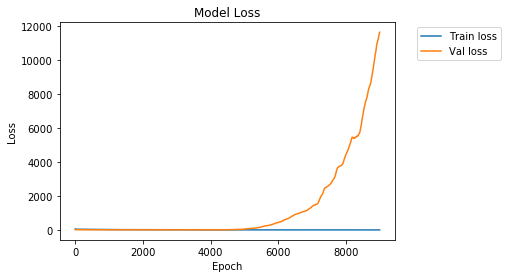

In [29]:
#Plot model loss

w = 1000
h1 = np.array(history.history['loss'])
h4 = np.array(history.history['val_loss'])
h1 = moving_average(h1,w)
h4 = moving_average(h4,w)
plt.plot(h1,label='Train loss')
plt.plot(h4,label='Val loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

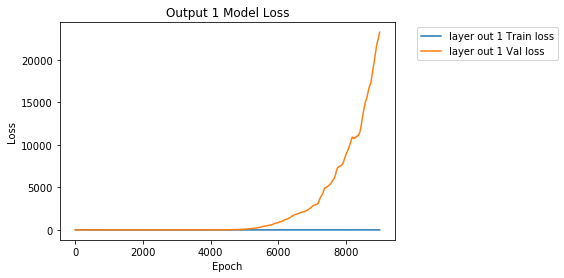

In [30]:
#Plot output 1 loss

h2 = np.array(history.history['out1_loss'])
h5 = np.array(history.history['val_out1_loss'])
h2 = moving_average(h2,w)
h5 = moving_average(h5,w)
plt.plot(h2,label='layer out 1 Train loss')
plt.plot(h5,label='layer out 1 Val loss')
plt.title('Output 1 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

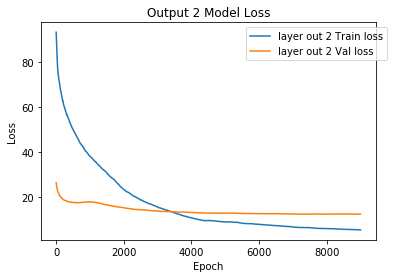

In [31]:
#Plot output 2 loss

h3 = np.array(history.history['out2_loss'])
h6 = np.array(history.history['val_out2_loss'])
h3 = moving_average(h3,w)
h6 = moving_average(h6,w)
plt.plot(h3,label='layer out 2 Train loss')
plt.plot(h6,label='layer out 2 Val loss')
plt.title('Output 2 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

In [32]:
#Load ground truth RUL

thr = mat['thr']
fleet_NUM = np.arange(0,pad,1)

rul = pd.read_csv(rul_file,index_col=False)
rul = (rul-1)/(thr-1)
rul_Fleet_All = np.zeros(259)
for x in range(259):
    rul_Fleet_All[x] = rul['RUL'][x]
rul_Fleet_All_Full = ((thr-1)*rul_Fleet_All) + 1
rul_Fleet_All_Full

array([18., 50., 50., 50., 15., 50.,  6., 50., 11., 50.,  6., 50., 30.,
       11., 37., 50., 50., 50., 22., 50., 50., 10., 50., 50., 50., 50.,
       50., 50., 50., 50., 50., 11., 50., 50., 50., 50., 50., 50., 48.,
       37., 44., 27., 18.,  6., 15., 50., 50., 13., 50., 13., 50., 50.,
       50., 50., 50., 50., 50., 26., 50., 50., 50., 39., 39., 14., 11.,
       50., 50., 50., 50., 17., 50., 50., 50., 50., 50., 36., 50., 50.,
       50., 15., 50., 50., 50., 17., 47., 50., 21., 50., 50.,  8.,  9.,
       50., 50., 50., 50., 49., 31., 50.,  9., 14., 50.,  8.,  8., 50.,
       50., 50., 50., 50., 35., 50.,  9., 50., 50., 50., 50.,  7., 50.,
       50., 50., 15., 50., 50., 50.,  7., 50., 50., 50., 50., 50., 50.,
       50., 39., 38.,  9., 50., 50., 50.,  7., 50., 50., 50., 47., 50.,
       43., 50., 10., 50., 11., 50., 34., 50., 50., 50., 50., 50., 50.,
       50., 15.,  9., 42., 13., 41., 50., 14., 50., 50., 50., 50., 50.,
       50., 36., 50., 14., 50., 50., 23.,  6., 50., 35., 50., 50

In [33]:
#Make 100 predictions and calculate average RMSE & Score

import sklearn
import math
from sklearn import metrics

rmse = np.zeros(100)
rmse1 = np.zeros(100)
sc = np.zeros(100)
sc1 = np.zeros(100)

for i in range(100):
    
    preds = model(x_test)
    tens_draw = preds[0].sample(1000)
    tens_draw1 = preds[1].sample(1000)
    tens_draw2 = preds[2]
    tens_draw = tf.keras.backend.get_value(tens_draw)
    tens_draw1 = tf.keras.backend.get_value(tens_draw1)
    tens_draw2 = tf.keras.backend.get_value(tens_draw2)

    #RMSE with AU

    mean_Fleet_All = np.zeros(tens_draw.shape[1])
    mean_Fleet = np.zeros(tens_draw.shape[0])
    for y in range(tens_draw.shape[1]):
        for x in range(tens_draw.shape[0]):
            mean_Fleet[x] = tens_draw[x,y,0]
        mean_Fleet_All[y] = mean_Fleet.mean()

    RUL_mse = sklearn.metrics.mean_squared_error(rul_Fleet_All_Full, mean_Fleet_All)
    RUL_rmse = math.sqrt(RUL_mse)
    rmse[i] = RUL_rmse

    #RMSE with EU

    mean_Fleet_All1 = np.zeros(tens_draw1.shape[1])
    mean_Fleet1 = np.zeros(tens_draw1.shape[0])
    for y in range(tens_draw1.shape[1]):
        for x in range(tens_draw1.shape[0]):
            mean_Fleet1[x] = tens_draw1[x,y,0]
        mean_Fleet_All1[y] = mean_Fleet1.mean()

    RUL_mse1 = sklearn.metrics.mean_squared_error(rul_Fleet_All_Full, mean_Fleet_All1)
    RUL_rmse1 = math.sqrt(RUL_mse1)
    rmse1[i] = RUL_rmse1
    
    score = mean_Fleet_All-rul_Fleet_All_Full

    for j in range(100):
        if score[j]<0:
            score[j]= math.exp((-score[j])/9)-1
        else:
            score[j] = math.exp(score[j]/10)-1
    
    sc[i] = np.sum(score)
    
    score1 = mean_Fleet_All1-rul_Fleet_All_Full

    for j in range(100):
        if score1[j]<0:
            score1[j]= math.exp((-score1[j])/9)-1
        else:
            score1[j] = math.exp(score1[j]/10)-1
    
    sc1[i] = np.sum(score1)

In [34]:
#Average RMSE with AU & EU
np.mean(rmse),np.mean(rmse1)

(17.807984454170143, 18.031001715776995)

In [35]:
#Average early prediction Score with AU & EU
np.mean(sc),np.mean(sc1)

(2231.010001281996, 2211.141152336477)

In [36]:
#Calculate Mean & Std of prediction with AU

Fleet = pd.DataFrame(np.zeros((pad,tens_draw.shape[0])))
mean = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
std = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
for z in range(tens_draw.shape[1]):
    for y in range(tens_draw.shape[0]):
        for x in range(pad):
            Fleet[y][x] = tens_draw[y,z,x]
    row_Mean = Fleet.mean(axis=1)
    row_Std = Fleet.std(axis=1)
    for j in range(pad):
        mean[z][j] = row_Mean[j]
    for k in range(pad):
        std[z][k] = row_Std[k]

In [37]:
#Calculate Mean & Std of prediction with EU

Fleet1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[0])))
mean1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
std1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
for z in range(tens_draw1.shape[1]):
    for y in range(tens_draw1.shape[0]):
        for x in range(pad):
            Fleet1[y][x] = tens_draw1[y,z,x]
    row_Mean = Fleet1.mean(axis=1)
    row_Std = Fleet1.std(axis=1)
    for j in range(pad):
        mean1[z][j] = row_Mean[j]
    for k in range(pad):
        std1[z][k] = row_Std[k]

In [38]:
#Load ground truth RUL

fleet_RUL = pd.read_csv(fleet_Rul_File, skiprows = 0,header = None)

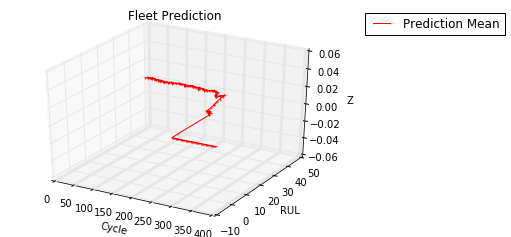

In [39]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("Fleet Prediction")
ax.set_xlabel('Cycle')
ax.set_ylabel('RUL')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,pad,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",markersize=1,color='red',label='Prediction Mean')
#ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
#ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.jpg',bbox_inches='tight')
plt.show()

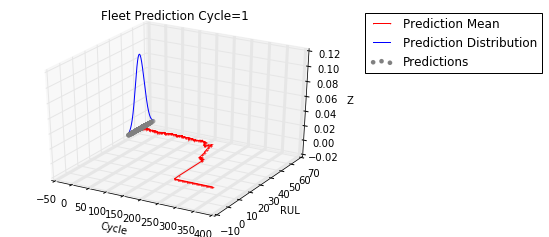

In [40]:
#3d visualization of prediction

plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 0

ax.set_title("Fleet Prediction Cycle=1")
ax.set_xlabel('Cycle')
ax.set_ylabel('RUL')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,pad,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",markersize=1,color='red',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.1,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.jpg',bbox_inches='tight')
plt.show()

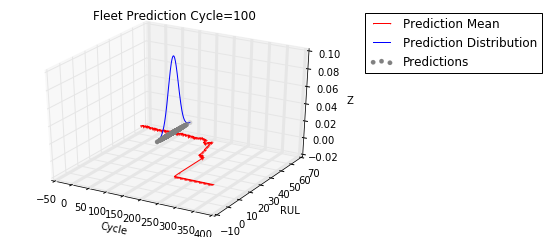

In [41]:
#3d visualization of prediction

plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 99

ax.set_title("Fleet Prediction Cycle=100")
ax.set_xlabel('Cycle')
ax.set_ylabel('RUL')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,pad,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",markersize=1,color='red',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y,mean[0][i],std[0][i]),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05,1),loc='upper left')
plt.savefig('3D_2.jpg',bbox_inches='tight')
plt.show()

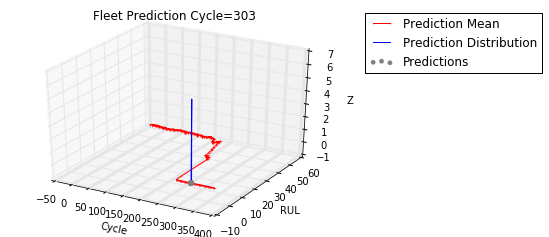

In [42]:
#3d visualization of prediction

plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 302

ax.set_title("Fleet Prediction Cycle=303")
ax.set_xlabel('Cycle')
ax.set_ylabel('RUL')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,pad,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",markersize=1,color='red',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y,mean[0][i],std[0][i]),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05,1),loc='upper left')
plt.savefig('3D_3.jpg',bbox_inches='tight')
plt.show()

In [43]:
#Define cycle when RUL ground truth become 0

cycle_lim = np.zeros(259)
S = 0
for K in range(259):
    for L in range(259):
        if fleet_RUL[K][L] == 0:
            S = 0
            break
        else:
            S = S + 1
            cycle_lim[K] = S

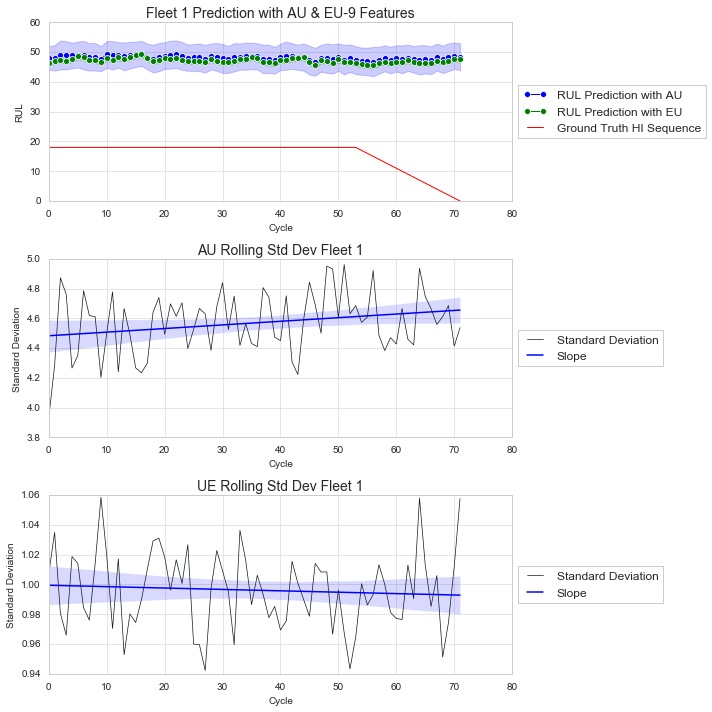

In [44]:
#Visualization Fleet 1

import seaborn as sns
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes 
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from scipy import stats
sns.set_style("whitegrid")
for B in range(0,1):
    lim = int(cycle_lim[B]+1)
    lim2 = int(cycle_lim[B]+1)
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Cycle','RUL']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Cycle','RUL']
    
    max_Seq_Arrange1.columns = ['Cycle','RUL']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Cycle','RUL']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Cycle','RUL']
    
    #get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Cycle'],min_Std_Arrange['RUL'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Cycle", y="RUL",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="RUL Prediction with AU")
    sns.lineplot(x="Cycle", y="RUL",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="RUL Prediction with EU")
    sns.lineplot(x="Cycle", y="RUL", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth HI Sequence")
    plt.title('Fleet %i Prediction with AU & EU-9 Features' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Cycle', 'RUL', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Cycle'],min_Std_Arrange['RUL'],scatter = False,label='Slope')
    plt.title('AU Rolling Std Dev Fleet %i' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Standard Deviation')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[2],sharex=ax)
    ax.plot('Cycle', 'RUL', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Cycle'],med_Std_Arrange['RUL'],scatter = False,label='Slope')
    plt.title('UE Rolling Std Dev Fleet %i' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Standard Deviation')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.savefig("Fleet %i Pred" %B+'.jpg')
    plt.tight_layout()
    plt.show()

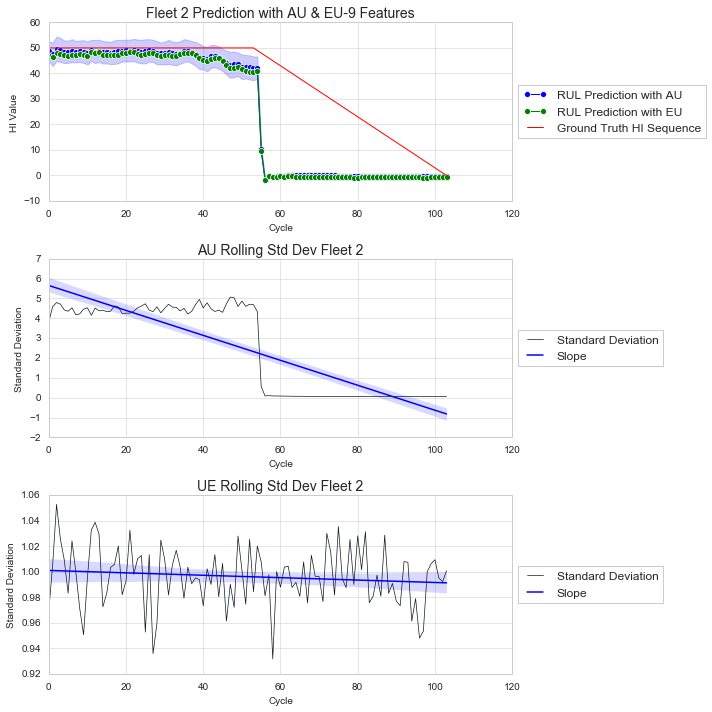

In [45]:
#Visualization Fleet 2

sns.set_style("whitegrid")
for B in range(1,2):
    lim = int(cycle_lim[B]+1)
    lim2 = int(cycle_lim[B]+1)
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Cycle','HI Value']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Cycle','HI Value']
    
    max_Seq_Arrange1.columns = ['Cycle','HI Value']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Cycle','HI Value']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Cycle','HI Value']
    
    #get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Cycle'],min_Std_Arrange['HI Value'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Cycle", y="HI Value",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="RUL Prediction with AU")
    sns.lineplot(x="Cycle", y="HI Value",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="RUL Prediction with EU")
    sns.lineplot(x="Cycle", y="HI Value", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth HI Sequence")
    plt.title('Fleet %i Prediction with AU & EU-9 Features' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Cycle', 'HI Value', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Cycle'],min_Std_Arrange['HI Value'],scatter = False,label='Slope')
    plt.title('AU Rolling Std Dev Fleet %i' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Standard Deviation')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[2],sharex=ax)
    ax.plot('Cycle', 'HI Value', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Cycle'],med_Std_Arrange['HI Value'],scatter = False,label='Slope')
    plt.title('UE Rolling Std Dev Fleet %i' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Standard Deviation')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.savefig("Fleet %i Pred" %B+'.jpg')
    plt.tight_layout()
    plt.show()

In [46]:
#SHAP cannot be used with model with probabilistic layers. So, transfer learned weights of probabilistic LSTM to a new LSTM without probabilistic layers
#Define New LSTM without probabilistic layers for explanation

inputs = tf.keras.Input(shape=(pad,9),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 367, 9)]          0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 367, 45)           9900      
_________________________________________________________________
dense_3 (Dense)              (None, 367, 47)           2162      
_________________________________________________________________
dense_4 (Dense)              (None, 367, 1)            48        
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 12,110
Trainable params: 12,110
Non-trainable params: 0
_________________________________________________________________


In [47]:
#Transfer weights from old LSTM to new LSTM

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(model.layers[5].get_weights())
model2.layers[4].set_weights(model.layers[8].get_weights())

In [48]:
#Prediction with new LSTM

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [49]:
#Import SHAP & initialized JS

import shap
shap.initjs()

In [50]:
#Extract Feature Names

features = pd.read_csv(train_file, index_col=False)
features = features.drop(['Fleet','Cycle','RUL'],axis=1)
features = np.array(list(features.columns))
features

array(['OC1', 'OC2', 'S3', 'S4', 'S8', 'S11', 'S13', 'S15', 'S17'],
      dtype='<U3')

In [51]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(train_file, index_col=False)
xtrain = xtrain.drop(['Fleet','Cycle','RUL'],axis=1)

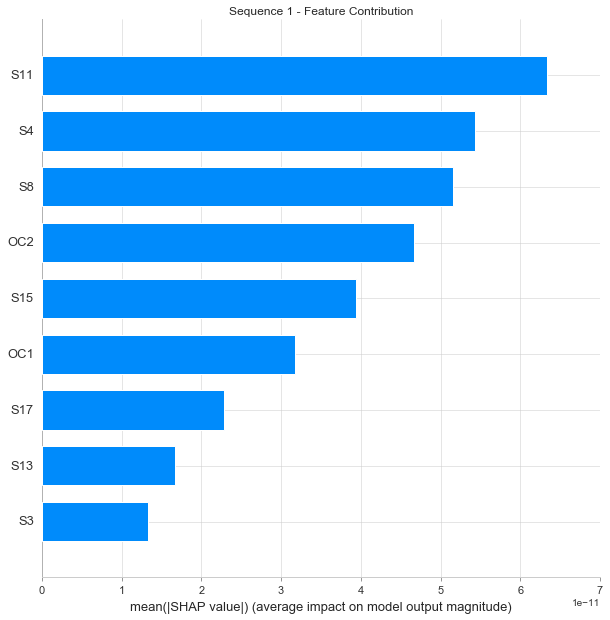

In [52]:
#SHAP Summmary Plot Fleet 1

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(0,1):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(10, 10),plot_type="bar")
    plt.title("Sequence %i - Feature Contribution" %(i+1),fontsize=12)
    plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure

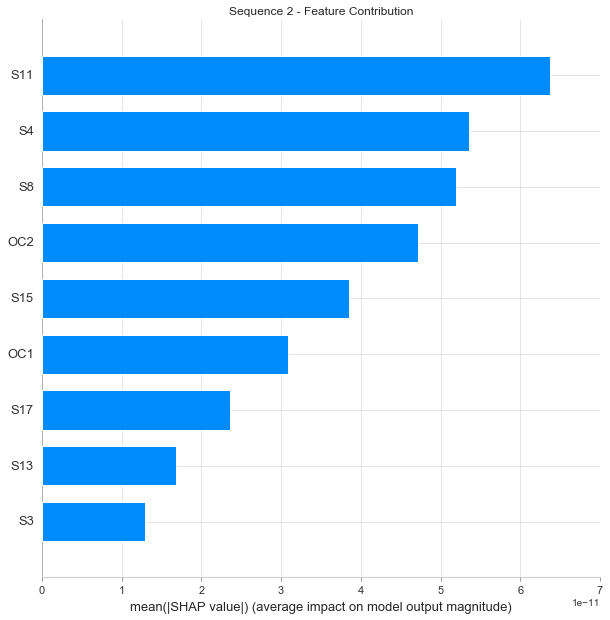

In [53]:
#SHAP Summmary Plot Fleet 2

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(1,2):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(10, 10),plot_type="bar")
    plt.title("Sequence %i - Feature Contribution" %(i+1),fontsize=12)
    plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure

In [54]:
#SHAP Force Plot Fleet 1

sns.set_style("ticks")
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
for s in range(0,1):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    #Per individual array 
    for j in range(pad):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,9),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

1 1


1 2


1 3


1 4


1 5


1 6


1 7


1 8


1 9


1 10


1 11


1 12


1 13


1 14


1 15


1 16


1 17


1 18


1 19


1 20


1 21


1 22


1 23


1 24


1 25


1 26


1 27


1 28


1 29


1 30


1 31


1 32


1 33


1 34


1 35


1 36


1 37


1 38


1 39


1 40


1 41


1 42


1 43


1 44


1 45


1 46


1 47


1 48


1 49


1 50


1 51


1 52


1 53


1 54


1 55


1 56


1 57


1 58


1 59


1 60


1 61


1 62


1 63


1 64


1 65


1 66


1 67


1 68


1 69


1 70


1 71


1 72


1 73


1 74


1 75


1 76


1 77


1 78


1 79


1 80


1 81


1 82


1 83


1 84


1 85


1 86


1 87


1 88


1 89


1 90


1 91


1 92


1 93


1 94


1 95


1 96


1 97


1 98


1 99


1 100


1 101


1 102


1 103


1 104


1 105


1 106


1 107


1 108


1 109


1 110


1 111


1 112


1 113


1 114


1 115


1 116


1 117


1 118


1 119


1 120


1 121


1 122


1 123


1 124


1 125


1 126


1 127


1 128


1 129


1 130


1 131


1 132


1 133


1 134


1 135


1 136


1 137


1 138


1 139


1 140


1 141


1 142


1 143


1 144


1 145


1 146


1 147


1 148


1 149


1 150


1 151


1 152


1 153


1 154


1 155


1 156


1 157


1 158


1 159


1 160


1 161


1 162


1 163


1 164


1 165


1 166


1 167


1 168


1 169


1 170


1 171


1 172


1 173


1 174


1 175


1 176


1 177


1 178


1 179


1 180


1 181


1 182


1 183


1 184


1 185


1 186


1 187


1 188


1 189


1 190


1 191


1 192


1 193


1 194


1 195


1 196


1 197


1 198


1 199


1 200


1 201


1 202


1 203


1 204


1 205


1 206


1 207


1 208


1 209


1 210


1 211


1 212


1 213


1 214


1 215


1 216


1 217


1 218


1 219


1 220


1 221


1 222


1 223


1 224


1 225


1 226


1 227


1 228


1 229


1 230


1 231


1 232


1 233


1 234


1 235


1 236


1 237


1 238


1 239


1 240


1 241


1 242


1 243


1 244


1 245


1 246


1 247


1 248


1 249


1 250


1 251


1 252


1 253


1 254


1 255


1 256


1 257


1 258


1 259


1 260


1 261


1 262


1 263


1 264


1 265


1 266


1 267


1 268


1 269


1 270


1 271


1 272


1 273


1 274


1 275


1 276


1 277


1 278


1 279


1 280


1 281


1 282


1 283


1 284


1 285


1 286


1 287


1 288


1 289


1 290


1 291


1 292


1 293


1 294


1 295


1 296


1 297


1 298


1 299


1 300


1 301


1 302


1 303


1 304


1 305


1 306


1 307


1 308


1 309


1 310


1 311


1 312


1 313


1 314


1 315


1 316


1 317


1 318


1 319


1 320


1 321


1 322


1 323


1 324


1 325


1 326


1 327


1 328


1 329


1 330


1 331


1 332


1 333


1 334


1 335


1 336


1 337


1 338


1 339


1 340


1 341


1 342


1 343


1 344


1 345


1 346


1 347


1 348


1 349


1 350


1 351


1 352


1 353


1 354


1 355


1 356


1 357


1 358


1 359


1 360


1 361


1 362


1 363


1 364


1 365


1 366


1 367


In [55]:
#SHAP Force Plot Fleet 2

for s in range(1,2):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    #Per individual array 
    for j in range(pad):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,9),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

2 1


2 2


2 3


2 4


2 5


2 6


2 7


2 8


2 9


2 10


2 11


2 12


2 13


2 14


2 15


2 16


2 17


2 18


2 19


2 20


2 21


2 22


2 23


2 24


2 25


2 26


2 27


2 28


2 29


2 30


2 31


2 32


2 33


2 34


2 35


2 36


2 37


2 38


2 39


2 40


2 41


2 42


2 43


2 44


2 45


2 46


2 47


2 48


2 49


2 50


2 51


2 52


2 53


2 54


2 55


2 56


2 57


2 58


2 59


2 60


2 61


2 62


2 63


2 64


2 65


2 66


2 67


2 68


2 69


2 70


2 71


2 72


2 73


2 74


2 75


2 76


2 77


2 78


2 79


2 80


2 81


2 82


2 83


2 84


2 85


2 86


2 87


2 88


2 89


2 90


2 91


2 92


2 93


2 94


2 95


2 96


2 97


2 98


2 99


2 100


2 101


2 102


2 103


2 104


2 105


2 106


2 107


2 108


2 109


2 110


2 111


2 112


2 113


2 114


2 115


2 116


2 117


2 118


2 119


2 120


2 121


2 122


2 123


2 124


2 125


2 126


2 127


2 128


2 129


2 130


2 131


2 132


2 133


2 134


2 135


2 136


2 137


2 138


2 139


2 140


2 141


2 142


2 143


2 144


2 145


2 146


2 147


2 148


2 149


2 150


2 151


2 152


2 153


2 154


2 155


2 156


2 157


2 158


2 159


2 160


2 161


2 162


2 163


2 164


2 165


2 166


2 167


2 168


2 169


2 170


2 171


2 172


2 173


2 174


2 175


2 176


2 177


2 178


2 179


2 180


2 181


2 182


2 183


2 184


2 185


2 186


2 187


2 188


2 189


2 190


2 191


2 192


2 193


2 194


2 195


2 196


2 197


2 198


2 199


2 200


2 201


2 202


2 203


2 204


2 205


2 206


2 207


2 208


2 209


2 210


2 211


2 212


2 213


2 214


2 215


2 216


2 217


2 218


2 219


2 220


2 221


2 222


2 223


2 224


2 225


2 226


2 227


2 228


2 229


2 230


2 231


2 232


2 233


2 234


2 235


2 236


2 237


2 238


2 239


2 240


2 241


2 242


2 243


2 244


2 245


2 246


2 247


2 248


2 249


2 250


2 251


2 252


2 253


2 254


2 255


2 256


2 257


2 258


2 259


2 260


2 261


2 262


2 263


2 264


2 265


2 266


2 267


2 268


2 269


2 270


2 271


2 272


2 273


2 274


2 275


2 276


2 277


2 278


2 279


2 280


2 281


2 282


2 283


2 284


2 285


2 286


2 287


2 288


2 289


2 290


2 291


2 292


2 293


2 294


2 295


2 296


2 297


2 298


2 299


2 300


2 301


2 302


2 303


2 304


2 305


2 306


2 307


2 308


2 309


2 310


2 311


2 312


2 313


2 314


2 315


2 316


2 317


2 318


2 319


2 320


2 321


2 322


2 323


2 324


2 325


2 326


2 327


2 328


2 329


2 330


2 331


2 332


2 333


2 334


2 335


2 336


2 337


2 338


2 339


2 340


2 341


2 342


2 343


2 344


2 345


2 346


2 347


2 348


2 349


2 350


2 351


2 352


2 353


2 354


2 355


2 356


2 357


2 358


2 359


2 360


2 361


2 362


2 363


2 364


2 365


2 366


2 367


Contribution: [ 1.33592410e-14  2.68220521e-14 -3.44115669e-15  1.16559924e-14
 -1.25076002e-14  4.79916459e-15  1.09172464e-17 -3.07102722e-15
 -1.77407798e-14]


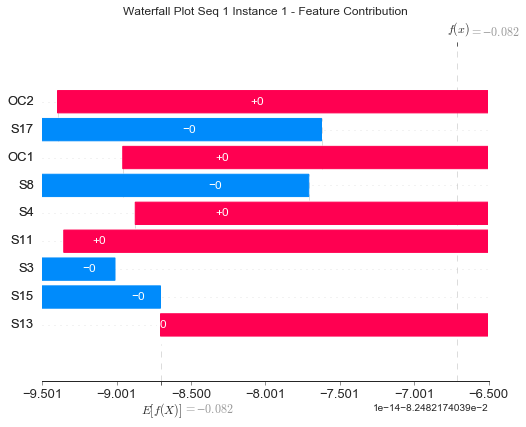

None

Contribution: [ 6.78527982e-15 -1.13681325e-14  3.39588644e-17 -7.11337337e-15
  1.54703209e-16 -3.12460544e-15 -2.26773674e-18  2.15174185e-14
  2.37153534e-15]


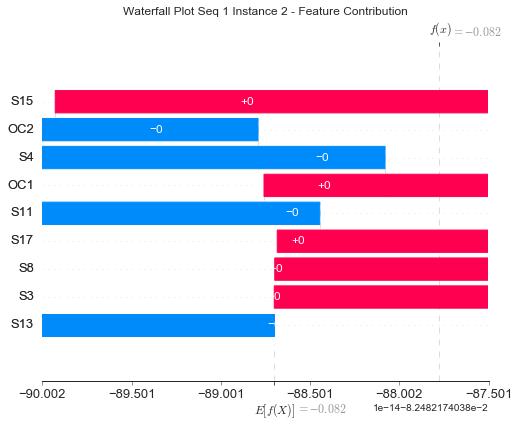

None

Contribution: [-7.31382510e-16  8.07695467e-16  1.66083825e-16  3.16846311e-15
 -3.88370086e-16  7.20943199e-16  5.31883338e-18 -3.50756688e-16
 -7.85393089e-16]


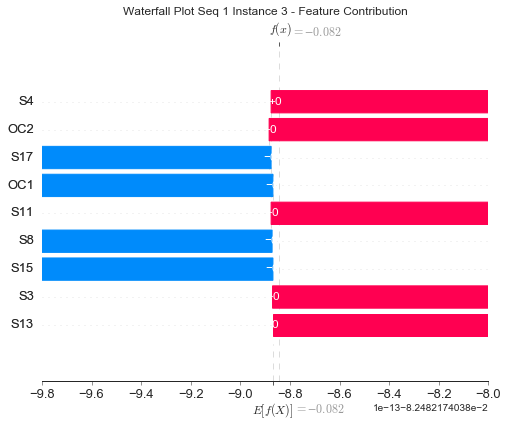

None

Contribution: [ 3.17516196e-14 -2.25287030e-14 -3.16576214e-15 -4.48262304e-14
  2.27745069e-14 -2.64330268e-14  4.51463226e-18  3.80547407e-14
  1.77757657e-14]


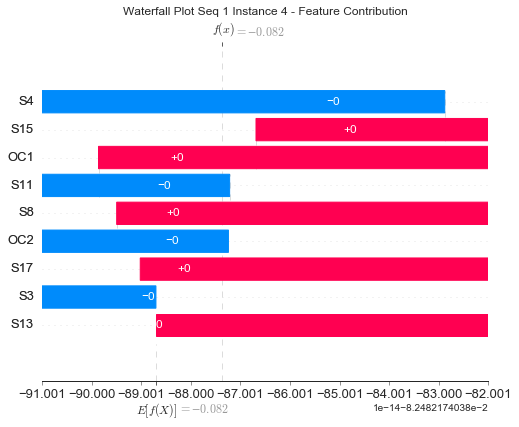

None

Contribution: [-3.89571501e-15  8.90838527e-15 -1.25720687e-14 -1.59508620e-14
  2.84201746e-14 -3.81133317e-14  5.05154038e-16  4.67450717e-14
 -6.98122310e-15]


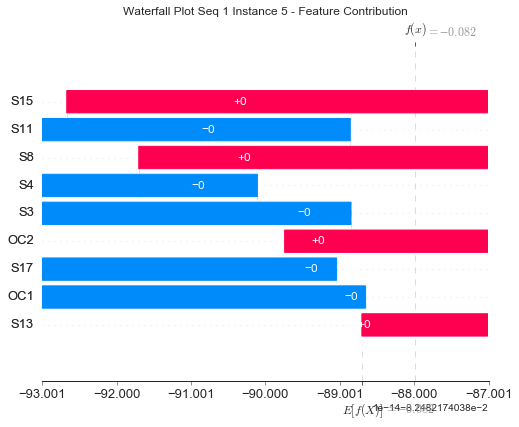

None

Contribution: [ 7.69244914e-15 -1.74915912e-14 -1.48529108e-14 -5.69384627e-14
  3.15128478e-14 -3.87969245e-14  4.46370693e-15  7.71620113e-14
  5.28545213e-15]


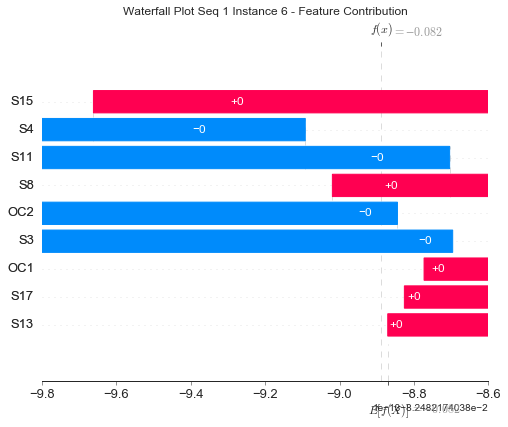

None

Contribution: [ 2.41655112e-15  3.76276853e-15 -1.28434039e-15 -7.58890021e-15
  9.91641631e-15 -8.39510871e-15  2.30799432e-16 -1.75599904e-15
  3.50609807e-15]


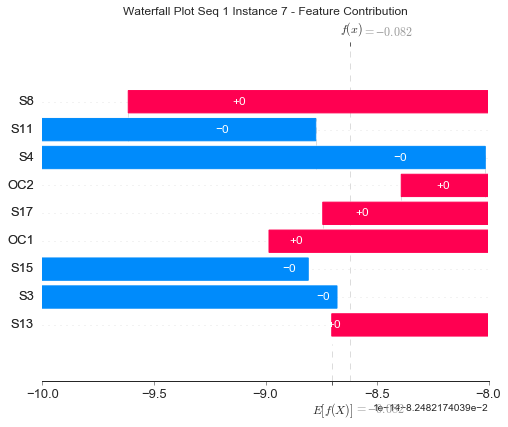

None

Contribution: [-1.87175520e-15  7.47619401e-15 -5.33542919e-15 -5.38675897e-15
  1.05199832e-14 -1.35079368e-14  2.25755689e-15  1.32638465e-14
 -4.73582728e-15]


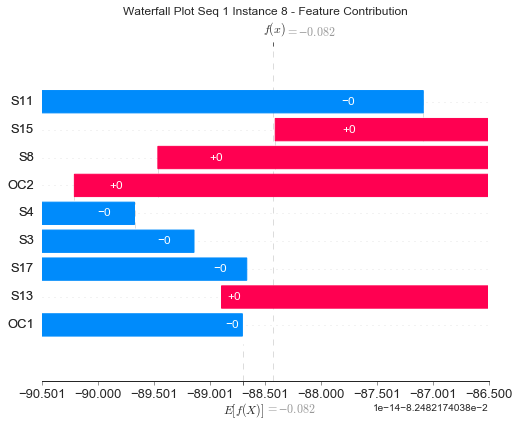

None

Contribution: [ 1.15486056e-14 -6.56904628e-15  1.02443807e-15 -1.50284583e-14
  7.63174907e-15 -1.23819166e-14  2.19885266e-18  1.29541805e-14
  5.01973451e-15]


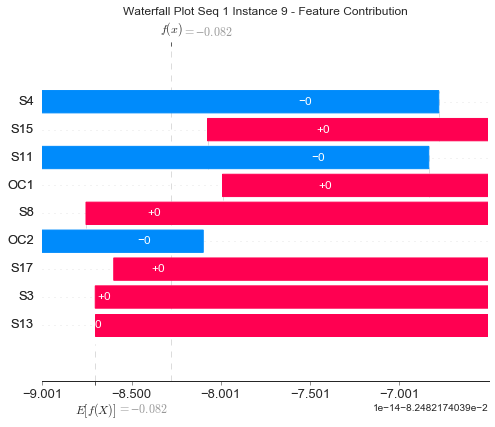

None

Contribution: [-1.87277841e-15 -2.34961990e-16  7.16506525e-15  2.61314509e-14
 -2.28994561e-14  2.69464897e-14 -2.66663484e-15 -3.31916162e-14
 -1.48309656e-15]


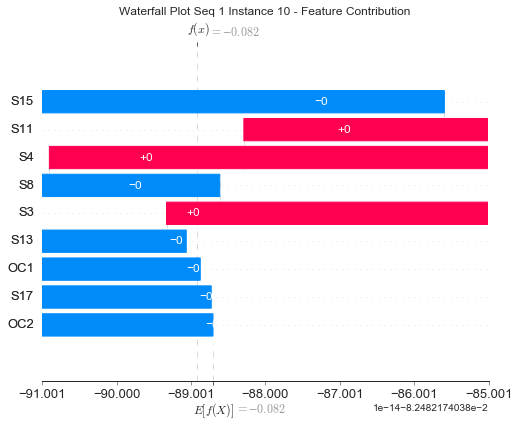

None

Contribution: [-2.69759114e-15  1.52931153e-15 -9.57825365e-15 -1.56922018e-14
  1.42707332e-14 -1.11004803e-14  3.32916961e-15  2.64060133e-14
 -3.04941538e-15]


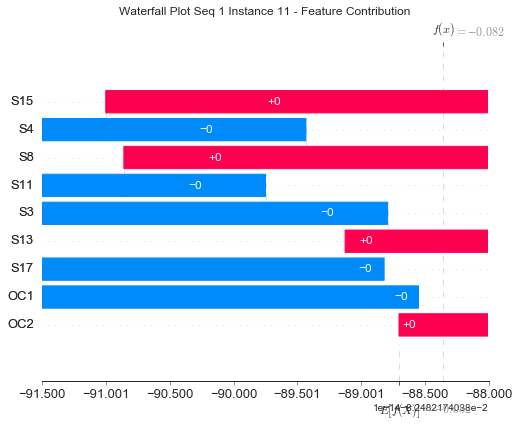

None

Contribution: [ 1.70671294e-14 -8.51524255e-15 -1.06700978e-14 -4.12165521e-14
  2.95218731e-14 -4.04147032e-14  1.48178271e-15  5.33194196e-14
  4.48916535e-15]


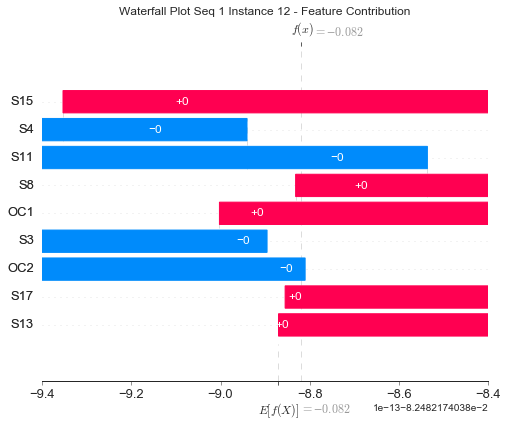

None

Contribution: [ 1.09363251e-15 -3.22646369e-15  5.73243481e-15  1.54271360e-15
 -4.93080198e-15  3.96568163e-15 -2.27966636e-15 -3.77913236e-15
  2.45435907e-15]


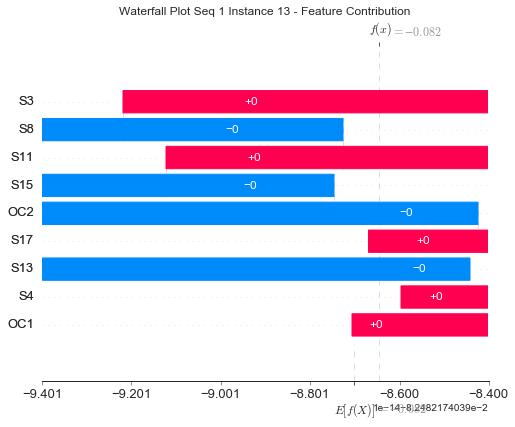

None

Contribution: [-6.78622511e-15  1.09290815e-14  5.00764502e-16  1.48333613e-14
 -7.06246966e-15  8.88224498e-15  1.60851826e-18 -1.26003435e-14
 -6.91691086e-15]


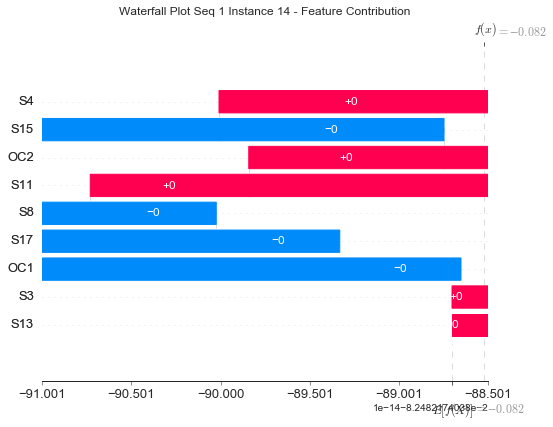

None

Contribution: [ 3.17826434e-15 -1.52319038e-14  8.56023355e-15  1.87544614e-14
 -2.63483015e-14  2.96040522e-14 -4.55981679e-15 -3.20888945e-14
  3.17946586e-15]


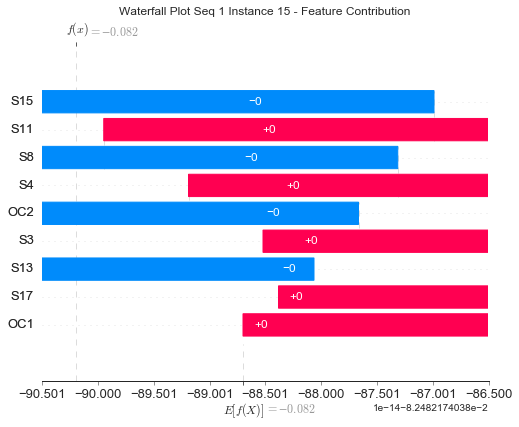

None

Contribution: [-8.54195458e-16 -2.99853856e-15  2.01255994e-14  4.22033488e-14
 -3.82088905e-14  3.37631839e-14 -3.40203562e-15 -5.09510816e-14
  7.19024723e-16]


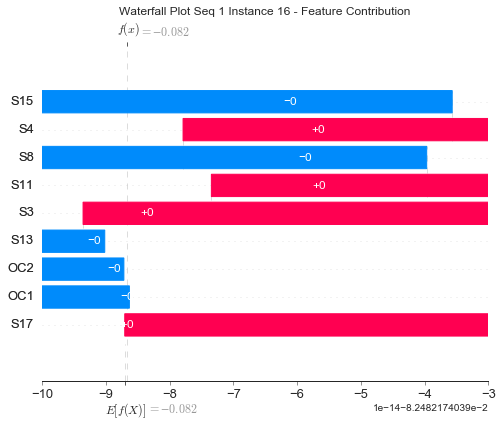

None

Contribution: [ 3.29255429e-15 -1.27266980e-14  1.60471866e-14  1.13482713e-14
 -2.80237530e-14  3.74985721e-14 -9.89638885e-16 -5.04550964e-14
  1.07301998e-14]


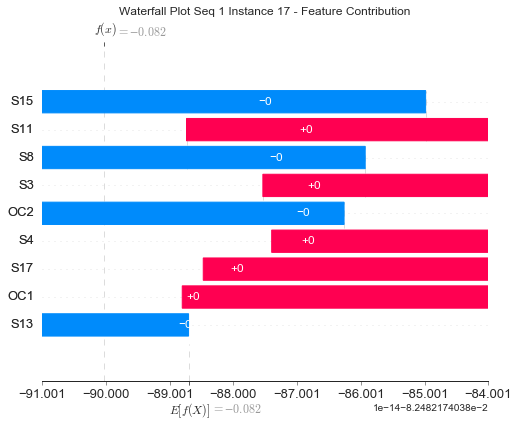

None

Contribution: [-1.13205225e-14  2.19348042e-14 -1.10084595e-14 -6.68296798e-15
  1.59725071e-14 -1.34231530e-14  5.07298705e-15  8.11762919e-15
 -1.08294340e-14]


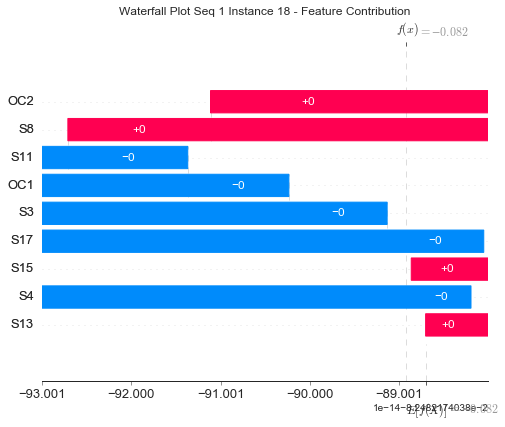

None

Contribution: [ 4.69734572e-15 -4.42787236e-15  1.56394787e-15 -7.40371340e-15
  1.82051478e-15 -1.02606480e-14 -8.46441679e-18  4.16048015e-15
  2.66603599e-15]


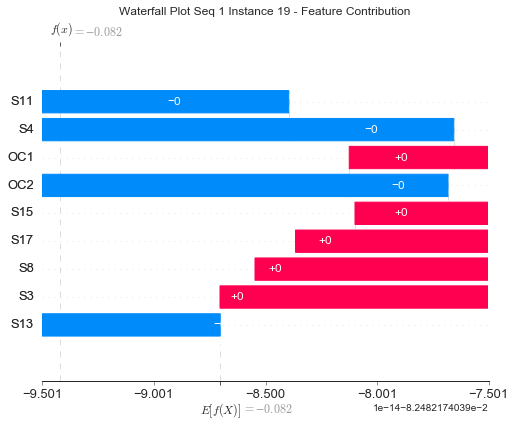

None

Contribution: [-1.25734820e-15  9.54597449e-16 -1.18517178e-15 -1.11358056e-15
  2.69351104e-16 -8.16663057e-16 -6.10302707e-18 -1.88335701e-15
 -5.65921082e-16]


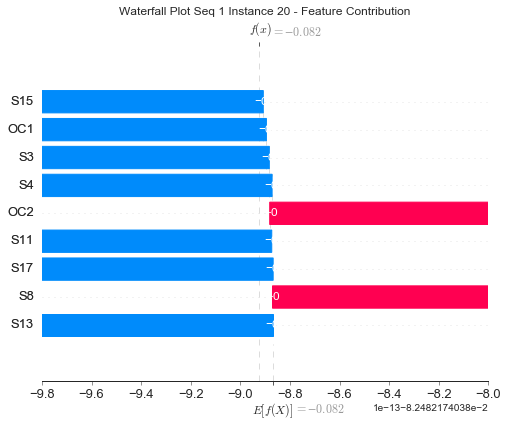

None

Contribution: [-6.39582974e-15  7.94769151e-15  1.81909219e-15  1.56693980e-14
 -9.11406774e-15  6.55670756e-15  5.91601766e-18 -1.25274640e-14
 -7.68201285e-15]


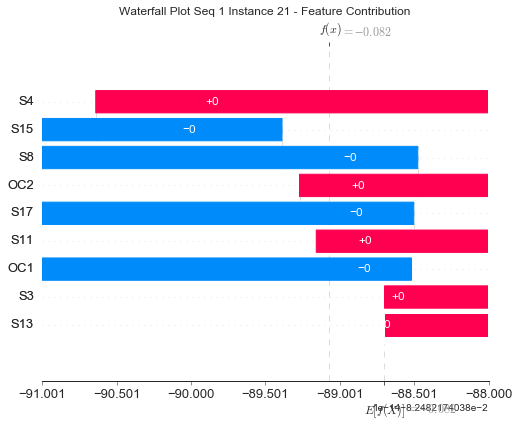

None

Contribution: [-1.34814060e-15  7.84794660e-16 -1.08548617e-15  4.40784003e-15
 -6.61923055e-16 -1.60509366e-15 -1.12411157e-17 -2.40393033e-15
 -3.68908101e-16]


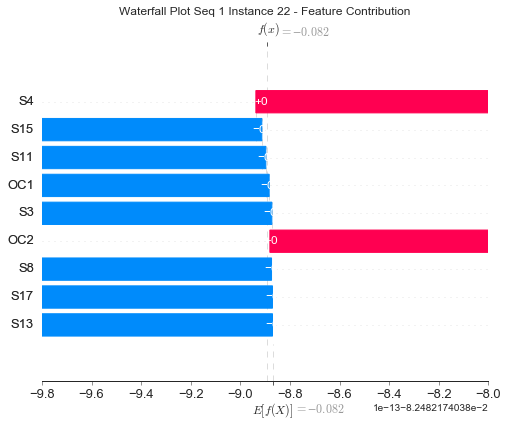

None

Contribution: [ 5.20145484e-15 -1.23886370e-14  1.22991249e-16 -1.14037308e-14
 -1.00265693e-15 -3.54114109e-15  1.19372337e-17  1.49262875e-14
  2.52510644e-15]


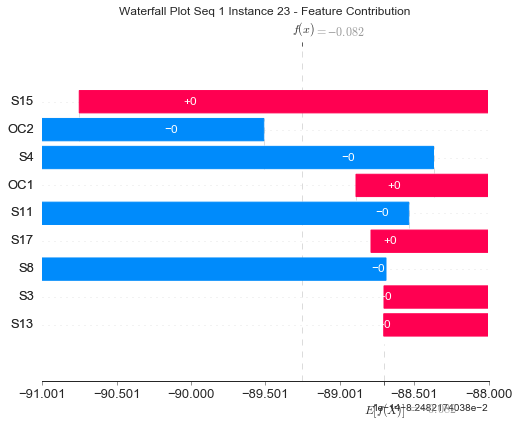

None

Contribution: [-2.29024241e-14  3.24081040e-14 -1.57419108e-14  7.90824180e-15
  1.56755017e-14 -3.11140816e-14  4.43405908e-15  2.04278936e-14
 -2.15194023e-14]


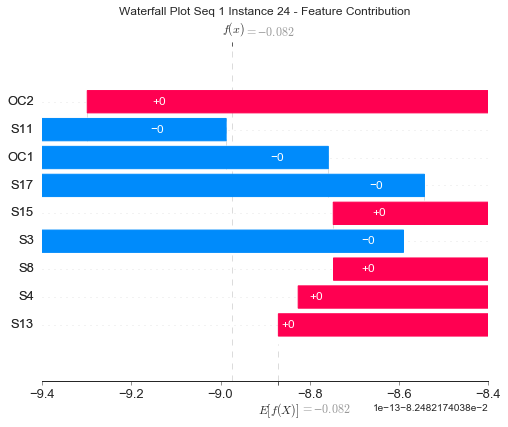

None

Contribution: [ 1.21490893e-14 -7.61312451e-15 -2.55077365e-15 -4.08644066e-14
  3.15635850e-14 -2.51553827e-14 -5.51351344e-19  9.39978508e-16
  2.39118062e-14]


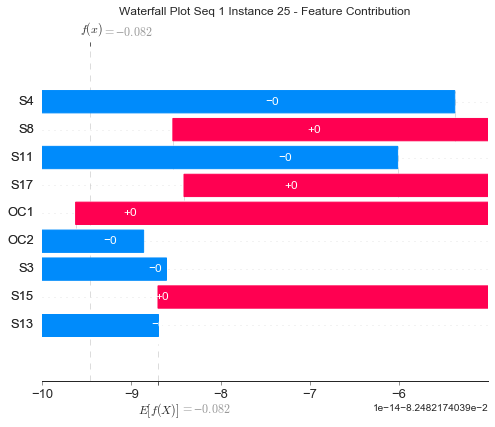

None

Contribution: [-3.97376901e-14  4.54282845e-14 -1.65256604e-15  6.39987602e-14
 -2.81869576e-14  1.53565278e-14  5.03025381e-15 -3.38047224e-14
 -4.03208926e-14]


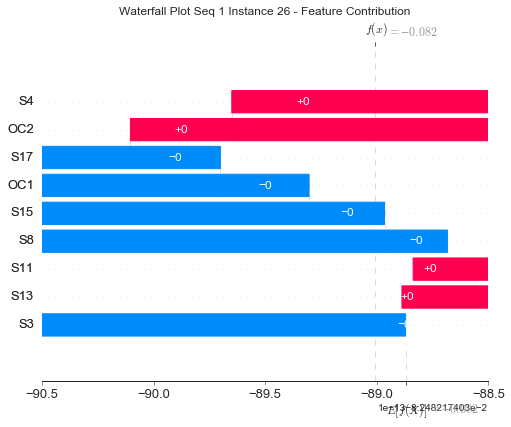

None

Contribution: [-2.52045682e-14  3.95703198e-14 -1.27202267e-14  1.34564414e-14
  6.45563704e-15 -3.60794429e-14  4.05846350e-15  3.47240411e-14
 -3.71658982e-14]


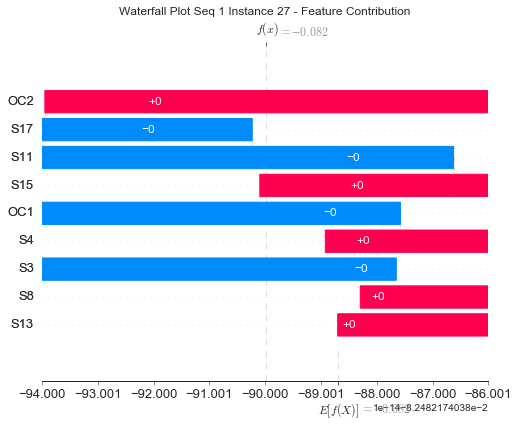

None

Contribution: [-1.86805188e-14  2.06299533e-14  1.72292431e-15  2.91166830e-14
 -1.74817097e-14  1.29345810e-14 -4.17944817e-17 -2.69607385e-14
 -1.49908348e-14]


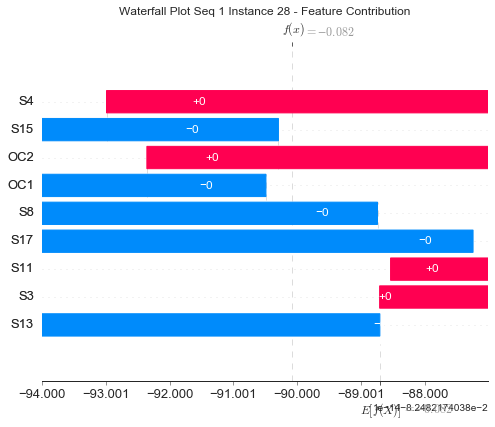

None

Contribution: [ 1.52808352e-14 -1.54616666e-14 -3.28473067e-15 -3.36643182e-14
  1.12310716e-14 -1.18782107e-14  8.61059283e-18  1.63853526e-14
  1.11131807e-14]


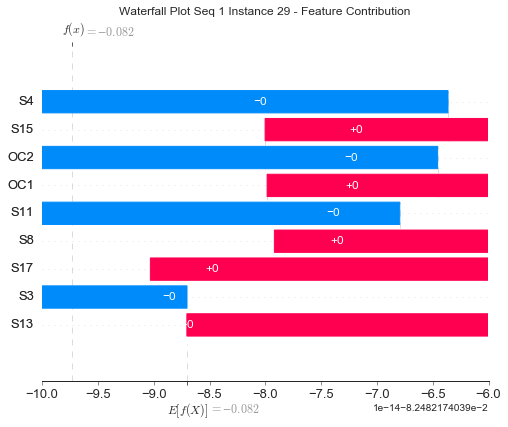

None

Contribution: [-1.99403872e-14  1.15234140e-14  2.44263804e-15  2.90269111e-14
 -3.27206456e-14  1.68072529e-14 -5.25852050e-17 -1.93231559e-14
 -2.26874268e-14]


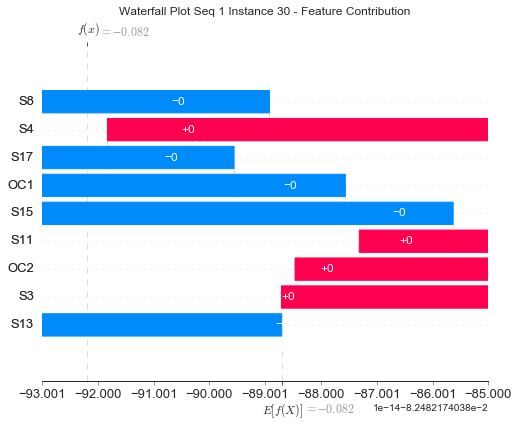

None

Contribution: [-6.81407377e-14  8.14049417e-14  5.84117351e-15  1.14168264e-13
 -5.69361724e-14  5.10054814e-14 -5.43476125e-17 -1.24849472e-13
 -4.88260284e-14]


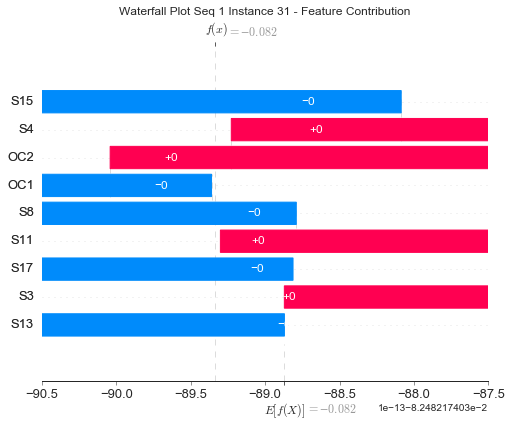

None

Contribution: [-2.57845367e-14  5.93008783e-14 -4.97622912e-14 -4.56108336e-14
  8.47572677e-14 -1.09901176e-13  1.59354494e-14  1.15556843e-13
 -3.92902263e-14]


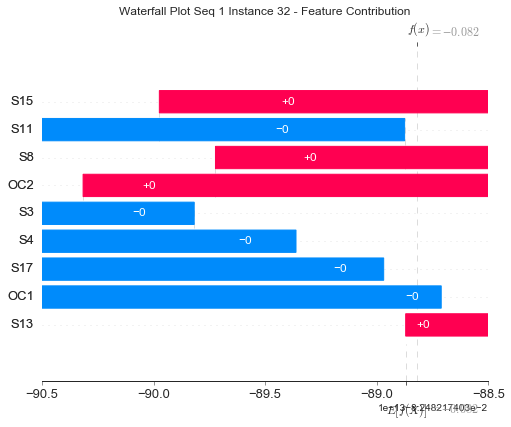

None

Contribution: [-5.78246964e-14  7.99990296e-14 -1.44981296e-16  1.17510819e-13
 -6.08013870e-14  6.75932970e-14 -4.44402486e-17 -1.07527458e-13
 -6.02672683e-14]


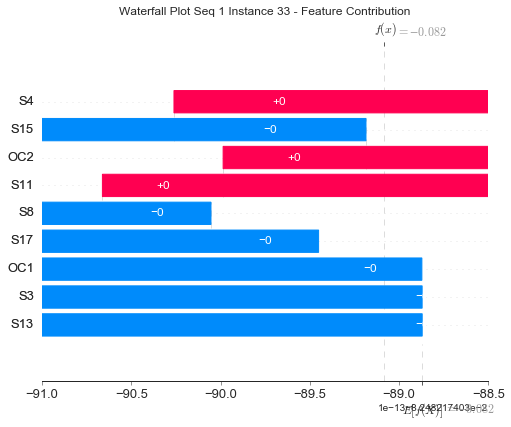

None

Contribution: [-5.50723712e-14  6.26887255e-14  1.48252097e-13  4.57679793e-13
 -3.56417532e-13  3.55812900e-13 -5.48099807e-14 -6.14320443e-13
 -3.79405200e-14]


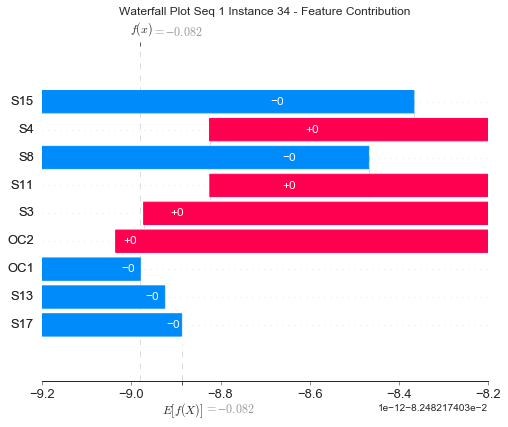

None

Contribution: [-1.39433983e-13  2.05707670e-13  2.15479549e-15  2.95562972e-13
 -1.55338551e-13  1.68212530e-13 -3.63761575e-17 -2.28164032e-13
 -1.42356721e-13]


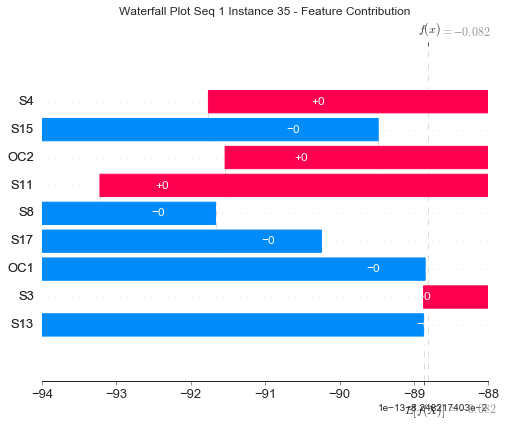

None

Contribution: [ 1.11955919e-14 -5.32030915e-14  9.28531476e-14  1.25238104e-13
 -1.99364695e-13  2.36142350e-13 -1.52937457e-14 -3.21067662e-13
  3.76721325e-14]


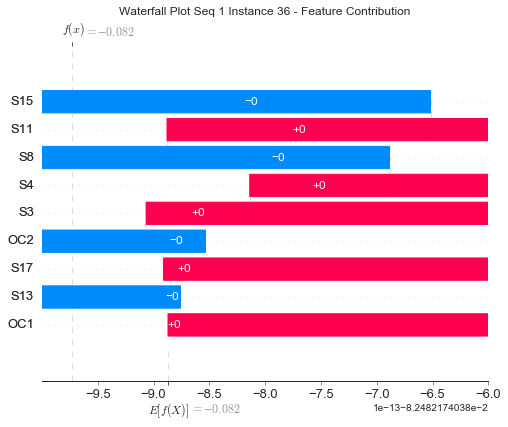

None

Contribution: [ 1.29591663e-13 -2.03314389e-13 -5.75688111e-14 -3.80938065e-13
  2.20757874e-13 -2.46507187e-13  1.96098224e-14  3.93898212e-13
  1.18867169e-13]


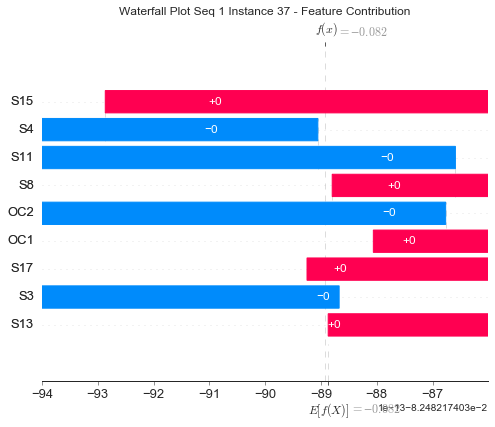

None

Contribution: [-6.75594876e-15  1.52924842e-15  1.63374095e-15 -1.44045474e-14
 -5.98421027e-15 -1.56300110e-14 -7.08763024e-17 -1.64626207e-14
 -1.29484222e-15]


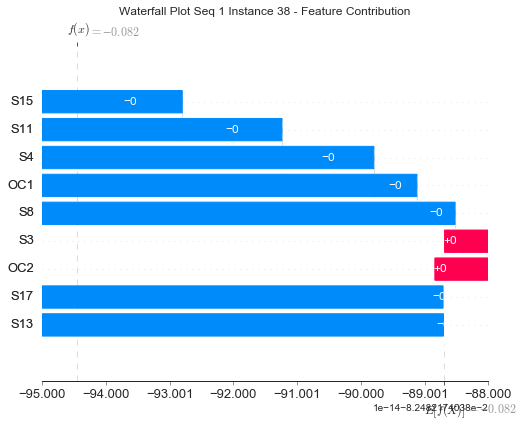

None

Contribution: [-4.33972790e-14  5.79264081e-14  3.69150723e-15  7.01794579e-14
 -4.03893668e-14  3.83120287e-14 -5.56828078e-17 -7.27329506e-14
 -4.53507064e-14]


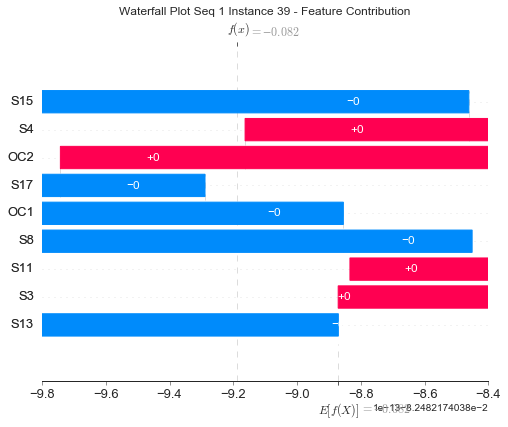

None

Contribution: [ 2.77741646e-14  2.78679875e-16 -8.19164886e-14 -2.63765789e-13
  2.39517824e-13 -2.44162871e-13  3.13090855e-14  2.54191579e-13
  4.17857108e-14]


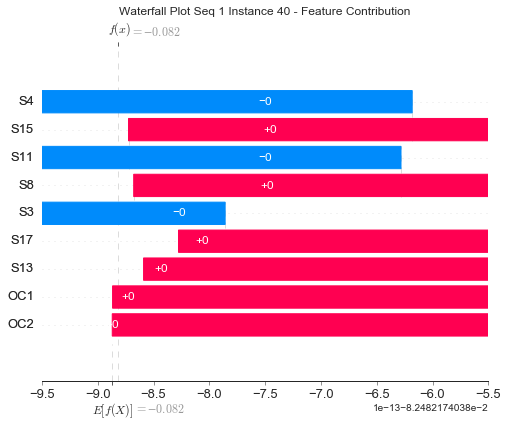

None

Contribution: [ 8.02493041e-14 -8.06875861e-14 -8.17549221e-14 -3.44896393e-13
  2.00978326e-13 -2.38022574e-13  2.16725119e-14  3.24377786e-13
  6.34477686e-14]


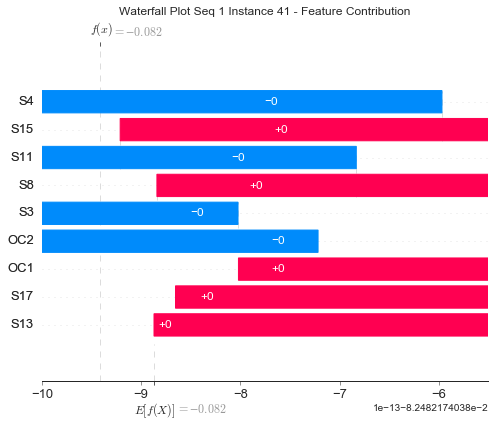

None

Contribution: [-1.15886101e-13  1.39281382e-13 -6.33902382e-14  7.35602714e-14
  5.83465568e-14 -8.56963494e-14  8.77066110e-15  7.40583810e-14
 -1.06404184e-13]


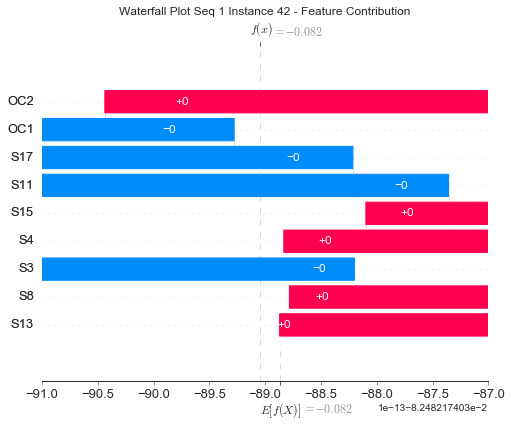

None

Contribution: [-7.12268718e-14  6.41248664e-14  1.98569785e-13  5.93930937e-13
 -5.64210842e-13  6.31321330e-13 -6.89235453e-14 -9.78391521e-13
 -2.87725810e-14]


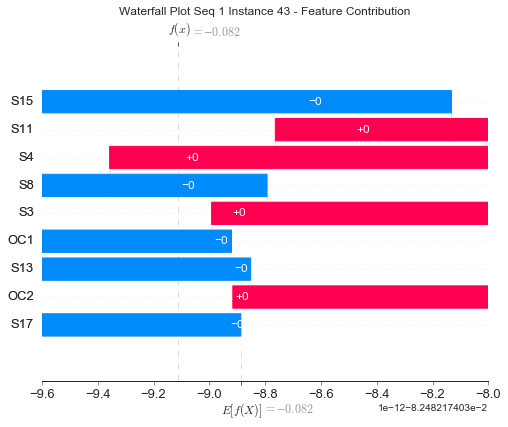

None

Contribution: [-9.46135124e-14  1.08145684e-13  2.18335902e-13  7.09342795e-13
 -5.77210317e-13  6.73629284e-13 -5.97681491e-14 -1.05821081e-12
 -3.42130092e-14]


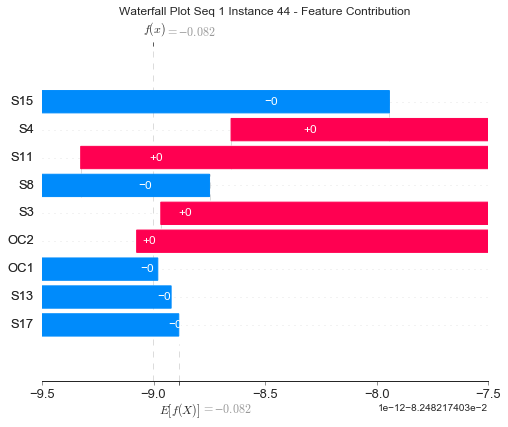

None

Contribution: [ 1.97854564e-14 -8.70285560e-14  1.85038806e-13  3.64493348e-13
 -4.28754119e-13  5.38334080e-13 -4.11188282e-14 -7.31510013e-13
  5.96343721e-14]


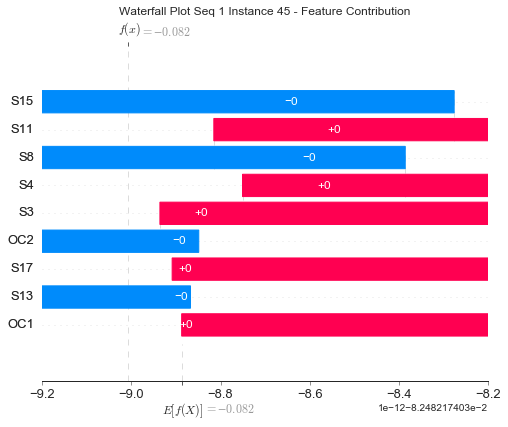

None

Contribution: [-3.19099609e-15  4.94656706e-16  3.56033825e-15  4.61641215e-15
 -5.99909137e-15 -3.49612070e-14 -1.16776528e-16 -2.26632135e-14
 -2.69484432e-16]


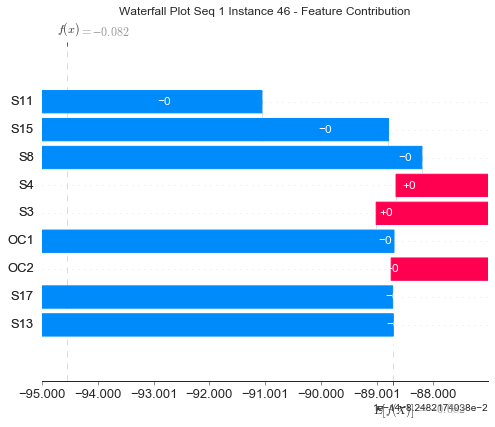

None

Contribution: [-2.96641340e-14  8.31636599e-14 -1.47729248e-15  2.48584265e-14
  3.19221519e-15  1.76070926e-14 -1.43565070e-17 -1.35548501e-13
 -1.19860956e-14]


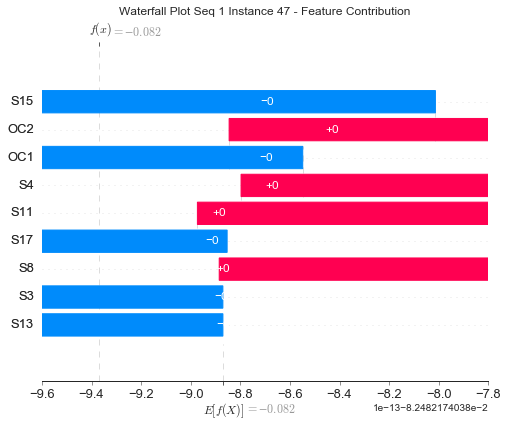

None

Contribution: [ 4.25840359e-14 -9.86735514e-14  1.99871437e-13  3.46178246e-13
 -3.88075802e-13  5.52352760e-13 -1.41500877e-14 -7.37100214e-13
  8.52127274e-14]


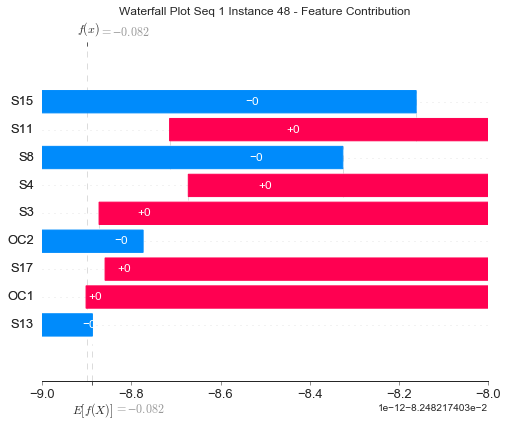

None

Contribution: [-1.54136483e-13  1.53148991e-13  1.14594588e-14  2.86990998e-13
 -2.00977689e-13  1.62421902e-13 -1.38303804e-16 -1.71982410e-13
 -1.58176315e-13]


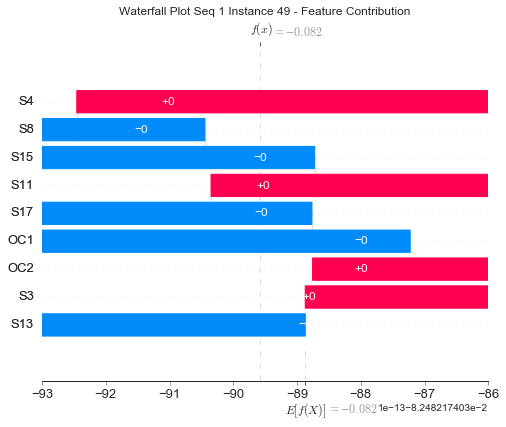

None

Contribution: [-1.56415815e-13  1.31396941e-13  1.29716641e-14  2.24552324e-13
 -1.48690305e-13  1.12630723e-13  4.91574843e-17 -1.76249003e-13
 -1.17086394e-13]


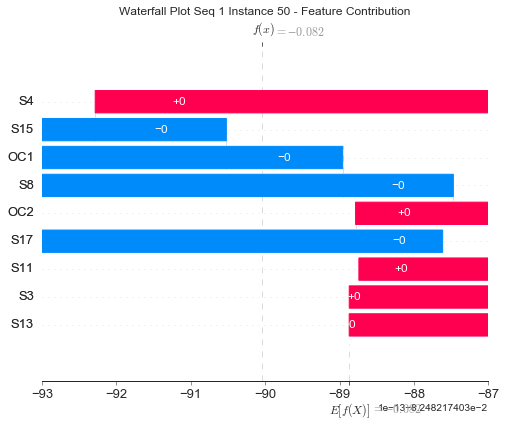

None

Contribution: [ 2.13822050e-14 -1.01758486e-13  2.11755160e-13  3.74639013e-13
 -4.71964752e-13  6.17469021e-13 -3.40895491e-14 -7.80923340e-13
  6.83055365e-14]


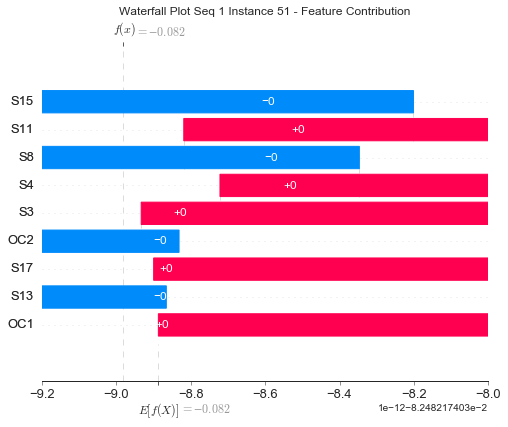

None

Contribution: [-7.12370972e-14  9.40906695e-14  4.11856896e-15  9.45476743e-14
 -6.95590639e-14  5.90344627e-14 -1.33035511e-16 -1.32784639e-13
 -5.46950519e-14]


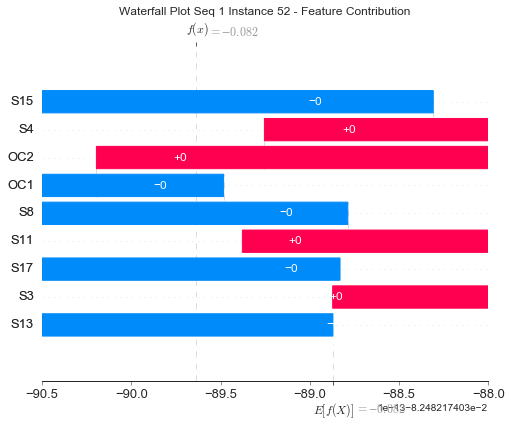

None

Contribution: [ 1.23847953e-13 -1.71245071e-13 -1.99063205e-13 -7.08887213e-13
  4.99486845e-13 -5.94479706e-13  6.19160146e-14  9.29140011e-13
  8.57954116e-14]


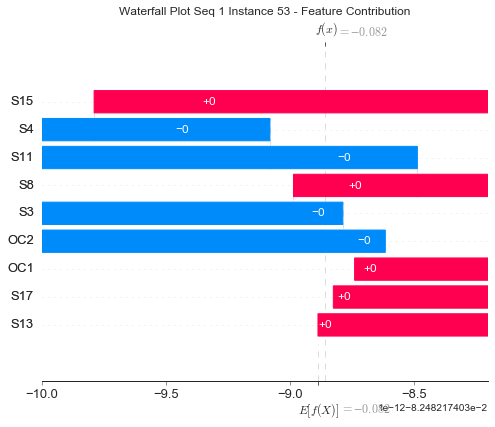

None

Contribution: [ 1.49894406e-14  2.76007295e-14 -9.54739709e-15 -1.21300038e-13
  1.02713953e-13 -7.90296715e-14 -2.46259560e-17 -9.80375584e-14
  7.10284289e-14]


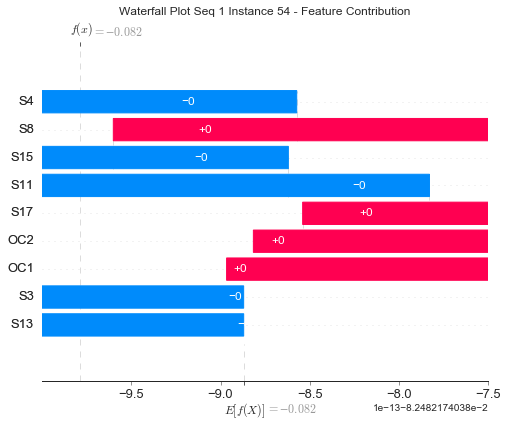

None

Contribution: [-2.23689645e-14  7.45682677e-14 -3.34954309e-15  8.00498334e-16
  2.18847242e-14 -1.47647313e-14  1.12637432e-18 -1.49185311e-13
  7.28238270e-15]


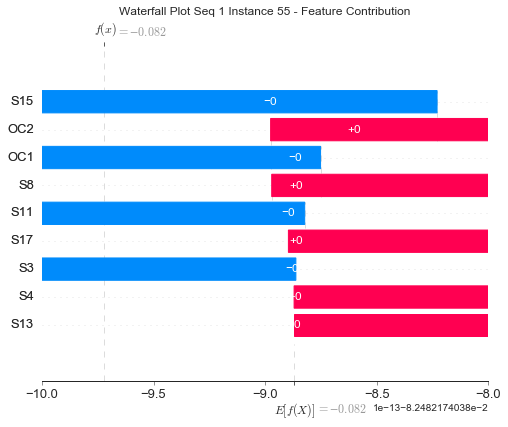

None

Contribution: [ 4.22784569e-14  6.71894486e-15 -1.40762688e-14 -1.37430757e-13
  1.26074390e-13 -9.01862203e-14 -4.18951512e-18 -7.08615363e-14
  9.16375537e-14]


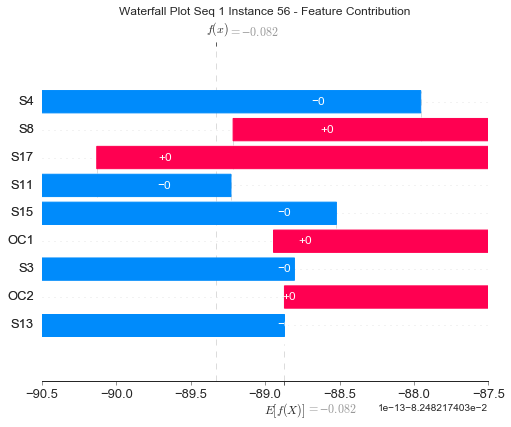

None

Contribution: [-2.13745823e-13  2.16140528e-13  3.95183391e-14  3.95069800e-13
 -1.87072105e-13  1.87697880e-13 -1.30492427e-16 -3.43956607e-13
 -1.50413007e-13]


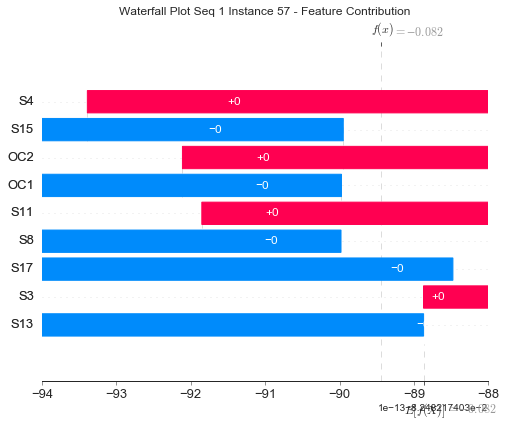

None

Contribution: [ 1.97533165e-13 -2.77273403e-13 -2.39036459e-14 -4.35491568e-13
  1.97276603e-13 -2.42858224e-13  6.67894991e-18  3.47859084e-13
  2.07061378e-13]


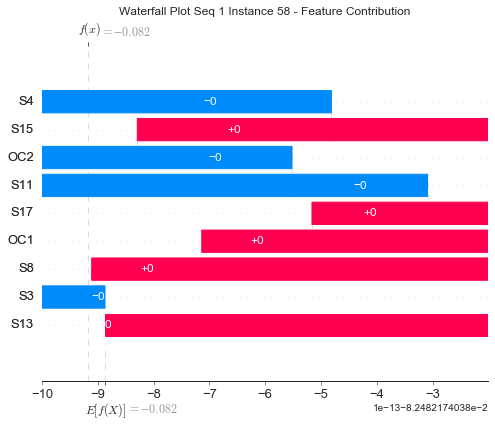

None

Contribution: [ 5.82916555e-14 -1.15770281e-13 -1.78451440e-15 -8.28695226e-14
  1.44331365e-15 -4.73780493e-14  2.85512009e-17  1.81971097e-13
  1.07344155e-14]


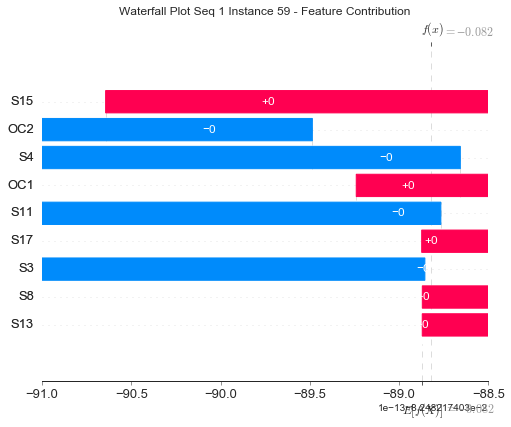

None

Contribution: [ 1.17957927e-14  8.16886706e-14 -1.16847509e-14 -9.21808135e-14
  1.00879178e-13 -5.65363389e-14 -7.08655557e-18 -1.50611796e-13
  4.63755621e-14]


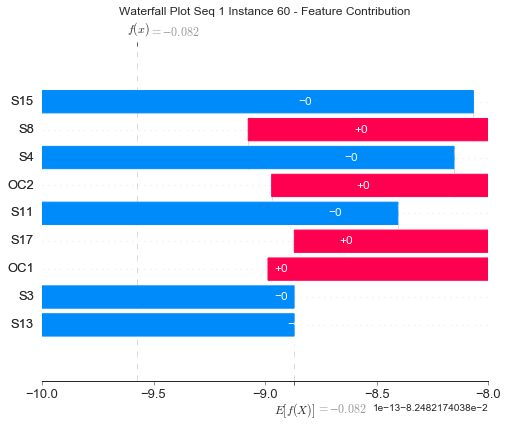

None

Contribution: [-6.23575873e-15 -9.54660748e-14  3.38565737e-13  8.11506895e-13
 -8.52812179e-13  8.89446719e-13 -1.15776353e-13 -1.21182274e-12
  2.02928579e-14]


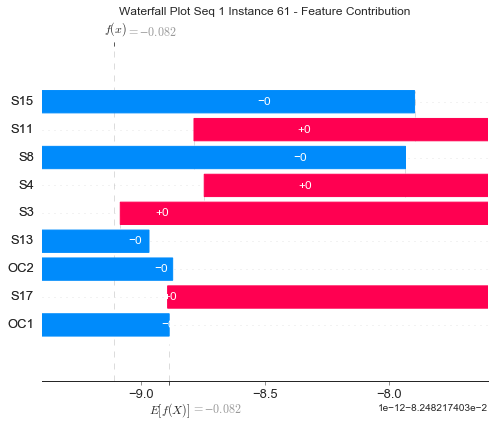

None

Contribution: [-1.34928079e-13  2.94278870e-13 -1.16257752e-13  6.97852962e-14
  1.28585104e-13 -1.96074331e-13  2.13301158e-14  1.10639694e-13
 -1.83764326e-13]


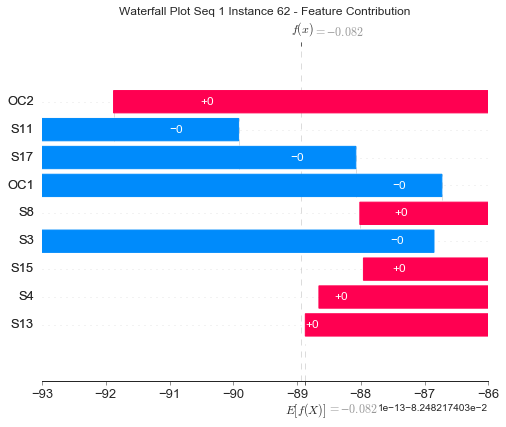

None

Contribution: [-9.58915158e-15 -1.93391530e-14  8.43939312e-14  2.29227797e-13
 -2.94573773e-13  2.58228578e-13 -4.41454192e-14 -3.96304680e-13
 -1.64687737e-15]


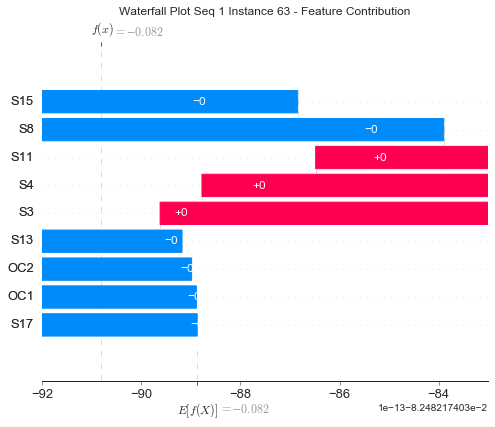

None

Contribution: [ 6.56159290e-14 -1.76326008e-13  7.49826769e-15 -1.37804007e-13
  1.77107051e-14 -7.85494987e-14  6.55098061e-17  1.93059178e-13
  4.41043042e-14]


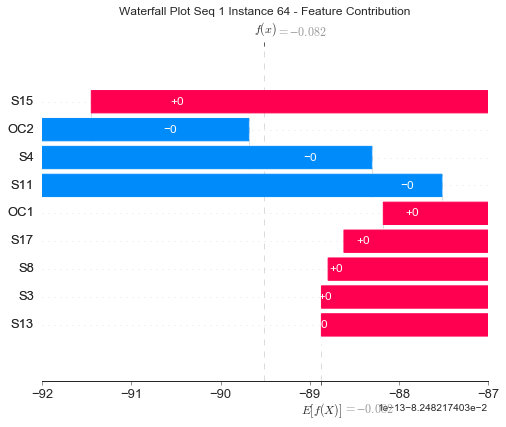

None

Contribution: [ 3.00245160e-14  1.23212599e-15 -1.73010901e-14 -5.20420295e-14
  2.47825747e-14  1.94656794e-14 -9.12000507e-17 -2.44800230e-14
  2.48027404e-15]


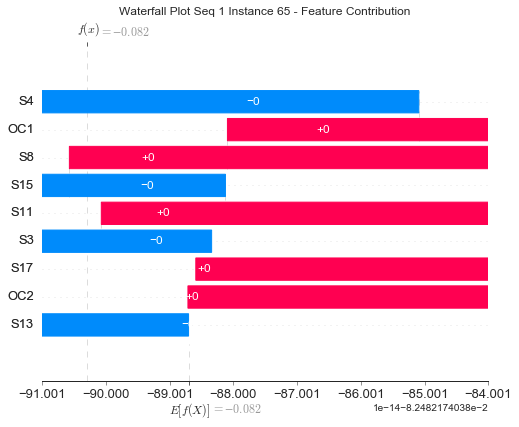

None

Contribution: [-8.79382220e-14  1.09480601e-13 -1.44726389e-15  1.71445513e-13
 -6.96315225e-14  9.14310403e-14 -1.07917596e-16 -1.69991584e-13
 -7.67351677e-14]


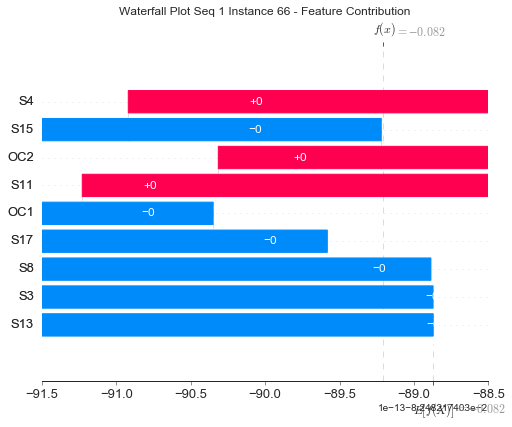

None

Contribution: [-5.79561491e-14  2.35084711e-13 -8.99983094e-15  6.44809388e-14
  4.34321056e-14  3.30236767e-14 -2.72561802e-17 -3.75054995e-13
 -2.46797245e-14]


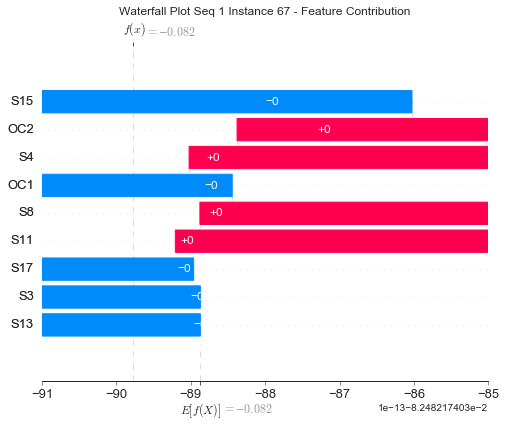

None

Contribution: [ 2.57954167e-13 -3.54310765e-13 -4.06524349e-14 -5.07988616e-13
  1.74469529e-13 -2.80600115e-13  6.29851673e-18  5.18090779e-13
  1.68821242e-13]


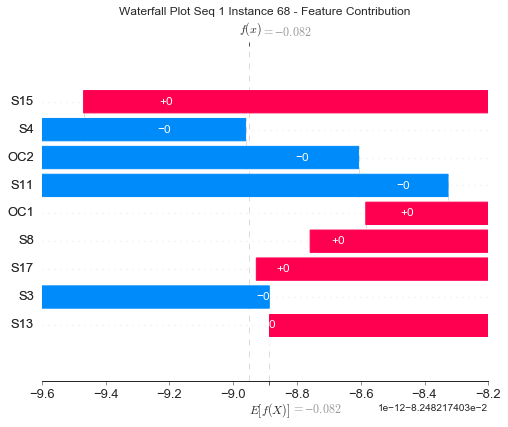

None

Contribution: [ 6.57965368e-14 -1.58551202e-14 -1.81408030e-13 -5.82239606e-13
  5.07283560e-13 -5.10540015e-13  5.64933774e-14  5.17996128e-13
  9.17683423e-14]


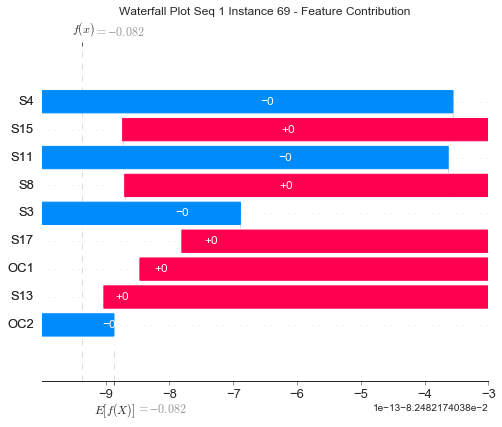

None

Contribution: [ 7.88565787e-14 -1.08547564e-13  6.46742478e-15 -1.07777075e-13
  4.68823893e-14 -9.80538079e-14  5.06391448e-16  1.46719307e-13
  5.98069229e-14]


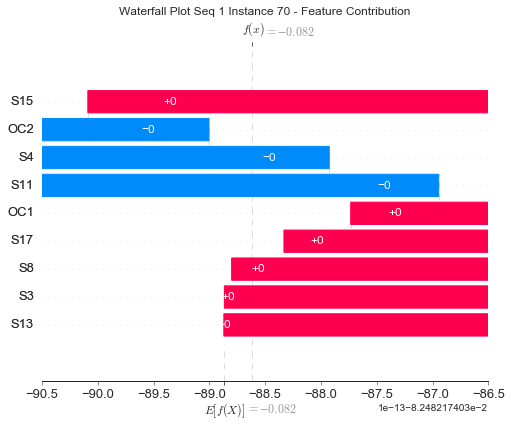

None

Contribution: [-3.42656811e-14 -7.96384714e-14  5.04165611e-13  1.02411612e-12
 -1.06989081e-12  1.31997776e-12 -1.14837190e-13 -1.95107342e-12
  1.02018322e-13]


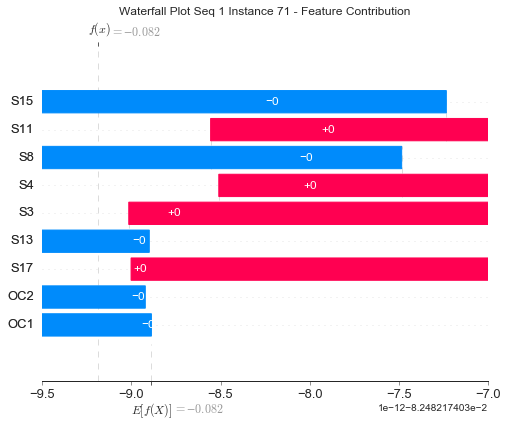

None

Contribution: [-9.06466962e-15 -4.73244321e-14  1.23906656e-14 -1.16858232e-14
 -4.87203051e-14 -2.28586461e-14 -1.80228511e-17  2.31577385e-14
 -1.36429471e-14]


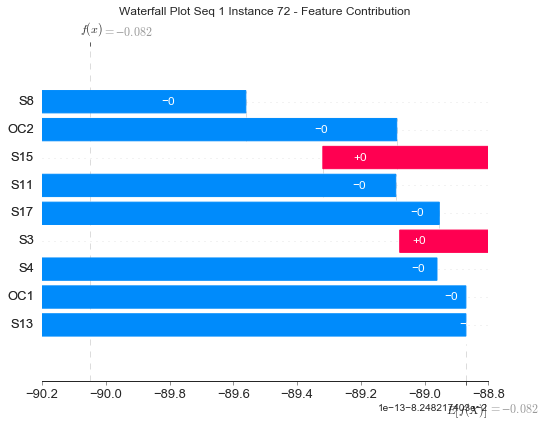

None

Contribution: [-2.52502067e-13  2.13137599e-13  3.19600676e-14  4.14047025e-13
 -2.61331131e-13  2.11675987e-13 -2.42925158e-16 -3.18648753e-13
 -1.90254361e-13]


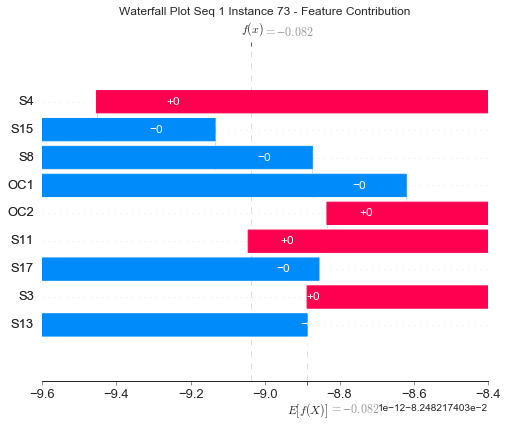

None

Contribution: [-1.49910141e-13  1.70786440e-13 -7.66778015e-15  2.48822393e-13
 -1.15759087e-13  1.39683390e-13 -2.14965792e-16 -2.75800704e-13
 -1.03734187e-13]


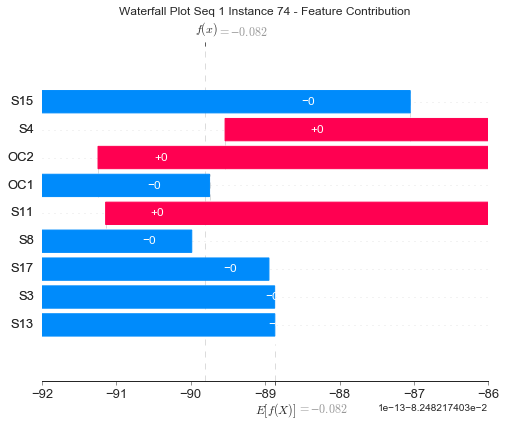

None

Contribution: [-3.95929383e-13  4.22720967e-13  7.20521028e-13  2.22631028e-12
 -1.53634744e-12  1.73554422e-12 -2.21308676e-13 -3.07714314e-12
 -1.97040938e-13]


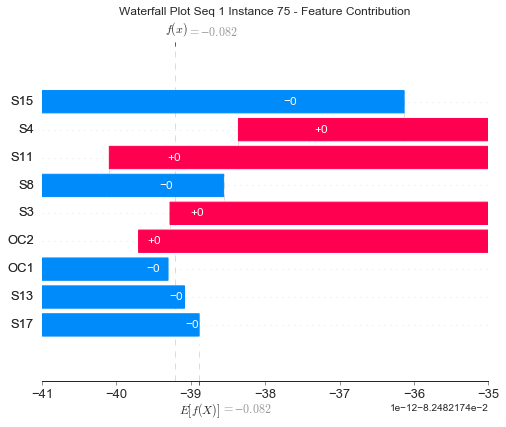

None

Contribution: [-4.01192263e-13  4.83245388e-13  5.12864186e-14  7.59075637e-13
 -4.74766548e-13  4.04231715e-13 -2.81668233e-16 -6.42867216e-13
 -3.72616732e-13]


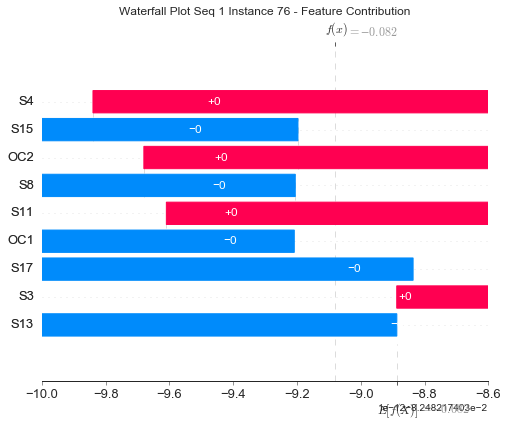

None

Contribution: [ 2.40779646e-13 -1.37739104e-13 -3.32272357e-14 -5.75422414e-13
  4.01527309e-13 -3.42818710e-13 -8.74037019e-17  1.23302247e-13
  2.94849323e-13]


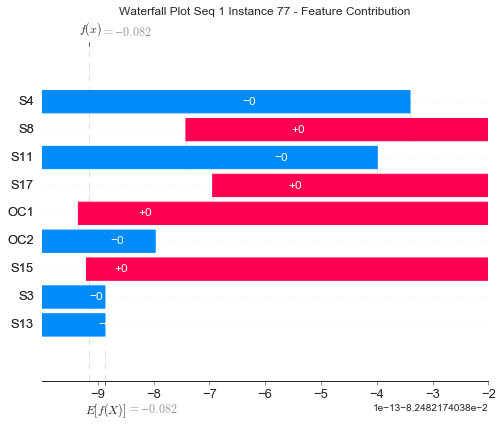

None

Contribution: [-5.89974684e-13  5.21160534e-13  9.21291038e-14  9.16577903e-13
 -4.12008969e-13  4.06572589e-13  1.31686651e-16 -8.93044644e-13
 -3.50039090e-13]


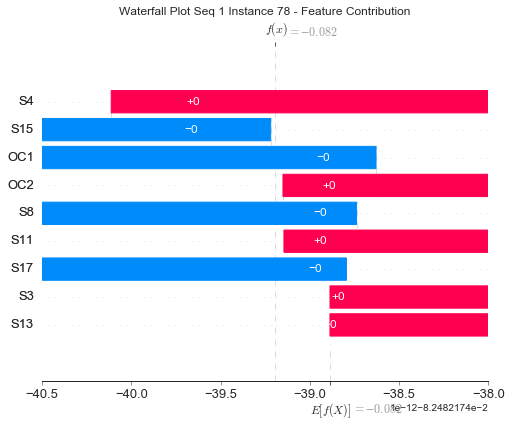

None

Contribution: [-3.06204226e-13  3.14593973e-13  5.11264920e-14  5.65504512e-13
 -2.77866028e-13  2.47725939e-13 -3.37823606e-16 -4.68497582e-13
 -2.35860024e-13]


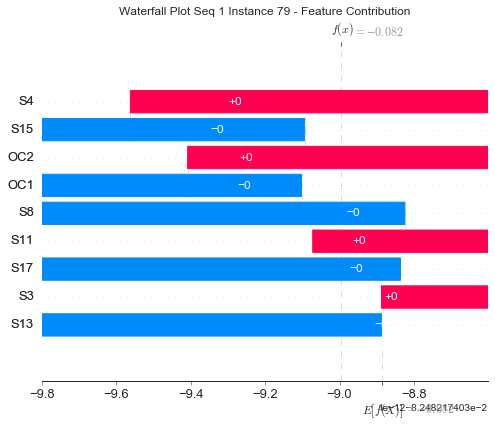

None

Contribution: [-1.22232655e-13  1.09771045e-13  2.35501544e-15  3.70016924e-13
 -2.77808104e-13  1.98285859e-13 -2.33169933e-16 -7.27275092e-14
 -2.10540556e-13]


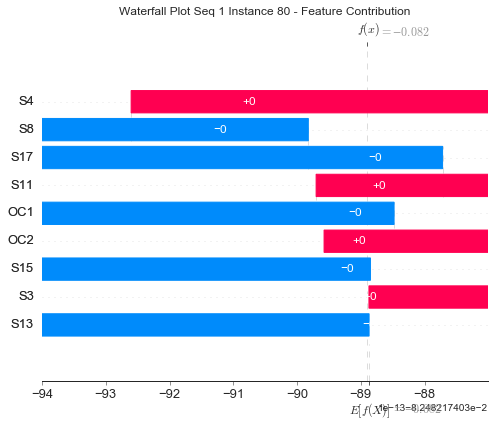

None

Contribution: [-1.31977369e-13  2.04637305e-13 -2.12645277e-13 -2.75400335e-13
  3.45150422e-13 -6.94908215e-13  7.30545046e-14  6.96605263e-13
 -2.24474234e-13]


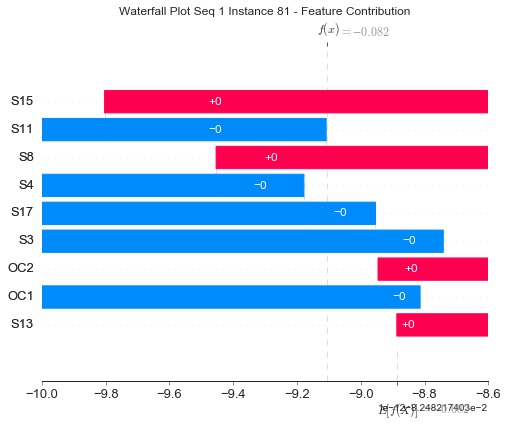

None

Contribution: [ 6.27079768e-13 -8.29156297e-13 -1.42943722e-14 -1.18306569e-12
  5.59772877e-13 -6.46066967e-13  1.24240816e-17  9.91358146e-13
  4.98683397e-13]


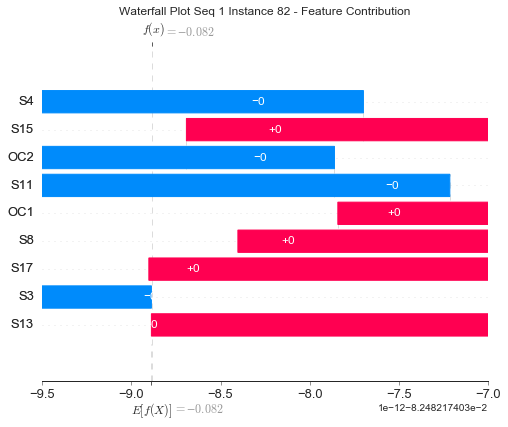

None

Contribution: [ 3.83273134e-15 -1.85118617e-13  4.68982546e-13  9.33070461e-13
 -1.07205672e-12  1.21661568e-12 -1.41290584e-13 -1.60525814e-12
  9.73986178e-14]


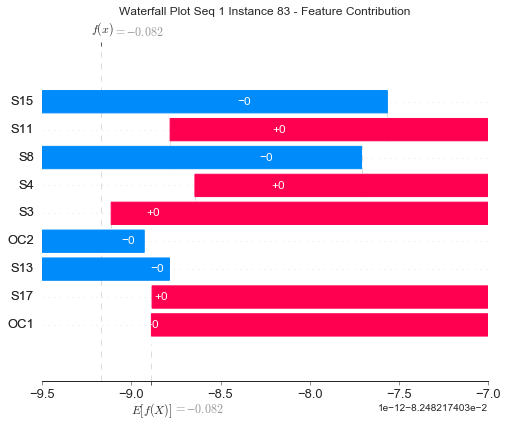

None

Contribution: [ 2.02158372e-13 -1.53940351e-13 -1.75520012e-13 -1.10728657e-12
  1.01100823e-12 -9.46457105e-13  9.69299917e-14  7.60107363e-13
  3.87974212e-13]


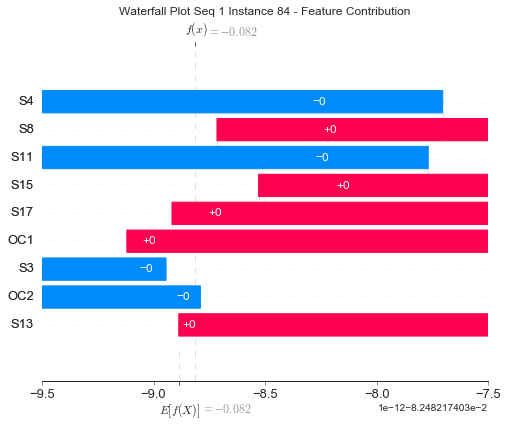

None

Contribution: [-3.30674588e-13  4.30390099e-13  9.85342331e-15  7.10246206e-13
 -3.18077921e-13  2.92687370e-13  4.39915137e-16 -5.81197742e-13
 -3.29435020e-13]


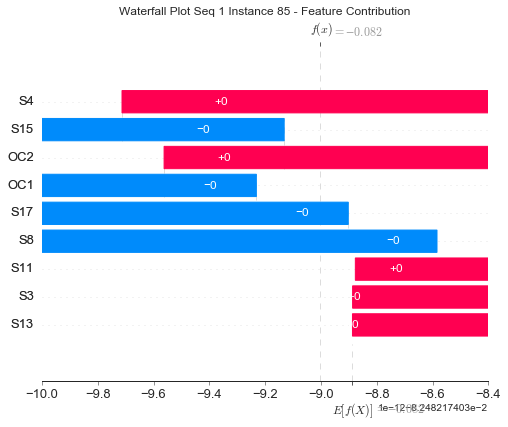

None

Contribution: [-2.06388234e-14 -2.47689781e-13  9.74681165e-13  1.93804131e-12
 -1.95936258e-12  2.19070465e-12 -1.92402328e-13 -3.02401940e-12
  1.64407902e-13]


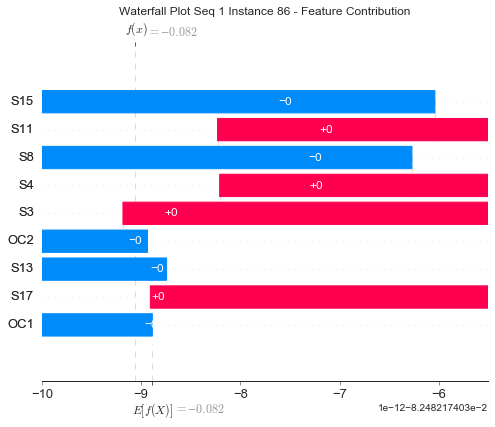

None

Contribution: [-2.34008640e-13  2.03942738e-13  1.41472552e-14  5.77319442e-13
 -5.45160922e-13  2.94778606e-13 -4.60683274e-16 -2.21944858e-13
 -3.72873499e-13]


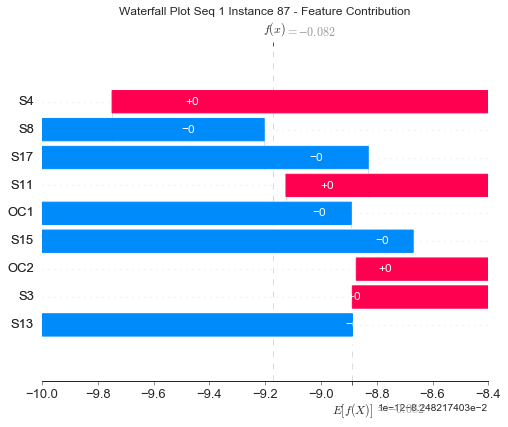

None

Contribution: [-7.22459473e-14  7.24352151e-14  8.32276278e-15  9.22755050e-14
 -9.51665843e-14  4.59719204e-14  1.74541594e-16 -1.21248890e-13
 -7.13211703e-14]


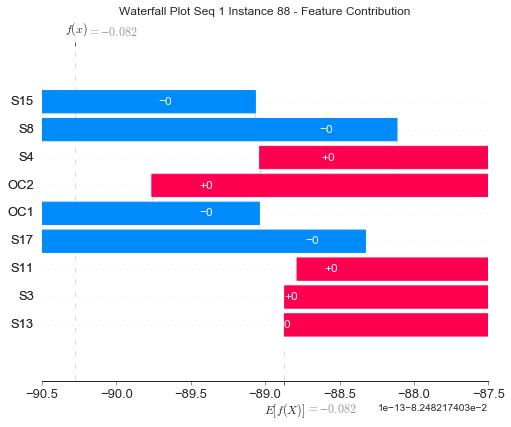

None

Contribution: [ 7.00195273e-13 -8.24872451e-13 -5.67899514e-13 -2.49367714e-12
  1.35076401e-12 -1.71637400e-12  1.34496282e-13  2.83601137e-12
  4.61855489e-13]


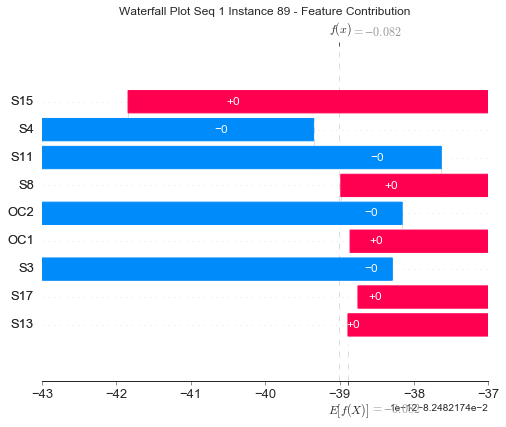

None

Contribution: [-7.81694533e-13  7.79635850e-13  9.61212108e-14  1.41455066e-12
 -6.67859919e-13  8.31466840e-13 -2.58840563e-16 -1.22724541e-12
 -5.63590732e-13]


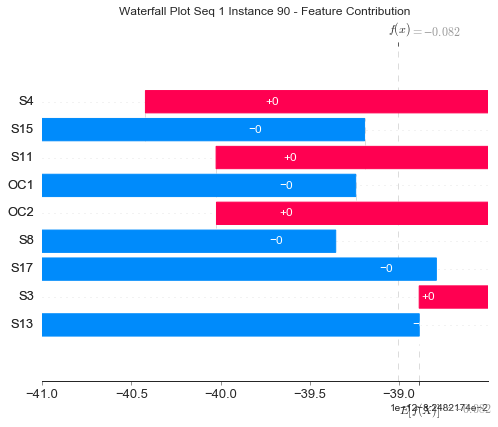

None

Contribution: [-3.94368891e-13  6.46391469e-13 -4.19631588e-13 -3.29469714e-13
  5.37173658e-13 -1.04447375e-12  6.17463708e-14  8.35530213e-13
 -4.85754937e-13]


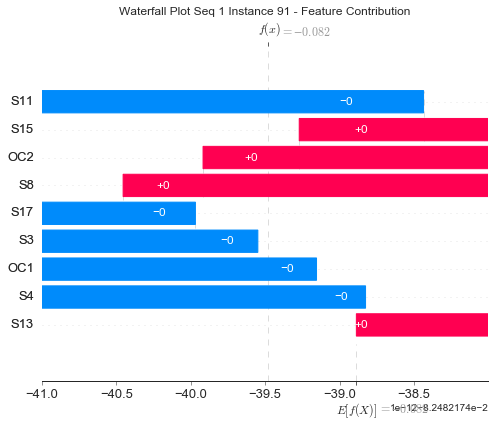

None

Contribution: [-2.16956512e-14  2.70844439e-15  6.56945405e-14 -9.05584405e-14
 -6.80793245e-14 -1.29593832e-13 -5.22613717e-16 -1.12602785e-13
 -6.81595893e-15]


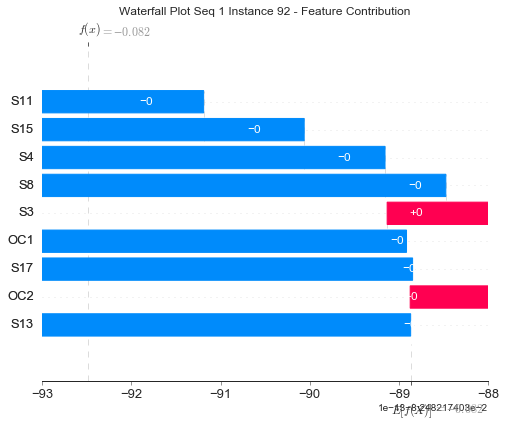

None

Contribution: [ 4.26822477e-13 -8.31070943e-13  8.03752274e-15 -8.89254816e-13
  3.02451938e-13 -5.36681268e-13  1.91261204e-16  9.27183569e-13
  3.83227060e-13]


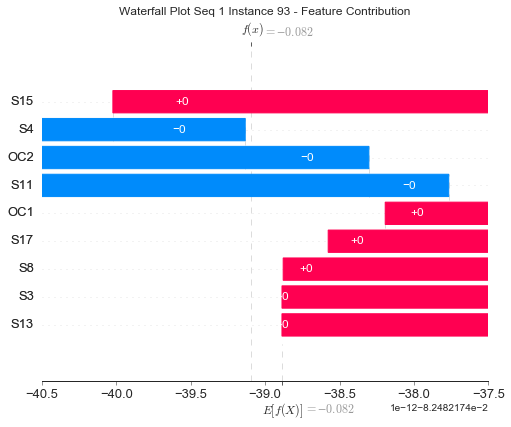

None

Contribution: [-8.64110012e-14 -1.00653826e-13  6.58403616e-13  1.79644309e-12
 -1.86060889e-12  1.84268139e-12 -2.20659645e-13 -2.58259516e-12
 -6.04037762e-14]


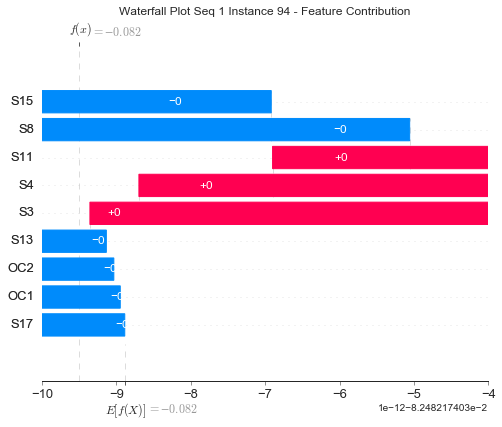

None

Contribution: [ 8.08332730e-13 -1.09490693e-12 -9.91261110e-13 -4.26581903e-12
  3.13884639e-12 -3.57325541e-12  4.96390364e-13  5.22355726e-12
  6.44372630e-13]


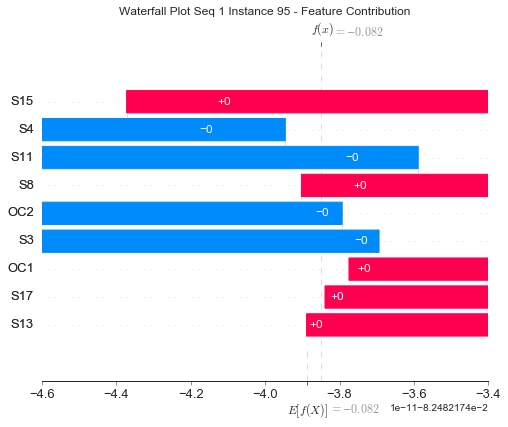

None

Contribution: [-2.23712108e-13 -1.19064264e-13  1.07018138e-12  2.79869379e-12
 -2.84030481e-12  3.05645158e-12 -3.63317585e-13 -4.11812034e-12
 -4.16645918e-14]


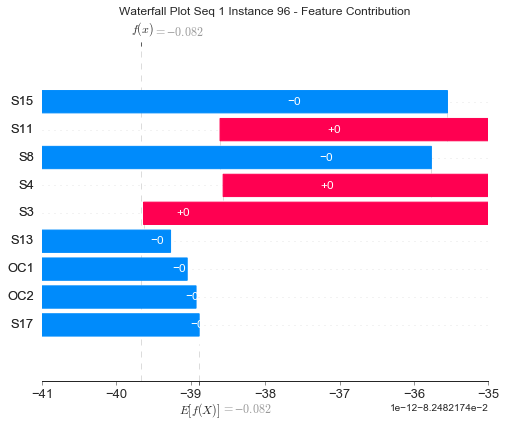

None

Contribution: [ 8.41329176e-13 -1.04432467e-12 -2.86542816e-13 -2.39759905e-12
  1.41739637e-12 -1.57795652e-12  1.15383736e-13  1.93913787e-12
  8.66896832e-13]


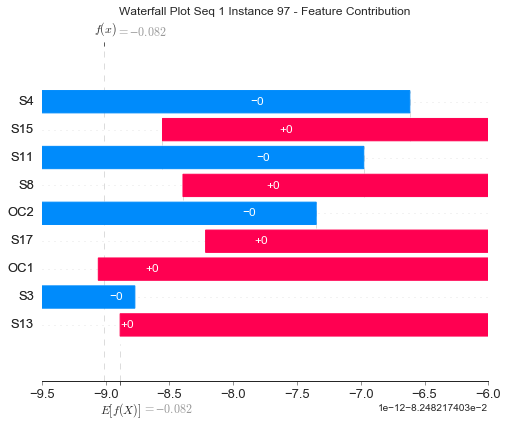

None

Contribution: [ 6.77770123e-13 -8.62101677e-13 -4.73752676e-14 -1.09947728e-12
  4.05203350e-13 -6.85323434e-13  1.01373260e-16  1.23952823e-12
  4.23644138e-13]


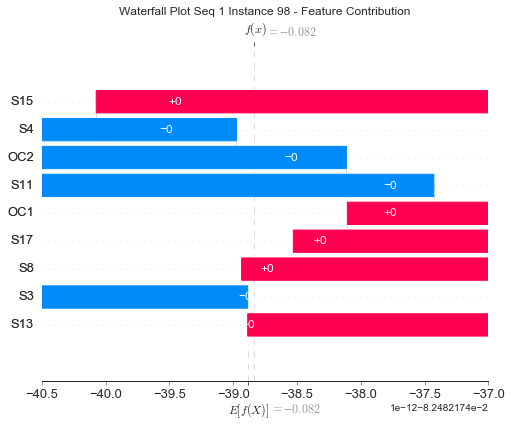

None

Contribution: [-4.42692554e-14  1.42295775e-15  1.16487749e-14 -7.89997543e-14
 -2.47802115e-14 -7.48543683e-14 -8.24829633e-17 -7.53989156e-14
 -1.56611924e-15]


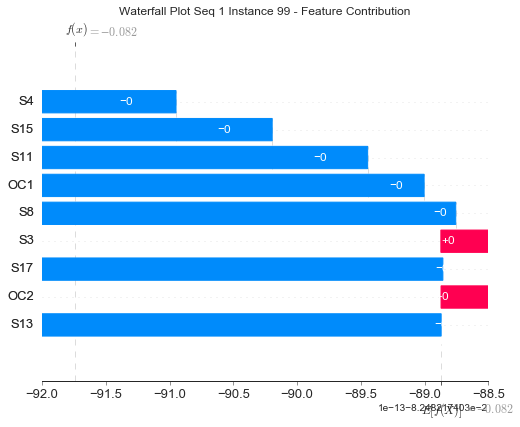

None

Contribution: [ 6.39751435e-13 -7.49818285e-13 -7.82715838e-14 -1.30200625e-12
  6.54766714e-13 -7.44975533e-13 -1.19267745e-16  8.41862224e-13
  6.44882531e-13]


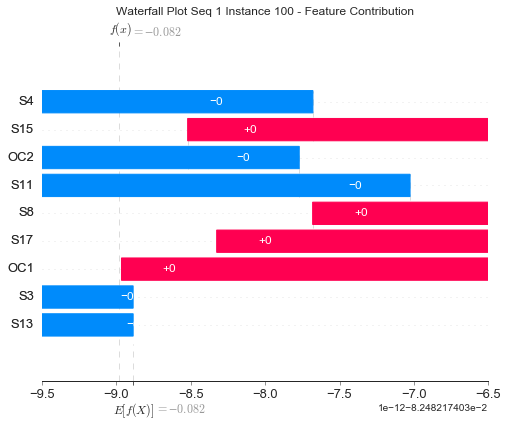

None

Contribution: [ 2.37524217e-14 -3.90951366e-17 -3.46013501e-14 -1.80880769e-13
  3.13901466e-14 -4.44653740e-14 -3.58669961e-16 -6.32528714e-15
  6.29239516e-15]


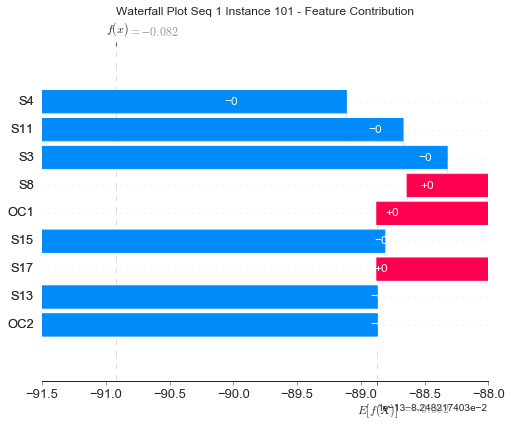

None

Contribution: [ 2.34688408e-13 -5.14995056e-13  2.52430747e-15 -3.54552081e-13
 -2.09730271e-14 -2.39270599e-13  1.60250362e-16  6.01913430e-13
  1.05393877e-13]


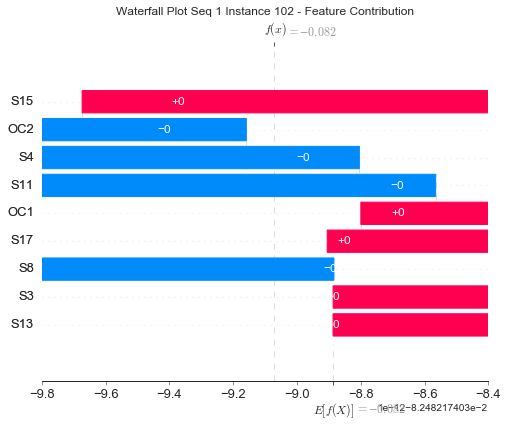

None

Contribution: [ 1.71741690e-12 -1.55975970e-12 -2.95851153e-13 -3.08144157e-12
  1.46267417e-12 -1.73222276e-12 -2.62230892e-16  2.40317878e-12
  1.19269525e-12]


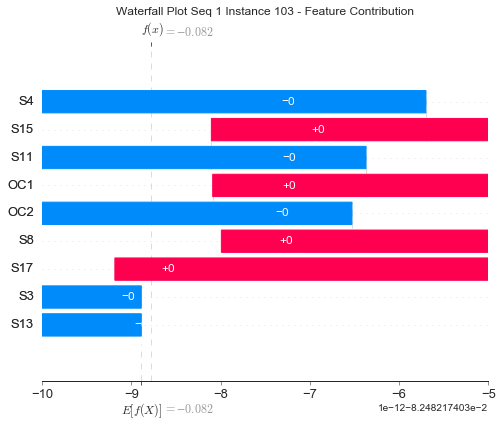

None

Contribution: [ 9.06824312e-13 -1.07052832e-12 -1.25175491e-13 -1.98174485e-12
  9.06139801e-13 -1.01663426e-12 -5.53739393e-18  1.43558223e-12
  8.10670324e-13]


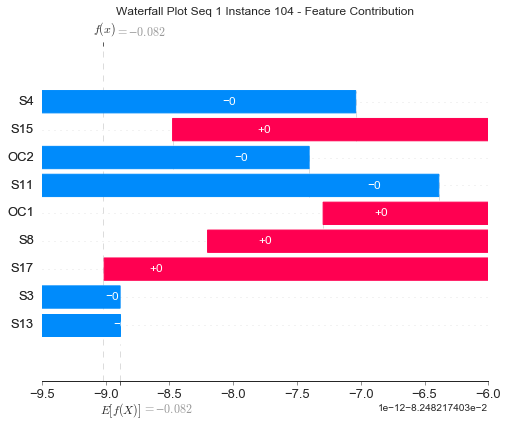

None

Contribution: [-1.80381372e-13  5.02484935e-13 -4.76834175e-13 -5.95846018e-13
  8.59761589e-13 -1.22388406e-12  7.22155286e-14  1.29571354e-12
 -3.77050008e-13]


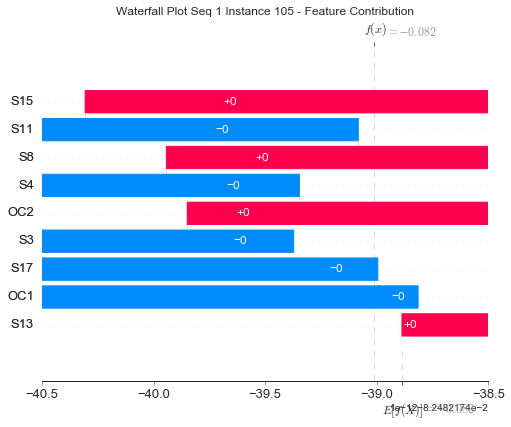

None

Contribution: [ 7.76875580e-13 -9.52906699e-13 -2.06819679e-14 -1.78524676e-12
  9.61882700e-13 -1.07725872e-12  2.95332055e-15  9.69653719e-13
  8.40617506e-13]


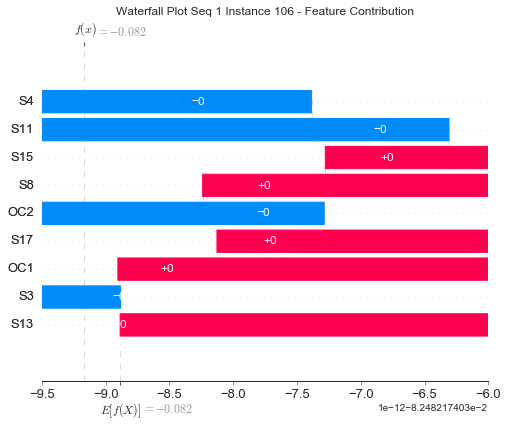

None

Contribution: [ 2.22742492e-13 -5.78304386e-13  7.44291673e-13  1.53660938e-12
 -2.22583692e-12  2.84506468e-12 -1.99771907e-13 -3.75616942e-12
  3.78714963e-13]


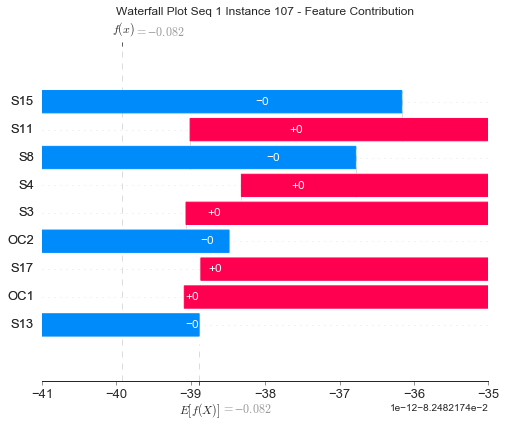

None

Contribution: [-2.20801879e-13  3.28148661e-14  1.32593611e-12  3.89388825e-12
 -3.84273559e-12  3.95725726e-12 -6.38449092e-13 -5.19662351e-12
 -1.37332420e-13]


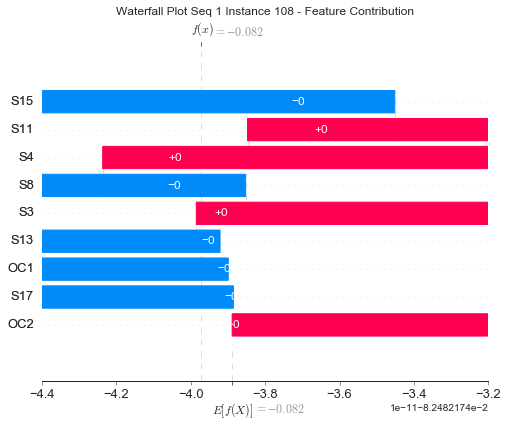

None

Contribution: [-5.29619155e-13  1.12253588e-12 -6.61033240e-13 -2.60281000e-13
  1.08134432e-12 -1.87828160e-12  1.88990967e-13  1.62438476e-12
 -7.84621283e-13]


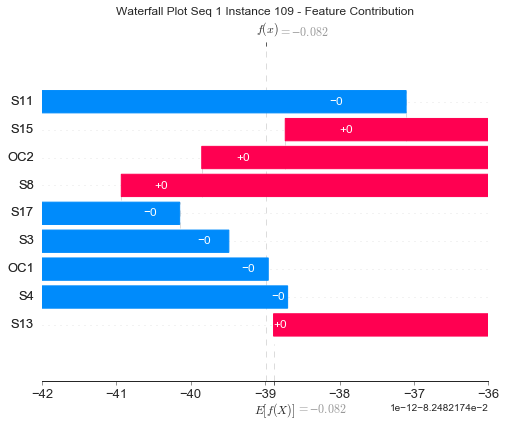

None

Contribution: [-3.26570802e-13  7.97855814e-13 -1.52657741e-15  4.31570686e-13
 -9.80672317e-14  2.44565842e-13 -3.03455873e-17 -1.07023049e-12
 -1.90759396e-13]


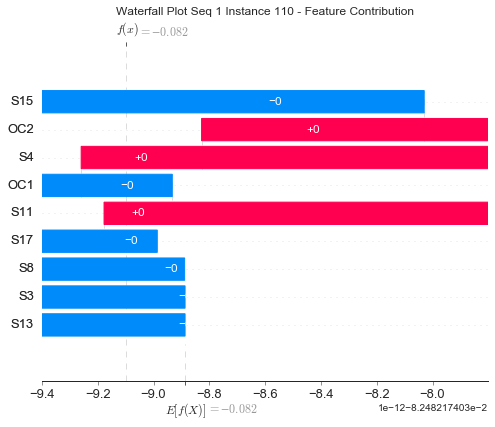

None

Contribution: [-1.01053020e-12  7.43549482e-13  1.75059443e-13  1.66981847e-12
 -8.89381505e-13  7.82466106e-13 -4.65129667e-16 -1.30605346e-12
 -6.85137656e-13]


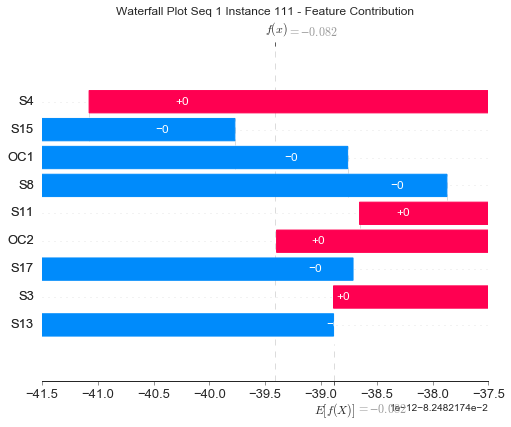

None

Contribution: [-1.10321518e-12  1.32821553e-12 -1.21371446e-13  1.50400070e-12
 -4.48859699e-13  1.81215001e-13  2.45167469e-14 -8.31365738e-13
 -9.83870646e-13]


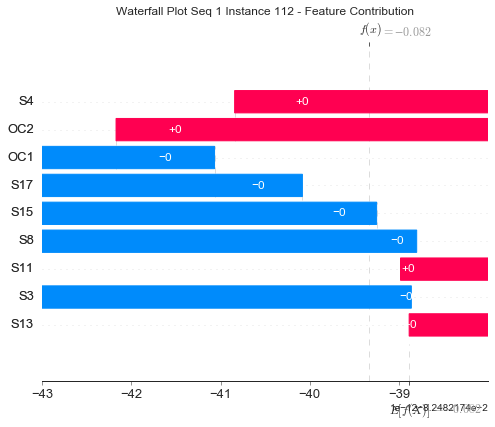

None

Contribution: [-2.67634276e-13  6.61328902e-13 -1.28665607e-15  2.25684502e-13
  3.13723284e-14  7.74984257e-14 -3.07499529e-17 -1.01781431e-12
 -7.22697116e-14]


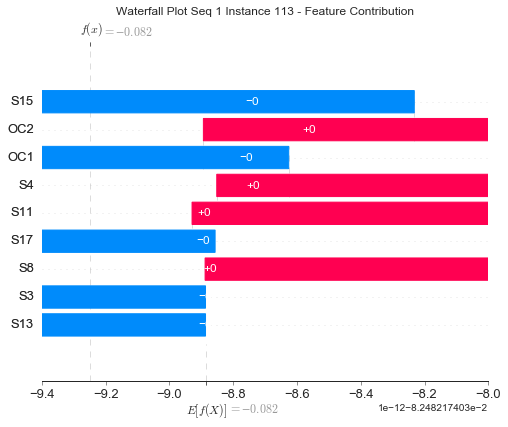

None

Contribution: [-5.86309267e-13  8.25278160e-13 -7.08772234e-13 -5.38200832e-13
  1.19234776e-12 -1.63724503e-12  8.95802665e-14  1.95028260e-12
 -6.10998827e-13]


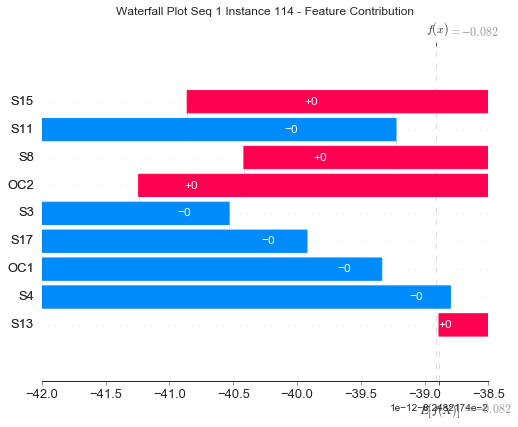

None

Contribution: [-4.99560191e-13  5.29001105e-13  3.30177847e-14  6.75956307e-13
 -4.56534821e-13  3.54050583e-13 -7.05322641e-16 -7.93141377e-13
 -3.59649024e-13]


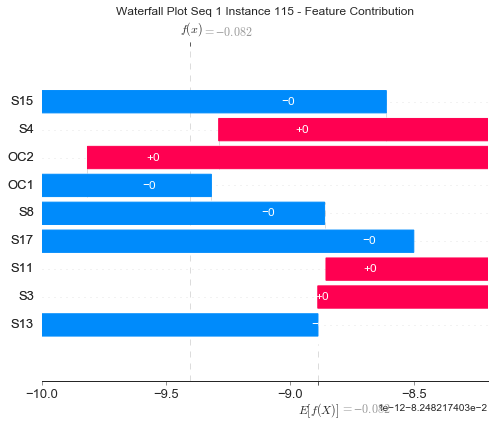

None

Contribution: [-9.41004138e-14 -1.58753625e-13  1.17034594e-12  2.66720803e-12
 -2.56491898e-12  2.78363400e-12 -3.75495316e-13 -3.58052693e-12
  3.09510413e-14]


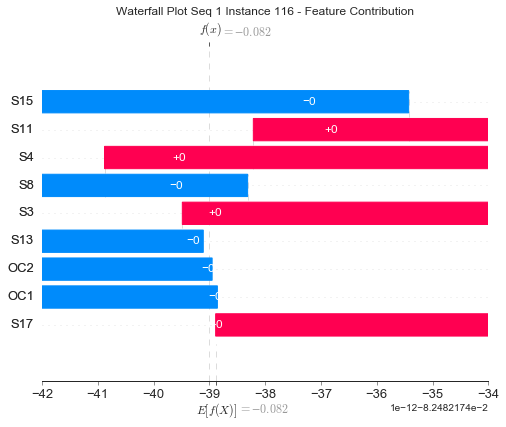

None

Contribution: [ 3.26196535e-13 -2.65924381e-13 -5.95679054e-15 -9.38988796e-13
  7.29560455e-13 -6.28416644e-13 -3.91734712e-16  8.16585569e-14
  5.29583322e-13]


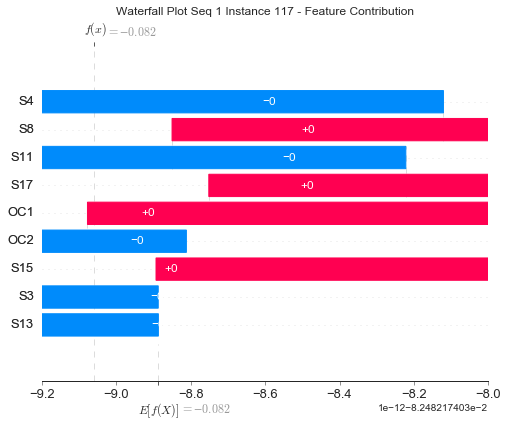

None

Contribution: [-6.13517375e-13  5.79952048e-13  2.84991757e-14  1.09410376e-12
 -6.25709283e-13  5.93359238e-13  7.12382555e-16 -8.42677165e-13
 -5.50999947e-13]


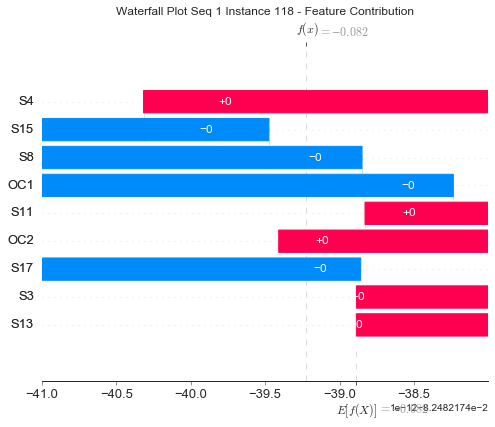

None

Contribution: [-9.59524344e-13  1.28828784e-12 -3.33602070e-13  9.78200810e-13
  6.33439766e-14 -2.24438442e-13  8.39010952e-15  3.69114969e-14
 -9.85390805e-13]


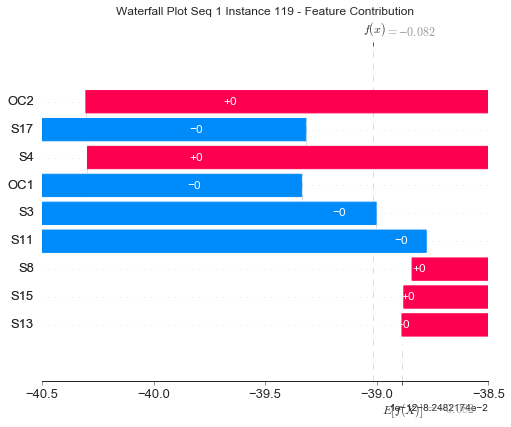

None

Contribution: [-2.11162237e-13  3.57057862e-13 -4.67012063e-13 -3.75092481e-13
  6.17925361e-13 -1.09235179e-12  1.51957050e-14  1.33184783e-12
 -4.13050616e-13]


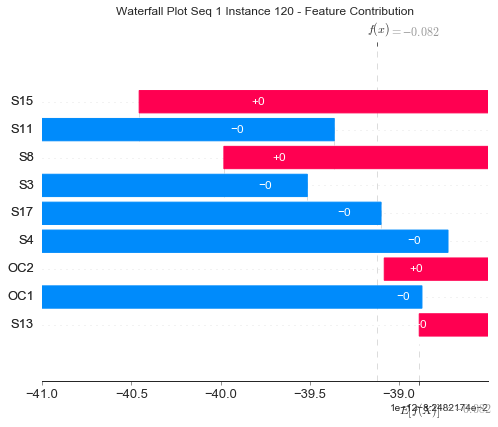

None

Contribution: [-6.27746282e-13  9.09792749e-13 -3.30713348e-13  4.80320265e-13
  2.09183189e-13 -4.65152114e-13  4.34639405e-14  4.77834081e-13
 -7.25221261e-13]


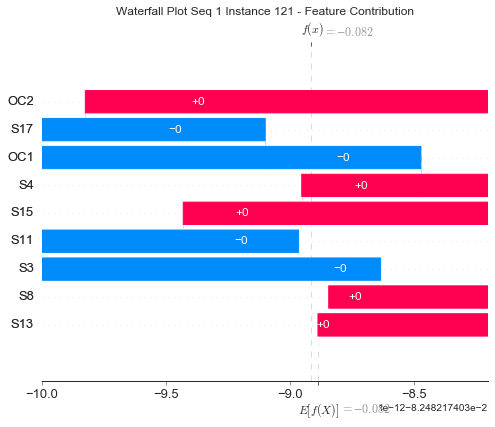

None

Contribution: [-5.68718033e-13  8.39181264e-13 -3.88041053e-13  3.85087172e-13
  3.12335851e-13 -5.65571786e-13  7.13365321e-14  2.48399473e-13
 -6.02906342e-13]


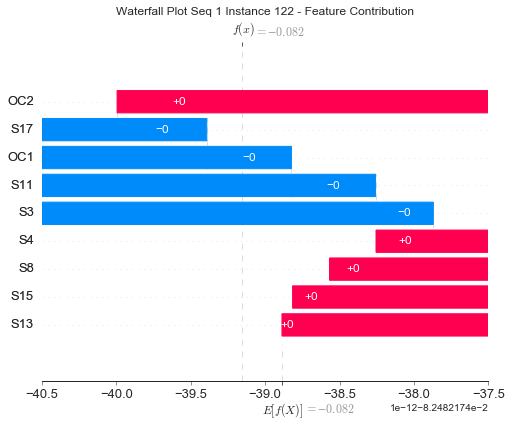

None

Contribution: [ 7.86411680e-13 -1.32579473e-12 -7.99297304e-15 -1.28678047e-12
  3.35375309e-13 -7.46995890e-13  1.37949652e-16  1.57491750e-12
  4.54258647e-13]


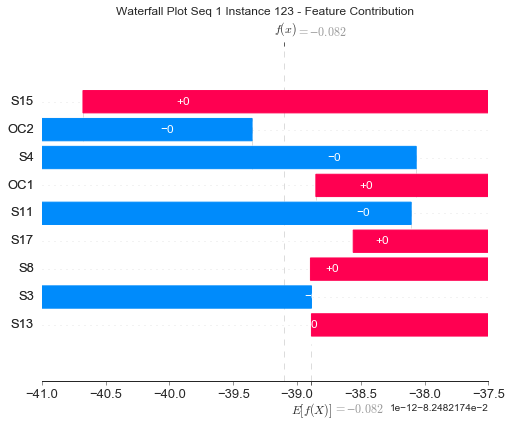

None

Contribution: [ 4.97602380e-14 -6.11820490e-13  1.53834920e-12  2.40245128e-12
 -2.92765508e-12  3.51630400e-12 -3.00653545e-13 -4.83814854e-12
  4.18849281e-13]


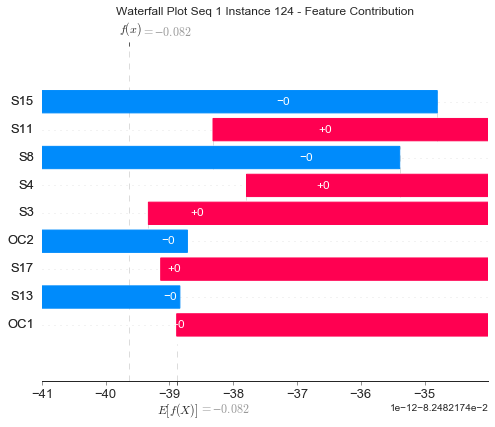

None

Contribution: [ 1.93010416e-13 -9.26330545e-14 -1.79845966e-14 -4.35732044e-13
  2.92051295e-13 -2.69554588e-13 -5.12079625e-17  5.75871019e-15
  2.33833759e-13]


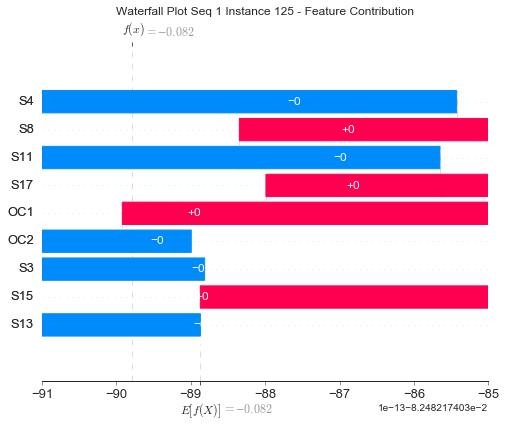

None

Contribution: [-9.35105485e-15 -3.93993106e-13  1.35983347e-12  3.38503943e-12
 -3.58565868e-12  3.91934445e-12 -4.09599736e-13 -5.42595786e-12
  1.00678146e-13]


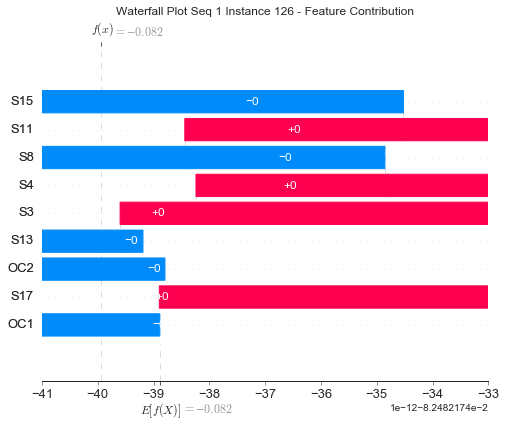

None

Contribution: [-2.50962256e-13  3.87132736e-13  2.56470406e-16  4.70363494e-13
 -2.20073078e-13  3.35657229e-13 -7.32609966e-16 -5.65878670e-13
 -1.90079804e-13]


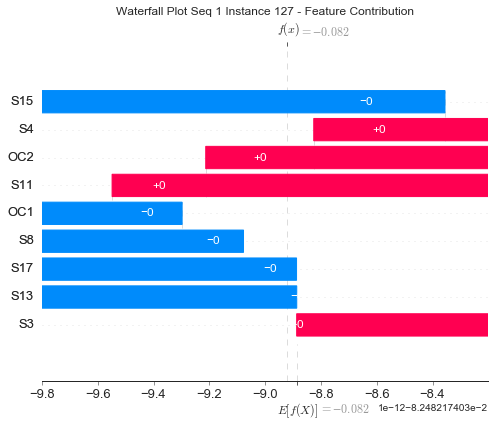

None

Contribution: [-3.86165112e-13  6.27230689e-13 -3.21726254e-14  7.67208020e-13
 -3.45135894e-13  5.13665987e-13  6.13863253e-16 -7.15573705e-13
 -4.09488253e-13]


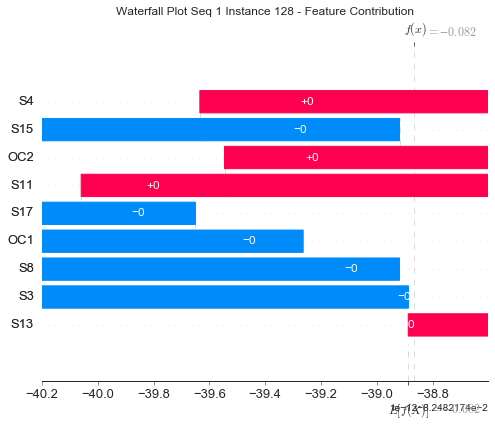

None

Contribution: [ 1.05956140e-12 -1.48803918e-12 -8.91380611e-14 -2.37009739e-12
  1.01978332e-12 -1.42232114e-12 -1.20721505e-16  1.95307572e-12
  9.61605903e-13]


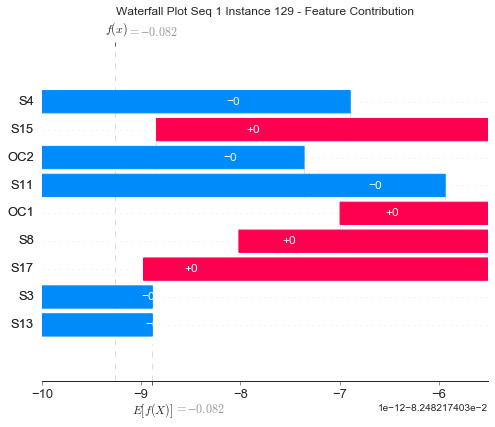

None

Contribution: [-8.42305446e-13  1.57803545e-12  1.82433855e-14  1.50289156e-12
 -4.78758309e-13  8.96982467e-13  2.69554180e-16 -2.29384784e-12
 -5.36791640e-13]


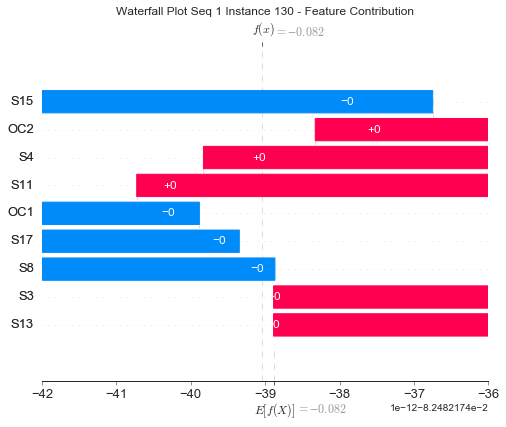

None

Contribution: [-8.97012065e-13  7.55779770e-13  1.72497379e-13  1.87068611e-12
 -1.01621684e-12  9.86110499e-13 -5.25672459e-16 -1.22507950e-12
 -7.57389323e-13]


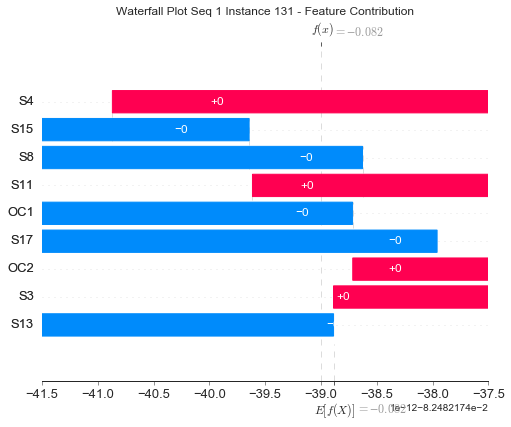

None

Contribution: [ 6.19333144e-13 -9.65253376e-13 -5.49515782e-13 -2.58275779e-12
  1.48009274e-12 -1.78872553e-12  1.99285914e-13  2.89843865e-12
  5.44730656e-13]


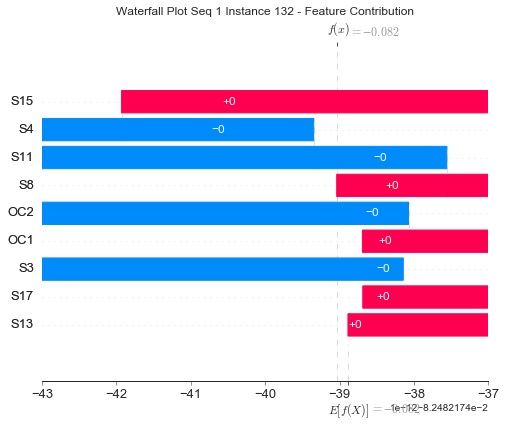

None

Contribution: [ 3.31217584e-13 -5.74951707e-13 -7.13220878e-13 -2.44034046e-12
  1.46062231e-12 -2.13929482e-12  1.47329184e-13  3.26151541e-12
  1.23861397e-13]


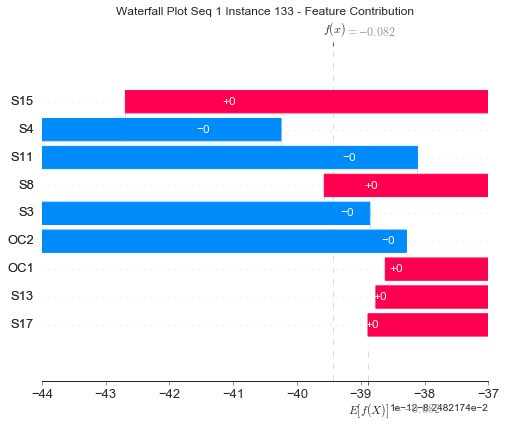

None

Contribution: [ 5.55750514e-14  1.31098406e-13 -2.30761269e-14 -4.45594841e-13
  4.86998029e-13 -2.92382140e-13  3.05810594e-15 -4.31278928e-13
  3.09192586e-13]


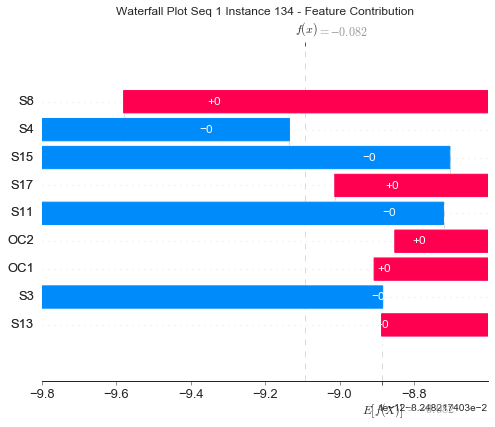

None

Contribution: [ 1.12145558e-12 -1.07682873e-12 -7.85609479e-13 -3.64226314e-12
  1.91793825e-12 -2.37435700e-12  1.03054209e-13  3.55708431e-12
  7.89170378e-13]


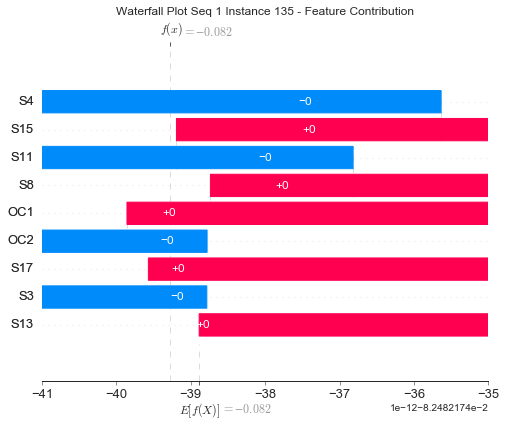

None

Contribution: [-1.22787509e-13  6.84922279e-13 -8.32504299e-14  1.27133886e-13
  2.28165929e-13 -8.09840950e-14 -1.69838417e-16 -9.84705590e-13
  3.85540429e-15]


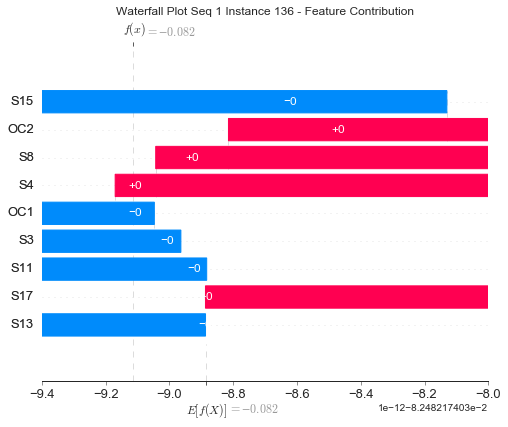

None

Contribution: [-1.50212633e-13  3.47429686e-13  3.91160154e-15  1.64865666e-13
  1.64860005e-14  6.66706680e-14 -7.11706728e-17 -6.40612455e-13
  3.20479490e-14]


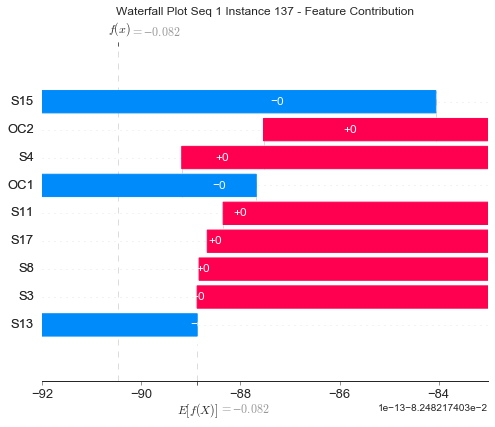

None

Contribution: [-4.53296688e-13  4.71169599e-13  5.15166828e-14  7.44659759e-13
 -3.66072895e-13  5.67654701e-13 -3.29304122e-16 -8.43306165e-13
 -3.85010166e-13]


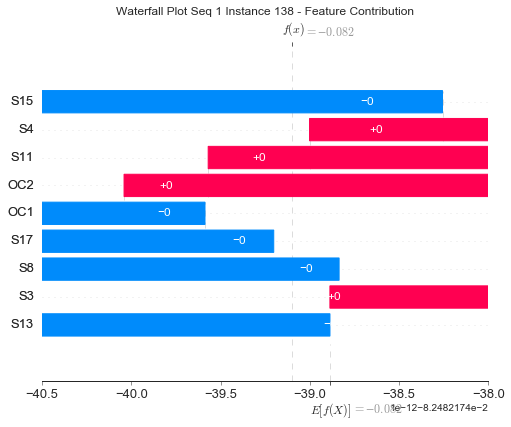

None

Contribution: [-3.01062343e-13  5.37496100e-13  4.17186215e-15  5.64358998e-13
 -3.19717533e-13  3.29754399e-13 -4.72057761e-16 -7.65562798e-13
 -3.47669376e-13]


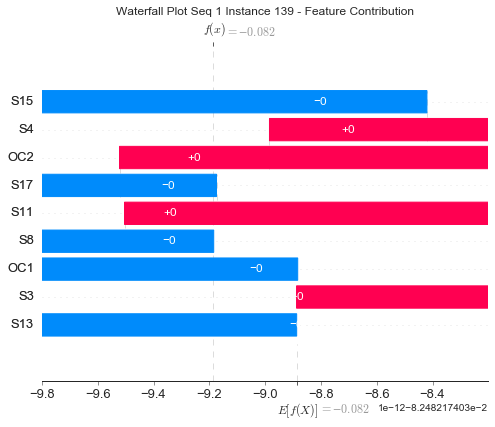

None

Contribution: [-4.69405547e-13  3.68997232e-13  2.00045872e-14  1.01791926e-12
 -9.85226549e-13  6.40007361e-13 -1.05248587e-15 -4.06130153e-13
 -7.12774024e-13]


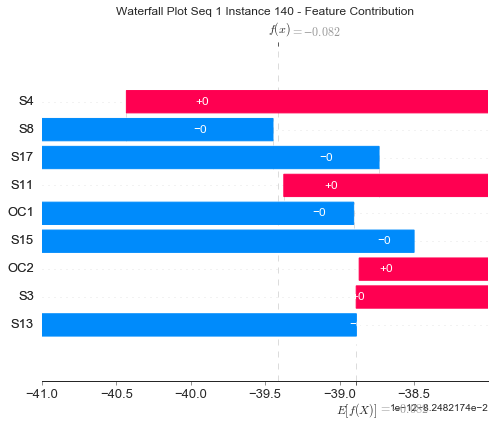

None

Contribution: [ 1.64603194e-12 -2.04289493e-12 -2.11984632e-13 -3.47284267e-12
  1.77050735e-12 -1.97960029e-12 -2.48823525e-16  2.49426109e-12
  1.67100296e-12]


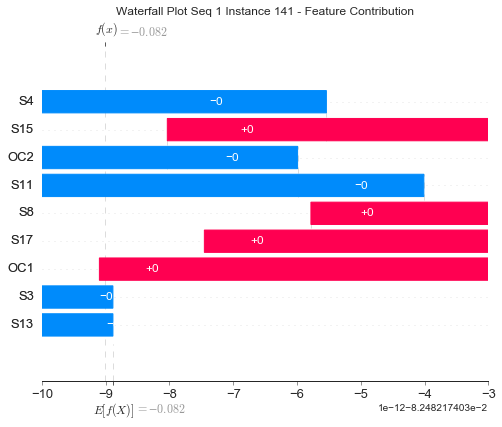

None

Contribution: [ 2.00128017e-14  3.35883692e-13 -6.52609097e-13 -1.50331874e-12
  1.35983705e-12 -1.64082214e-12  1.04855320e-13  2.11702075e-12
 -2.57446977e-13]


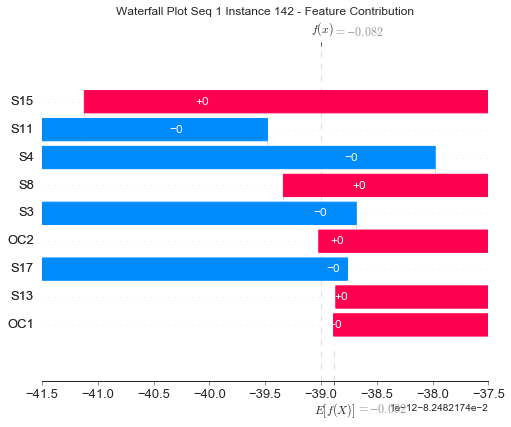

None

Contribution: [ 1.20998632e-12 -1.73006759e-12 -1.02798423e-12 -5.16148452e-12
  3.10885605e-12 -3.57626732e-12  3.49832793e-13  5.16936494e-12
  1.26507127e-12]


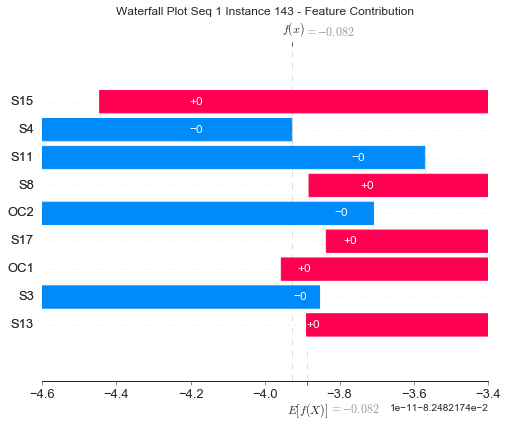

None

Contribution: [ 8.20061575e-13 -1.32323731e-12  3.76622290e-14 -1.41574632e-12
  6.87231522e-13 -1.00741496e-12 -1.91263322e-16  1.27882980e-12
  6.55510368e-13]


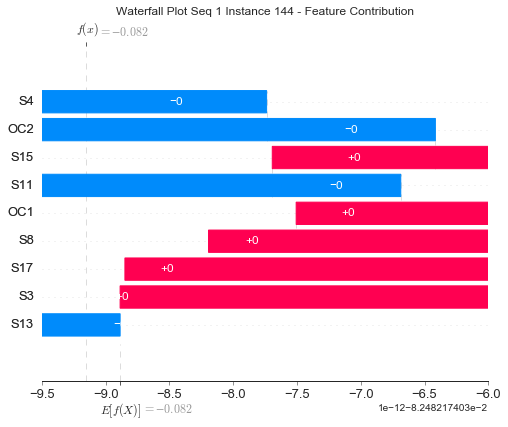

None

Contribution: [-1.74867770e-13  8.12161482e-13 -1.42510146e-12 -2.53131045e-12
  2.97268026e-12 -3.94521655e-12  2.41247289e-13  4.42792764e-12
 -6.01420877e-13]


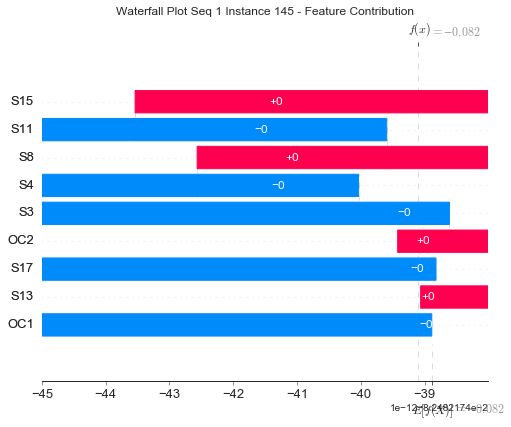

None

Contribution: [-1.10811794e-12  1.96319198e-12  1.24697822e-12  6.42015651e-12
 -5.16534471e-12  5.19134909e-12 -7.71534475e-13 -8.22275061e-12
 -1.21607108e-12]


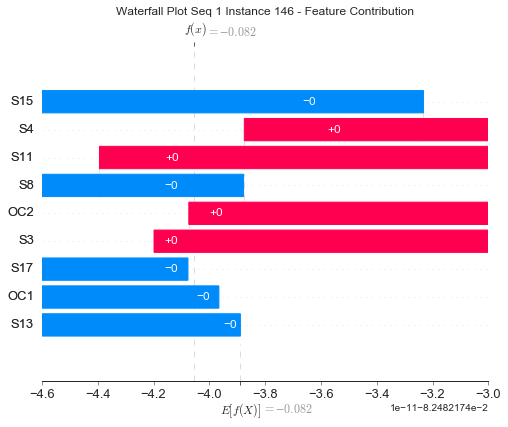

None

Contribution: [-5.05364522e-13  6.50487314e-13  1.05777821e-12  4.26336527e-12
 -4.26459389e-12  4.99908882e-12 -6.30494246e-13 -6.61672713e-12
 -5.18831831e-13]


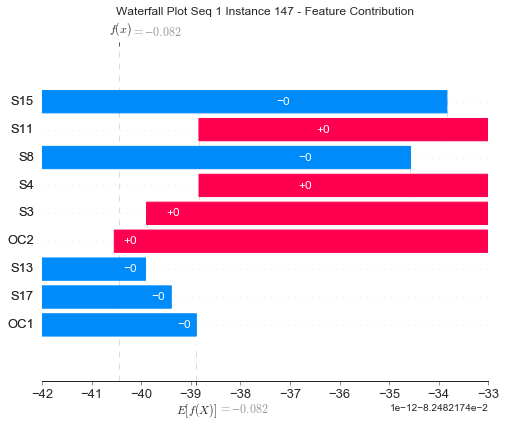

None

Contribution: [ 5.07968877e-14 -5.41278014e-13  1.17346616e-12  2.21035538e-12
 -3.64716807e-12  4.06484872e-12 -4.17545122e-13 -4.77794150e-12
  4.04058534e-14]


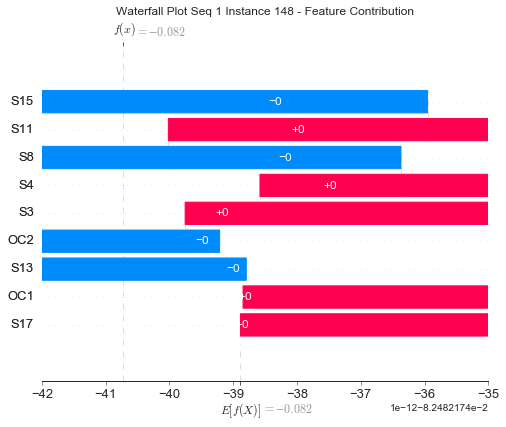

None

Contribution: [-2.77160646e-13 -4.70956417e-14  1.86354404e-12  4.94297181e-12
 -5.19786124e-12  6.04663411e-12 -7.31903199e-13 -7.74431474e-12
 -1.72829907e-14]


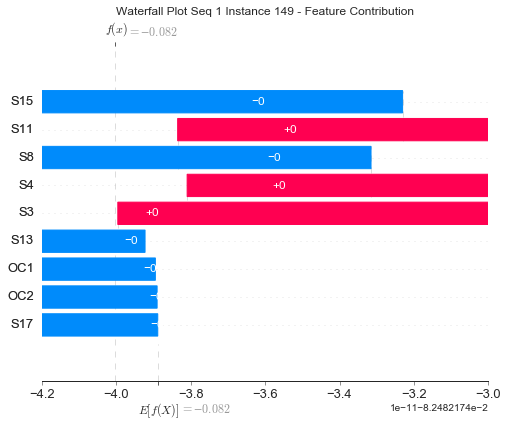

None

Contribution: [ 9.50205409e-13 -1.62613857e-12 -4.21915852e-14 -1.47615373e-12
  4.43780266e-13 -8.94339073e-13  4.28296386e-16  1.91793001e-12
  6.25173470e-13]


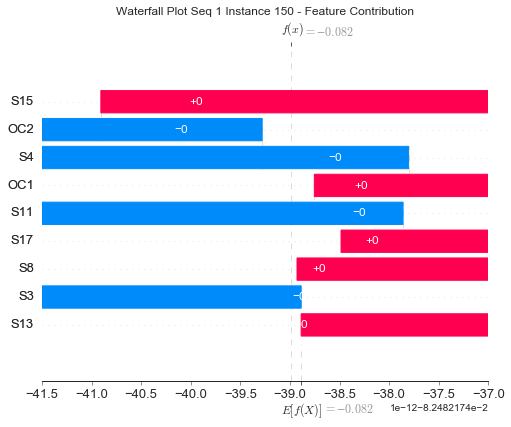

None

Contribution: [-8.05308240e-13  1.43504501e-12 -5.64976831e-13 -9.57180773e-14
  9.01126613e-13 -8.20872992e-13  1.56124679e-13 -1.69774693e-14
 -5.87147030e-13]


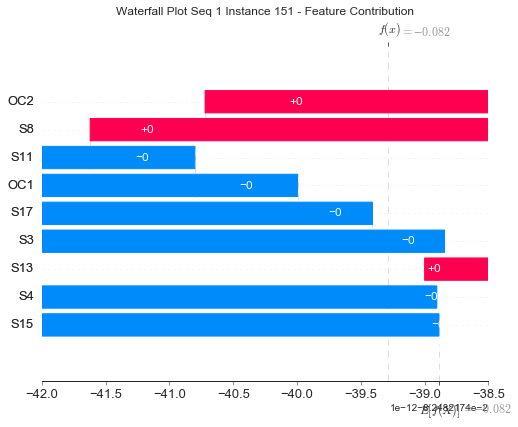

None

Contribution: [ 1.33639898e-12 -1.71778791e-12 -7.76879171e-14 -2.69113941e-12
  1.22824992e-12 -1.62543438e-12 -3.62357320e-17  2.11528234e-12
  1.19847741e-12]


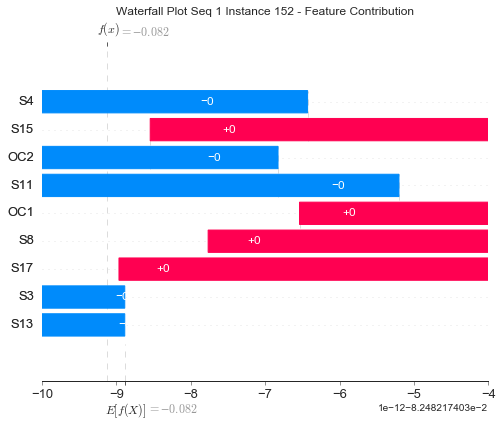

None

Contribution: [ 1.62154394e-12 -1.48366605e-12 -9.03896315e-13 -4.32793818e-12
  2.42208033e-12 -3.20728145e-12  8.45991639e-14  5.38931920e-12
  8.33365603e-13]


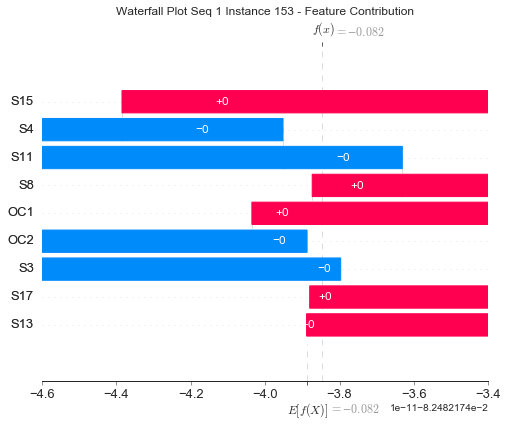

None

Contribution: [-9.52745261e-13  1.55193555e-12 -1.04148211e-12 -6.00435608e-13
  1.38176168e-12 -2.74149778e-12  1.35072780e-13  2.37919255e-12
 -1.31606000e-12]


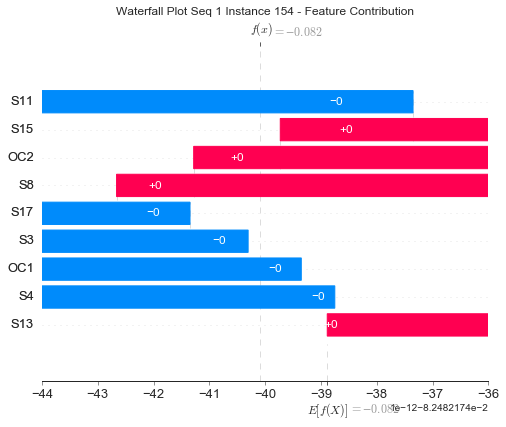

None

Contribution: [-1.04877175e-12  1.71542457e-12 -1.52532761e-14  2.14272588e-12
 -1.28274431e-12  1.23982020e-12  1.00912710e-15 -1.87362495e-12
 -1.24358152e-12]


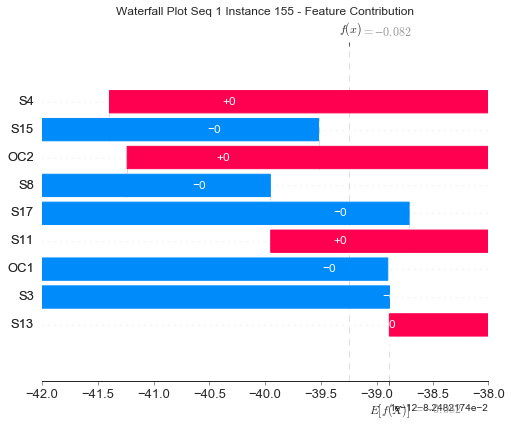

None

Contribution: [ 9.28605717e-13 -1.11770912e-12 -1.01856539e-13 -1.53961219e-12
  7.14305730e-13 -9.23521459e-13  2.28552915e-16  1.64590444e-12
  6.73086641e-13]


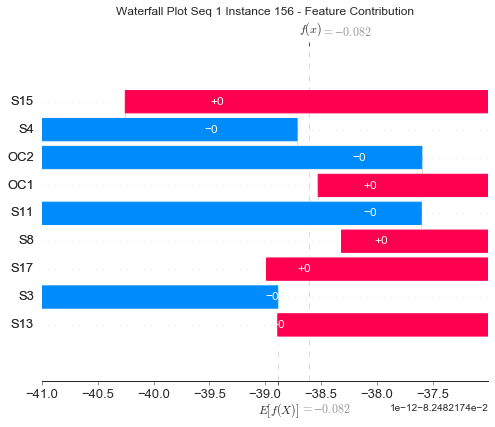

None

Contribution: [ 1.16095805e-12 -1.65118798e-12 -2.54209875e-13 -2.73121738e-12
  1.13594691e-12 -1.32433290e-12  3.37566008e-15  2.18111922e-12
  1.16678173e-12]


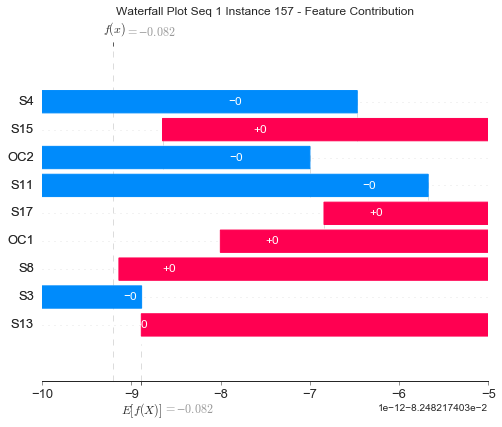

None

Contribution: [ 2.21805471e-13 -1.68707889e-13 -4.89867995e-15 -6.62604249e-13
  4.54278271e-13 -4.16441865e-13 -3.37595913e-16  1.44869383e-14
  3.57577195e-13]


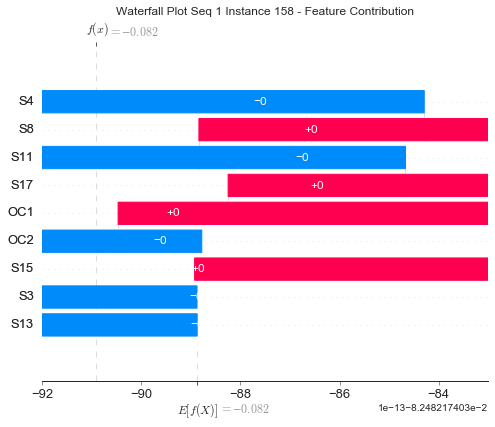

None

Contribution: [-6.06637516e-13  8.77217515e-13 -4.13548963e-14  1.24749896e-12
 -6.06843352e-13  6.94939386e-13 -2.04250309e-16 -1.14272621e-12
 -7.18600797e-13]


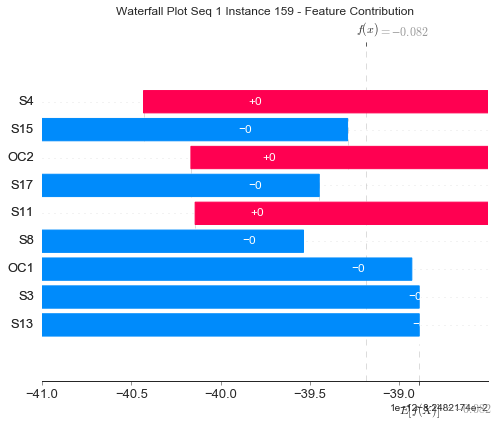

None

Contribution: [-1.62723101e-12  3.86107205e-12 -2.02599059e-13  2.94213221e-12
 -1.28910901e-12  1.66524596e-12  4.70221447e-16 -4.01909669e-12
 -1.41962267e-12]


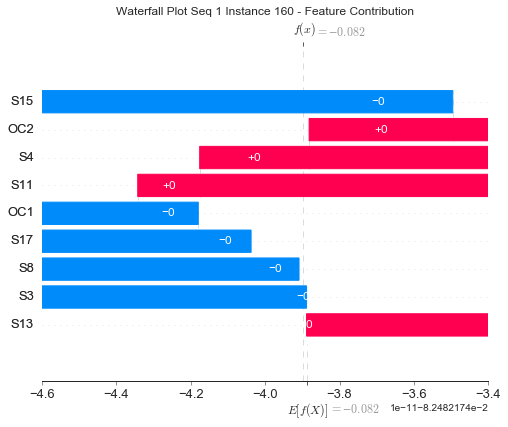

None

Contribution: [ 2.09426430e-13 -4.31991167e-13  5.93662706e-13  7.33461306e-13
 -1.65615004e-12  1.93527312e-12 -1.68936317e-13 -3.02494206e-12
  4.21579140e-13]


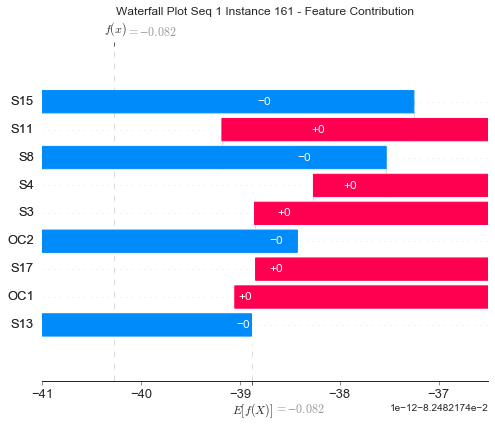

None

Contribution: [ 1.55983180e-12 -2.38742272e-12 -2.11210910e-12 -9.04520989e-12
  6.73101895e-12 -7.44708288e-12  1.26210522e-12  1.07292101e-11
  1.57840668e-12]


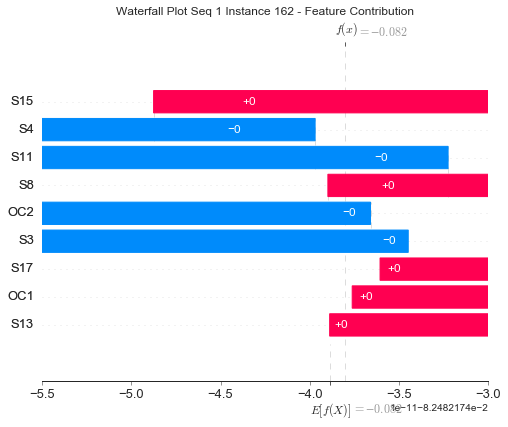

None

Contribution: [ 1.76865001e-12 -1.92000127e-12 -1.00288289e-12 -5.46710593e-12
  3.45317069e-12 -4.00439014e-12  3.97437779e-13  5.65046490e-12
  1.30731504e-12]


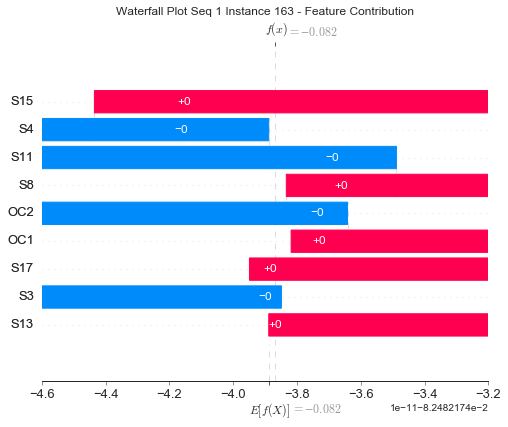

None

Contribution: [ 1.55104824e-12 -1.99505126e-12 -1.12272897e-12 -5.64886896e-12
  2.99899190e-12 -3.94409939e-12  2.57133561e-13  6.03593607e-12
  1.16737371e-12]


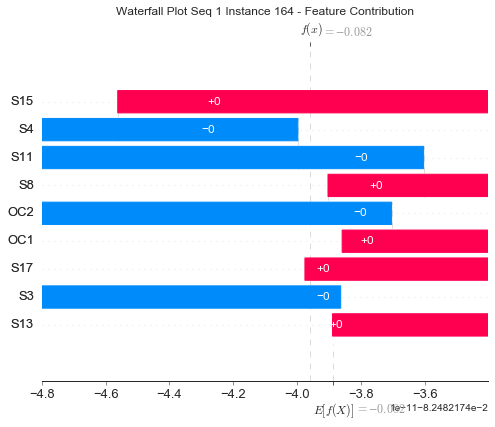

None

Contribution: [-1.84485109e-12  1.95369003e-12  1.24775515e-13  3.06787516e-12
 -1.61756416e-12  1.57915066e-12 -6.12110900e-16 -2.85158052e-12
 -1.46842954e-12]


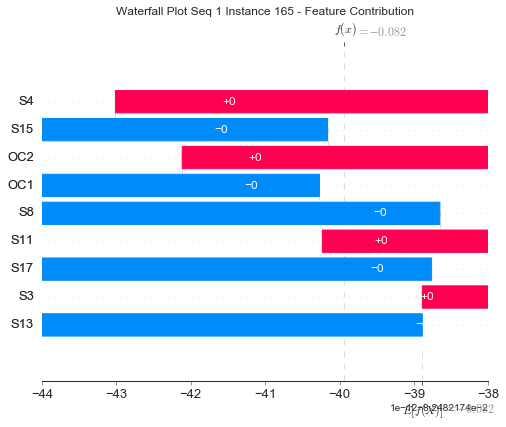

None

Contribution: [ 3.16022967e-12 -3.40658296e-12 -1.49341314e-12 -8.46463524e-12
  4.63450155e-12 -5.53216110e-12  2.91856058e-13  8.24582937e-12
  2.35934384e-12]


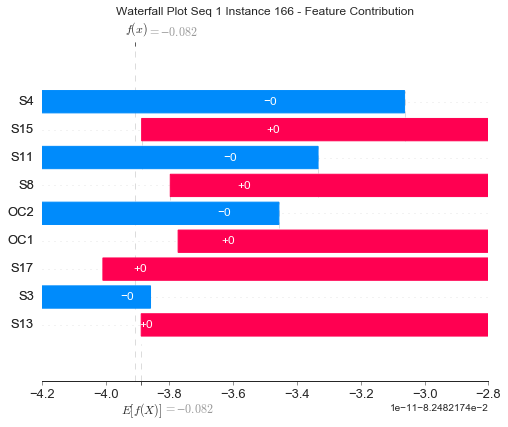

None

Contribution: [-3.52365571e-13  9.10853749e-13 -1.21485840e-12 -1.49688584e-12
  1.43180791e-12 -2.96283354e-12  1.30507082e-13  3.20522992e-12
 -1.11787695e-12]


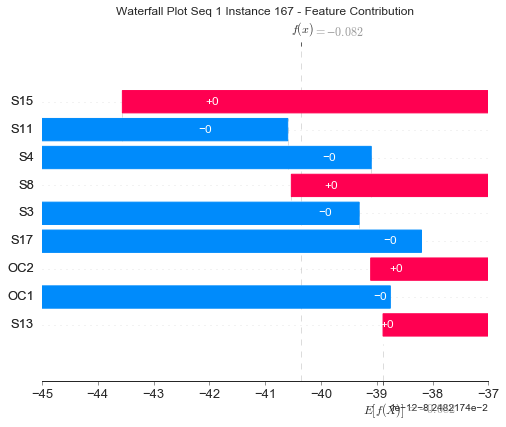

None

Contribution: [ 1.10687111e-12 -1.84639240e-12  1.58099614e-14 -1.65340159e-12
  5.59696929e-13 -9.63532531e-13  4.62497559e-17  2.18467605e-12
  7.50334636e-13]


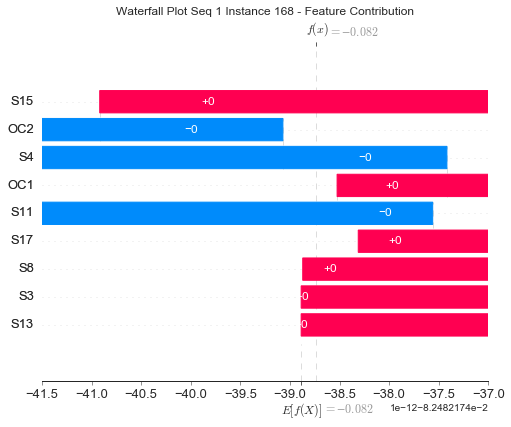

None

Contribution: [-1.13394970e-12  8.67731776e-13  3.48373977e-12  9.61071760e-12
 -7.28658800e-12  9.06398828e-12 -7.65597601e-13 -1.49600349e-11
 -2.19586556e-13]


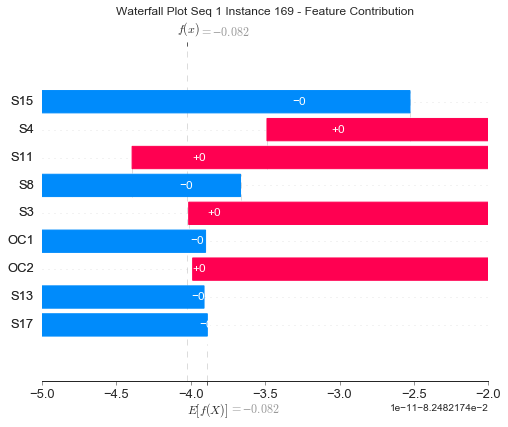

None

Contribution: [-1.10019327e-13  6.36483758e-13 -7.94409406e-13 -1.41752235e-12
  1.79781103e-12 -2.96258699e-12  2.33527444e-13  2.52791668e-12
 -4.45305143e-13]


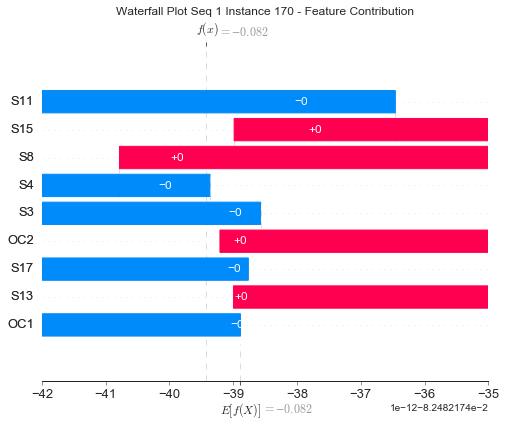

None

Contribution: [ 1.25377562e-12 -1.64772427e-12 -1.50282987e-12 -5.62873359e-12
  3.85809310e-12 -4.83954370e-12  4.51190056e-13  7.58234447e-12
  9.09509339e-13]


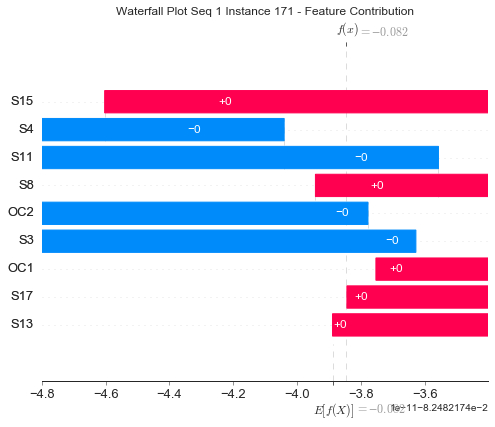

None

Contribution: [-2.57993778e-12  2.33486147e-12  7.05526903e-15  4.36106967e-12
 -3.04417667e-12  2.68639971e-12 -6.43618620e-16 -2.83868241e-12
 -2.40679070e-12]


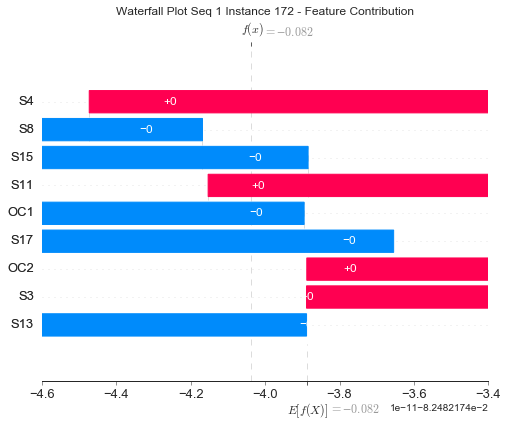

None

Contribution: [-1.31233105e-13 -3.77674536e-13  3.13331067e-12  6.77086772e-12
 -6.44032744e-12  8.50141312e-12 -4.56742446e-13 -1.25561297e-11
  6.10844979e-13]


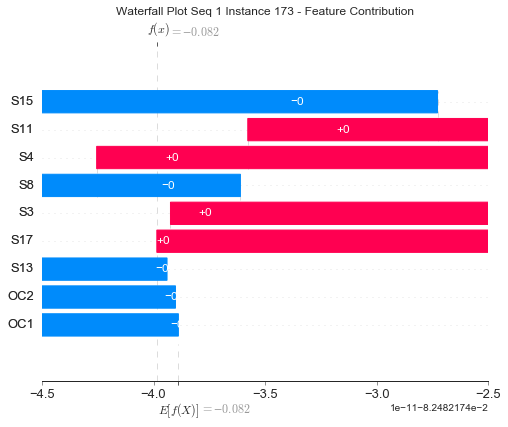

None

Contribution: [ 3.00376109e-12 -4.23809859e-12 -8.70152258e-13 -8.81835143e-12
  5.52448278e-12 -6.31093094e-12  4.96266710e-13  8.18727204e-12
  3.14616475e-12]


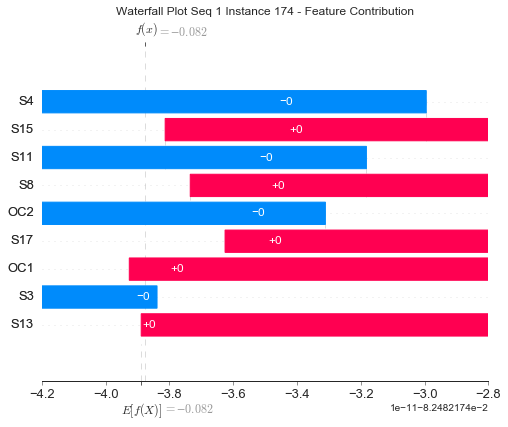

None

Contribution: [-1.38304602e-12  2.16745046e-12 -1.92122793e-12 -7.17709529e-13
  2.33358276e-12 -3.67954495e-12  1.95650015e-13  4.29037665e-12
 -1.77175863e-12]


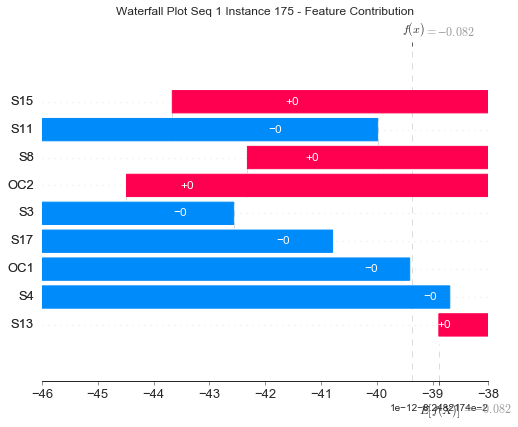

None

Contribution: [-1.28719453e-12  1.43293743e-12  3.46412420e-14  2.36155778e-12
 -1.91184373e-12  1.37172413e-12 -7.05725670e-16 -1.64989929e-12
 -1.63400088e-12]


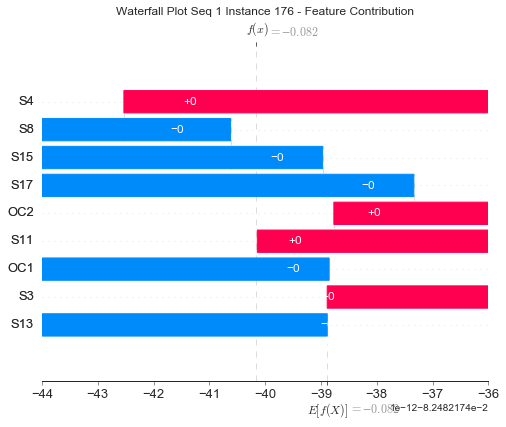

None

Contribution: [ 7.39941637e-13 -2.40986023e-13 -1.13750502e-12 -4.74724210e-12
  4.46174998e-12 -4.51003297e-12  4.04782842e-13  4.34645809e-12
  1.12949179e-12]


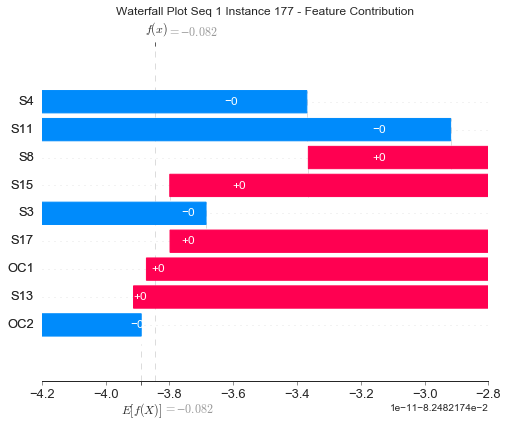

None

Contribution: [-1.24853773e-12  1.50545624e-12 -9.39126272e-13 -2.06282745e-13
  1.38794119e-12 -2.55683213e-12  1.16764955e-13  2.29061540e-12
 -1.08980262e-12]


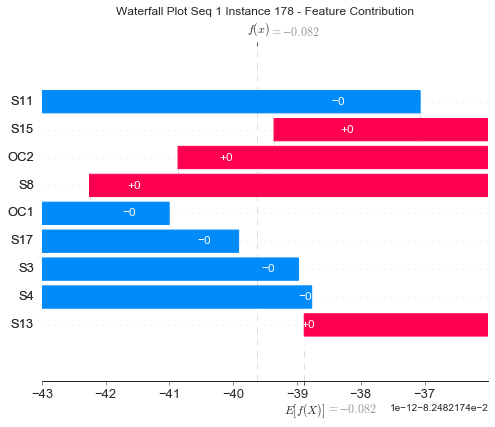

None

Contribution: [-7.12126267e-13  8.49960781e-13  7.97616706e-14  1.26416661e-12
 -5.02670605e-13  7.82703926e-13 -9.88381253e-16 -1.15557292e-12
 -5.46788038e-13]


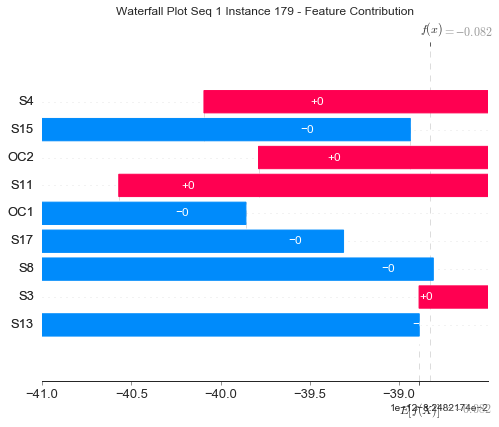

None

Contribution: [ 3.07420257e-12 -4.09917152e-12 -1.41586775e-13 -5.94811787e-12
  2.96186838e-12 -3.69795644e-12  3.78761709e-15  5.32645022e-12
  2.79103346e-12]


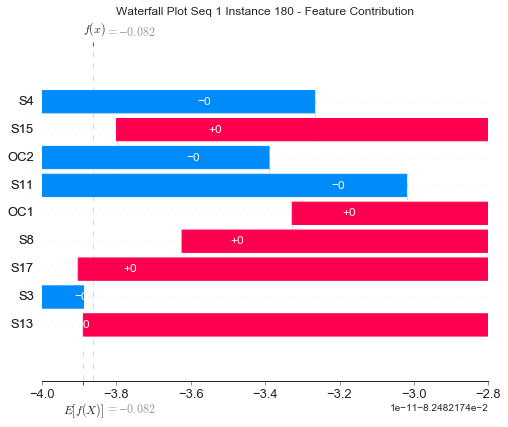

None

Contribution: [-1.50825955e-12  1.92412492e-12 -8.13274361e-13  5.82468644e-13
  1.06816455e-12 -2.35838432e-12  8.09761973e-15  1.87761655e-12
 -1.47212212e-12]


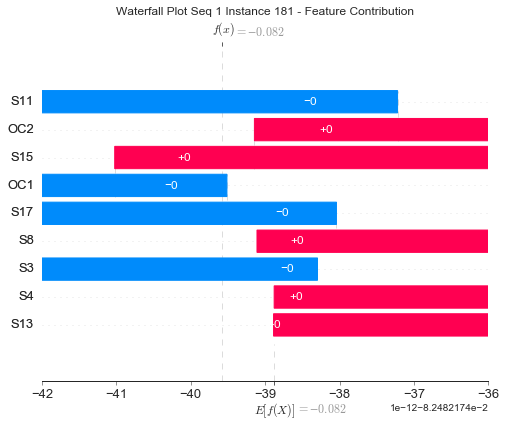

None

Contribution: [-1.93656939e-13  1.07134050e-12 -1.97771985e-12 -3.24493492e-12
  3.49698872e-12 -5.73089926e-12  2.59927361e-13  5.82732777e-12
 -8.36517325e-13]


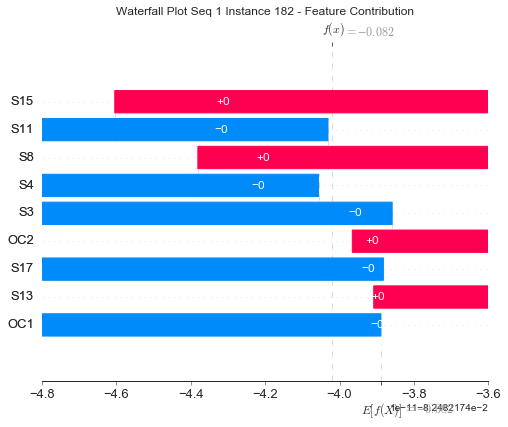

None

Contribution: [-3.75751351e-13  1.18962500e-12  1.22403977e-14  4.50390213e-13
  9.18440129e-14  2.81360872e-13  3.64068101e-16 -1.56546510e-12
 -1.38674887e-14]


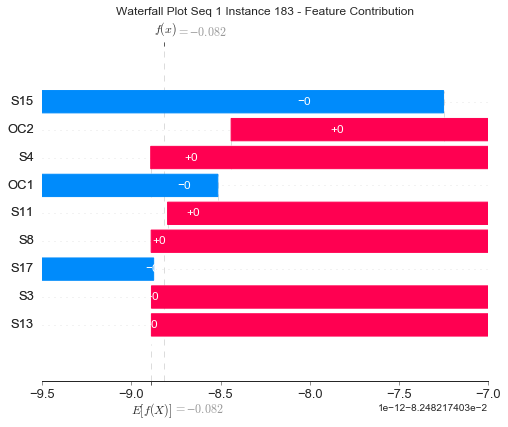

None

Contribution: [ 3.07330593e-12 -3.43256847e-12 -3.51891612e-13 -5.70722289e-12
  2.58572330e-12 -3.26171208e-12 -2.53488744e-16  4.77595437e-12
  2.42397595e-12]


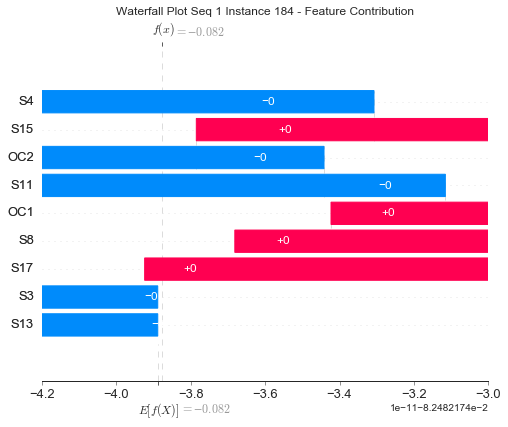

None

Contribution: [ 1.80509351e-12 -1.95803746e-12 -2.57258434e-13 -3.87679125e-12
  1.96177970e-12 -2.23164000e-12  1.02690794e-16  2.42631913e-12
  1.91423331e-12]


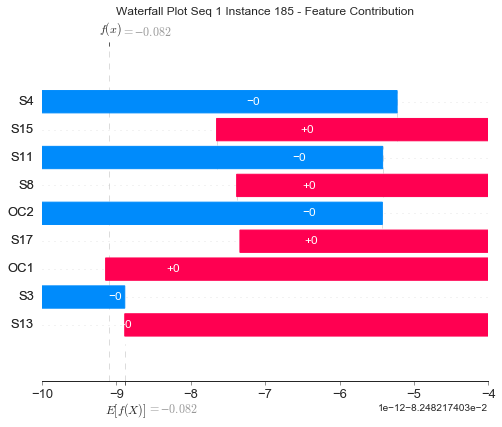

None

Contribution: [-2.10512987e-12  1.92718216e-12  2.06405192e-13  3.35099093e-12
 -1.69051383e-12  1.77285714e-12 -4.14083941e-16 -3.09183061e-12
 -1.46078841e-12]


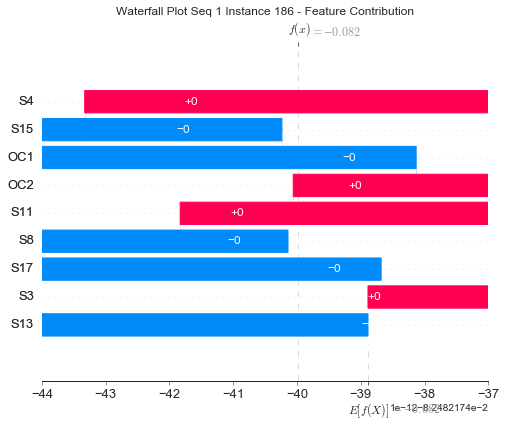

None

Contribution: [ 7.68289512e-14  5.90821120e-13 -8.21448270e-13 -2.62581276e-12
  2.71579655e-12 -2.57893771e-12  3.52978551e-13  1.57634788e-12
  6.12586045e-13]


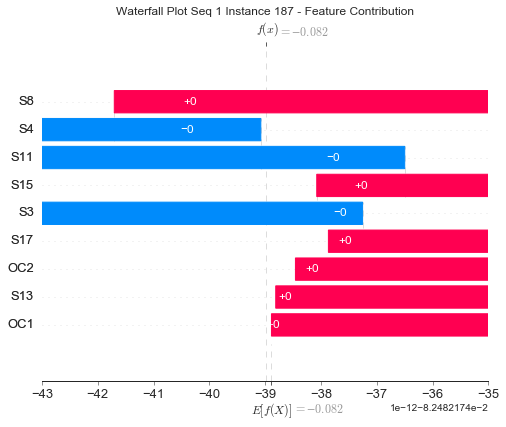

None

Contribution: [ 3.70806033e-12 -4.20440072e-12 -2.36701663e-13 -6.94443027e-12
  3.52965877e-12 -3.98002551e-12  3.02771122e-15  5.12925379e-12
  3.07118068e-12]


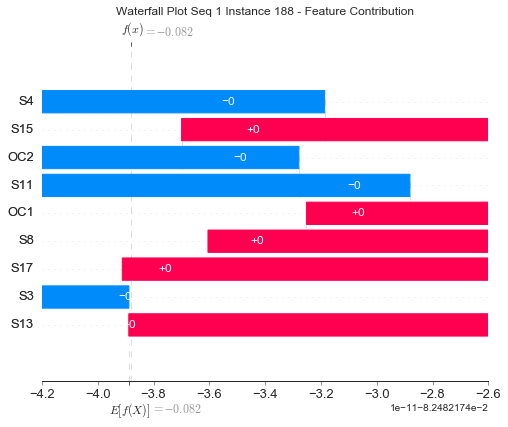

None

Contribution: [-3.21647955e-13  1.07927426e-12 -1.91553522e-12 -2.94555070e-12
  3.69589168e-12 -5.81170962e-12  2.81381364e-13  6.56945505e-12
 -8.86119899e-13]


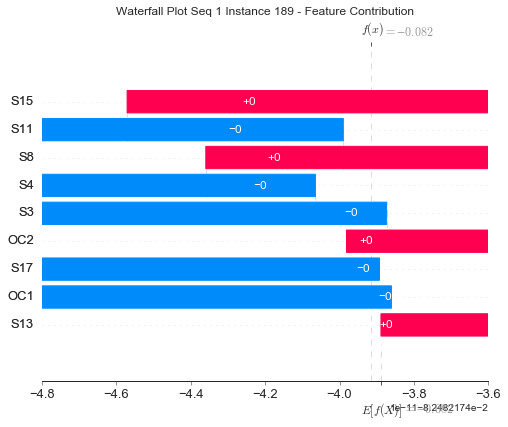

None

Contribution: [-1.12955923e-12  1.92031720e-12 -1.26698077e-13  2.35558773e-12
 -1.77110290e-12  1.71998895e-12 -7.53052326e-17 -1.89205292e-12
 -1.81939403e-12]


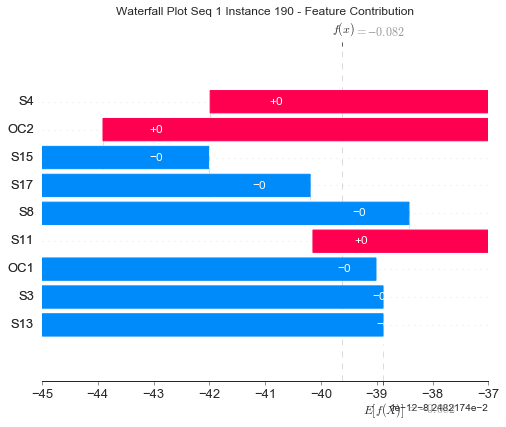

None

Contribution: [-8.66572276e-13  1.00704460e-12  4.11532990e-14  1.28245743e-12
 -7.12386096e-13  6.06940496e-13  1.30466653e-15 -1.47224333e-12
 -7.27983049e-13]


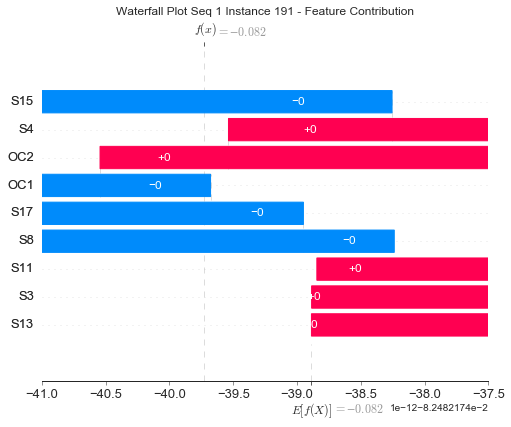

None

Contribution: [ 7.36494307e-13 -3.83988441e-13 -1.04660237e-12 -4.51417593e-12
  4.09156650e-12 -4.14071555e-12  4.10246734e-13  3.65174948e-12
  1.15388471e-12]


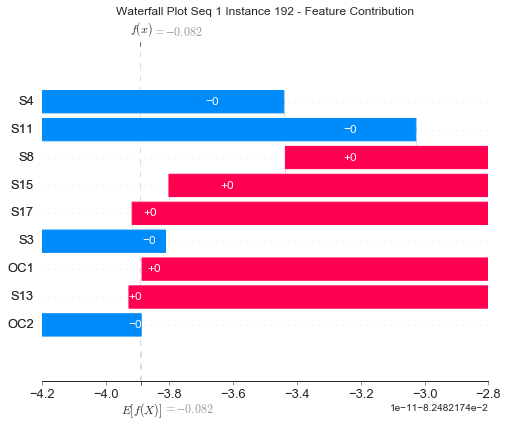

None

Contribution: [ 2.18789765e-12 -3.05073393e-12 -1.43168233e-13 -4.60786574e-12
  2.44435657e-12 -2.73951803e-12 -1.30492903e-16  3.37656053e-12
  2.23944301e-12]


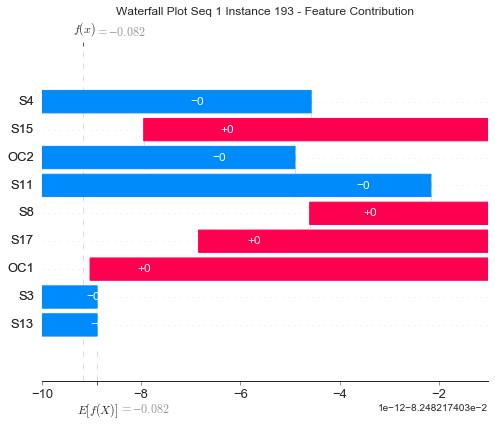

None

Contribution: [-4.63647621e-13  6.36716211e-13 -7.88773344e-13 -8.46486401e-13
  8.78358692e-13 -2.02592587e-12  3.99019095e-14  2.71297264e-12
 -8.69812143e-13]


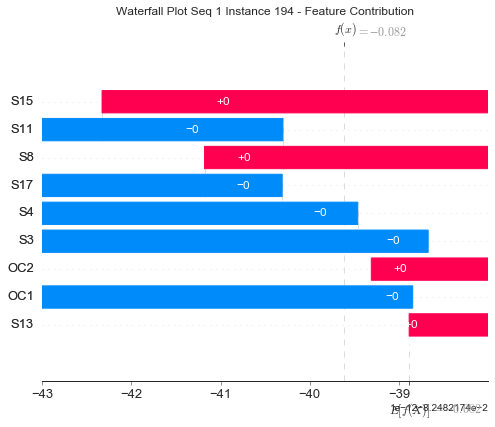

None

Contribution: [-2.45292415e-12  2.74743314e-12  6.09458908e-14  4.08534144e-12
 -2.24566915e-12  2.24044372e-12 -1.47252324e-16 -3.78884467e-12
 -1.86662079e-12]


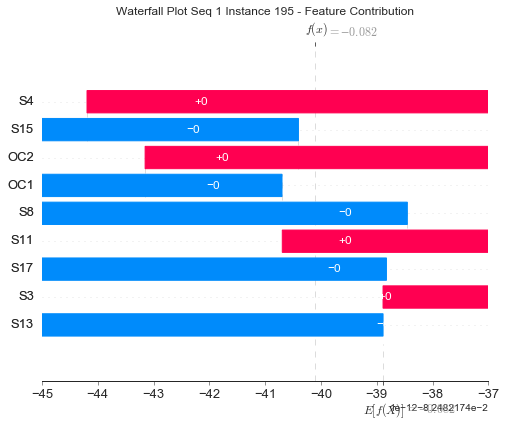

None

Contribution: [ 1.82018680e-12 -1.99118868e-12 -2.45949788e-12 -9.71938155e-12
  6.33584634e-12 -7.39076855e-12  9.62745725e-13  1.15954182e-11
  1.38065525e-12]


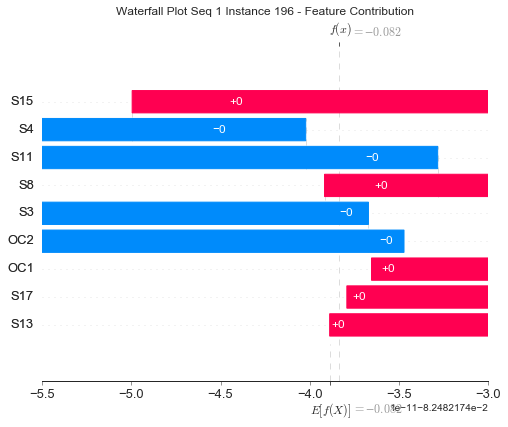

None

Contribution: [-3.97239181e-13  1.16968100e-12 -1.10254481e-12 -2.39696934e-12
  2.98808265e-12 -3.19938910e-12  5.58269739e-13  2.39035658e-12
 -2.64976924e-13]


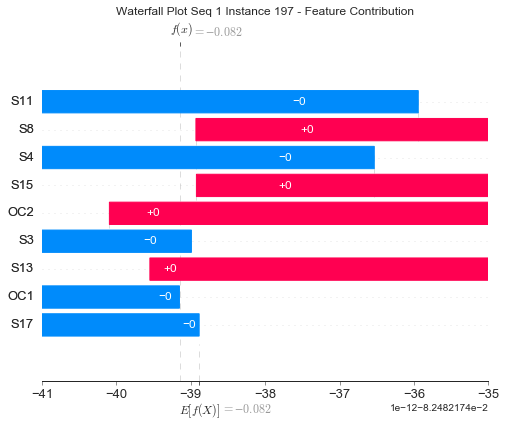

None

Contribution: [-1.14092329e-13  9.23753045e-13 -1.24319272e-12 -3.11781005e-12
  3.40773503e-12 -3.39330300e-12  5.43257767e-13  2.89931230e-12
  1.65076774e-13]


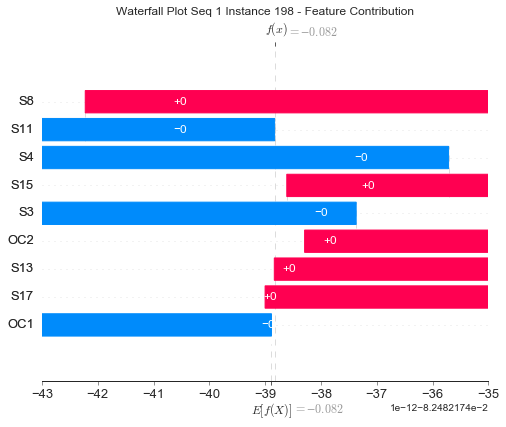

None

Contribution: [ 3.24331165e-12 -4.12308295e-12 -3.07123237e-14 -6.41422419e-12
  3.30581200e-12 -4.12043880e-12 -7.27090806e-16  4.87650979e-12
  2.96993246e-12]


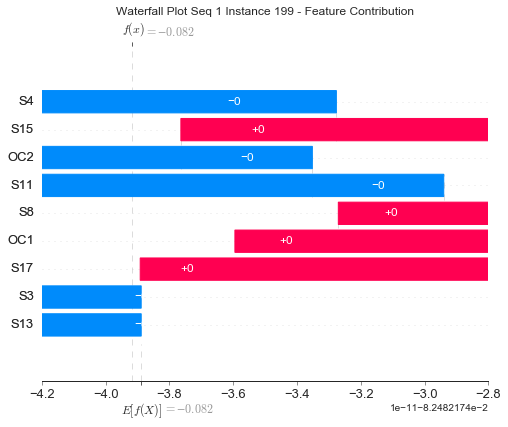

None

Contribution: [-1.05550903e-13 -7.56973314e-13  2.26413202e-12  5.90531790e-12
 -6.96285824e-12  7.46222441e-12 -8.85953691e-13 -9.60759250e-12
 -1.12351141e-13]


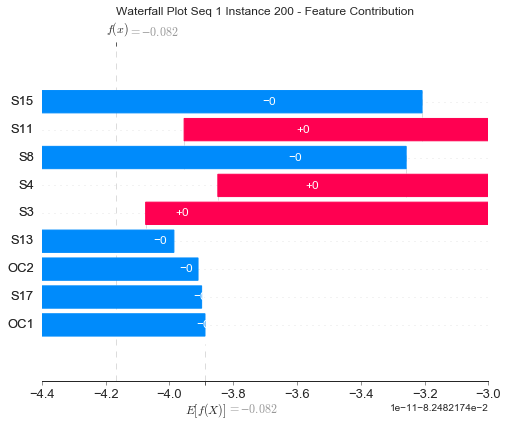

None

Contribution: [ 3.41814169e-13 -1.44737933e-12  2.11393880e-12  3.47339562e-12
 -4.92421945e-12  6.85581756e-12 -5.54629747e-13 -8.86569724e-12
  1.02270286e-12]


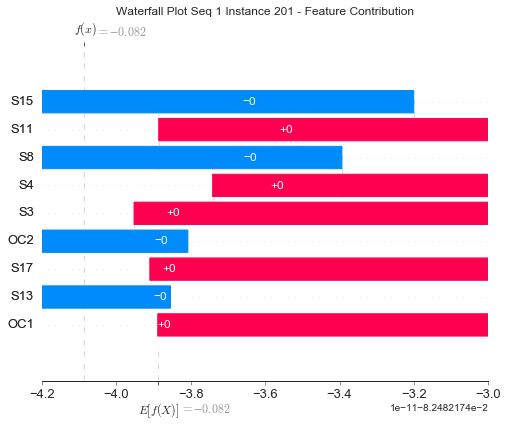

None

Contribution: [-1.06969923e-12  1.82633357e-12 -1.51916457e-13  2.51351739e-12
 -1.68933400e-12  1.75725255e-12  2.82808207e-16 -1.67088598e-12
 -1.54467335e-12]


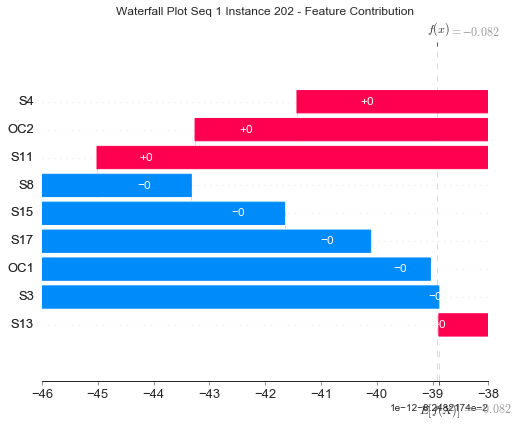

None

Contribution: [-2.10838703e-12  2.36303381e-12  2.68242832e-14  3.60442058e-12
 -2.02685351e-12  2.23545943e-12  5.04560024e-17 -3.02102961e-12
 -1.78445800e-12]


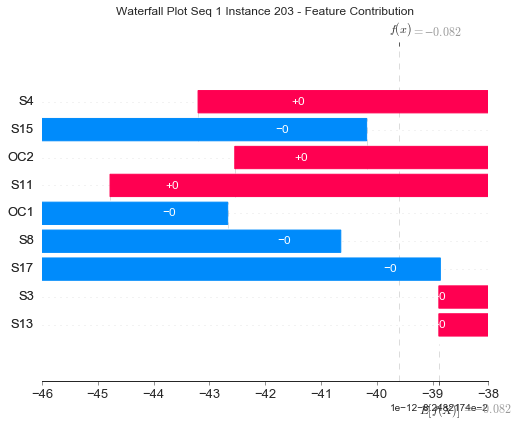

None

Contribution: [-6.50066616e-14  4.91174890e-14 -9.74463457e-13 -2.19096876e-12
  1.59890959e-12 -2.23443161e-12  2.67780047e-13  4.17726834e-12
 -4.61969764e-13]


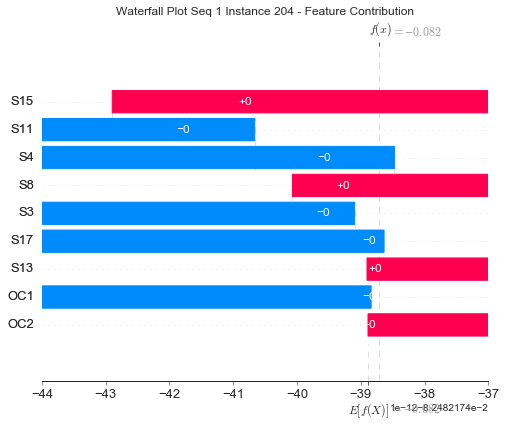

None

Contribution: [-2.58823616e-13  1.46265628e-12 -4.01475795e-14  3.81121187e-13
  2.14389433e-13  1.44327773e-13  7.46874107e-16 -1.71031516e-12
 -7.00840143e-14]


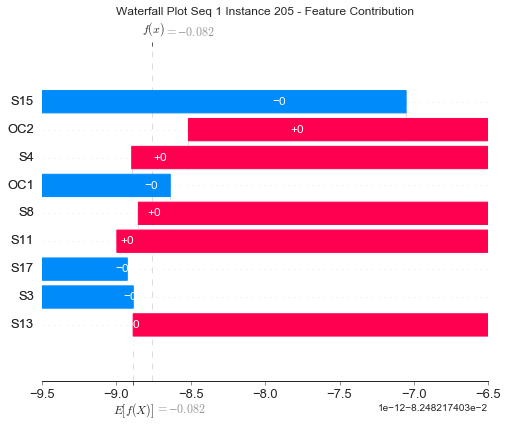

None

Contribution: [-1.82370192e-13  1.57048609e-13  2.58899822e-14  4.89455265e-13
 -3.71831363e-13  1.31591461e-13  1.69476988e-15 -8.10277545e-14
 -2.69130258e-13]


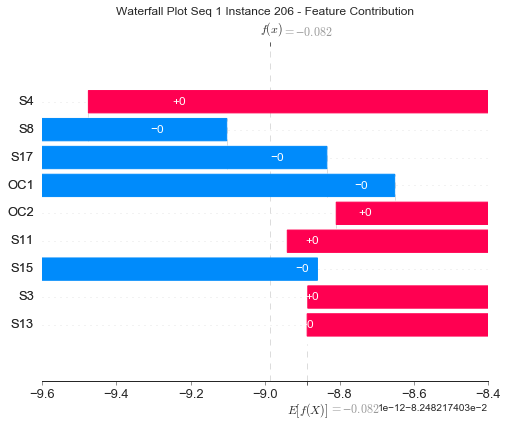

None

Contribution: [-2.16599877e-13  1.02006836e-12 -3.82729737e-14  2.50416278e-13
  2.45541245e-13 -1.50796937e-14  5.41271735e-16 -1.46839485e-12
  6.64845512e-14]


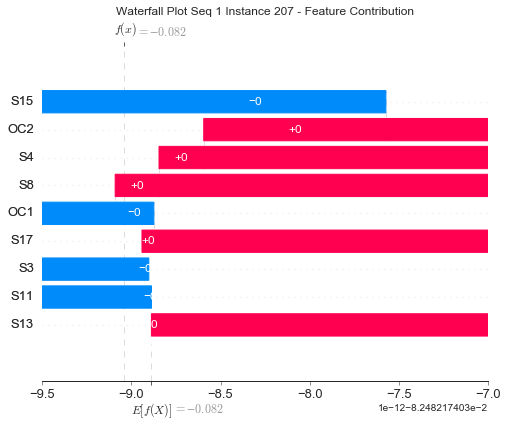

None

Contribution: [ 8.64265907e-13 -1.48491083e-12 -1.13821568e-14 -2.09336411e-12
  8.80056607e-13 -1.35051649e-12  6.46451861e-15  1.54504957e-12
  7.98749576e-13]


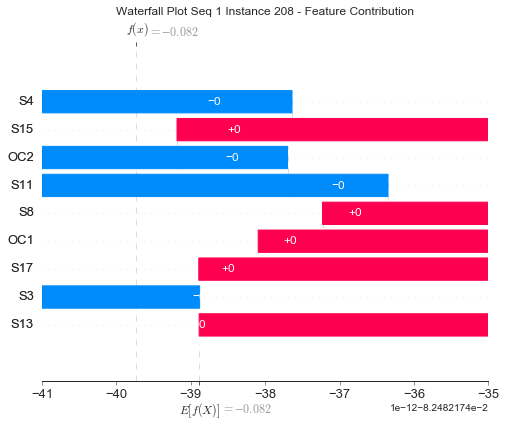

None

Contribution: [-1.97261912e-13 -2.67448146e-13  2.28810373e-12  4.87257673e-12
 -4.21252269e-12  6.15722751e-12 -2.39069262e-13 -9.00004637e-12
  5.60419875e-13]


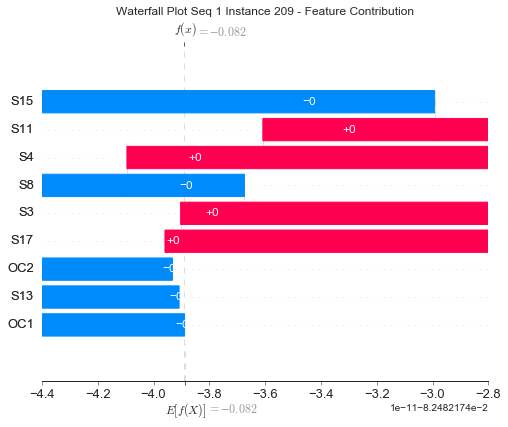

None

Contribution: [ 1.46821249e-12 -2.69163749e-12  1.45770142e-13 -3.19446965e-12
  1.91713681e-12 -2.11879386e-12  8.42295915e-15  2.57361884e-12
  1.96573834e-12]


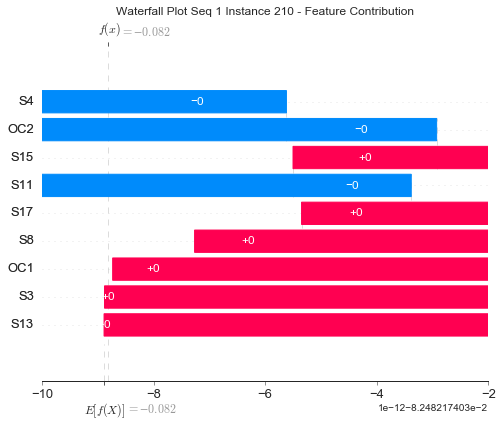

None

Contribution: [ 1.73111883e-12 -2.17245015e-12 -1.13391067e-12 -5.78791529e-12
  3.23147238e-12 -4.01960366e-12  3.91257664e-13  6.36734545e-12
  1.48067246e-12]


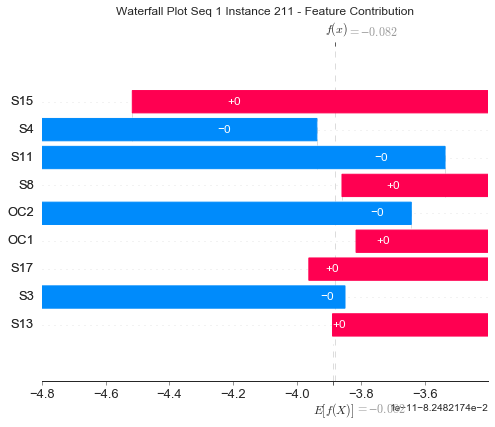

None

Contribution: [ 3.31052893e-13 -4.14545351e-13  6.01375232e-14 -1.23334361e-12
  1.03888436e-12 -9.34252675e-13  4.73335267e-15  2.61766357e-13
  8.47694419e-13]


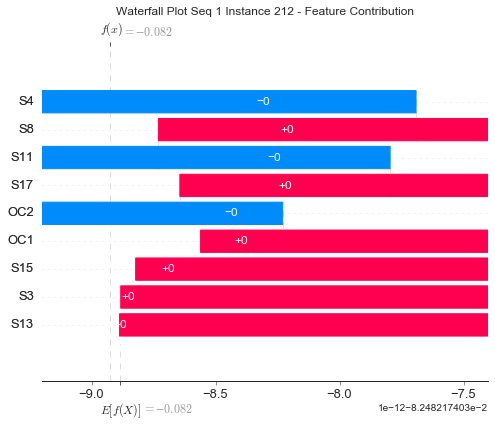

None

Contribution: [-1.03992531e-12  1.28915260e-12  6.14914817e-14  2.10821464e-12
 -9.20823964e-13  1.09798835e-12  4.62969998e-16 -1.82885413e-12
 -9.51873346e-13]


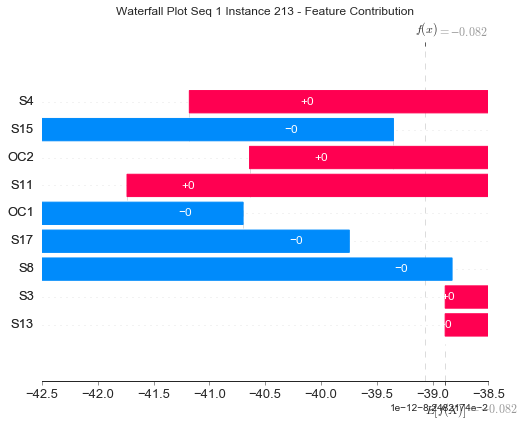

None

Contribution: [-1.60728940e-14  2.17780590e-14  3.92534075e-14 -1.90258725e-13
 -1.05178588e-13 -1.68648298e-13 -1.17473266e-16 -2.94417675e-13
 -2.33548989e-14]


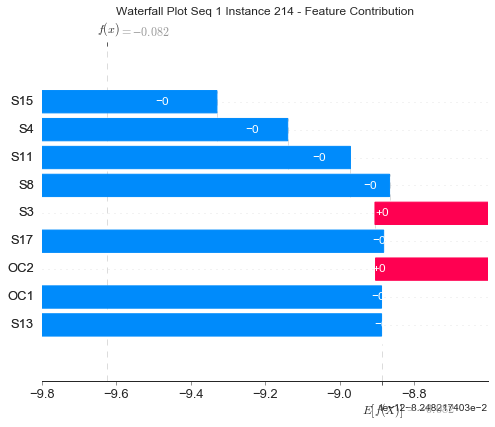

None

Contribution: [ 1.35336599e-12 -2.40813858e-12 -6.56636814e-14 -3.31076854e-12
  1.96079611e-12 -2.03734555e-12  4.80038389e-15  2.40476692e-12
  1.97672889e-12]


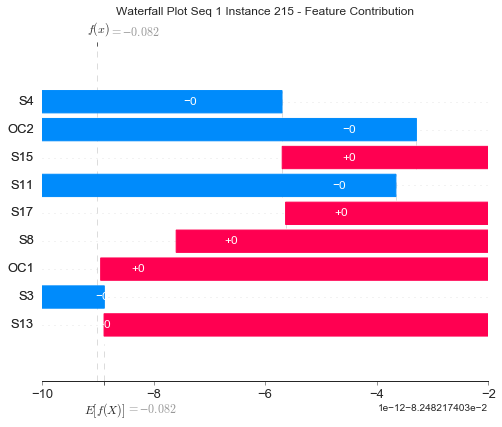

None

Contribution: [ 2.99959114e-13 -3.88184032e-13  7.91806467e-14 -1.25816209e-12
  9.34663046e-13 -8.44170979e-13 -4.53365491e-16  9.19867481e-14
  8.15082106e-13]


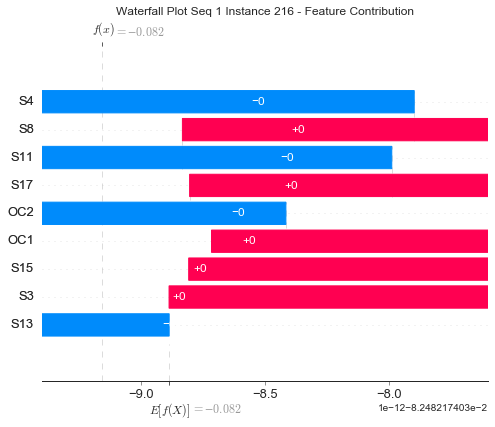

None

Contribution: [-4.43823960e-13  5.13241630e-13  3.47492488e-14  9.72237481e-13
 -6.07306360e-13  5.86459971e-13  2.72420037e-16 -7.60902300e-13
 -5.02959382e-13]


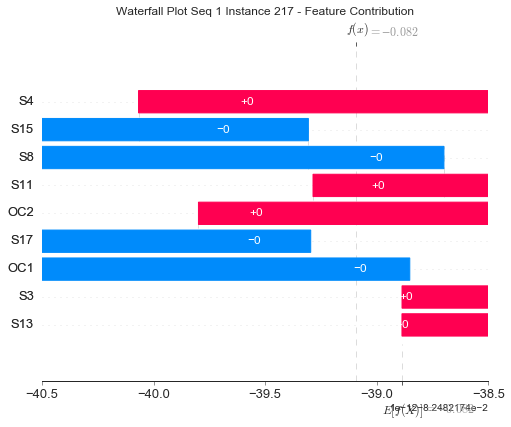

None

Contribution: [-7.43631122e-13  1.47203517e-12 -8.92866022e-13 -4.13641614e-13
  1.77028281e-12 -2.52437307e-12  3.58302065e-13  2.60195034e-12
 -1.15432132e-12]


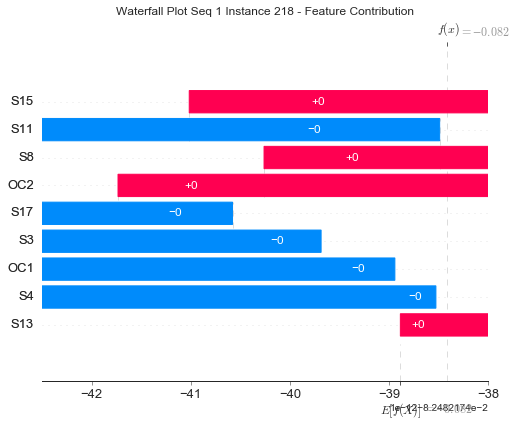

None

Contribution: [ 1.15992795e-12 -2.41665303e-12 -1.16368514e-12 -6.05302744e-12
  3.99293446e-12 -4.83762119e-12  8.31433609e-13  7.10431497e-12
  1.28895321e-12]


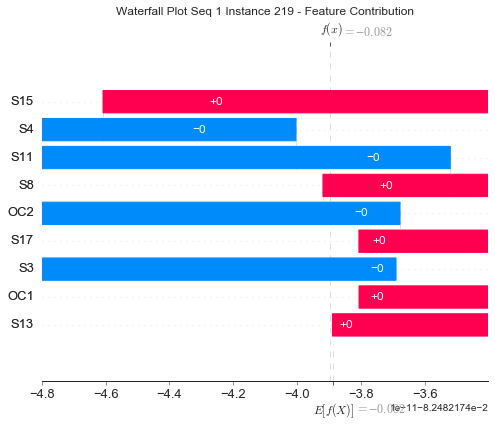

None

Contribution: [-7.18359671e-13  2.16737067e-12 -8.24846593e-13  7.12304239e-13
  3.03568240e-14 -7.34666397e-13  9.15479511e-14  8.16206315e-13
 -1.46113655e-12]


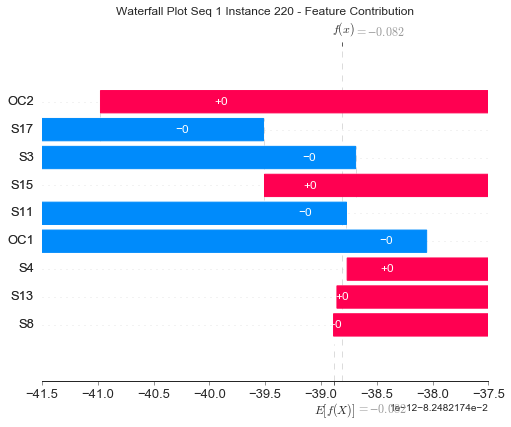

None

Contribution: [ 1.23287990e-13 -2.29089751e-13  1.41650497e-14 -2.33144342e-13
  1.81224715e-14 -2.17126068e-13 -2.19503744e-16  1.77708420e-13
  8.23740151e-14]


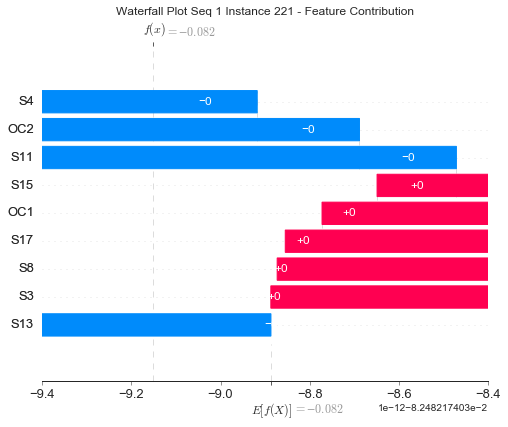

None

Contribution: [-2.09393294e-13  2.27798628e-13 -1.57091429e-15  9.69455852e-13
 -7.16503679e-13  1.04624827e-12 -1.81685396e-13 -1.19791980e-12
 -1.10615550e-13]


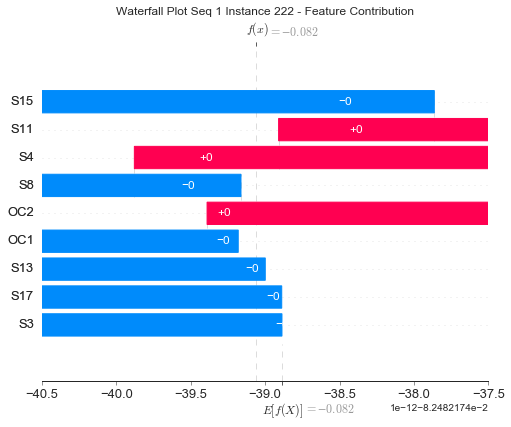

None

Contribution: [-8.16573507e-14  3.68646465e-13 -1.29009067e-13  2.48035614e-13
 -2.12460027e-13  1.17413783e-13  4.40693878e-16 -2.09734397e-13
 -1.58422320e-13]


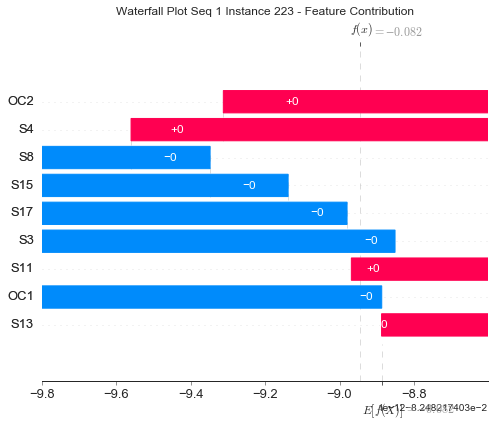

None

Contribution: [-5.56422204e-13  8.56062617e-13  3.41385449e-13  3.14812716e-12
 -2.90527238e-12  3.79703257e-12 -6.48359784e-13 -4.03319609e-12
 -3.93899269e-13]


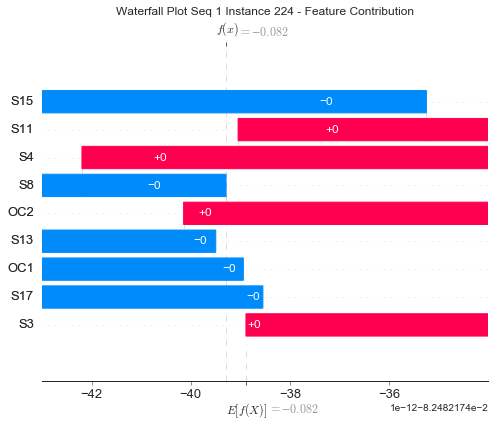

None

Contribution: [ 1.33170655e-13 -4.89174998e-13  1.92970656e-14 -1.46523494e-12
  1.60213607e-12 -2.70988830e-12  4.49568334e-13  1.54621118e-12
 -3.46715556e-14]


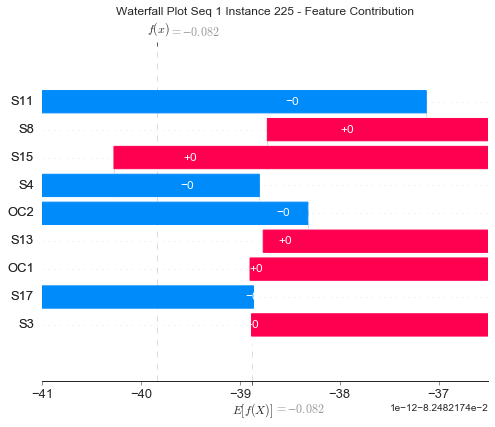

None

Contribution: [ 1.11277537e-13  2.45286833e-14 -1.18533343e-13 -2.47609116e-13
  6.67629675e-14  1.19556410e-13 -7.31783156e-16  2.24062522e-13
  1.38200852e-13]


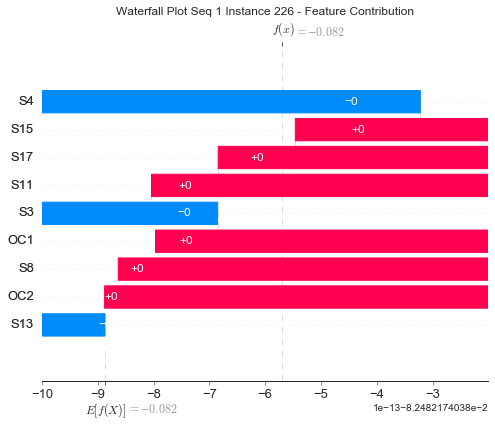

None

Contribution: [ 1.04364115e-13 -1.43480835e-13  2.00644690e-13  1.32039006e-13
 -1.17605985e-13 -1.32276582e-13  2.38917671e-14 -1.90027132e-14
 -2.38475875e-14]


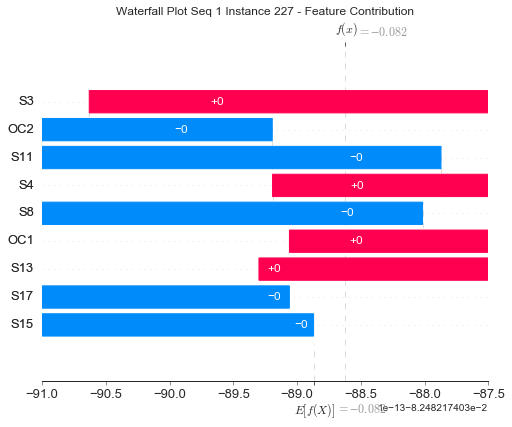

None

Contribution: [ 1.14901404e-12 -3.74466815e-13 -5.12640223e-13 -1.53728191e-12
  4.76460505e-13 -1.04688400e-13 -5.82224031e-16  1.62993750e-12
  6.28634785e-13]


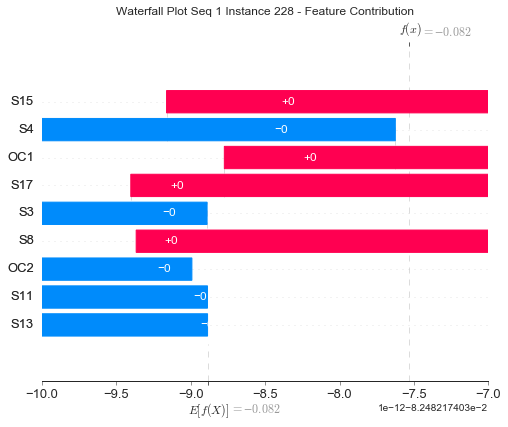

None

Contribution: [ 5.95959805e-13 -2.55371164e-13 -3.20384046e-13 -9.20376188e-13
  3.29734937e-13 -6.89282548e-14 -6.38053508e-16  8.27815301e-13
  3.64429488e-13]


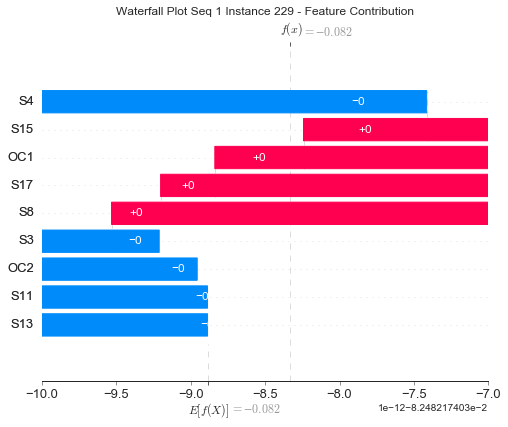

None

Contribution: [ 1.66463327e-12 -1.71639363e-12 -7.04187576e-13 -3.31822352e-12
  1.45628735e-12 -9.98372934e-13 -1.54242370e-15  3.12003982e-12
  1.58256437e-12]


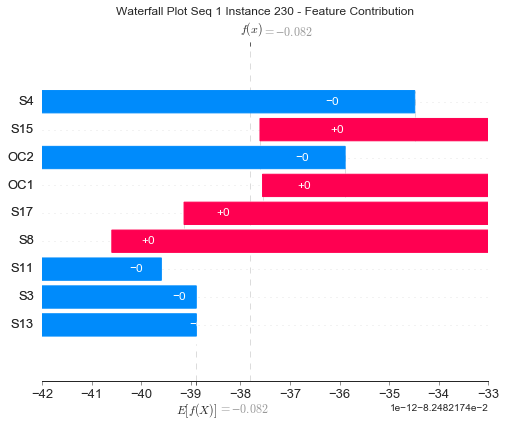

None

Contribution: [ 4.71910109e-13 -5.96353208e-13  1.14109687e-12  2.38686479e-12
 -2.14537893e-12  2.99742869e-12 -2.64628001e-13 -4.52764215e-12
  2.57971053e-13]


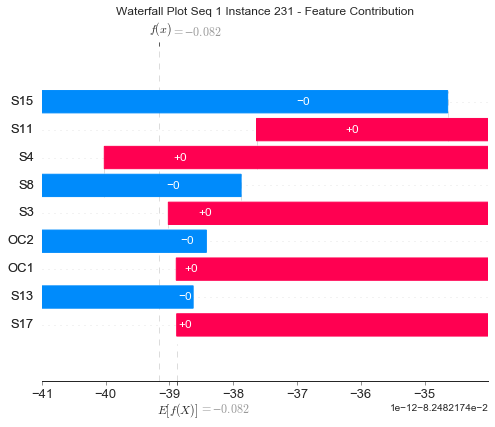

None

Contribution: [ 1.56866956e-12 -2.86770260e-12  9.17263010e-13 -7.52641710e-13
 -1.15680024e-12  1.62423330e-12 -6.18983814e-13 -1.34164229e-12
  1.91007626e-12]


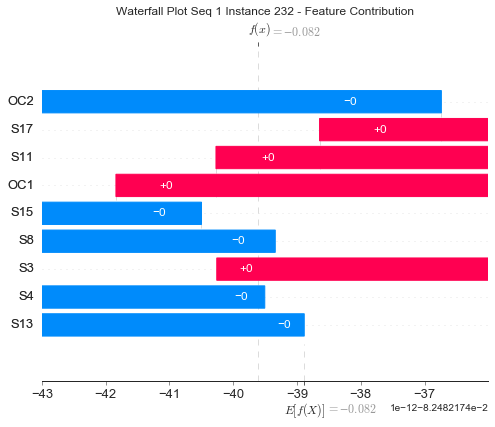

None

Contribution: [-3.32456155e-12  4.87309498e-12  6.30429736e-13  5.60490413e-12
 -1.92610619e-12  2.21571676e-12 -4.73067859e-15 -6.70891120e-12
 -2.63142221e-12]


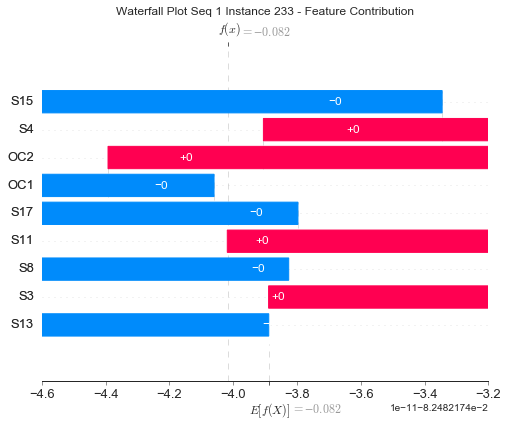

None

Contribution: [-8.26602242e-12  6.22287465e-12  1.79772516e-12  1.30099959e-11
 -5.19395334e-12  5.08047337e-12 -2.07185360e-15 -1.12800090e-11
 -5.05831401e-12]


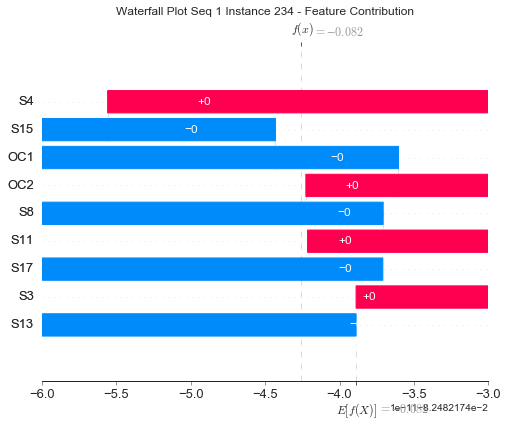

None

Contribution: [ 3.83141652e-12 -2.89971367e-12 -1.30832315e-11 -3.21072162e-11
  2.33209146e-11 -2.51964231e-11  3.82405739e-12  4.96633637e-11
  2.02713584e-12]


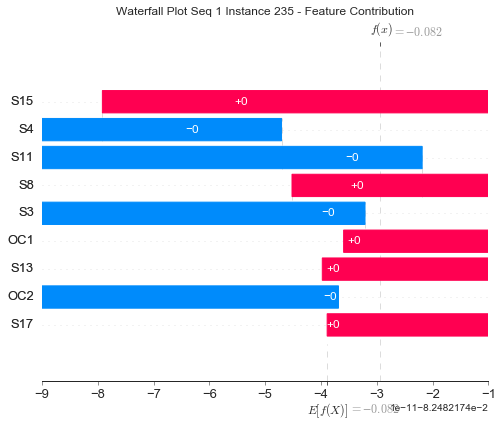

None

Contribution: [ 1.40962676e-12 -1.50061723e-12 -3.38752464e-13 -4.10314838e-12
  4.09301369e-12 -1.37734399e-12 -5.24502283e-15  1.37379171e-12
  3.37863656e-12]


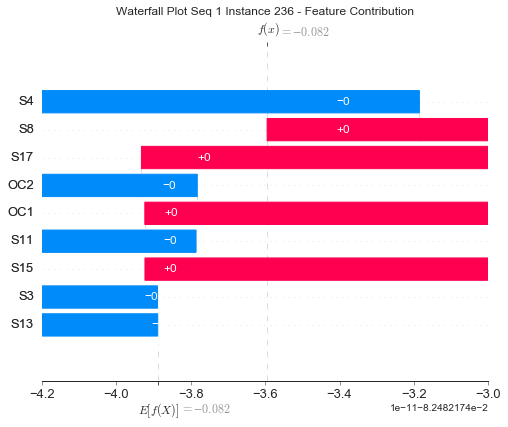

None

Contribution: [-6.69136925e-12  4.89239378e-12  2.14910099e-12  1.21995417e-11
 -4.27898342e-12  4.66049161e-12 -1.06785206e-14 -9.17433404e-12
 -4.86998853e-12]


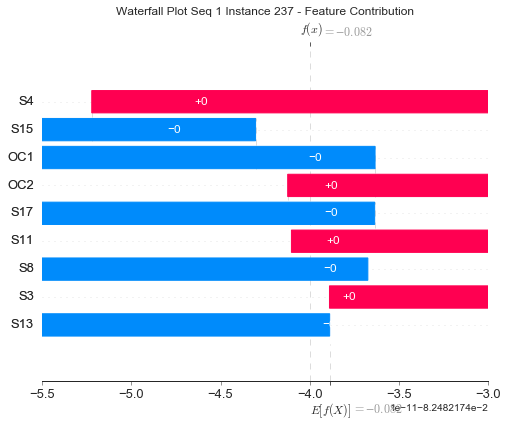

None

Contribution: [-2.58830262e-12  9.22423708e-15  5.94988902e-13  8.88768573e-12
 -6.90624901e-12  4.78390634e-12 -1.02746536e-14  5.03284480e-12
 -5.22545158e-12]


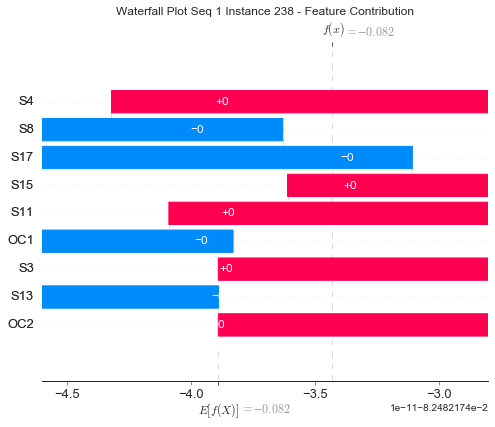

None

Contribution: [-4.11648450e-12  1.65810047e-13  9.68005710e-12  2.93535404e-11
 -2.38578202e-11  2.68628054e-11 -2.03145855e-12 -3.02612865e-11
 -2.14885249e-12]


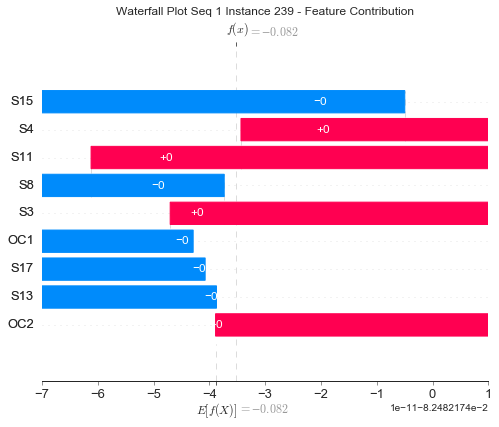

None

Contribution: [ 7.05272256e-12 -8.28285444e-12  1.19611456e-11  1.49219369e-11
 -1.96865267e-11  3.36639119e-11 -2.40399064e-12 -4.31284973e-11
  8.43830301e-12]


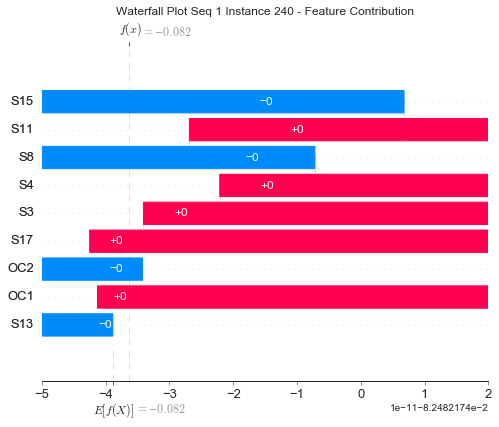

None

Contribution: [ 8.95440232e-12 -1.18752794e-11  6.74283199e-12 -4.54901091e-12
 -4.65942909e-12  9.11821139e-12 -3.86009177e-13 -1.44313944e-11
  1.00128265e-11]


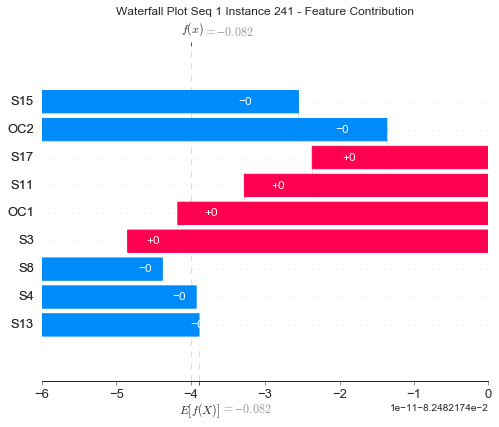

None

Contribution: [ 4.22268253e-12 -2.81754719e-12 -1.55469578e-11 -4.21205709e-11
  3.44111233e-11 -4.84361752e-11  3.81711720e-12  7.07252590e-11
 -4.36034103e-13]


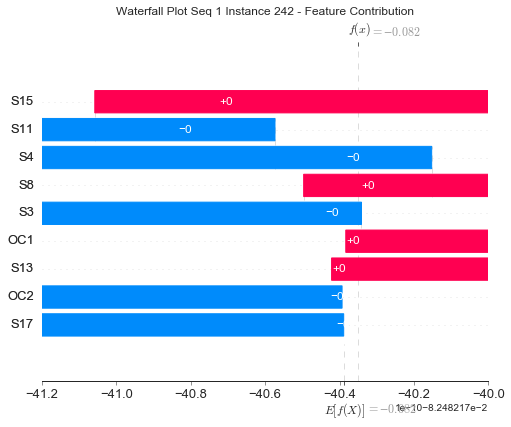

None

Contribution: [ 4.54682429e-12 -1.28673964e-11  7.23862420e-12  9.92625253e-12
 -1.62554969e-11  1.39706866e-11 -3.84871171e-12 -6.91312459e-12
  3.35061080e-12]


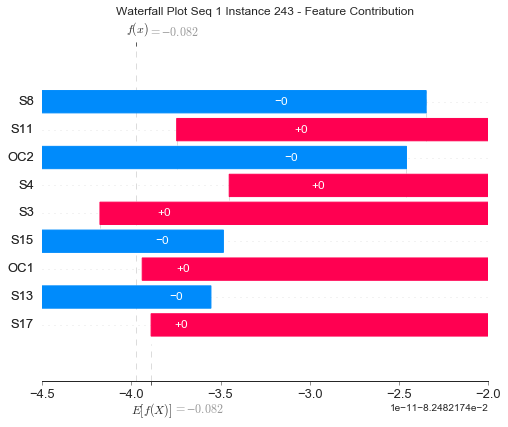

None

Contribution: [-1.79224170e-11  1.46567012e-11  3.14157381e-12  3.09808672e-11
 -1.25866158e-11  1.79469842e-11 -4.31765321e-14 -2.33028336e-11
 -1.07694860e-11]


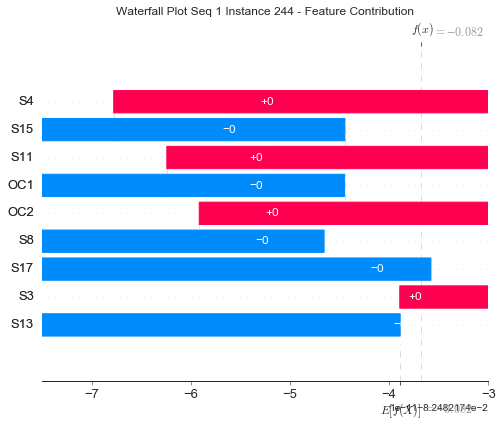

None

Contribution: [-6.13260324e-14 -2.27066629e-13  5.16650633e-13  6.75768415e-13
 -4.08556733e-13  1.59339826e-12 -4.02447512e-14 -3.64036058e-13
  1.05159561e-13]


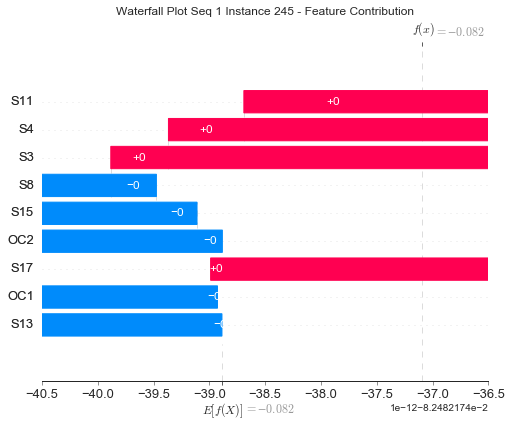

None

Contribution: [-1.11969782e-11  1.23262607e-11  1.26822858e-12  2.21528750e-11
 -9.85521560e-12  1.38906022e-11 -5.43093741e-14 -1.77872925e-11
 -8.61946365e-12]


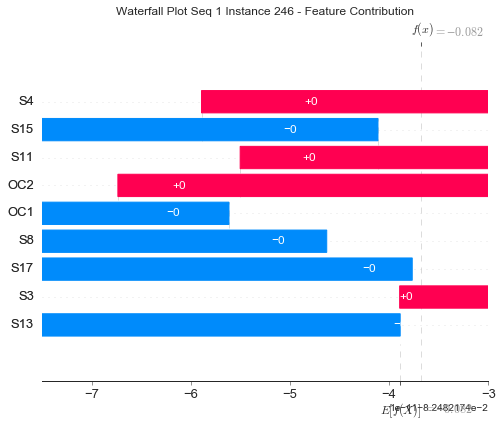

None

Contribution: [ 1.45631823e-11 -9.54912191e-12 -2.44405138e-11 -7.83276013e-11
  5.69754209e-11 -6.64328453e-11  8.22315219e-12  1.06611692e-10
  4.52511075e-12]


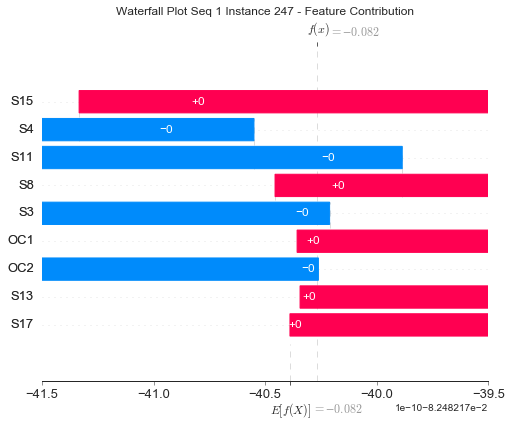

None

Contribution: [-1.51080624e-11  1.32497026e-11  7.83135275e-12  4.27324773e-11
 -2.58377833e-11  3.24952253e-11 -3.50172083e-12 -4.43551272e-11
 -8.64011900e-12]


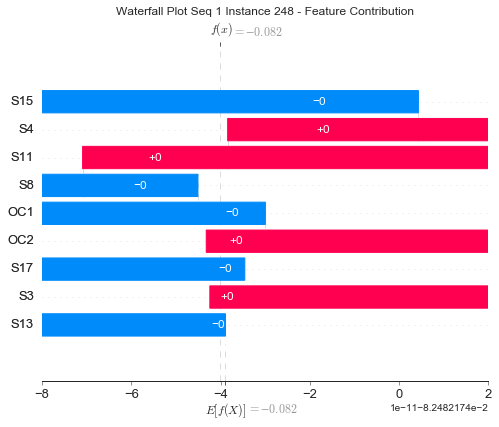

None

Contribution: [-1.94951919e-11  1.95237299e-11  1.29757468e-12  3.28418993e-11
 -1.54871949e-11  2.16725440e-11 -1.27749360e-13 -2.76835325e-11
 -1.16058751e-11]


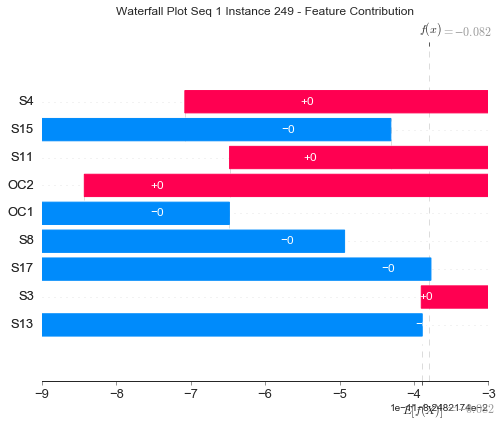

None

Contribution: [ 5.28866057e-12 -5.55677466e-12  5.56357824e-12  2.21792268e-12
 -7.26731002e-12  1.20651371e-11 -7.23084515e-13 -1.35286721e-11
  4.67455241e-12]


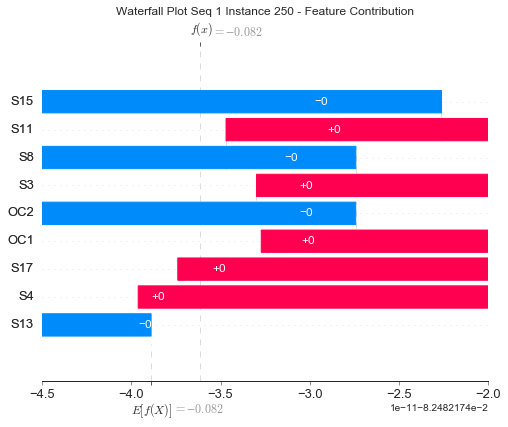

None

Contribution: [-1.18791695e-11  1.17305809e-11  1.41110322e-12  2.09703747e-11
 -8.69525806e-12  1.26807731e-11 -2.72000152e-14 -1.65235915e-11
 -7.22829999e-12]


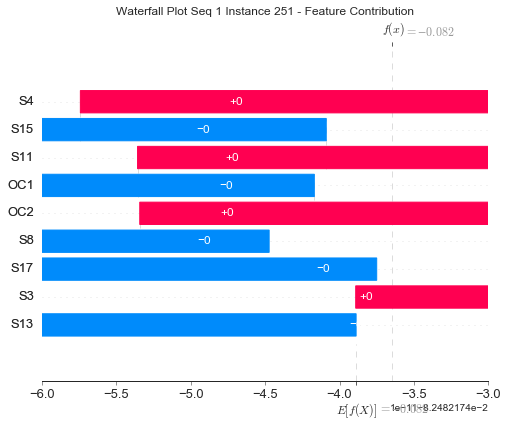

None

Contribution: [ 1.53923608e-12 -2.30130498e-12  1.03718737e-13 -6.89884456e-13
 -4.27960700e-13 -2.41365630e-13 -6.60602757e-14  4.43645858e-12
  2.45668828e-13]


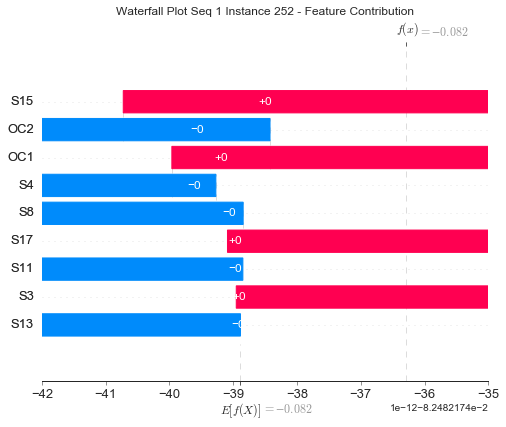

None

Contribution: [ 1.08815951e-11 -6.16214198e-12 -1.77775470e-12 -1.99071610e-11
  8.87773102e-12 -1.20407868e-11 -2.55048109e-14  1.20761751e-11
  5.75889553e-12]


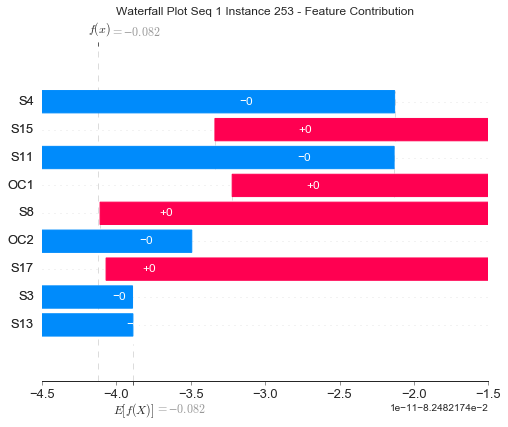

None

Contribution: [ 1.22102120e-11 -8.67856308e-12  3.30434963e-12 -4.24323033e-12
 -3.49681287e-12  7.38104803e-12 -1.14027158e-12 -6.44977041e-12
  5.63372656e-12]


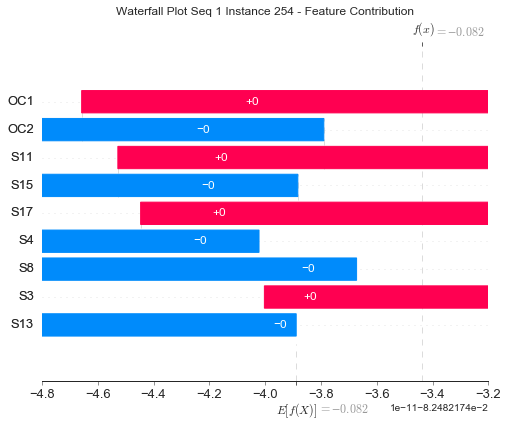

None

Contribution: [-2.17327089e-12 -2.88350452e-13 -3.42672668e-13  6.29413709e-12
 -5.83761164e-12  6.34428014e-12  2.22188838e-14  3.40895411e-12
 -2.67180158e-12]


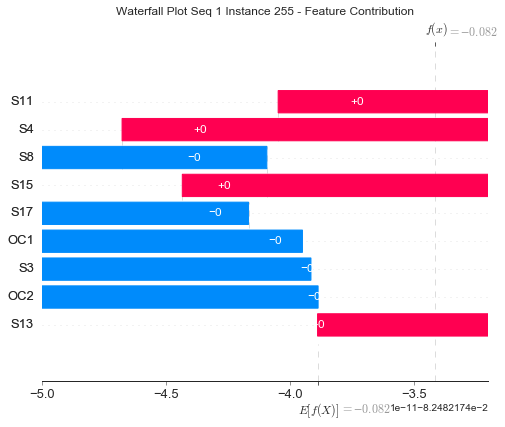

None

Contribution: [ 2.02941966e-13  3.45418572e-13 -7.64019230e-12 -2.50601016e-11
  2.42287128e-11 -3.40988800e-11  4.56901791e-12  4.59133218e-11
 -1.67295214e-12]


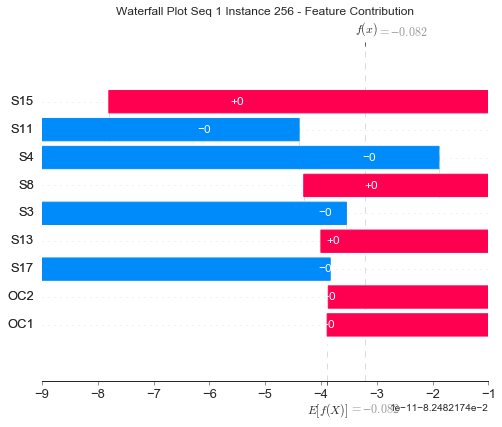

None

Contribution: [ 4.54495556e-12 -3.37270657e-13 -1.19038744e-13 -3.54797311e-12
  2.61690257e-12 -2.17519622e-12  5.01784012e-14  7.12222273e-13
  3.34085109e-13]


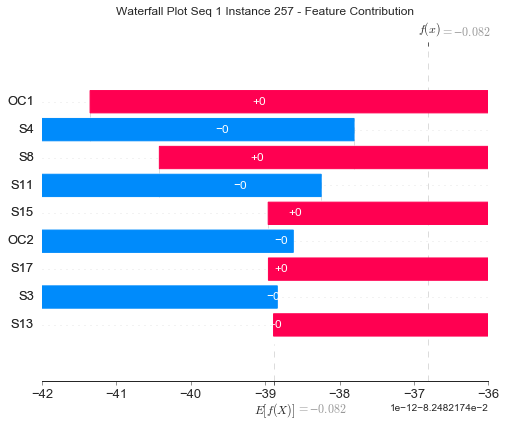

None

Contribution: [-4.87571095e-12 -7.47351887e-13  7.61580903e-13  3.79924347e-12
 -8.24011378e-13  3.52616243e-12  1.74357151e-13 -2.13660188e-12
  8.35579490e-13]


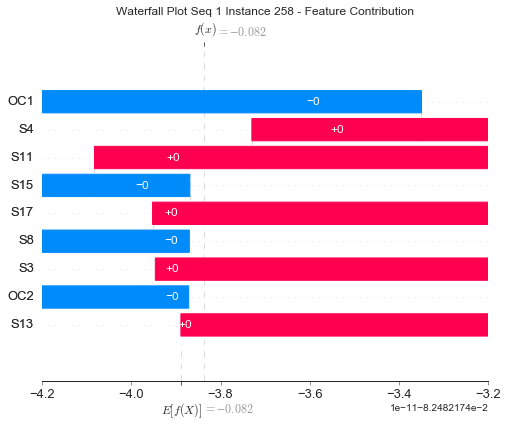

None

Contribution: [-1.21828112e-11 -8.35697657e-12  7.28572497e-12  7.91176499e-12
  1.90831530e-12  4.43930699e-12  8.80323332e-12 -1.44481139e-12
  2.26940298e-12]


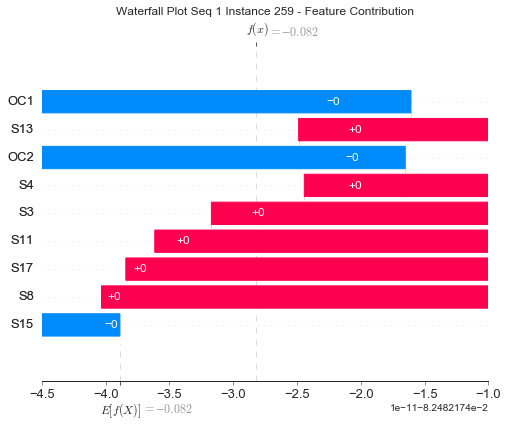

None

Contribution: [-1.13126513e-11 -1.71395346e-11  8.64983692e-12  1.90205317e-11
 -1.25139387e-11  2.23294768e-11  5.65208123e-12  2.40699431e-12
  8.63624656e-13]


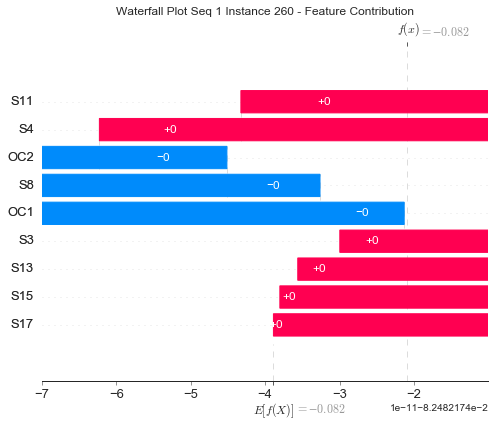

None

Contribution: [-1.13828348e-11 -1.83940328e-11  8.71054184e-12  1.86366790e-11
 -9.66314008e-12  2.09407821e-11  4.88753742e-12  1.77574726e-11
  1.42982869e-12]


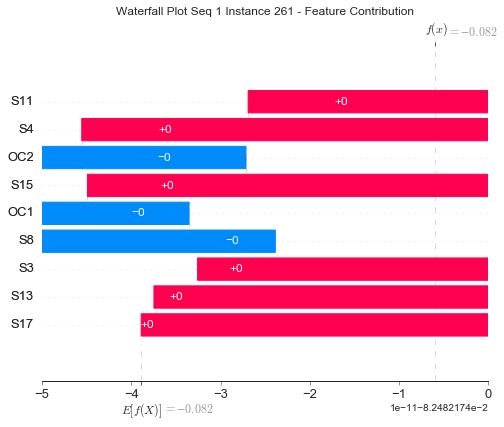

None

Contribution: [-2.44108466e-11 -3.57702548e-11  1.26522629e-11  2.75022140e-11
 -2.43892337e-11  4.51963501e-11  5.76984294e-12  8.62966469e-12
  2.96169122e-12]


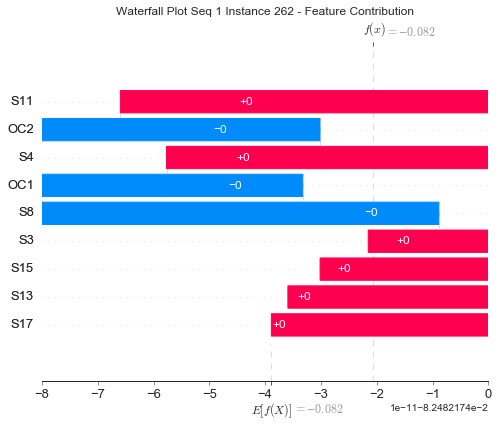

None

Contribution: [-2.50304742e-11 -4.24574646e-11  1.27915846e-11  3.40476362e-11
 -3.50160630e-11  5.47255817e-11  2.72775465e-12  1.08849822e-11
  1.97026802e-13]


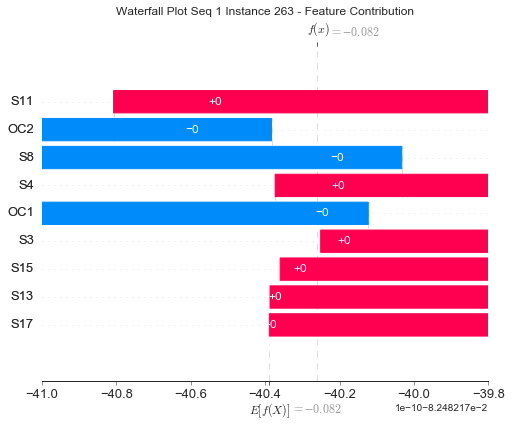

None

Contribution: [-5.62549833e-12 -4.37954985e-11  7.56151218e-12  3.10633429e-11
 -4.32113720e-11  5.51666837e-11 -3.64019931e-13  2.35628374e-11
 -5.78480146e-12]


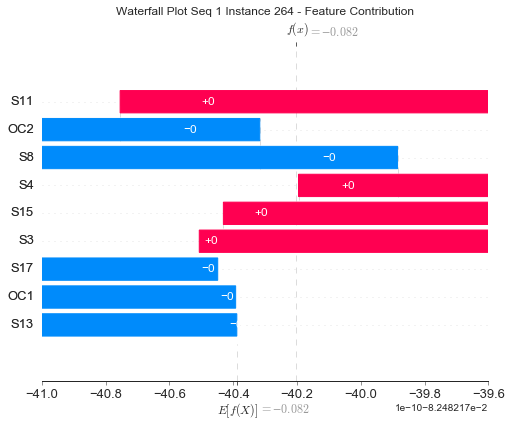

None

Contribution: [-1.33421442e-11 -4.00129339e-11  1.20505758e-11  2.59085028e-11
 -1.87447610e-11  4.80734688e-11  2.31601739e-12  4.92057749e-11
  4.43496368e-12]


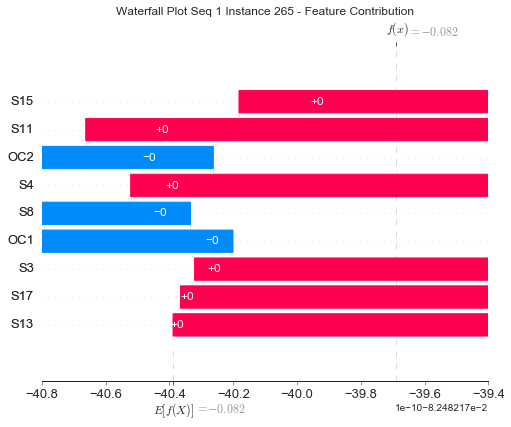

None

Contribution: [-1.12947134e-11 -5.00520597e-11  9.98543262e-12  3.32203744e-11
 -4.51554558e-11  7.32283817e-11 -5.59107188e-12  2.41769955e-11
 -3.18932402e-12]


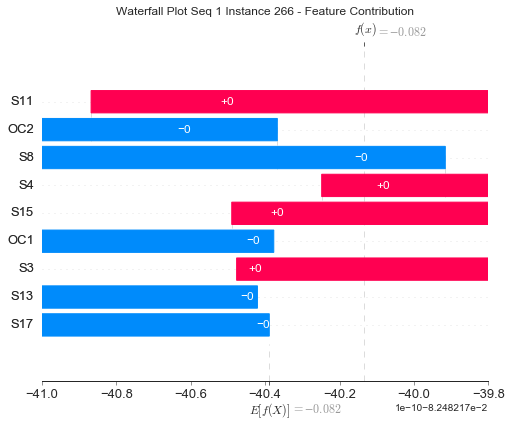

None

Contribution: [ 5.20433592e-11  4.20501203e-11 -1.91496749e-11  3.25113964e-11
 -5.61616344e-11  4.82337746e-11 -1.67451018e-11  1.72657860e-11
 -4.47558969e-11]


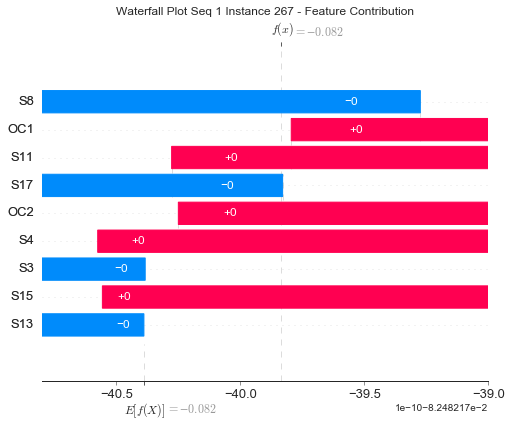

None

Contribution: [ 3.93840099e-11  4.71099722e-12  1.24192960e-13  1.49010960e-11
 -4.09213531e-11  4.79397980e-11 -6.35405227e-12  2.13449154e-11
 -8.03971213e-12]


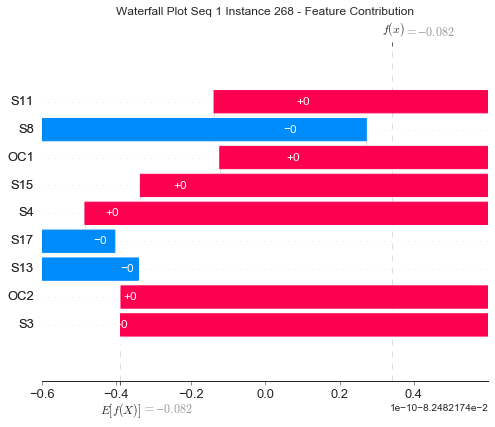

None

Contribution: [ 9.88726045e-11  5.64653185e-11 -2.24705567e-11 -1.06431764e-11
 -1.41021500e-11 -1.19659843e-13 -1.59215783e-11  3.58652968e-11
 -3.05504060e-11]


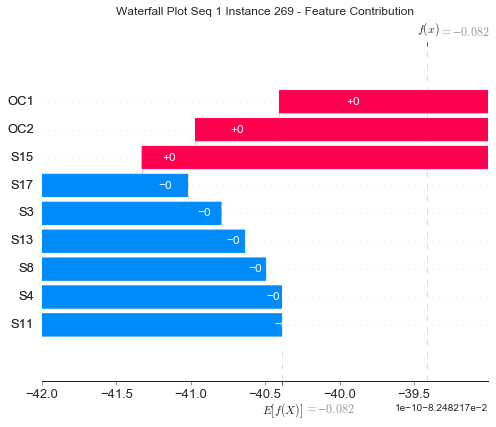

None

Contribution: [ 7.48172982e-11  8.38746225e-11 -1.17843226e-11 -2.22082561e-11
  2.12443886e-13 -8.35938350e-12 -3.90911567e-14  2.37153884e-13
 -6.42649475e-12]


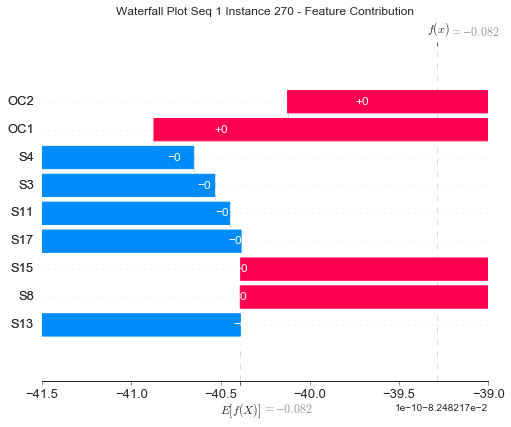

None

Contribution: [ 1.68248290e-10  1.50038468e-10 -4.51882004e-11 -5.63787420e-11
  3.12899776e-11 -6.99757821e-11 -1.64117695e-11  3.38318436e-11
 -5.05780383e-11]


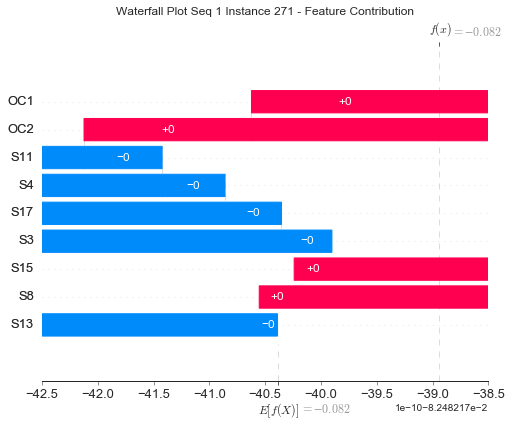

None

Contribution: [ 9.64569952e-11  1.42876308e-10 -1.81448519e-11 -5.72790738e-11
  2.08667458e-11 -2.63824483e-11 -4.46028978e-12 -1.19711296e-10
 -1.66059059e-11]


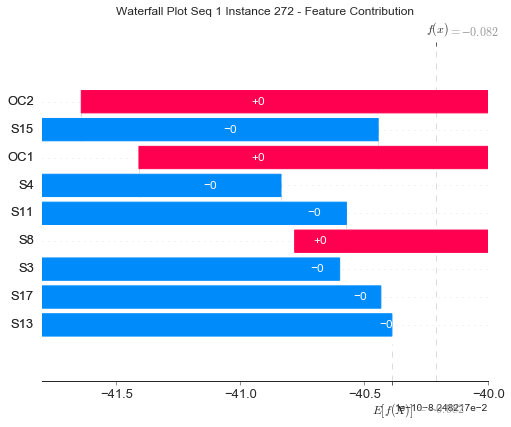

None

Contribution: [ 1.61799435e-10  2.13734058e-10 -4.61637326e-11 -8.66836325e-11
  4.56867391e-11 -9.55724735e-11 -7.62503602e-12 -1.81970591e-10
 -3.45931409e-11]


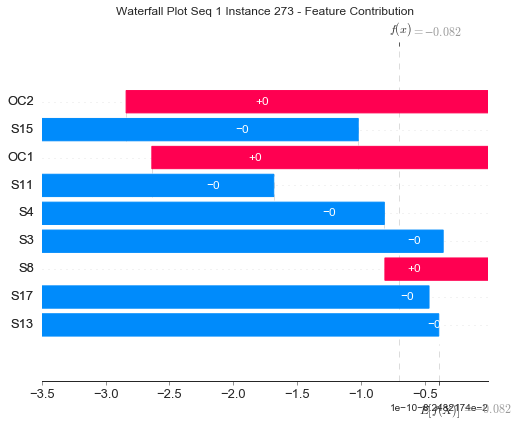

None

Contribution: [ 1.98777370e-10  2.73877004e-10 -7.04532890e-11 -1.57115307e-10
  9.55847484e-11 -1.89218030e-10 -3.12663285e-12 -1.55249327e-10
 -5.82100201e-11]


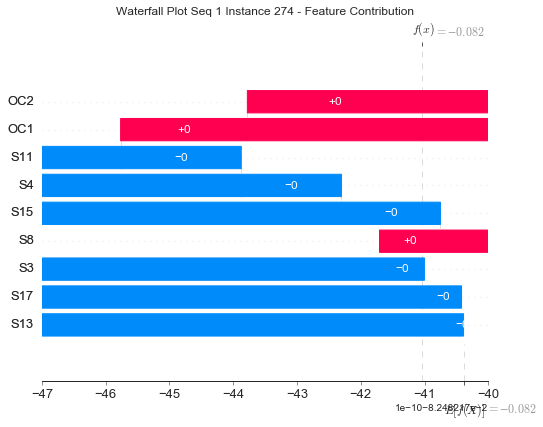

None

Contribution: [ 6.80088277e-11  1.32276620e-10 -1.28006882e-12 -2.03728048e-10
  2.04123454e-10 -1.76822876e-10  4.24215420e-11 -2.89596014e-10
  5.79442813e-11]


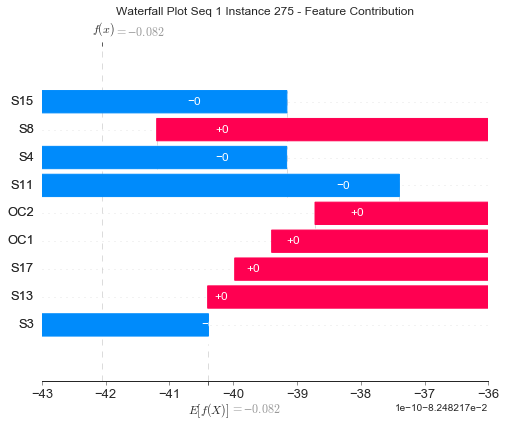

None

Contribution: [ 2.75764023e-10  3.94077243e-10 -7.35923822e-11 -1.77509507e-10
  1.45671072e-10 -2.19826851e-10  4.15813148e-11 -2.99525571e-10
 -4.96778972e-11]


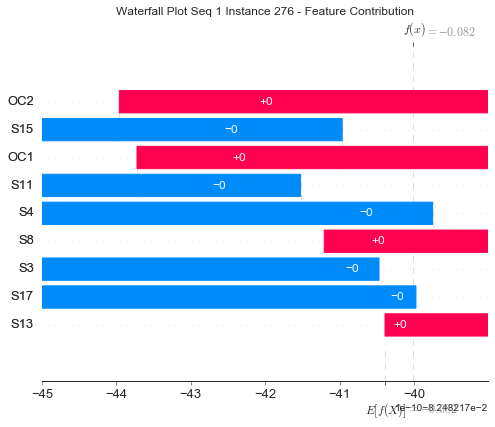

None

Contribution: [ 7.83688392e-11  9.83974985e-11  6.43242959e-11 -3.97130939e-10
  5.41137246e-10 -3.22515487e-10  1.64029096e-10 -2.63609082e-11
  2.48590065e-10]


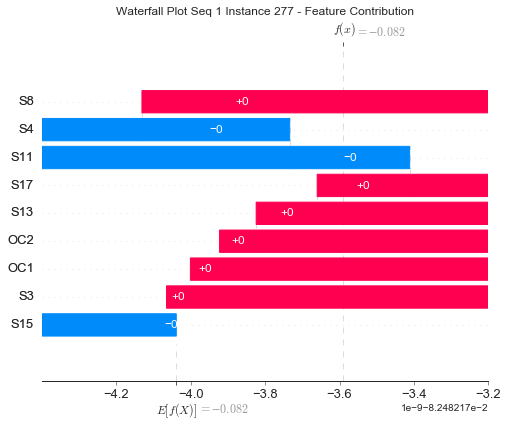

None

Contribution: [ 1.62148808e-10  3.35357464e-10  1.30632458e-11 -3.96513988e-10
  5.72762227e-10 -3.57287477e-10  1.56464522e-10 -1.17151608e-10
  1.64575020e-10]


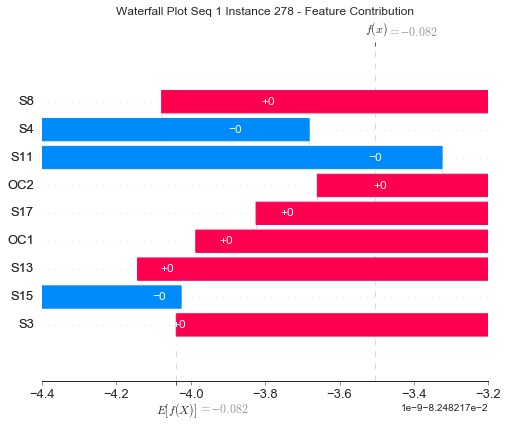

None

Contribution: [ 8.07919148e-11  2.84720664e-10  2.39261600e-13 -4.04597439e-10
  4.13015039e-10 -2.66707323e-10  9.58375532e-11 -5.93591398e-10
  1.93619065e-10]


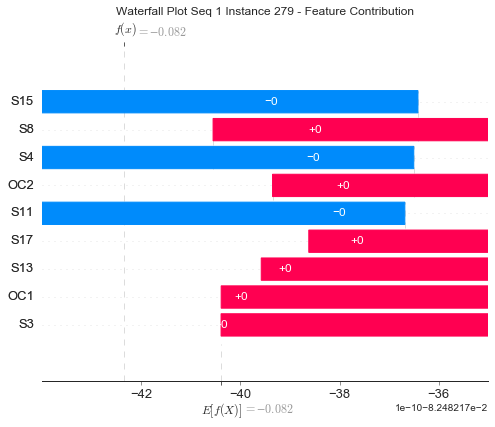

None

Contribution: [ 6.86235790e-10  7.37436168e-10 -1.40687628e-10 -7.09342363e-10
  7.43725859e-10 -8.59885607e-10  1.42810402e-10 -1.18581436e-10
  7.27580288e-11]


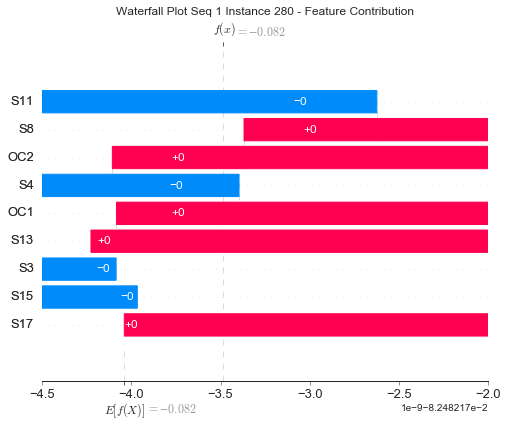

None

Contribution: [ 7.06491421e-10  1.17125010e-09 -2.66163369e-10 -6.22407459e-10
  7.60670915e-10 -9.58411461e-10  1.42524714e-10 -2.91852154e-10
 -9.94972021e-11]


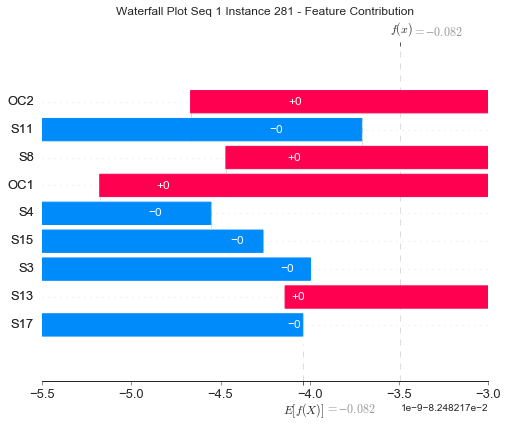

None

Contribution: [ 6.68195332e-10  1.32882738e-09 -2.61881433e-10 -8.43463022e-10
  1.08321108e-09 -1.21627974e-09  1.61813507e-10 -4.28504149e-10
 -3.00275915e-11]


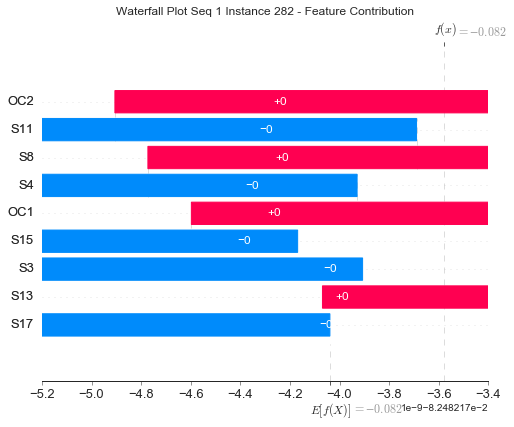

None

Contribution: [ 1.71681794e-10  9.03975783e-10 -1.80457815e-10 -6.38973041e-10
  3.28949118e-10 -6.07529915e-10  6.99219710e-11 -2.24580554e-09
 -4.34621159e-11]


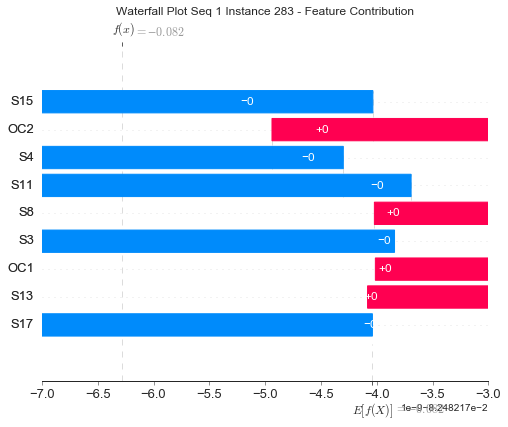

None

Contribution: [ 1.03986181e-10  9.33206290e-10 -1.60316455e-10 -5.02546560e-10
  3.04912866e-12 -3.04351599e-10 -5.93118219e-13 -2.90244562e-09
 -1.04590822e-10]


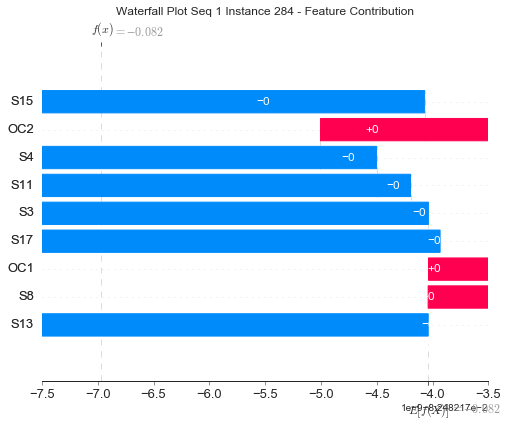

None

Contribution: [-4.84678860e-11  3.12742554e-10  6.80955223e-11 -1.49111945e-09
  1.76270654e-09 -1.71940862e-09  5.56594826e-10 -3.35928646e-10
  6.54915011e-10]


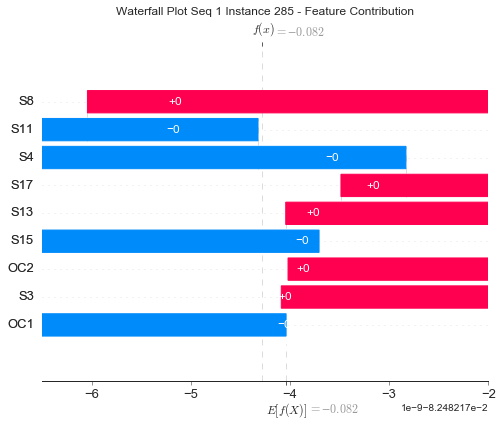

None

Contribution: [-1.09581948e-10  3.34096334e-10 -4.35001965e-11 -1.40219003e-09
  1.48633694e-09 -1.67516168e-09  3.84056509e-10 -5.16695076e-10
  4.50492949e-10]


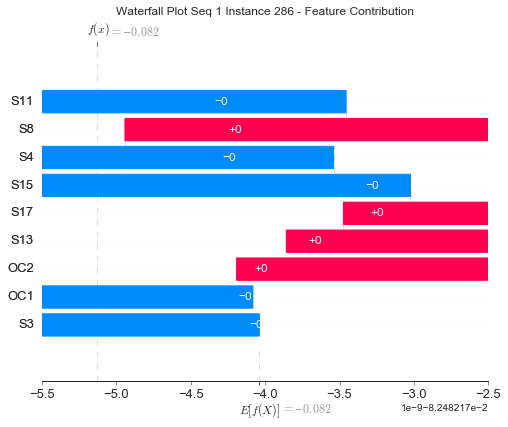

None

Contribution: [-5.69746368e-11  6.85939847e-11 -3.61536430e-13 -1.72137393e-09
  1.59410474e-09 -1.78385817e-09  3.64169445e-10 -3.62162716e-10
  6.69508227e-10]


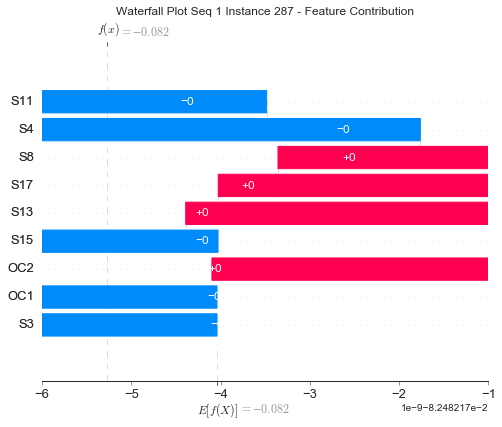

None

Contribution: [-8.78560349e-11  7.79552978e-10 -1.93957628e-10 -9.66848823e-10
  1.04570597e-09 -1.22725374e-09  2.74604200e-10 -8.58264293e-10
  8.24439891e-11]


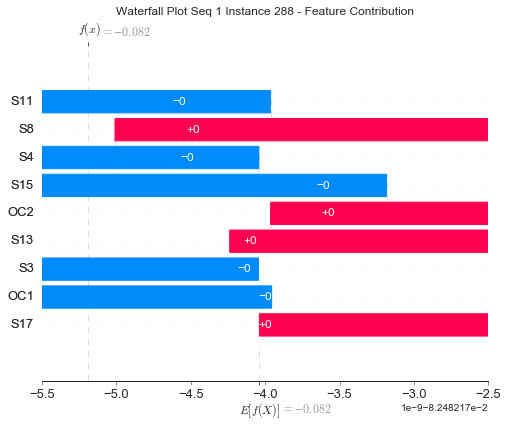

None

Contribution: [-1.80776630e-10  5.65549496e-10 -5.19549334e-11 -1.14420406e-09
  1.10155529e-09 -1.03806452e-09  3.80305176e-10 -6.83851809e-10
  3.74577175e-10]


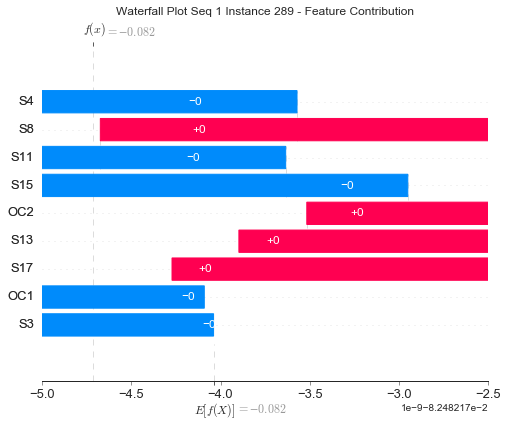

None

Contribution: [ 1.99875769e-10  5.61137914e-10  1.75396142e-10 -1.13646936e-09
  1.26094268e-09 -7.94453781e-10  5.13721343e-10 -1.95870195e-10
  6.87938928e-10]


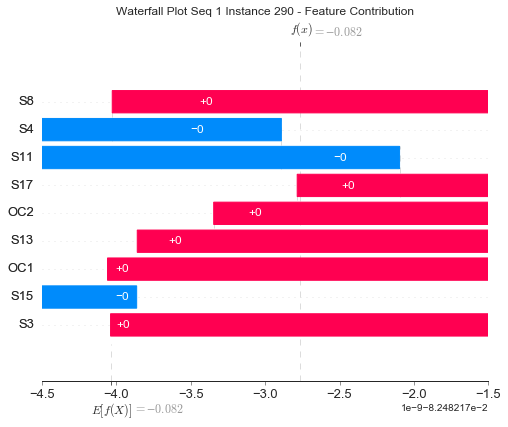

None

Contribution: [-9.30279465e-11  4.25535107e-10  1.87284632e-10 -1.03824194e-09
  1.27101074e-09 -4.68976302e-10  5.44874368e-10 -4.50136262e-10
  6.05878792e-10]


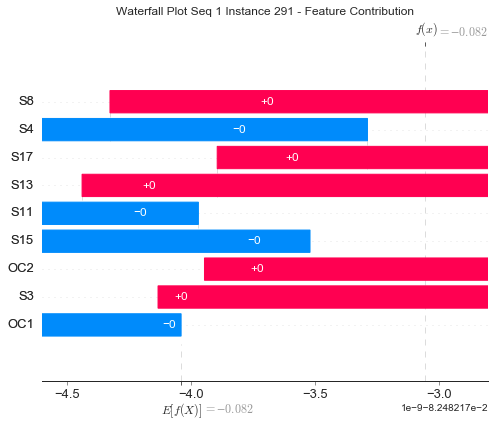

None

Contribution: [ 1.10091680e-09  1.33517819e-09 -1.36862729e-10 -7.27547966e-10
  1.30737060e-10 -4.79095152e-10  1.13337124e-10 -7.74621312e-10
  2.00548952e-10]


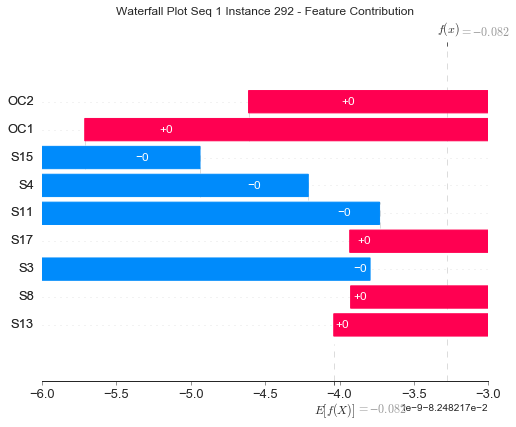

None

Contribution: [ 2.99643643e-09  2.52263455e-09 -5.26755917e-10 -1.48667922e-09
  1.40776901e-09 -1.85671312e-09  4.86490348e-10  2.02377753e-10
 -3.01731168e-10]


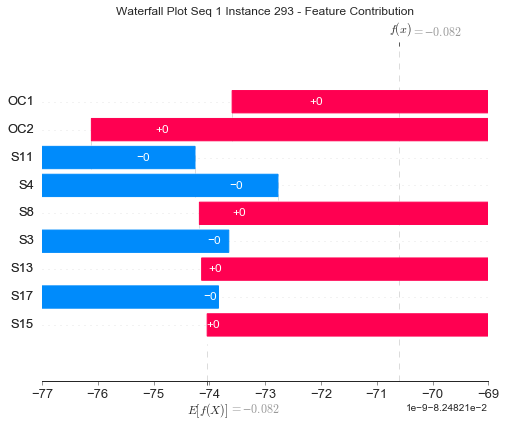

None

Contribution: [-1.03697120e-10 -2.06695924e-10  6.52717880e-11 -1.85087674e-11
 -1.58333763e-10  3.81017523e-10  4.23042920e-11 -8.13131854e-11
  4.20646989e-10]


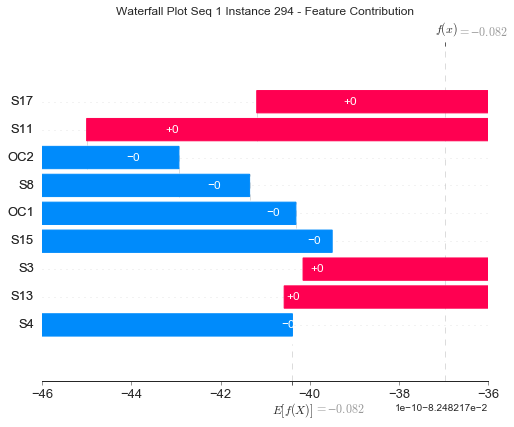

None

Contribution: [ 9.20530335e-15  0.00000000e+00  3.20327737e-10  5.15375631e-10
 -6.84304946e-10  1.32521416e-09 -1.28361696e-10  4.94116241e-11
  5.96365846e-10]


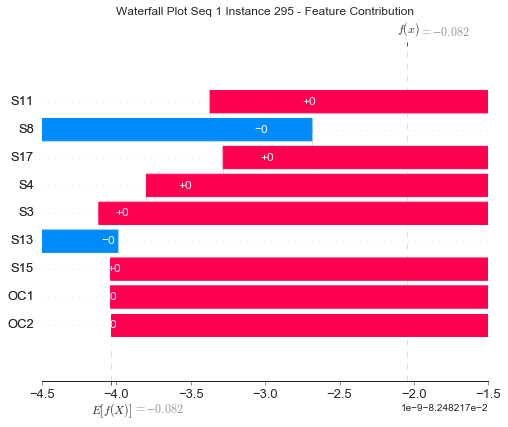

None

Contribution: [ 1.17896937e-09  3.60437125e-10 -1.35845085e-10 -2.05681305e-10
 -3.10668075e-10  3.46350809e-10 -2.15314502e-10  4.71857498e-10
  5.69636283e-11]


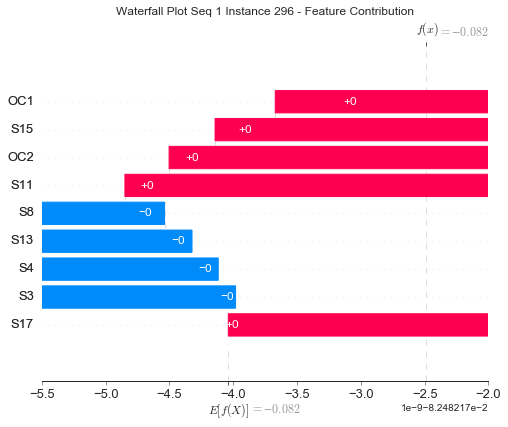

None

Contribution: [ 5.09213474e-14  3.72774457e-13  5.34164935e-10 -2.40026159e-11
  8.94702784e-11  9.58823465e-10 -1.03807407e-10  7.84922197e-11
  1.29719024e-09]


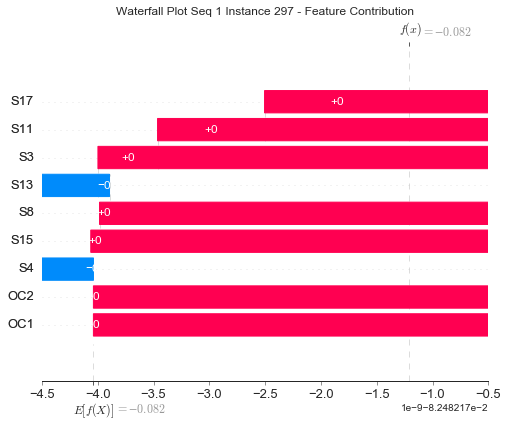

None

Contribution: [ 1.16408549e-09  1.75450798e-09 -7.62653496e-10 -1.67586900e-09
  7.05770442e-10 -2.32805997e-09 -8.55975069e-10 -3.38861189e-10
 -4.08161088e-10]


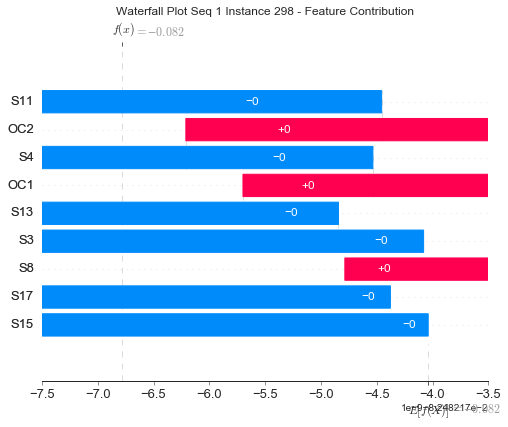

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


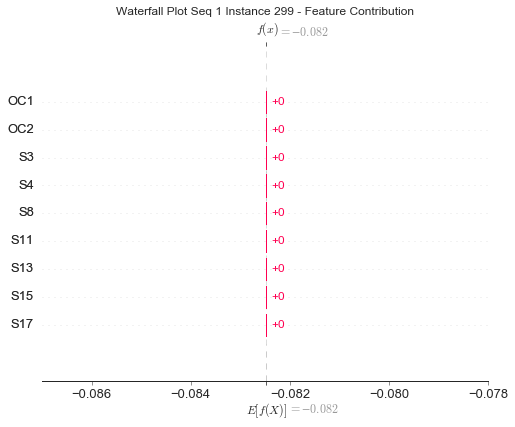

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


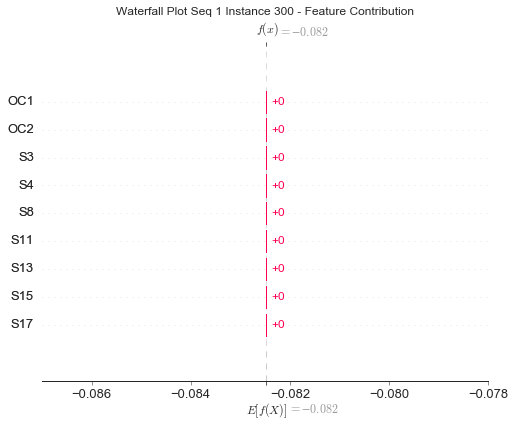

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


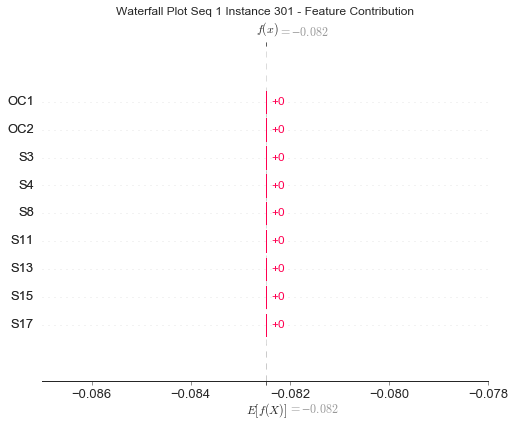

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


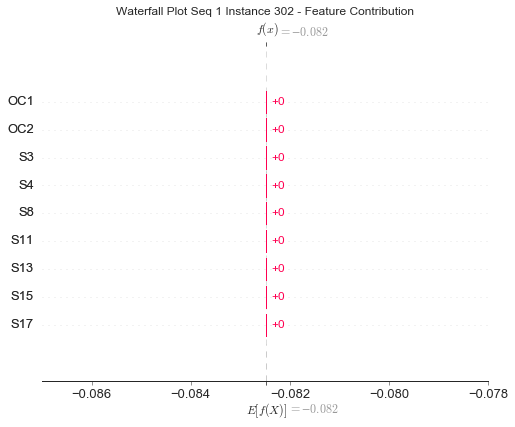

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


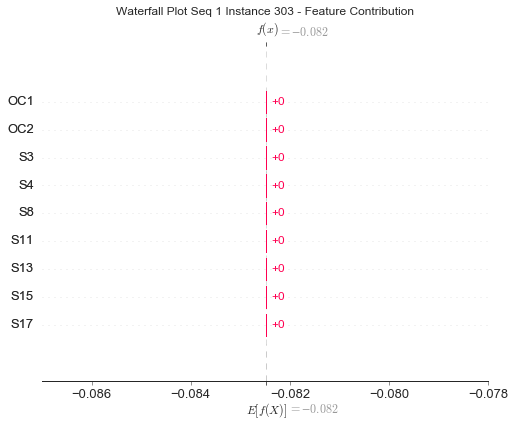

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


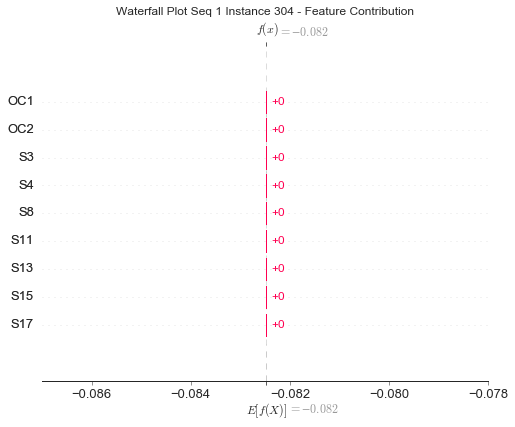

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


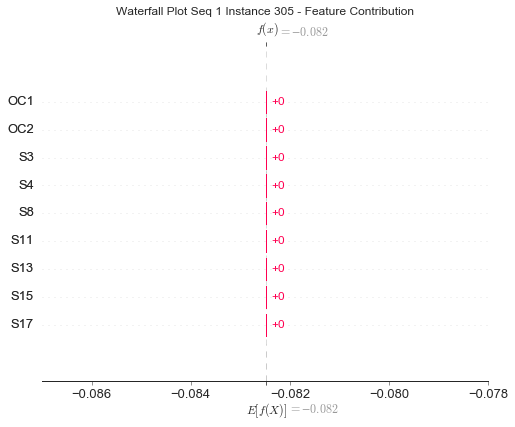

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


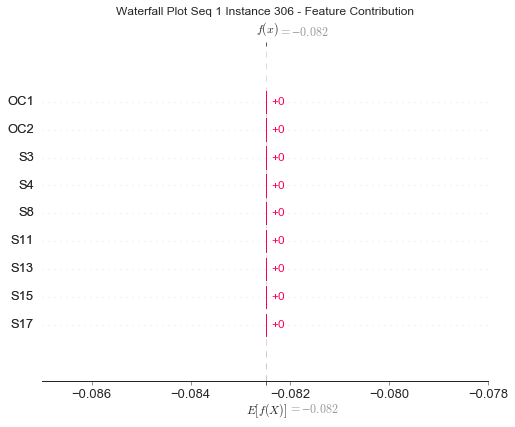

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


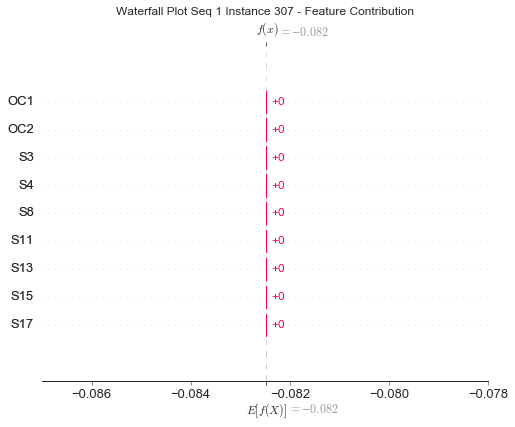

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


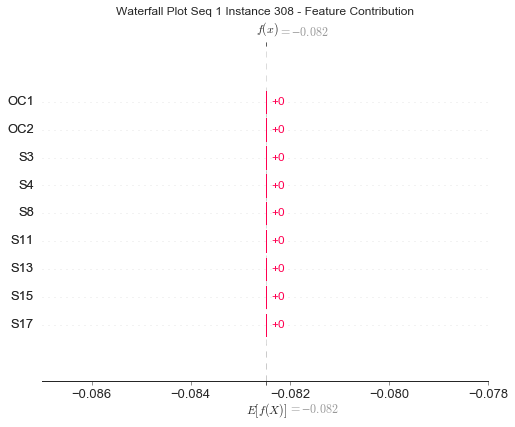

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


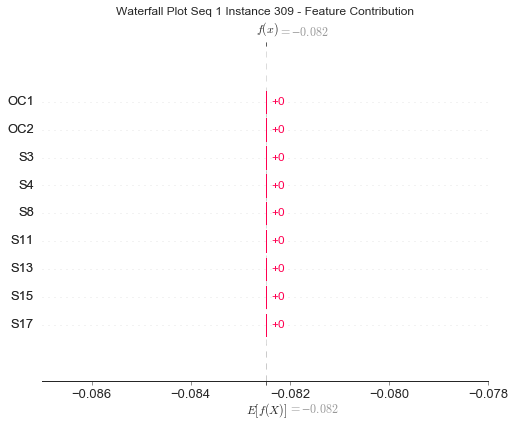

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


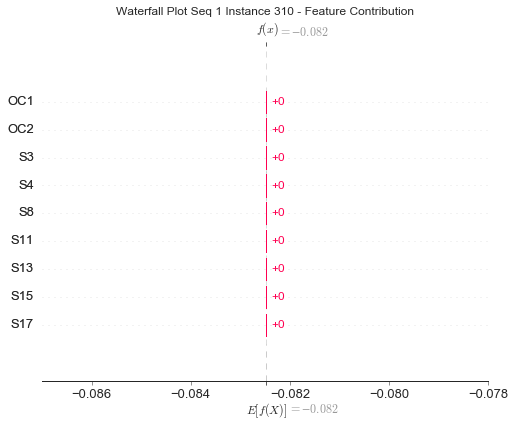

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


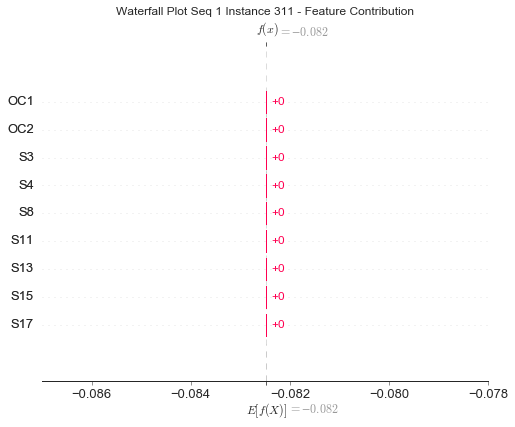

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


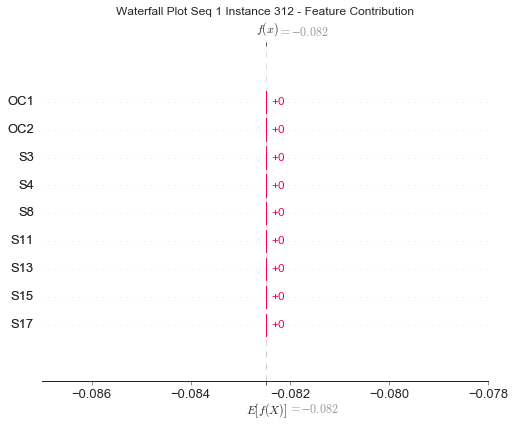

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


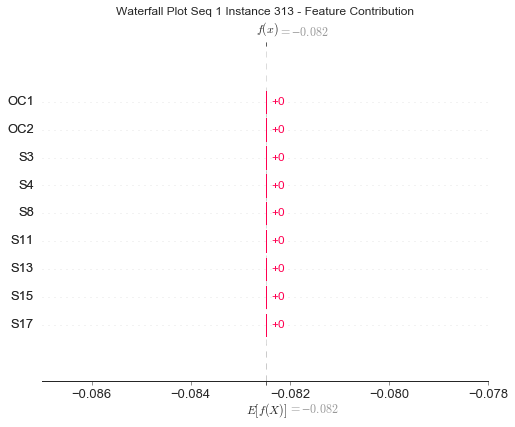

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


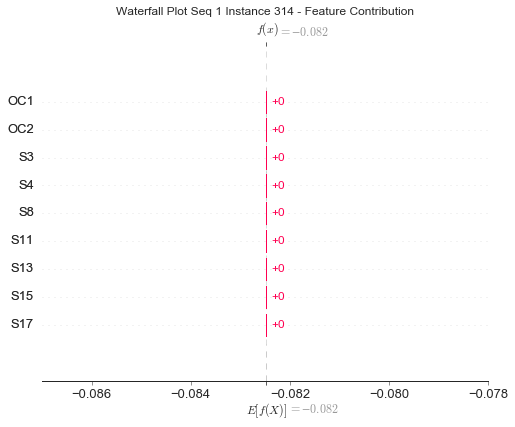

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


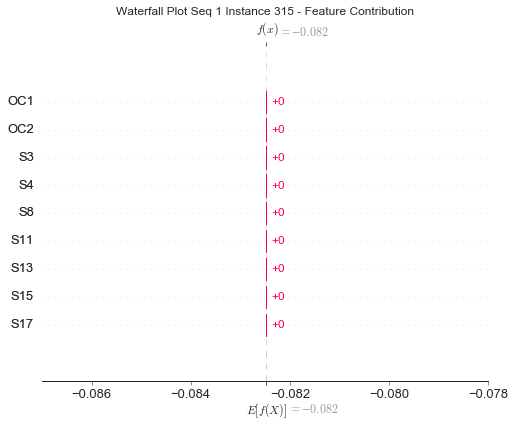

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


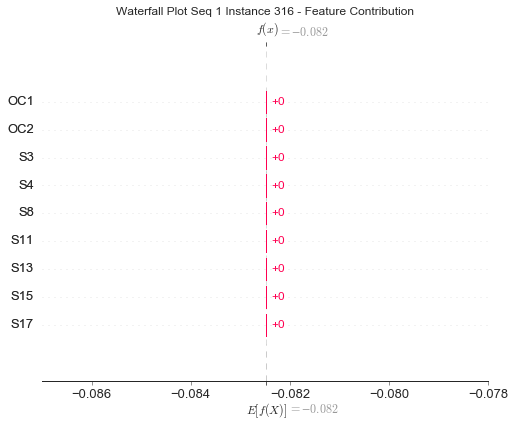

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


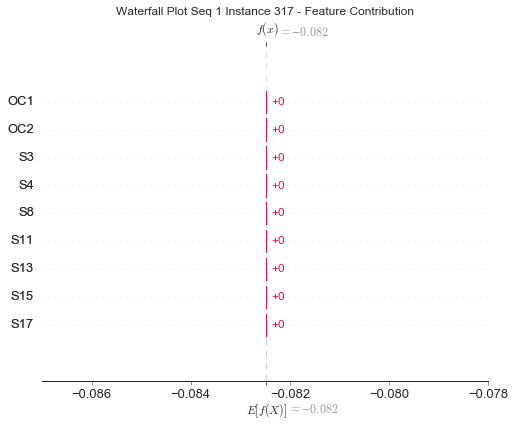

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


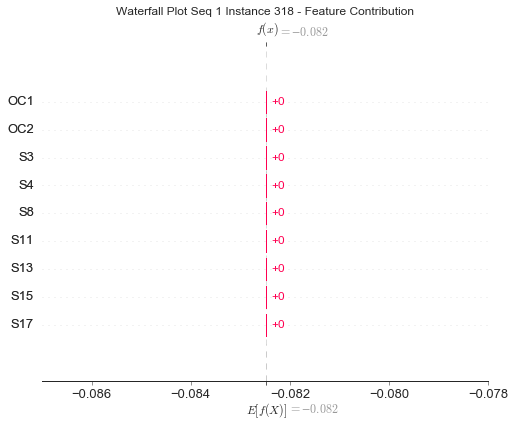

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


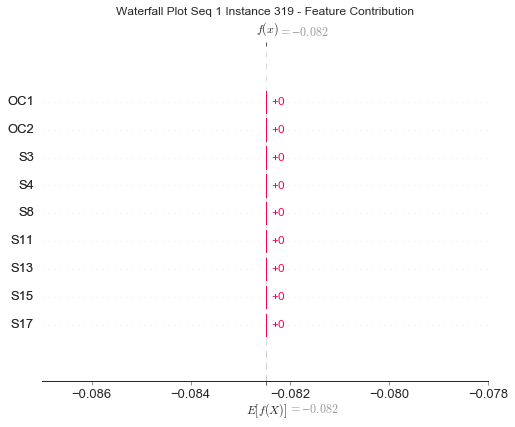

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


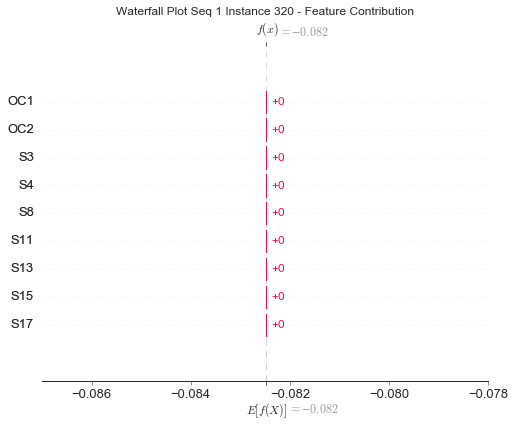

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


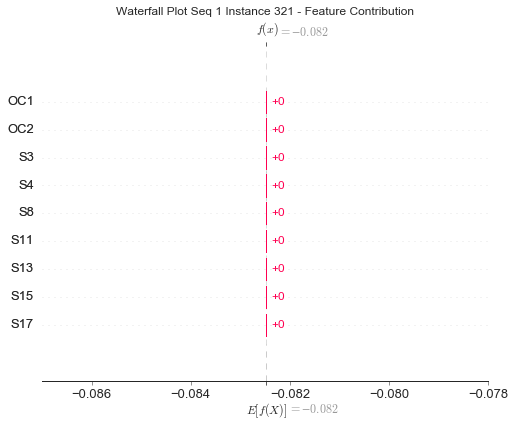

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


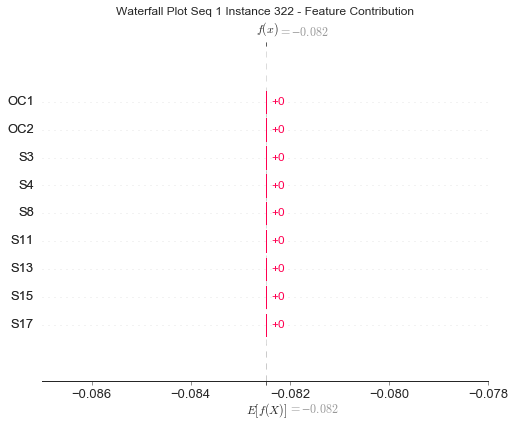

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


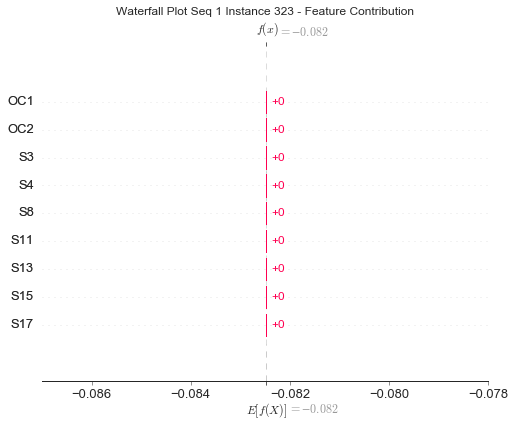

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


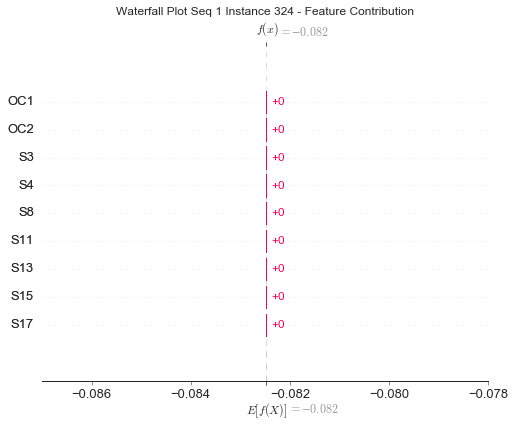

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


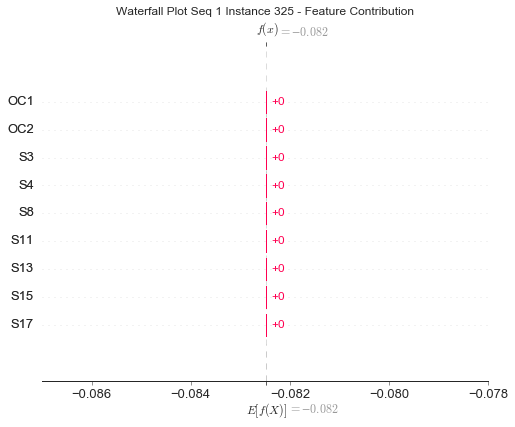

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


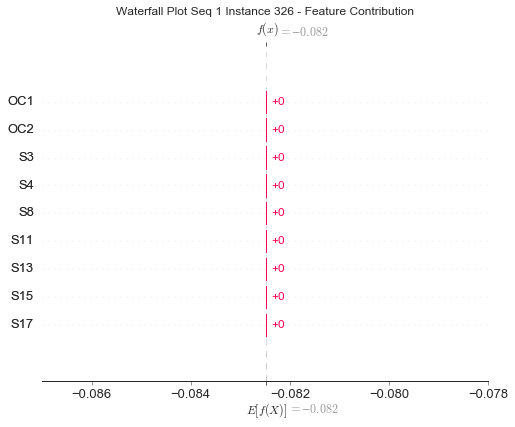

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


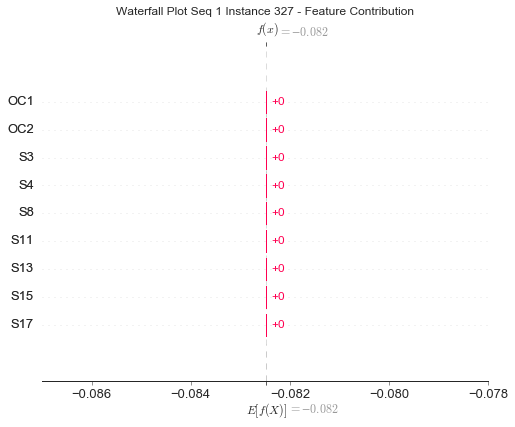

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


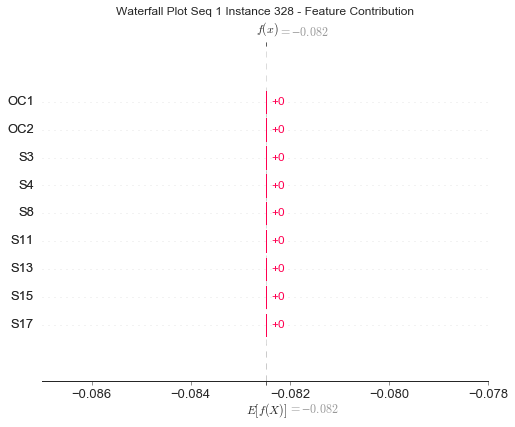

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


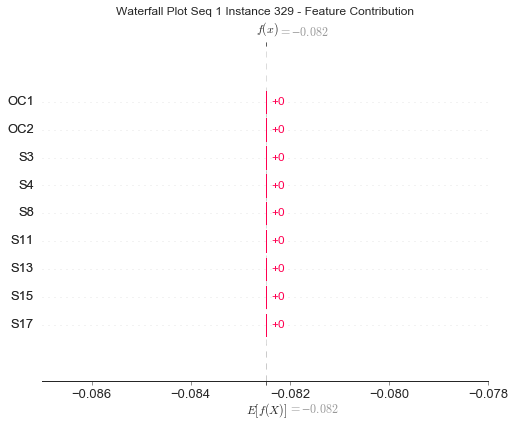

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


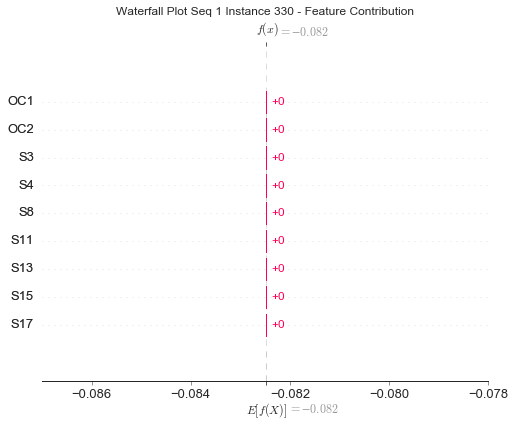

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


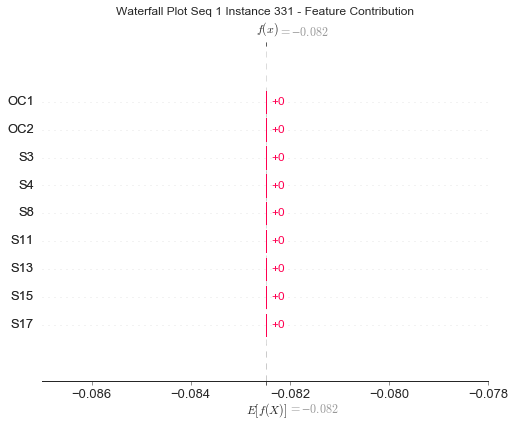

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


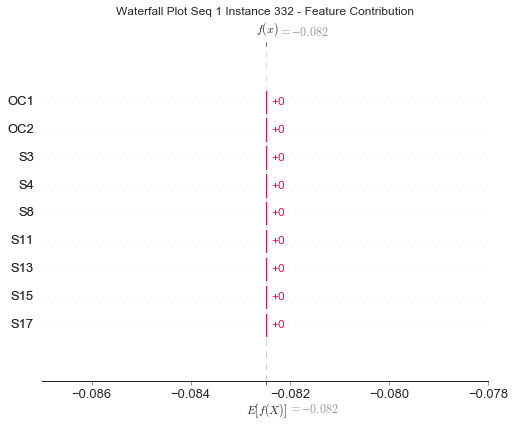

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


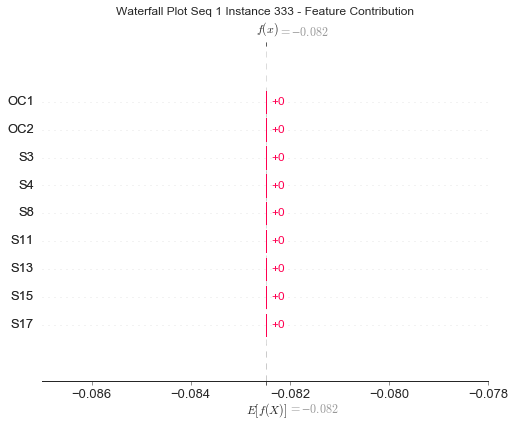

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


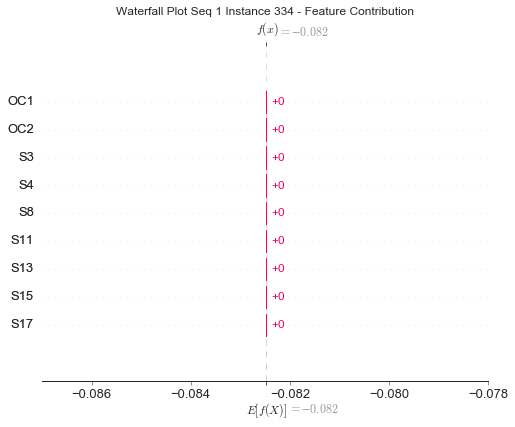

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


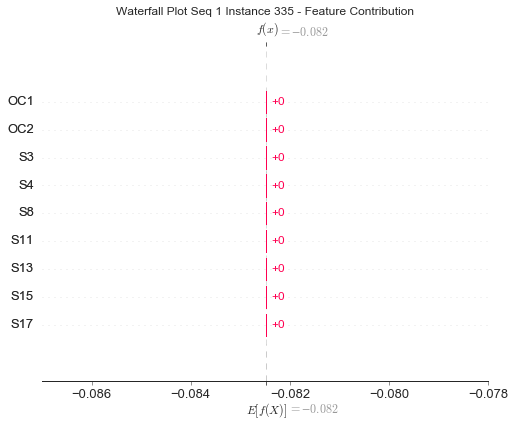

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


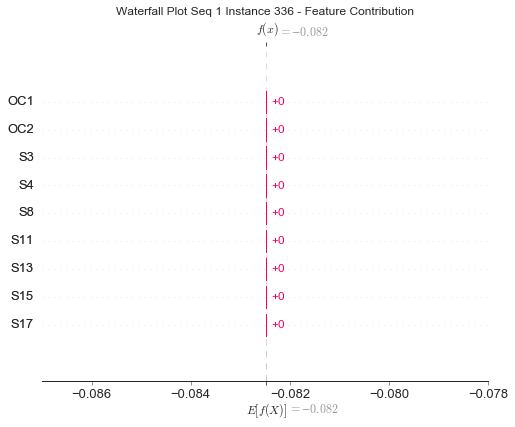

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


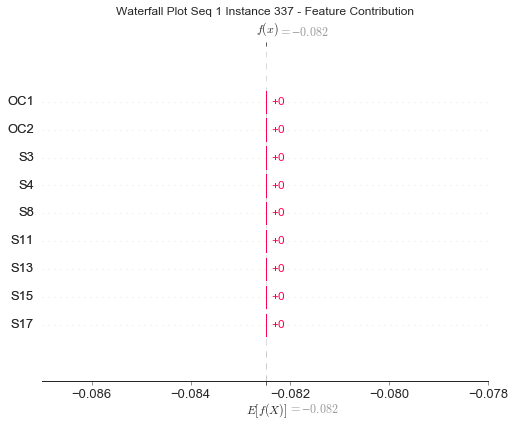

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


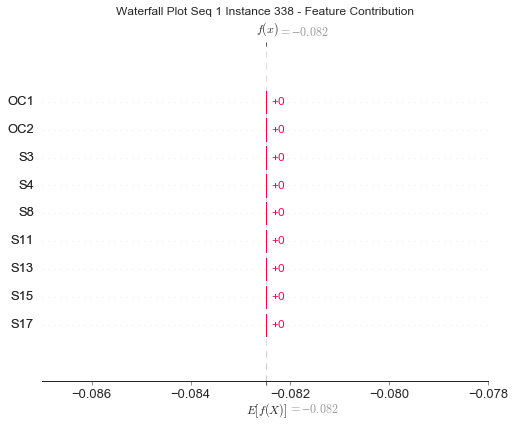

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


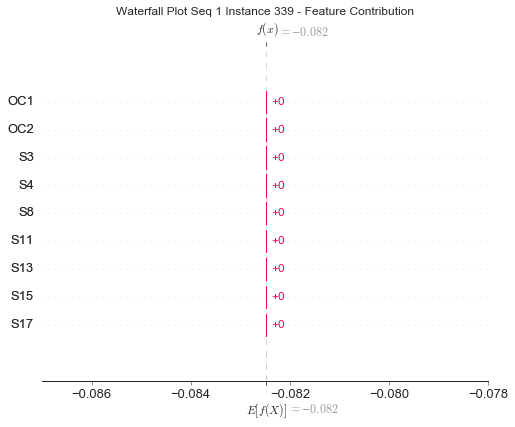

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


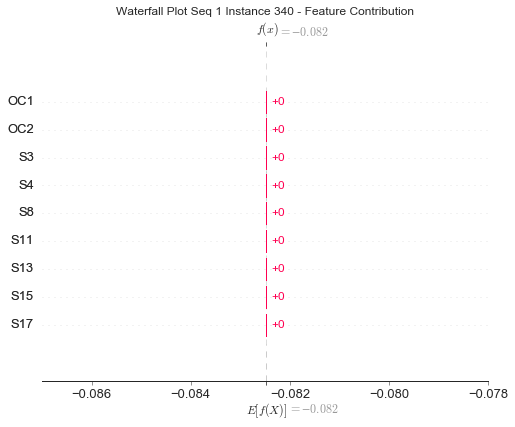

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


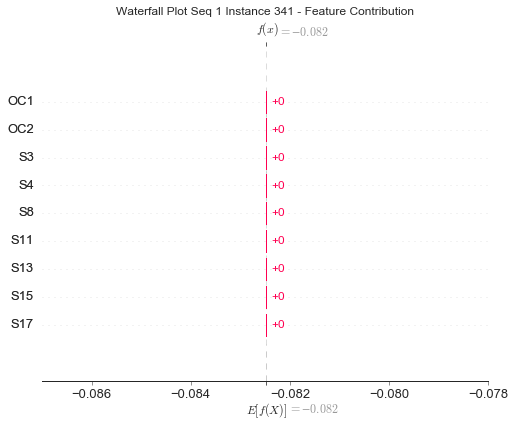

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


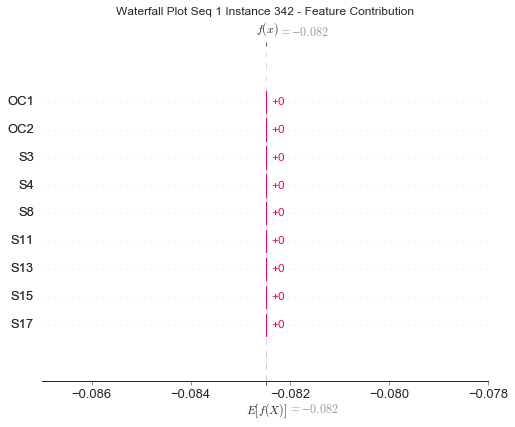

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


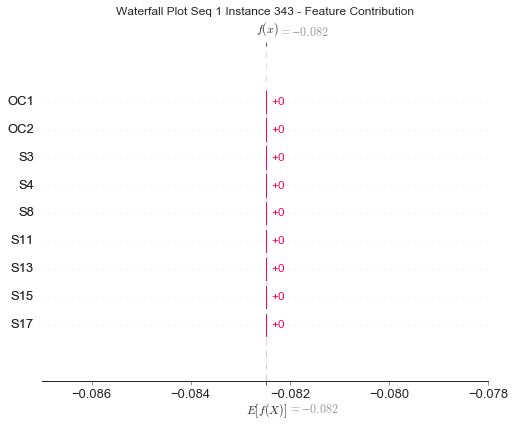

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


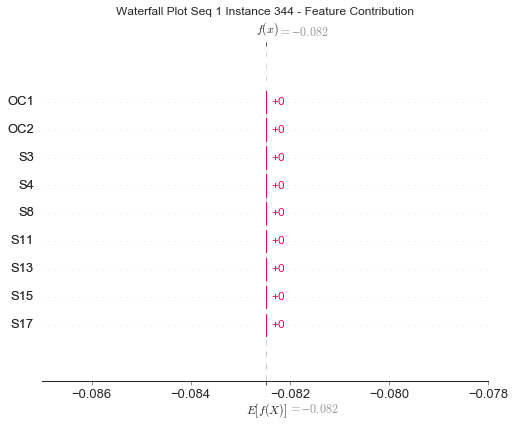

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


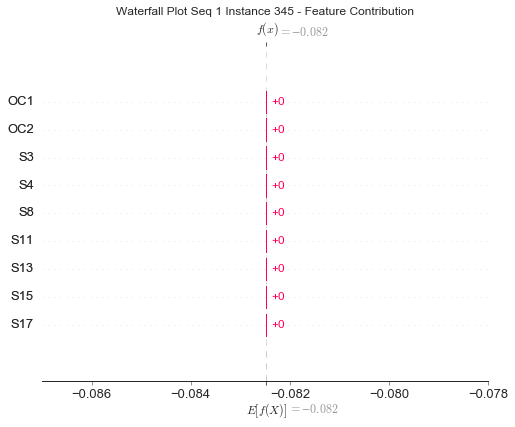

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


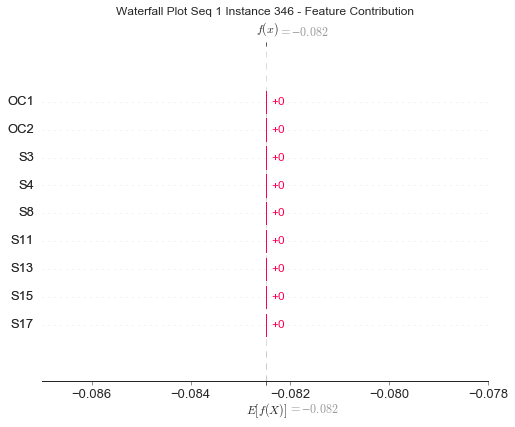

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


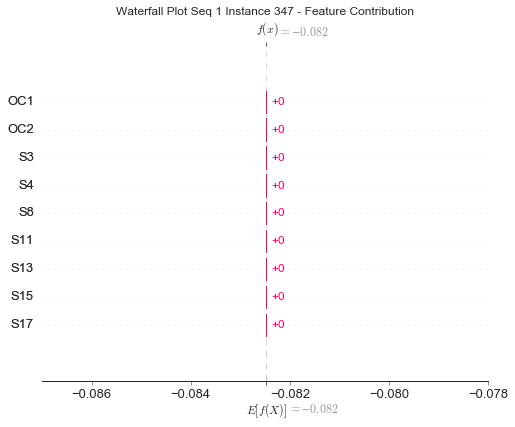

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


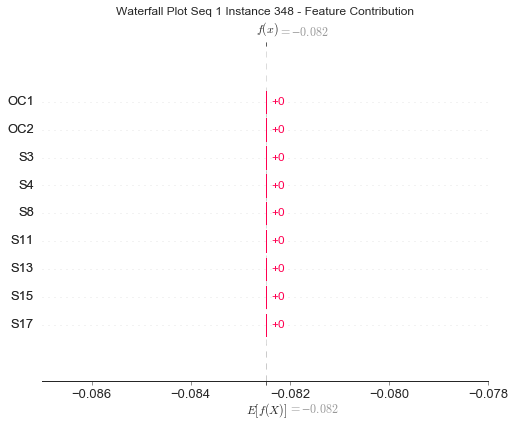

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


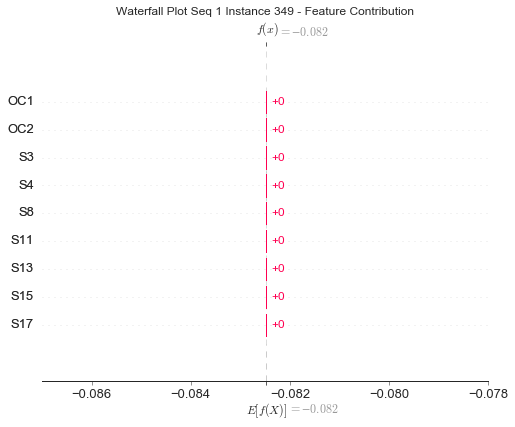

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


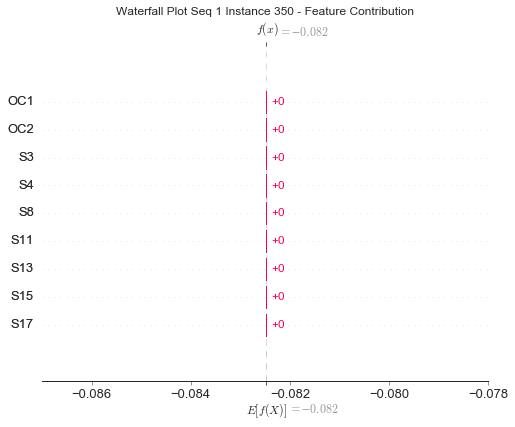

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


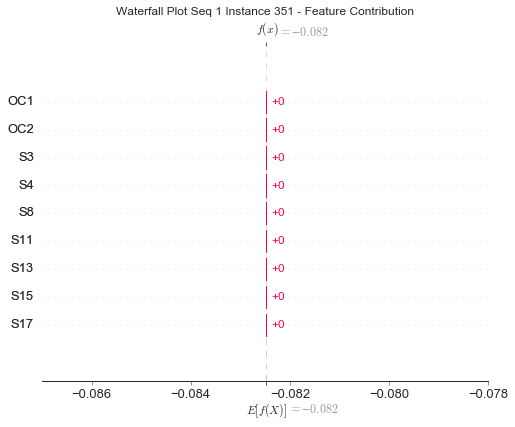

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


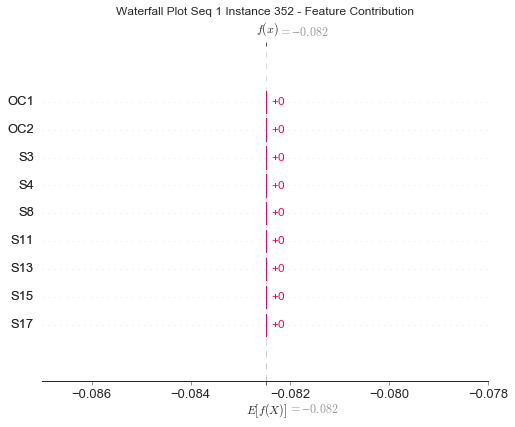

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


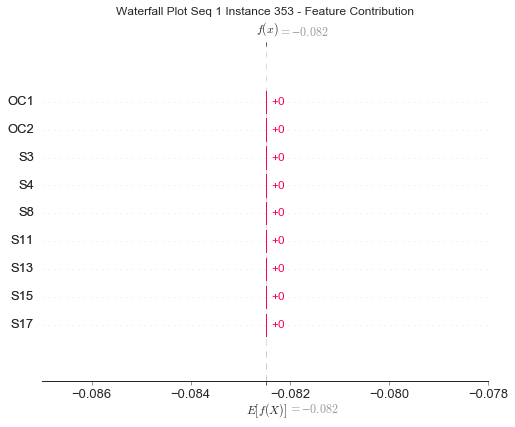

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


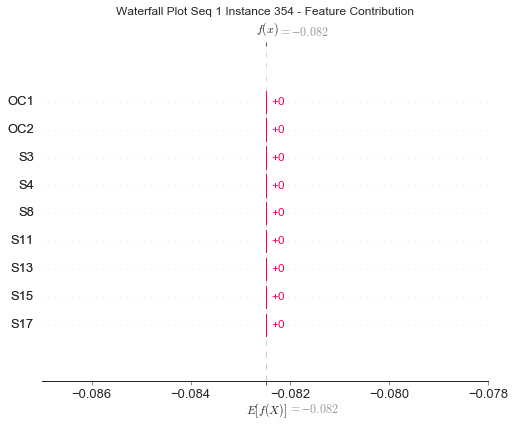

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


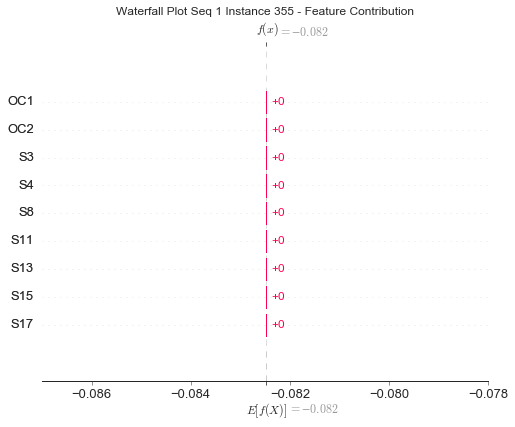

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


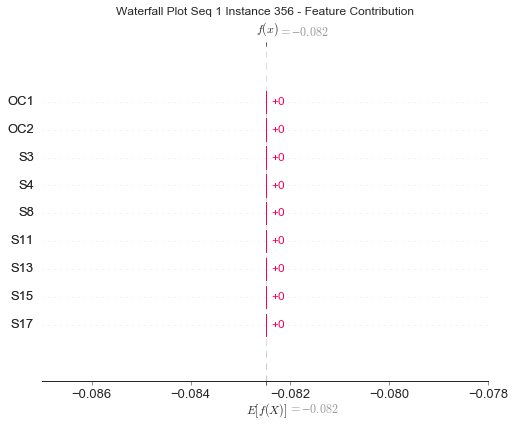

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


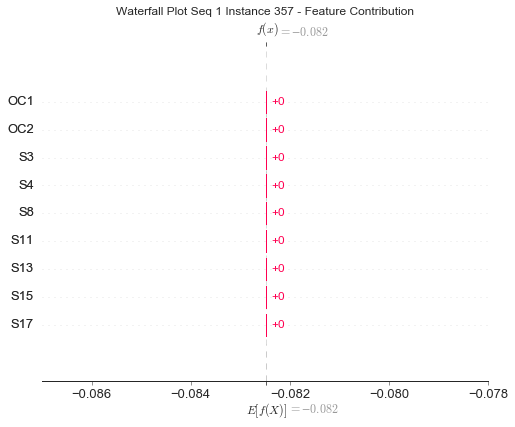

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


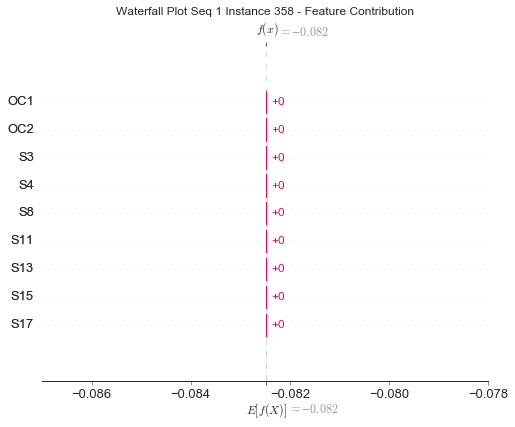

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


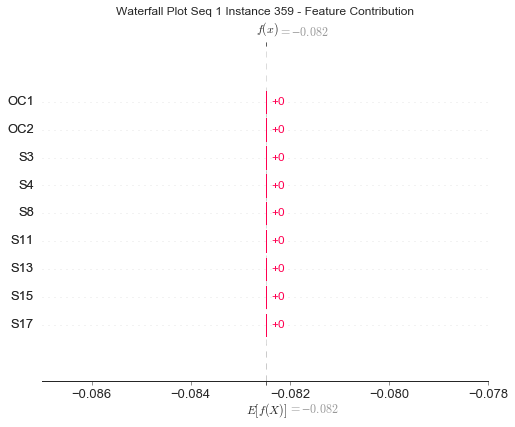

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


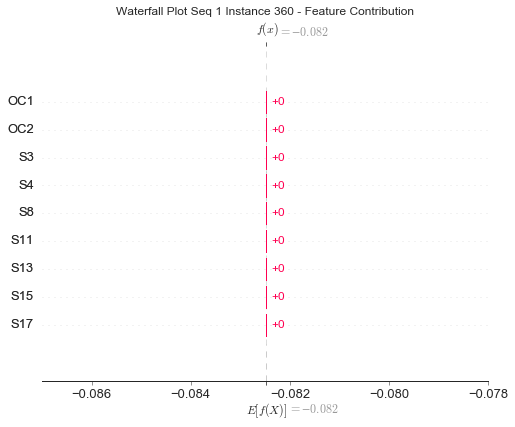

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


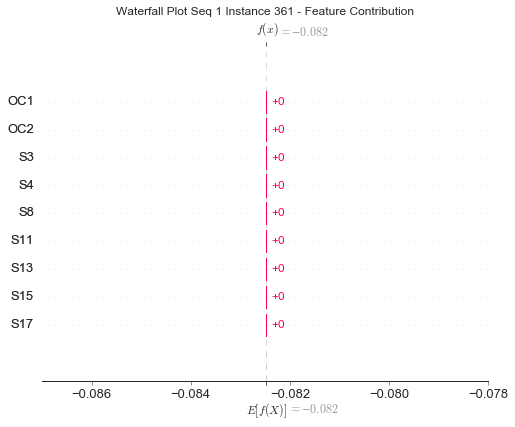

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


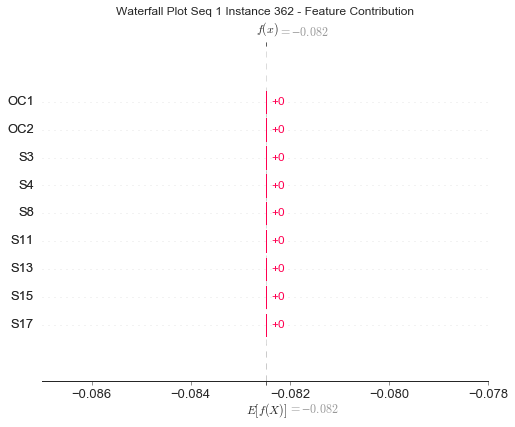

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


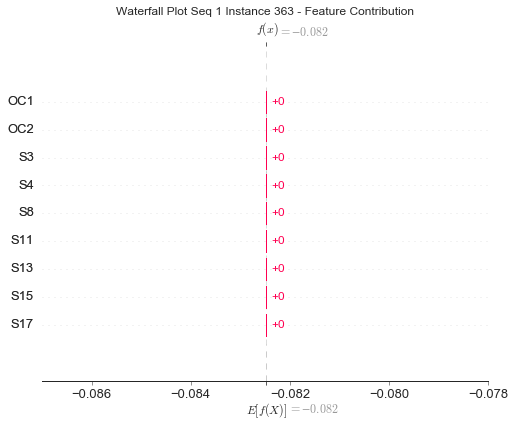

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


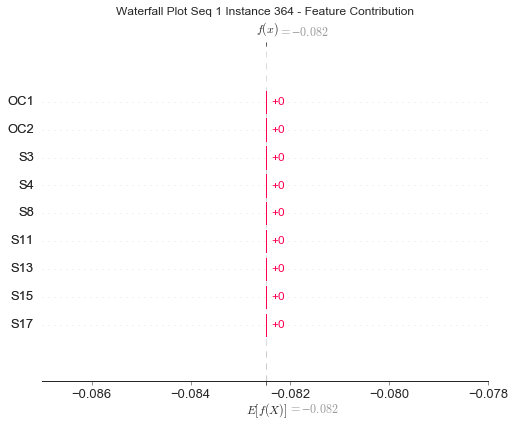

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


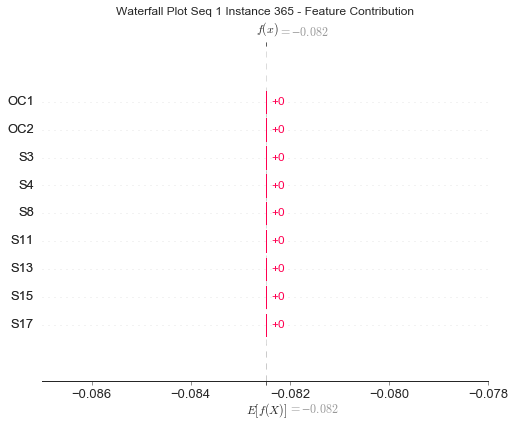

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


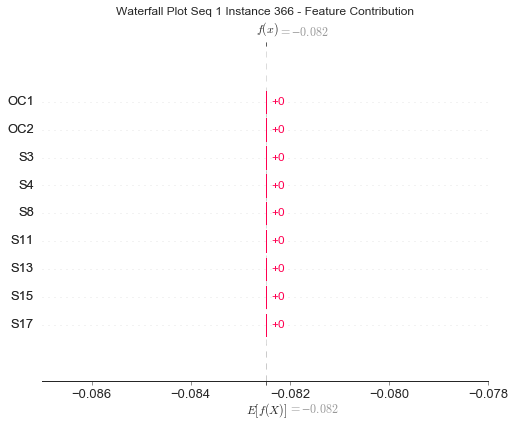

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


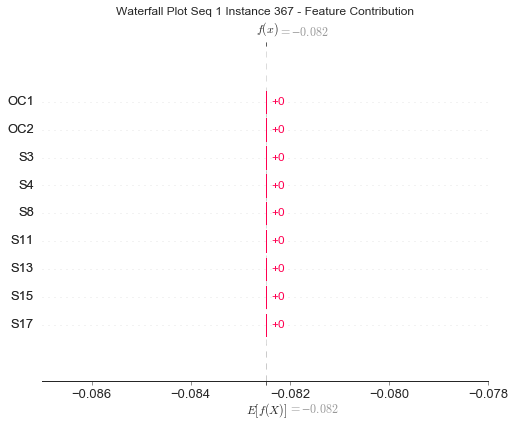

None

<Figure size 432x288 with 0 Axes>

In [56]:
#Waterfall Plot Fleet 1

for s in range(0,1):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(pad):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)
        plt.savefig("Waterfall_Plot %i" %i+'.tiff')
        plt.figure

Contribution: [-7.63462223e-29 -1.44474778e-28  1.54729287e-29 -6.59872168e-29
  7.65198930e-29 -2.45834846e-29  2.38343705e-30  2.40352551e-29
  1.05959586e-28]


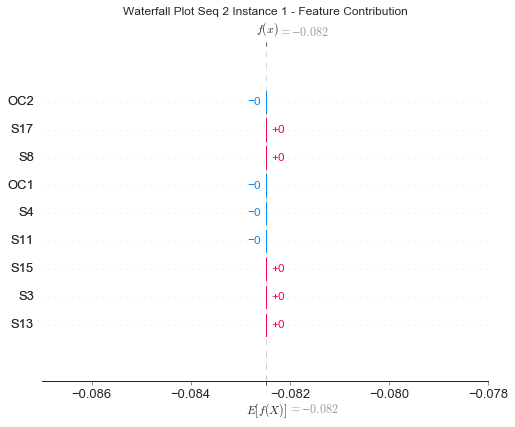

None

Contribution: [-4.76921162e-29  3.27125852e-29 -1.17027036e-30  4.95169107e-29
 -3.42755315e-29  3.14282878e-29  9.03028278e-33 -5.57846451e-29
 -3.46016215e-29]


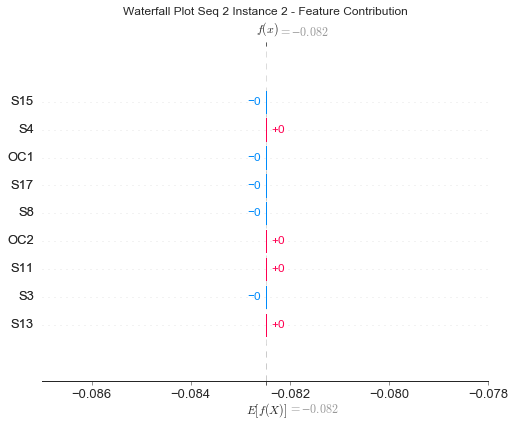

None

Contribution: [-1.36810134e-29 -4.00681120e-31  4.20278990e-30  3.89025285e-30
 -7.83475298e-30 -5.31849128e-30  3.89386140e-33 -5.31955392e-30
 -2.11347151e-30]


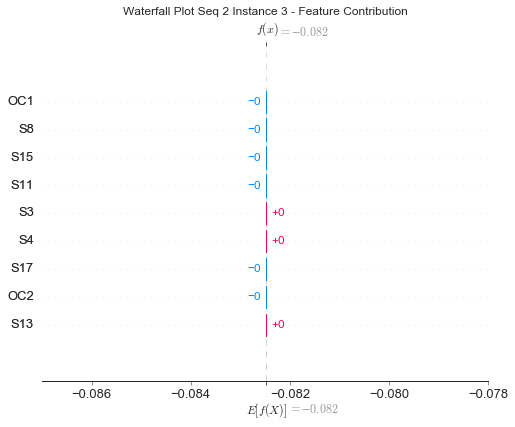

None

Contribution: [-5.34992704e-29  4.99256081e-29  8.98986482e-30  1.04676435e-28
 -4.69888689e-29  5.52065411e-29  1.24406282e-31 -7.63795348e-29
 -4.67097174e-29]


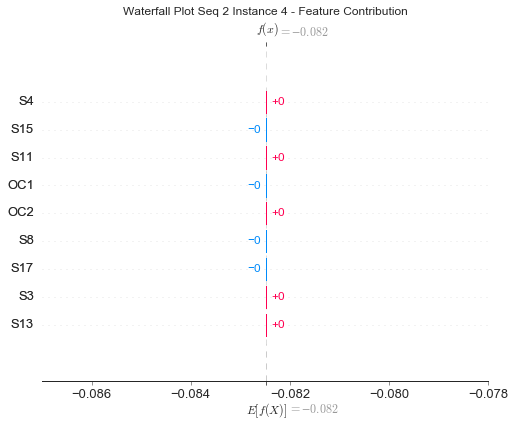

None

Contribution: [ 2.91478634e-29 -3.50453919e-29 -5.49536688e-30 -5.32687908e-29
  2.54533881e-29 -2.65880196e-29  2.63156322e-31  5.55215029e-29
  2.45884003e-29]


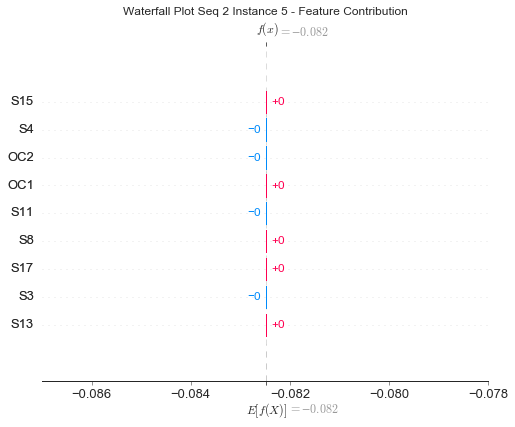

None

Contribution: [-1.26142405e-28  1.02428574e-28  1.80237733e-29  1.95454794e-28
 -8.17183029e-29  1.08729194e-28  3.39948805e-31 -1.76363099e-28
 -6.86437664e-29]


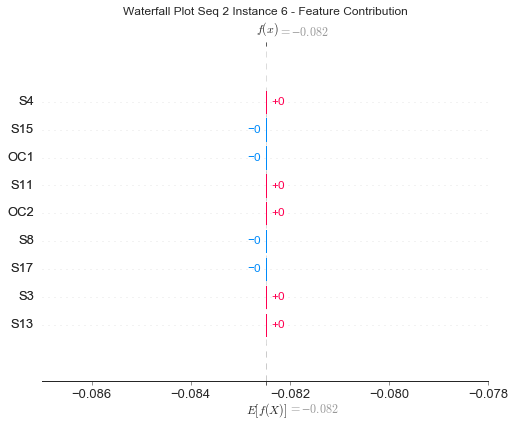

None

Contribution: [ 9.04067266e-29 -8.71679323e-29 -1.36421762e-30 -1.24904056e-28
  3.90477150e-29 -7.33703235e-29  9.83812012e-32  1.70403946e-28
  4.02655167e-29]


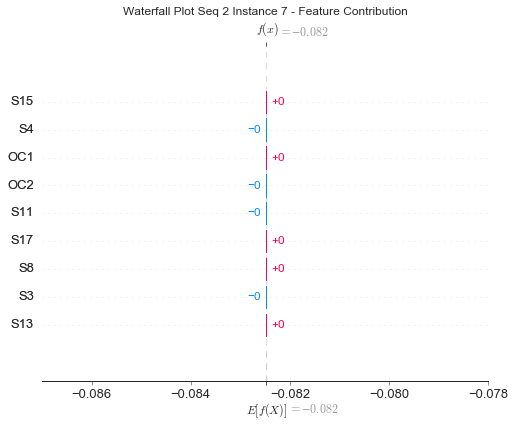

None

Contribution: [ 5.30968293e-29 -9.43107009e-29 -5.66732030e-29 -2.50684843e-28
  1.31027129e-28 -1.51180144e-28  9.37432784e-30  3.49084384e-28
  3.91445412e-29]


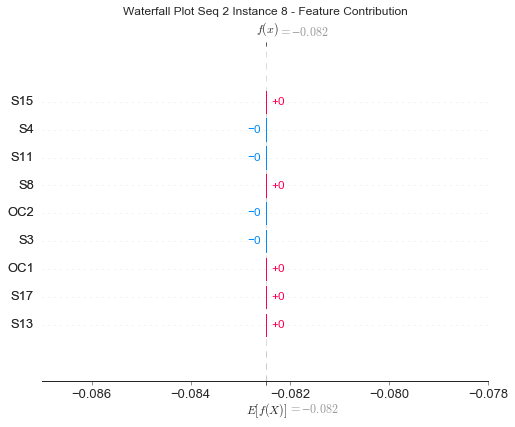

None

Contribution: [ 1.84451863e-29 -1.31291743e-29 -2.50465553e-30 -3.51302351e-29
  1.98079999e-29 -1.99896768e-29 -1.48277739e-32  2.62055630e-29
  2.50289477e-29]


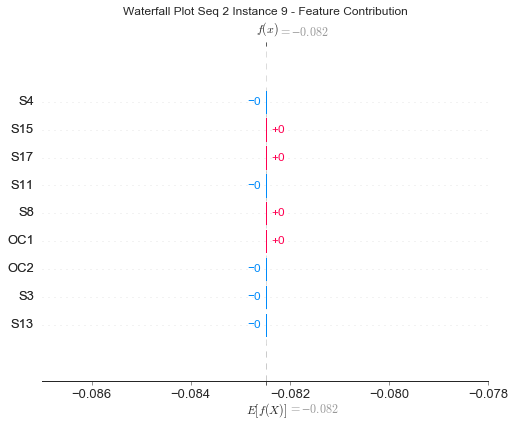

None

Contribution: [ 3.52830938e-29  9.38918985e-30 -5.11911156e-29 -1.68427581e-28
  1.67922313e-28 -1.85346358e-28  1.71714605e-29  1.76329178e-28
  1.73309907e-29]


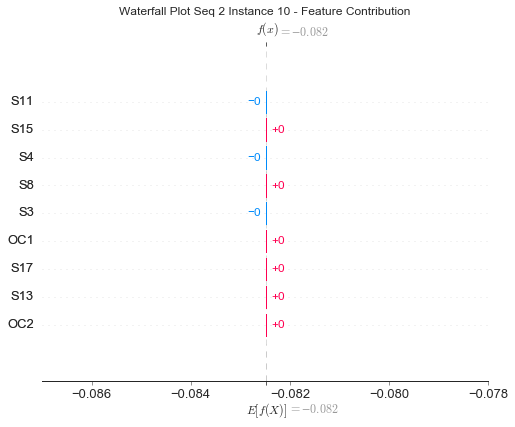

None

Contribution: [ 2.36712032e-29 -4.18407047e-29  7.16954686e-29  1.25339003e-28
 -1.65164659e-28  2.32583245e-28 -1.08919922e-29 -2.71210057e-28
  2.96509494e-29]


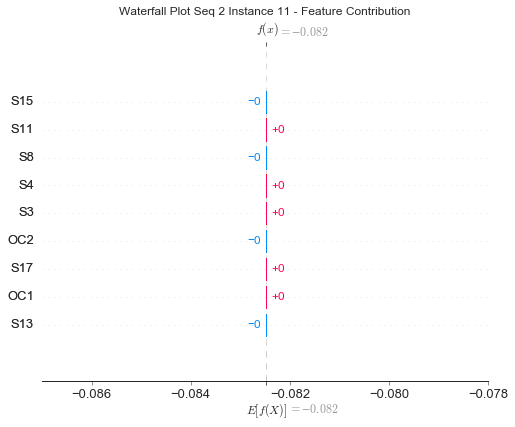

None

Contribution: [-3.66585658e-29  8.28614928e-29  8.13373555e-30  1.05613544e-28
 -1.92190385e-29 -2.34233496e-29 -1.01738995e-29 -9.70212367e-29
 -3.74988521e-29]


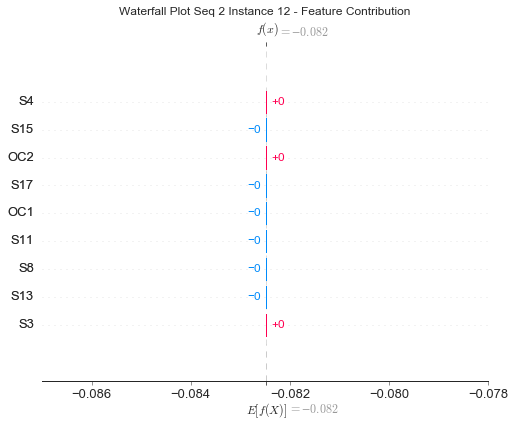

None

Contribution: [-1.55168655e-29  1.62296296e-29 -3.40732930e-31  4.12692241e-29
 -3.38468616e-29  2.88279062e-29  1.18996777e-32 -8.84234235e-30
 -2.57080171e-29]


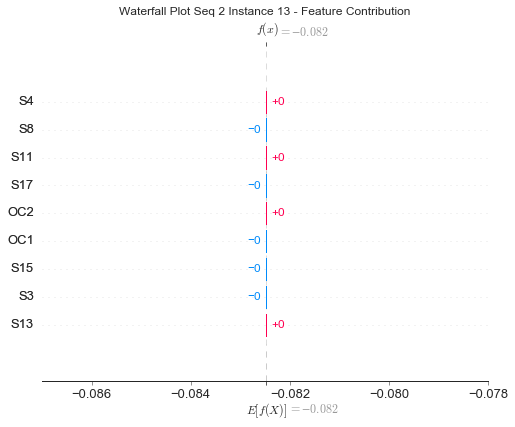

None

Contribution: [-1.46726642e-29  7.71340284e-30  4.59751978e-30  1.46474435e-29
 -9.58934738e-30  7.78382041e-30 -9.17061110e-33 -1.32724544e-29
 -7.92390698e-30]


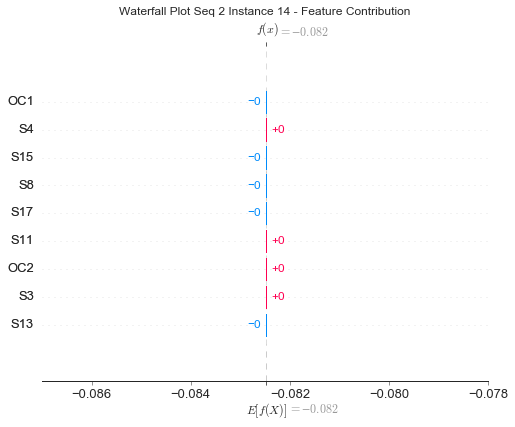

None

Contribution: [ 5.51097330e-30  8.49308624e-30 -6.00062775e-29 -1.47842195e-28
  1.44690771e-28 -1.52147900e-28  2.31901781e-29  1.97556104e-28
  3.06835943e-30]


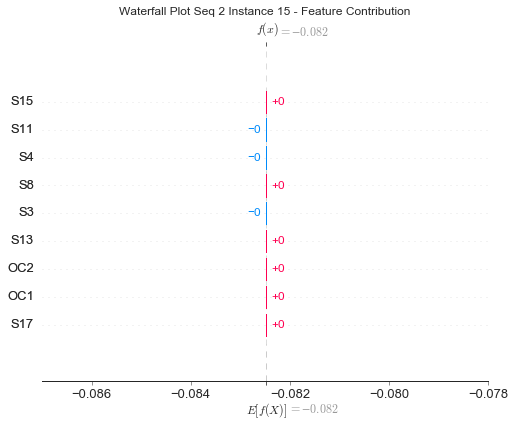

None

Contribution: [ 1.20219923e-30 -8.01784384e-31 -3.98604398e-31 -2.21710084e-30
  2.14865283e-30  2.62483770e-30 -9.99325859e-34  2.12720561e-30
  4.73828654e-31]


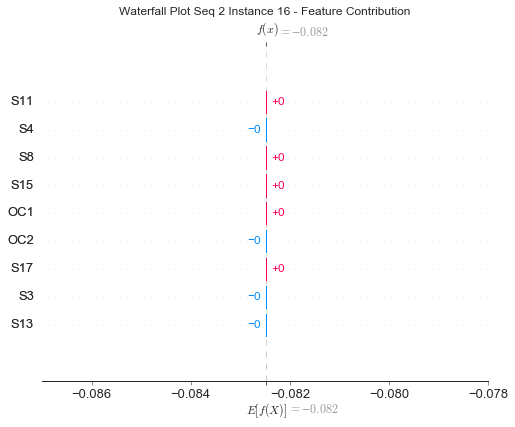

None

Contribution: [-3.59116240e-29  1.34647209e-29  2.76087643e-30  7.27049809e-29
 -4.33305619e-29  4.40181580e-29  5.01573411e-33 -1.51920123e-29
 -2.77880365e-29]


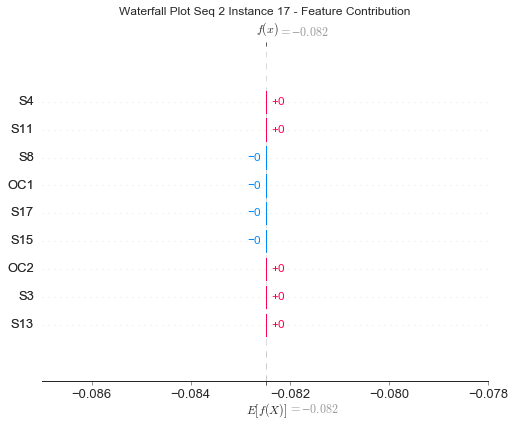

None

Contribution: [ 2.57831464e-29 -2.05807071e-29  4.83556773e-29  8.15858230e-29
 -9.74642066e-29  1.46871538e-28  6.52864447e-30 -1.95346484e-28
  2.25094326e-29]


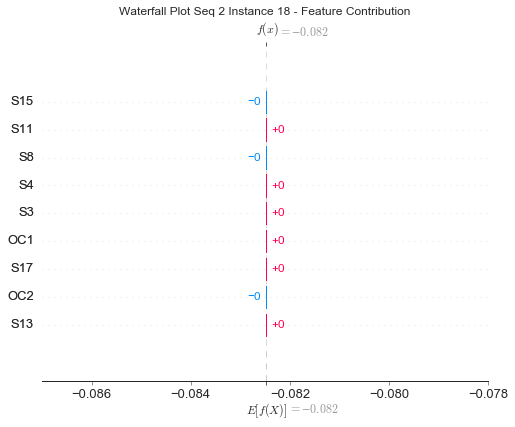

None

Contribution: [-4.67619161e-29  6.07921412e-29  1.51196616e-30  8.16010619e-29
 -3.96319760e-29  5.59332125e-29  9.92982690e-33 -7.90580700e-29
 -3.68524408e-29]


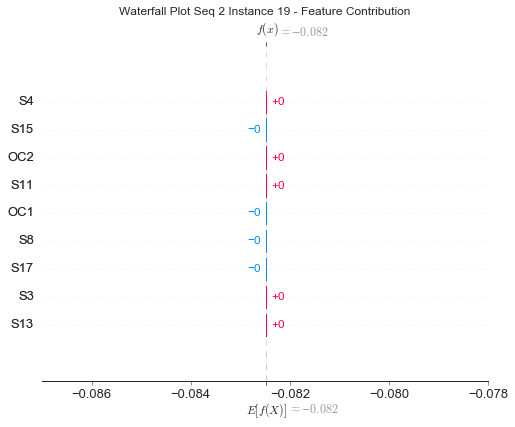

None

Contribution: [ 5.96520952e-30 -2.32787920e-29 -2.12736284e-30 -1.71801783e-29
  1.28685042e-29  2.71284122e-30 -1.56555952e-32  1.66262387e-29
  1.18714292e-29]


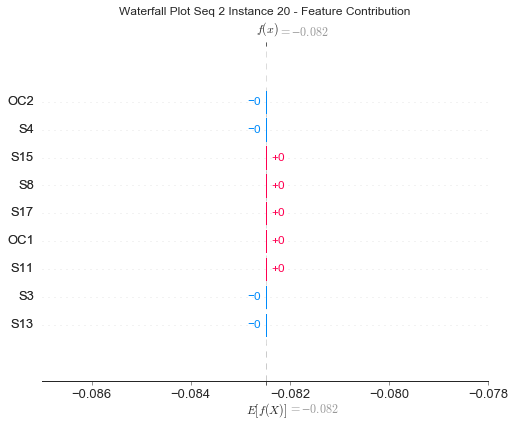

None

Contribution: [ 2.17308600e-30  3.51291608e-29  2.90937839e-29  9.57340775e-29
 -8.74063143e-29  4.87454765e-29 -3.65370035e-29 -1.25353785e-28
 -1.80892368e-29]


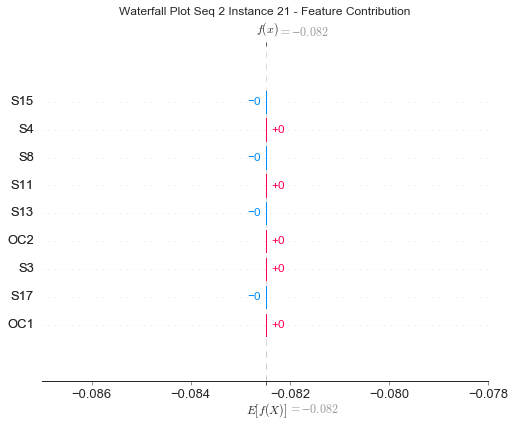

None

Contribution: [ 2.14622789e-29 -5.60874073e-29 -1.01509749e-30 -5.77921442e-29
  3.84846935e-29 -1.85631254e-29 -2.82453219e-32  4.52249638e-29
  3.80712204e-29]


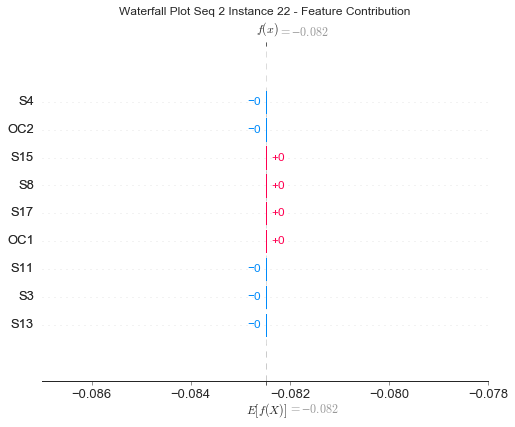

None

Contribution: [-9.65461910e-30  7.42263707e-30  2.19880553e-32  6.86562127e-30
 -7.61696641e-31  6.62160068e-30  1.18644562e-32 -1.97045459e-29
 -1.08018367e-30]


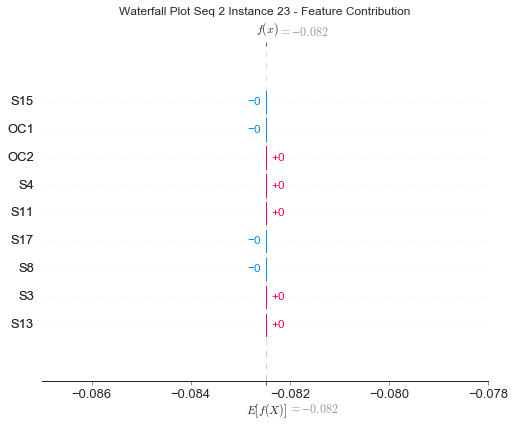

None

Contribution: [ 2.13580966e-30  1.92804711e-29 -3.70580180e-30  1.28557629e-29
 -5.09210047e-30  2.70884605e-29  2.09181992e-29 -3.88178884e-29
 -7.11928580e-30]


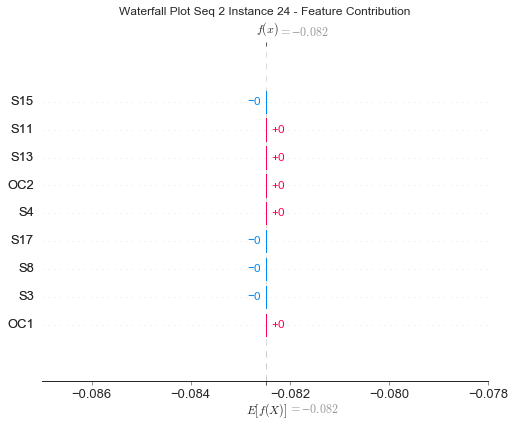

None

Contribution: [-3.99684179e-29  3.03588670e-29 -1.87634402e-30  4.60215555e-29
 -2.86337815e-29  3.40954239e-29 -1.85140125e-32 -4.91578933e-29
 -1.87749446e-29]


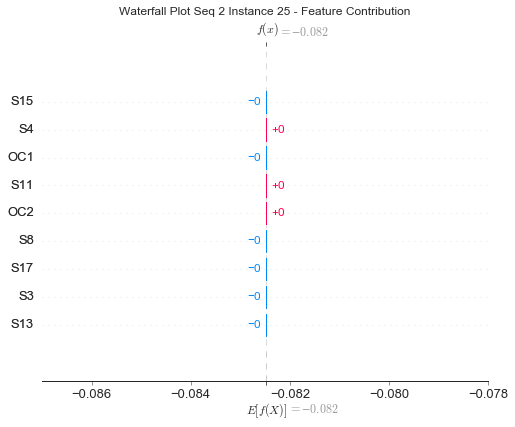

None

Contribution: [-9.04074097e-30  4.49116180e-29 -9.77739432e-31  3.29455836e-29
 -3.15852511e-30 -3.69455956e-29  8.19242074e-30  4.70166594e-29
 -3.71044969e-29]


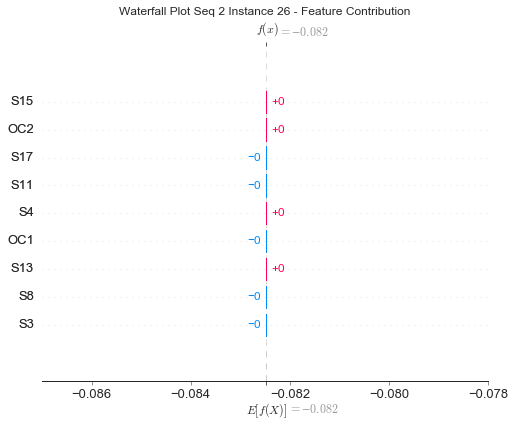

None

Contribution: [ 2.31028143e-30 -4.89612769e-29 -5.12706324e-29 -1.35233492e-28
  1.05373646e-28 -7.28427330e-29  3.71751454e-29  1.78806586e-28
  1.72273576e-29]


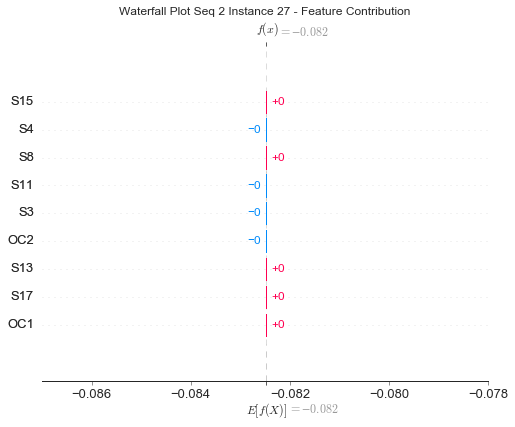

None

Contribution: [ 4.69164178e-29 -9.78095319e-29 -1.46142092e-29 -1.32469771e-28
  6.95362724e-29 -5.35536840e-29 -6.48114614e-33  1.06060396e-28
  6.39950590e-29]


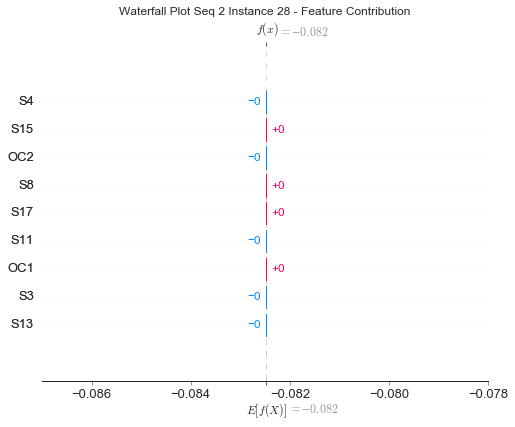

None

Contribution: [-5.45370578e-29  8.48856091e-29  1.14026699e-29  1.08075340e-28
 -5.66755261e-29  4.17218718e-29 -1.77661836e-32 -1.04957753e-28
 -5.52776019e-29]


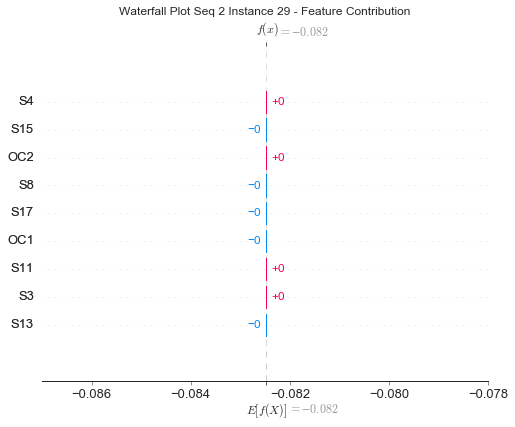

None

Contribution: [ 1.37271590e-29 -1.37115303e-29  4.87572863e-31 -4.46460624e-29
  3.46703652e-29 -2.36305872e-29  9.71521396e-33  5.44729499e-30
  2.69389571e-29]


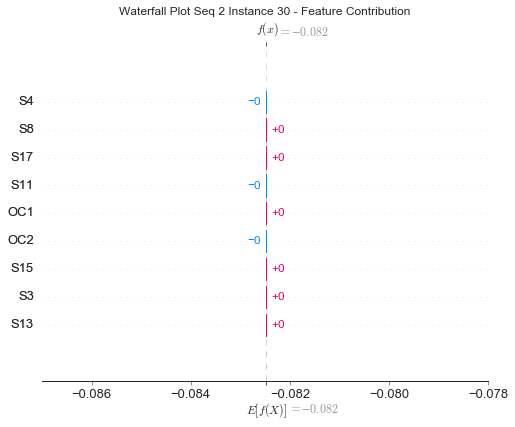

None

Contribution: [-8.74606857e-29  1.12268607e-28  1.73465185e-29  1.67929993e-28
 -7.83236468e-29  6.85164263e-29 -7.93940199e-33 -1.50849462e-28
 -7.02047627e-29]


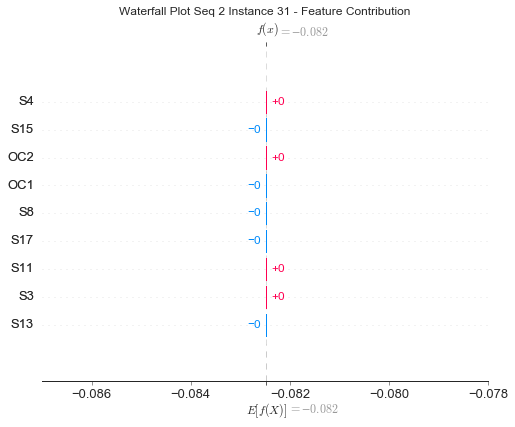

None

Contribution: [-6.77730775e-29  1.18626126e-28 -1.83361531e-29  9.38195106e-29
 -1.34315539e-30 -2.74826773e-29  8.69991156e-30 -2.72456464e-29
 -7.73793693e-29]


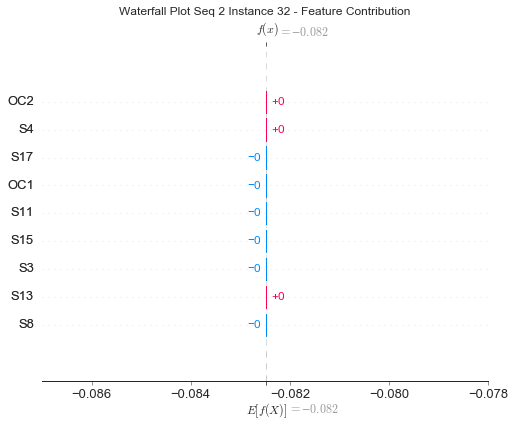

None

Contribution: [-3.84244209e-29  6.17763937e-29  4.82567702e-30  7.71146924e-29
 -3.42522277e-29  3.01226156e-29  7.30714325e-31 -6.40454401e-29
 -4.34049660e-29]


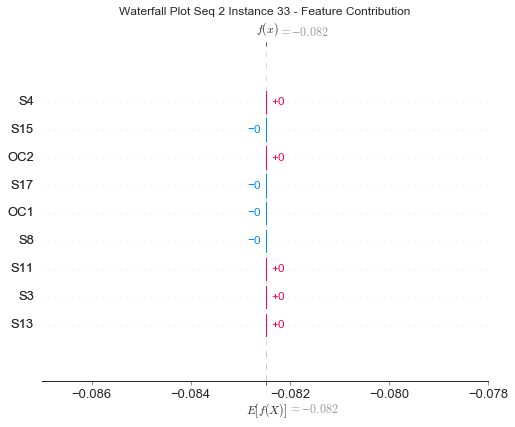

None

Contribution: [ 7.60789724e-30 -6.69916074e-29 -1.71586260e-29 -4.39949355e-29
 -9.28871874e-30 -2.51344522e-30 -5.71789311e-32  7.05634551e-29
  1.66894213e-29]


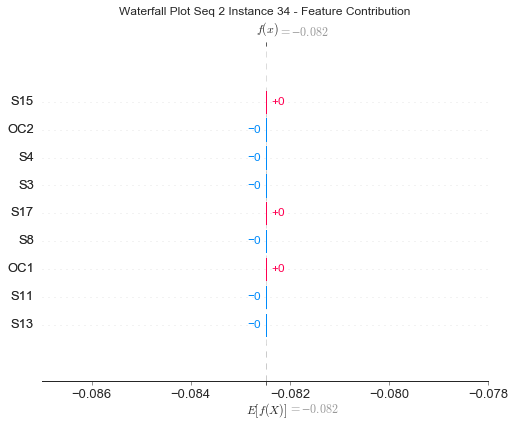

None

Contribution: [ 7.18130225e-30 -1.63062259e-29 -4.75904859e-31 -2.95605059e-29
  5.46364282e-30 -1.41911757e-29  7.79850283e-33  1.73624541e-29
  1.06299702e-29]


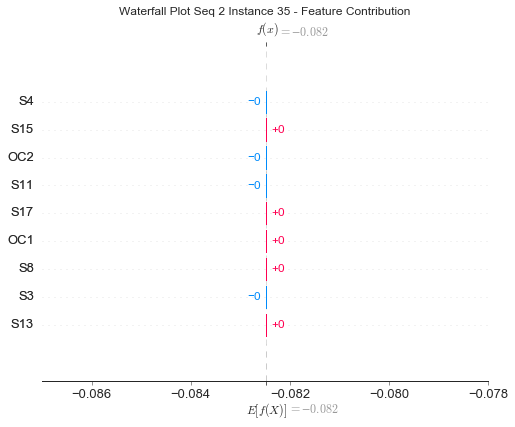

None

Contribution: [ 1.08307251e-29  1.06102385e-29 -1.61306816e-28 -4.09182787e-28
  3.87140639e-28 -4.02546707e-28  8.89985588e-29  7.13401911e-28
 -2.53173903e-29]


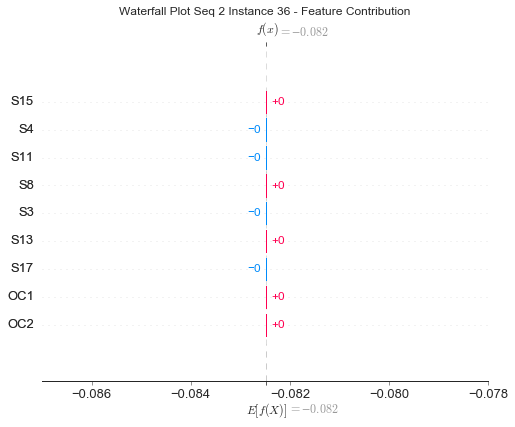

None

Contribution: [-3.97112084e-30 -5.97659696e-29  2.05825000e-28  5.80134107e-28
 -6.20151416e-28  6.42072929e-28 -1.07157815e-28 -7.43555329e-28
 -2.82551997e-30]


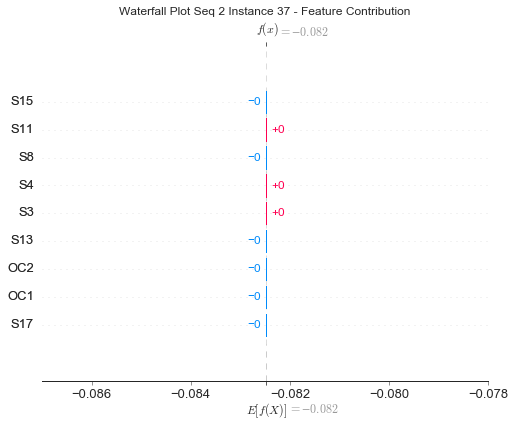

None

Contribution: [ 1.61261108e-29  1.95297591e-30  4.21970288e-29  8.18375300e-29
 -5.92027314e-29  4.34386909e-29 -2.48882510e-29 -2.33353809e-28
  1.22012110e-30]


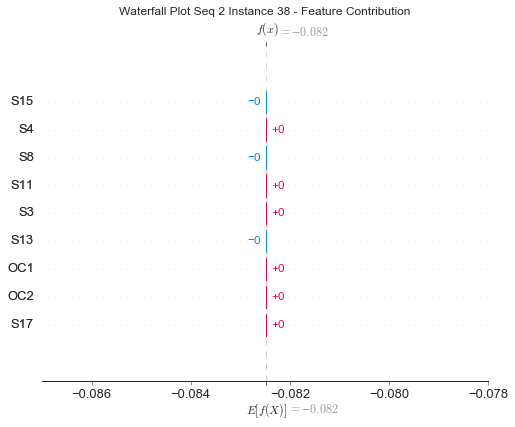

None

Contribution: [ 2.31742913e-28 -3.30375443e-28 -5.36267549e-29 -4.76615324e-28
  2.61875050e-28 -2.64813008e-28 -4.85518487e-32  3.85151394e-28
  2.23281846e-28]


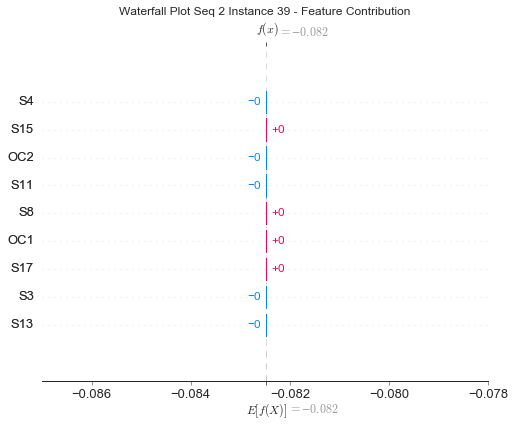

None

Contribution: [-4.88911189e-29  8.43111463e-29 -5.20801550e-29  6.23563394e-29
 -9.74981571e-30 -4.98853201e-29  7.42052306e-30  1.40399330e-28
 -1.26863678e-28]


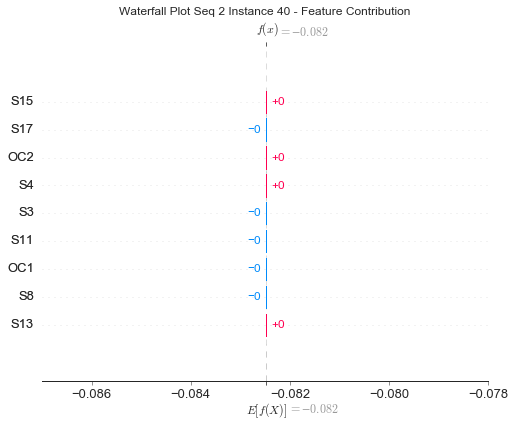

None

Contribution: [-1.72392096e-28  2.60523432e-28  3.58517926e-28  1.06377190e-27
 -8.52414282e-28  9.41697506e-28 -7.46385784e-29 -1.37925974e-27
 -1.39035820e-28]


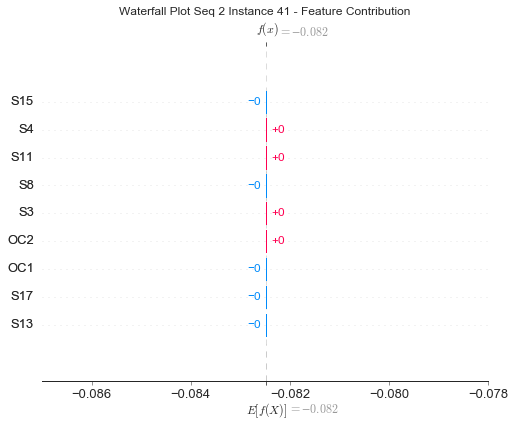

None

Contribution: [-1.26396291e-28  2.11003561e-28 -1.72153798e-28 -1.64901649e-28
  3.48518257e-28 -4.76071971e-28  5.98989370e-29  5.69361369e-28
 -1.48324833e-28]


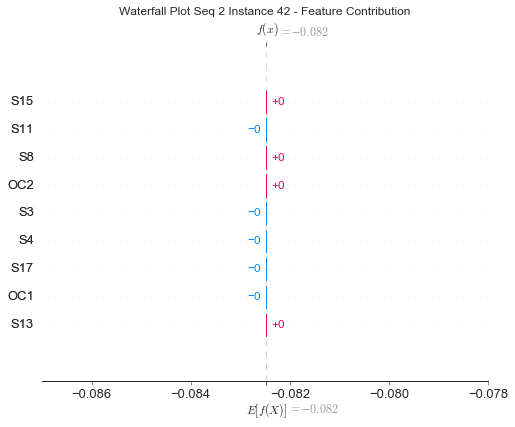

None

Contribution: [ 1.80968105e-28 -2.21758170e-28 -2.25219271e-29 -3.67373665e-28
  2.34730295e-28 -2.28006513e-28  2.24172547e-30  3.23335688e-28
  1.72043418e-28]


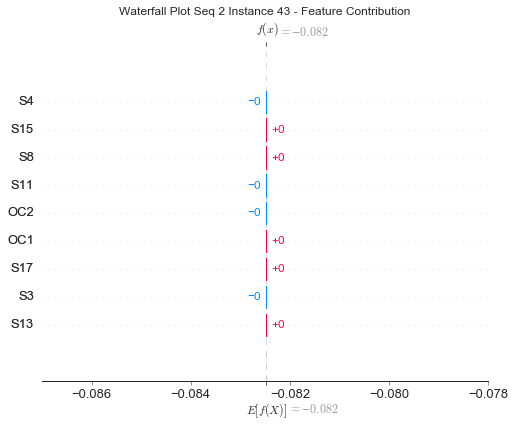

None

Contribution: [-3.50215916e-28  4.89478514e-28 -4.63240093e-30  7.18793841e-28
 -2.27941127e-28  4.92049131e-29 -1.55008171e-28 -5.29228841e-28
 -2.85153163e-28]


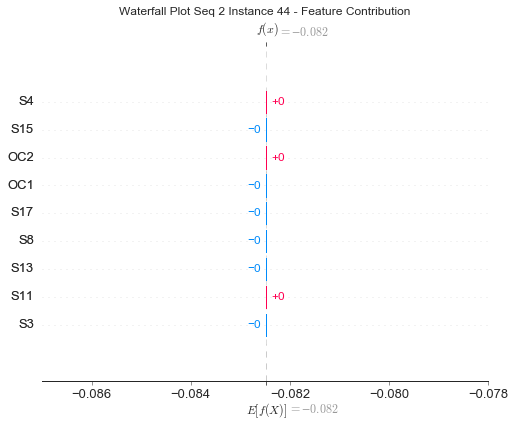

None

Contribution: [ 1.09253925e-28 -7.83709705e-29 -2.28053530e-28 -7.08058322e-28
  5.62067776e-28 -4.22601511e-28  1.54655379e-29  4.34916533e-28
  1.09181871e-28]


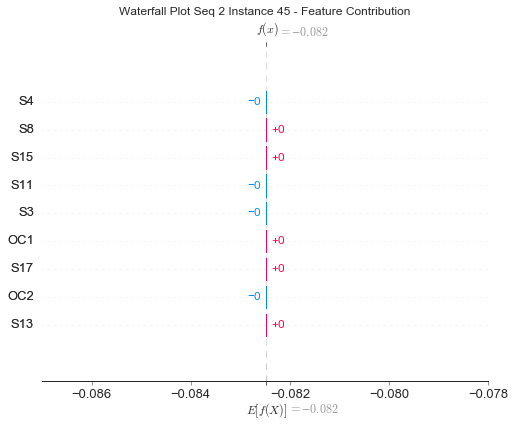

None

Contribution: [-6.38741768e-29  6.36165235e-29 -1.62982002e-28 -1.54055293e-28
  2.81370276e-28 -5.29205200e-28 -1.11995631e-28  4.48696514e-28
 -8.05936922e-29]


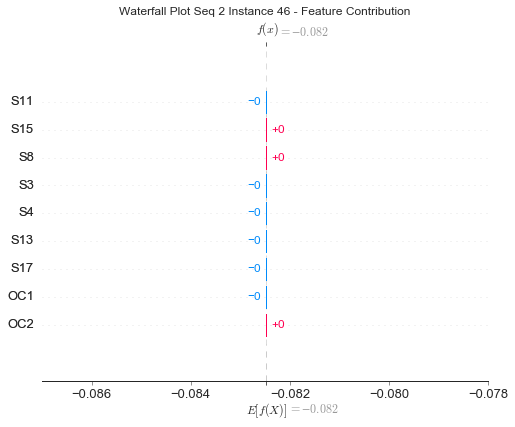

None

Contribution: [-2.87093081e-28  4.37711636e-28  7.66404983e-29  6.90612093e-28
 -4.57627773e-28  4.59437088e-28  1.84370470e-31 -3.70152035e-28
 -3.78548897e-28]


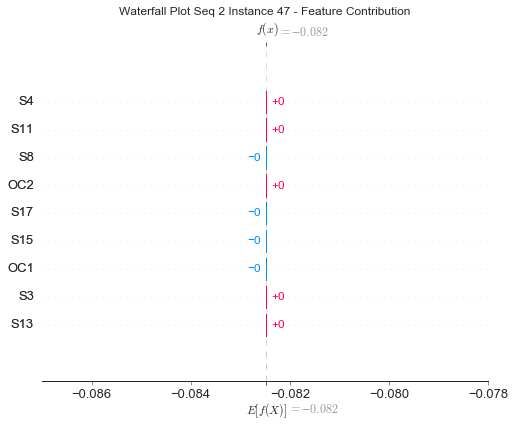

None

Contribution: [-6.46810030e-30  5.14030364e-30  3.85511968e-30 -1.64894417e-30
 -6.50654141e-30  2.38501245e-31  9.48647686e-32 -1.82284680e-29
 -3.08189830e-30]


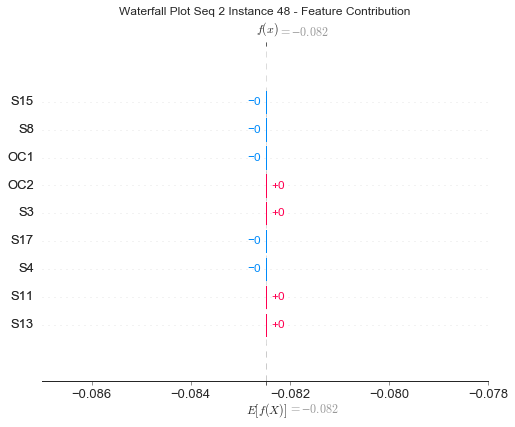

None

Contribution: [-1.93811958e-29  1.23333893e-28 -9.45227759e-30  1.29176455e-29
  1.42540856e-28 -1.68493156e-29  9.96333143e-32 -1.98847115e-28
  6.19515631e-29]


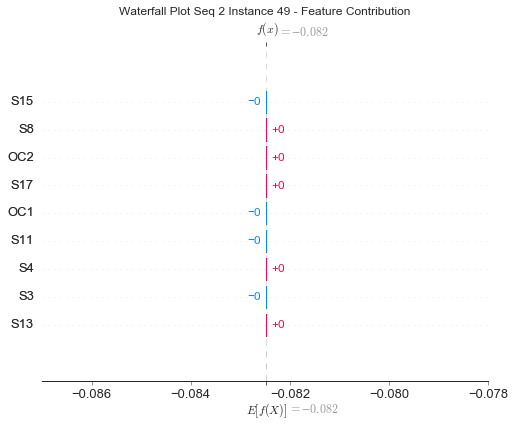

None

Contribution: [-1.84203764e-28  6.27701832e-28  1.41715688e-29  5.02647686e-28
 -1.55978237e-28  3.69697371e-28  2.70566415e-32 -6.02592424e-28
 -1.92772672e-28]


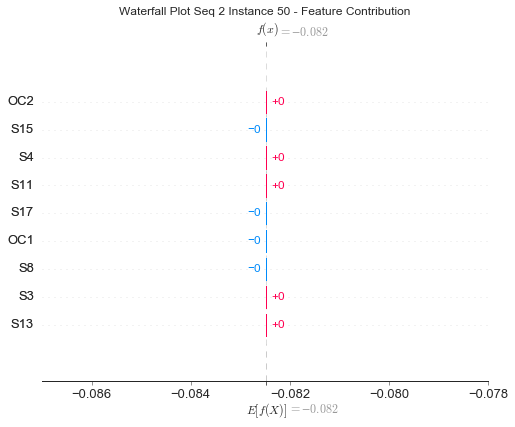

None

Contribution: [ 3.55663433e-28 -1.30611104e-28 -3.67856862e-29 -5.47194831e-28
  4.51466531e-28 -4.06697808e-28  4.67470241e-32  1.91917306e-28
  2.47486861e-28]


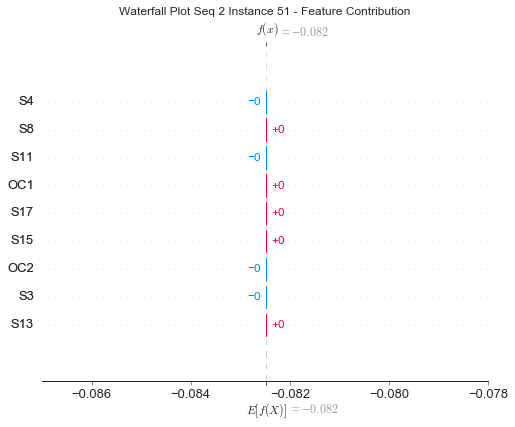

None

Contribution: [ 6.50514135e-29  2.42011923e-28 -2.61732074e-29  2.03198441e-28
 -1.02657892e-28  2.30269577e-28  1.04718832e-31 -1.13569019e-28
 -1.26404524e-28]


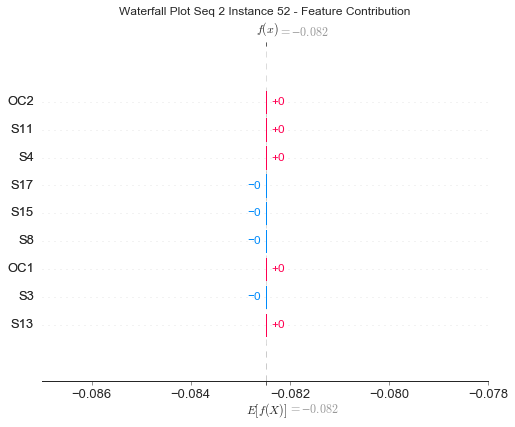

None

Contribution: [ 2.96170289e-29  1.53835460e-28 -1.84087594e-28 -2.65041664e-28
  4.08374089e-28 -5.78918219e-28  2.54064014e-29  6.71135356e-28
 -1.14463217e-28]


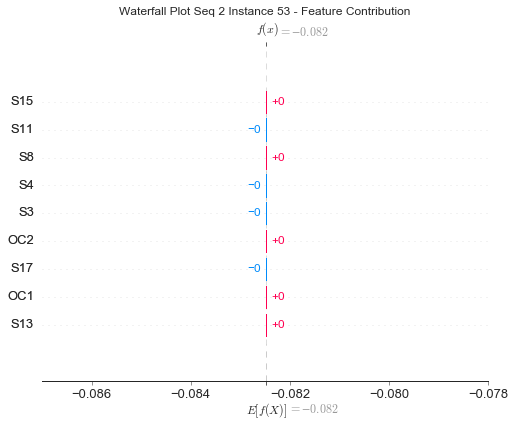

None

Contribution: [-1.65136666e-29  8.14843024e-29 -2.01233017e-29  4.87585427e-29
 -4.81555792e-29  1.09384720e-28 -1.86790064e-32 -6.67510948e-29
 -2.98759853e-29]


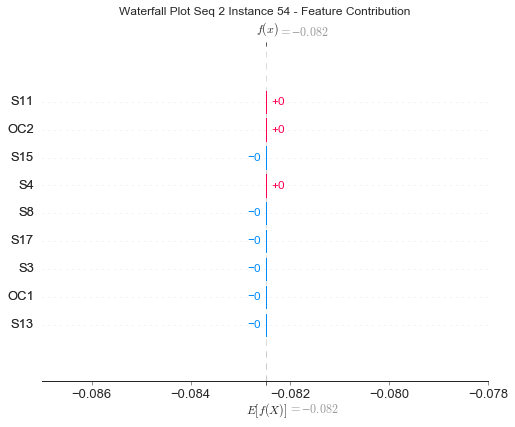

None

Contribution: [-6.80784795e-28 -9.34895603e-28  2.67191074e-28  1.86078512e-28
  1.49201371e-28  7.01741609e-28  7.68033391e-32 -1.57086839e-28
  6.67324807e-28]


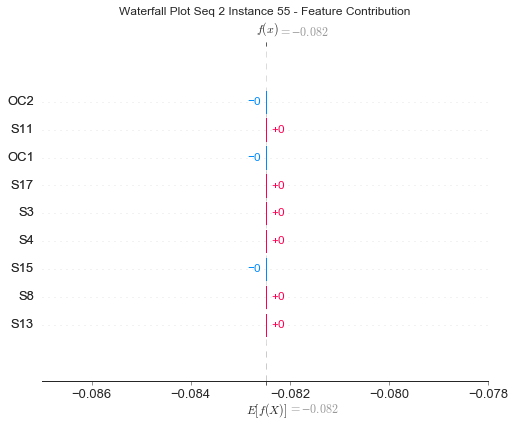

None

Contribution: [-8.51515451e-28 -1.75515177e-27  1.16104484e-27  3.80748492e-27
 -2.39780185e-27  1.59191582e-27 -6.85034564e-29  6.63220939e-28
 -8.13020830e-28]


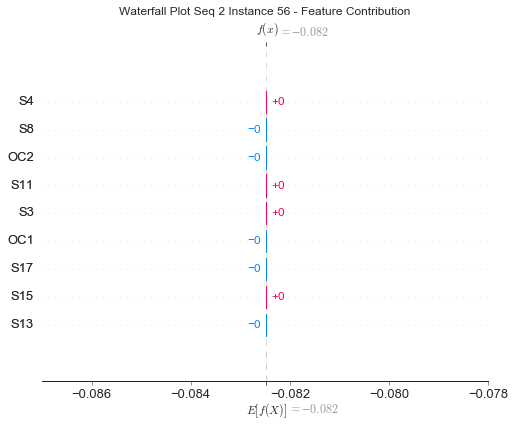

None

Contribution: [-7.29182345e-27 -7.66180153e-27  2.58048824e-27  4.04927926e-27
 -2.92187358e-27  6.21914287e-27  6.72645670e-28 -7.34813112e-29
  1.80791955e-27]


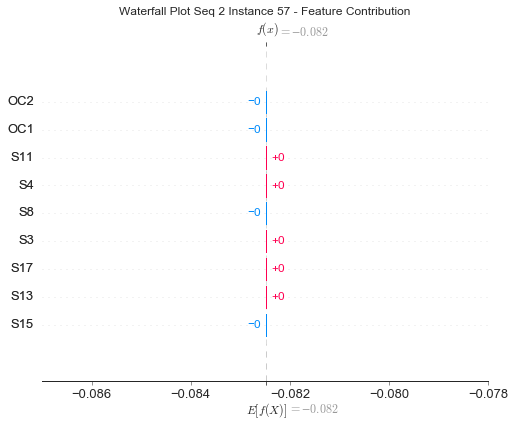

None

Contribution: [-7.60568455e-27 -1.02422626e-26  3.35338531e-27  4.58904540e-27
 -3.90339893e-27  7.68015564e-27  7.81193008e-28  4.26497812e-28
  2.37331557e-27]


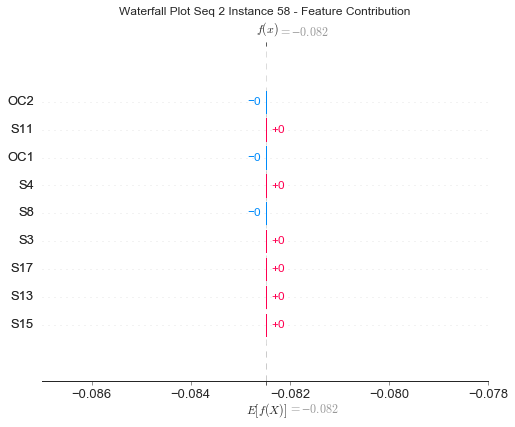

None

Contribution: [-8.89853205e-27 -1.16429676e-26  4.08630681e-27  5.54918811e-27
 -4.93163829e-27  9.91875492e-27  1.22030927e-27  7.94756562e-28
  2.99158569e-27]


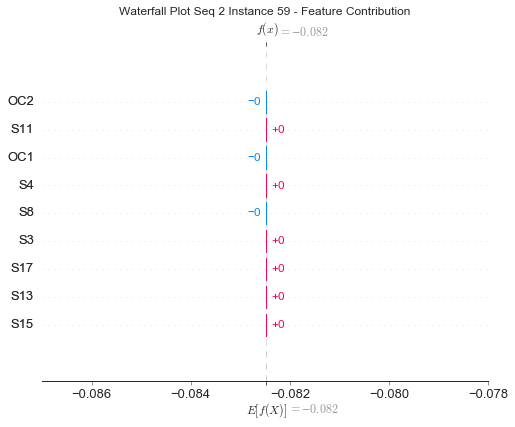

None

Contribution: [-9.44098177e-27 -1.39445540e-26  4.89509647e-27  6.55526156e-27
 -6.28012976e-27  1.13621770e-26  1.25127842e-27  1.85881533e-27
  3.33459671e-27]


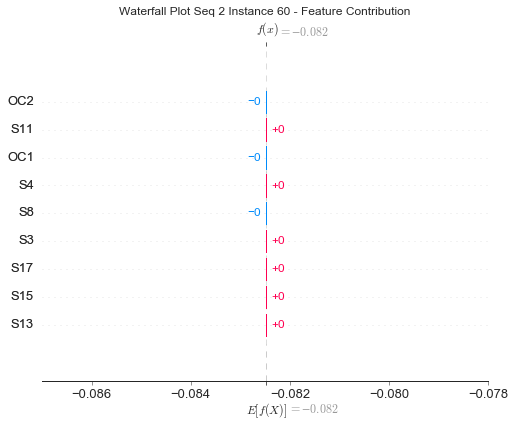

None

Contribution: [-1.51820688e-26 -1.75580269e-26  4.92495801e-27  8.02946772e-27
 -6.60882937e-27  1.49206862e-26  1.13605321e-27  2.79485792e-27
  4.04789298e-27]


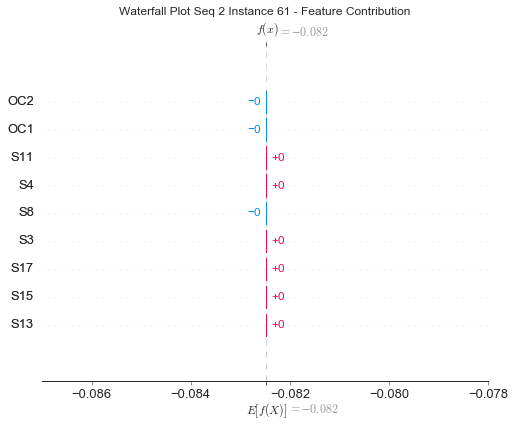

None

Contribution: [-1.48674350e-26 -2.21624863e-26  8.30347901e-27  9.98414948e-27
 -9.07342035e-27  1.73195999e-26  1.61010873e-27  1.24616190e-27
  5.63249883e-27]


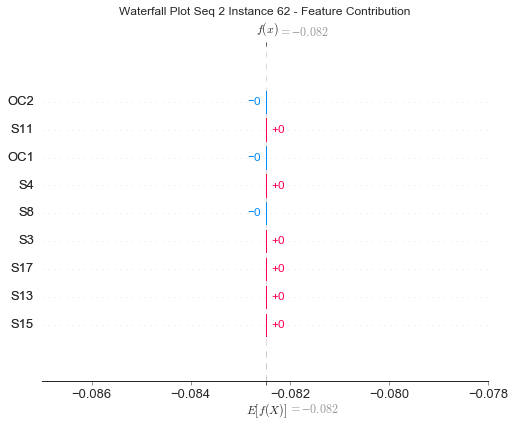

None

Contribution: [-3.50219614e-27 -1.48120961e-26  3.04640228e-27  1.73152149e-26
 -2.41753758e-26  1.77192396e-26 -3.50636886e-27 -6.60220629e-28
 -5.82292092e-27]


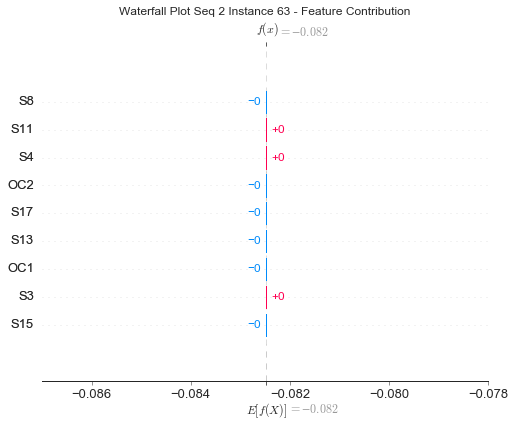

None

Contribution: [-6.52121651e-27 -2.26911402e-26  3.29454969e-27  1.62051120e-26
 -2.17715703e-26  1.55296344e-26 -3.14468595e-27  7.97680355e-27
 -3.10695102e-27]


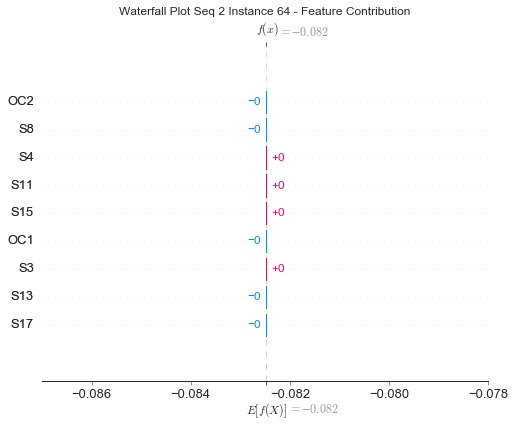

None

Contribution: [-2.61455313e-26 -3.35000322e-26  1.09288251e-26  1.85517467e-26
 -1.60664697e-26  2.80630364e-26  1.39225235e-27  8.46349452e-27
  6.25134057e-27]


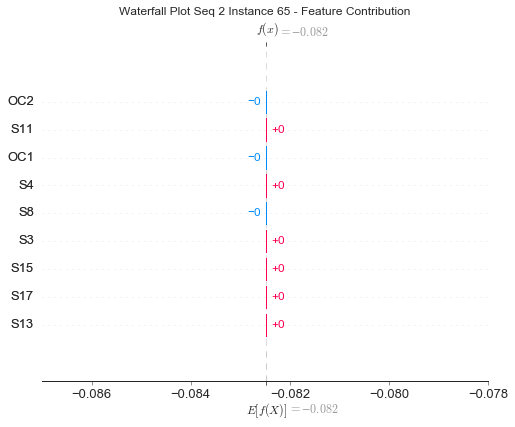

None

Contribution: [-4.33973893e-26 -5.43137759e-26  1.30827913e-26  1.58720339e-26
 -1.76153642e-26  3.27446024e-26 -3.11789738e-28  8.51800296e-27
  1.15661561e-26]


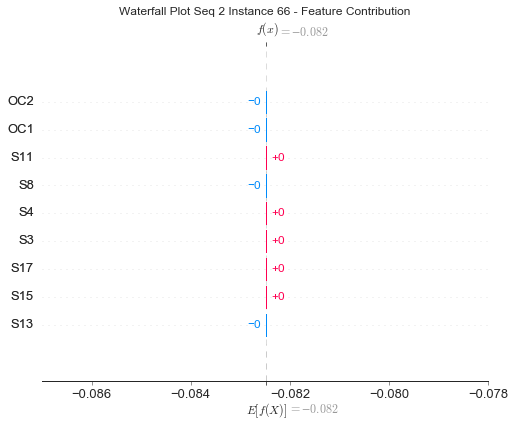

None

Contribution: [ 9.22221693e-27  1.72677276e-26 -1.10974117e-26  4.71230622e-26
 -5.82083452e-26  2.85802056e-26 -1.42809678e-26 -3.79143538e-27
 -4.03176979e-26]


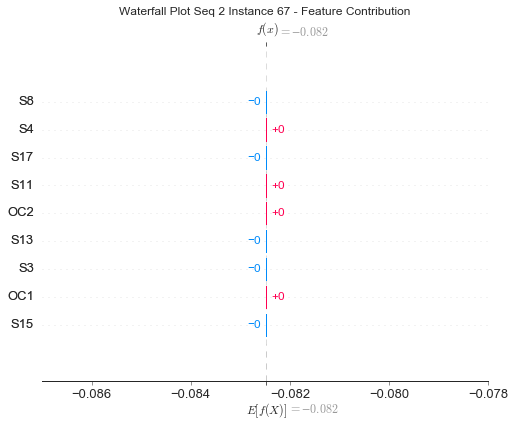

None

Contribution: [-4.18699573e-26 -6.28821427e-26  2.04429760e-26  2.87656280e-26
 -2.79563030e-26  4.47126731e-26  1.78835865e-27  1.39347441e-26
  1.29290959e-26]


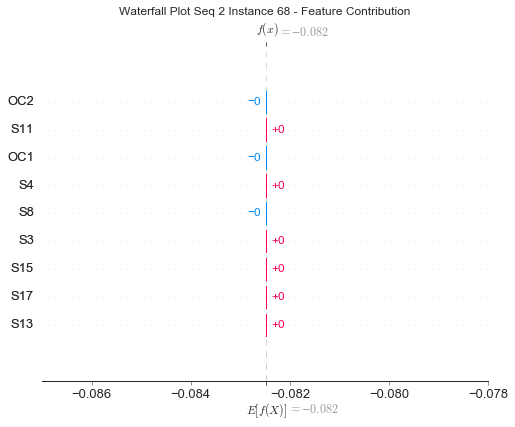

None

Contribution: [-5.57532067e-26 -8.21942527e-26  2.56481838e-26  3.32606098e-26
 -3.77188480e-26  5.91787551e-26 -3.66351550e-28  7.20066611e-27
  1.86320302e-26]


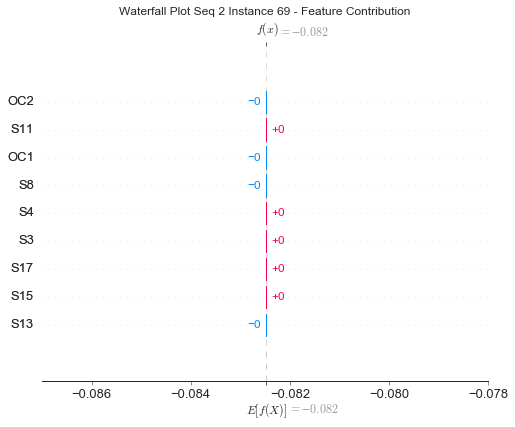

None

Contribution: [-5.11800398e-27 -1.83158850e-26 -1.26009812e-27  6.19326253e-26
 -6.64584559e-26  4.42879362e-26 -1.08202511e-26  8.71043803e-27
 -2.68113083e-26]


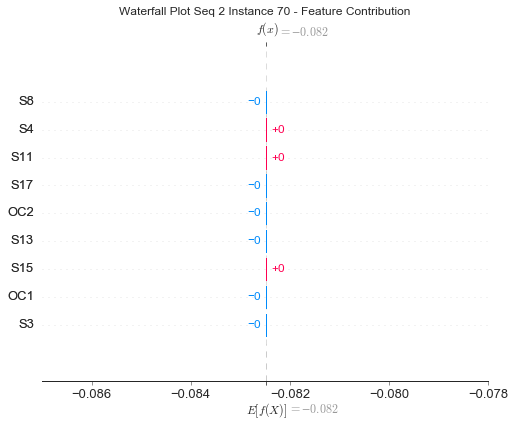

None

Contribution: [-9.82653276e-26 -1.22741728e-25  3.50082295e-26  5.64582203e-26
 -5.09206448e-26  9.27553684e-26  3.11812314e-27  2.98922200e-26
  2.43173045e-26]


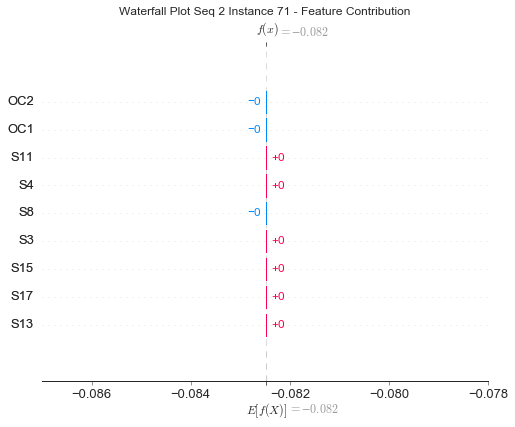

None

Contribution: [-7.97192755e-26 -1.54862394e-25  4.04328500e-26  4.70253298e-26
 -5.60691825e-26  8.23529000e-26  1.02006465e-27  4.50914003e-26
  3.46727109e-26]


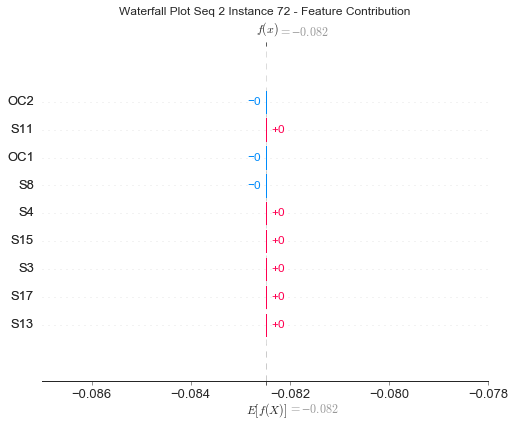

None

Contribution: [-1.74687901e-26 -3.01283359e-26  1.41218640e-27  1.24404548e-25
 -1.29772315e-25  9.71022139e-26 -1.91929057e-26  1.34612827e-26
 -5.40391229e-26]


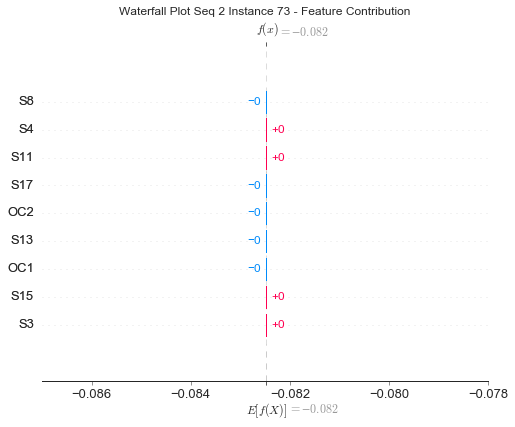

None

Contribution: [-1.38218982e-25 -2.00818718e-25  4.31098710e-26  9.02020290e-26
 -1.12719225e-25  1.43287179e-25 -7.84327189e-27  5.64072648e-26
  2.11409669e-26]


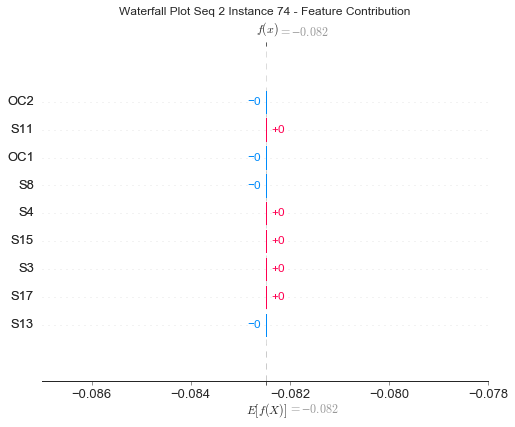

None

Contribution: [-1.40824876e-26 -1.49518138e-26 -3.43954818e-26  2.04384468e-25
 -2.67390937e-25  1.46019460e-25 -5.68033100e-26  1.12012301e-26
 -1.57866475e-25]


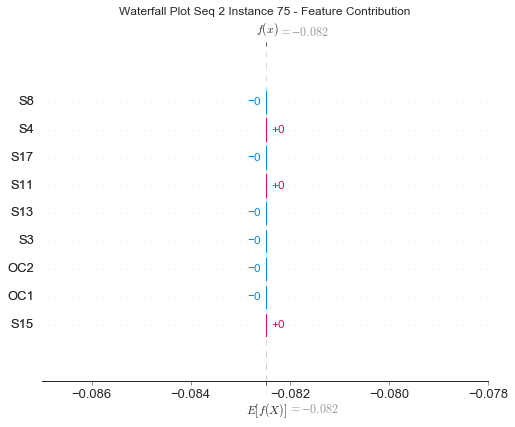

None

Contribution: [-4.74852542e-26 -1.74525701e-25 -1.20442459e-26  1.87118546e-25
 -2.98751633e-25  1.70239906e-25 -6.04637602e-26  7.65308415e-26
 -1.16395971e-25]


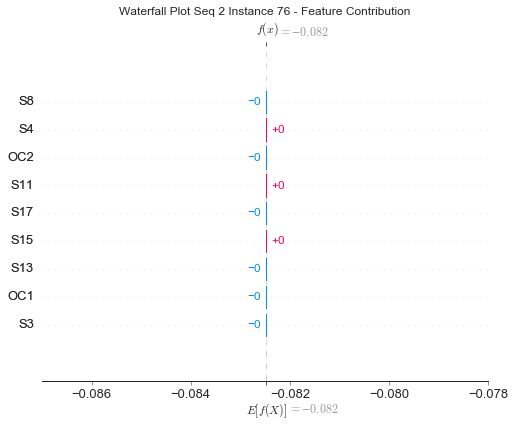

None

Contribution: [-3.75382297e-25 -4.86000243e-25  1.13506225e-25  2.05688196e-25
 -2.52384460e-25  3.23986061e-25 -2.16173125e-26  7.81576021e-26
  5.77797965e-26]


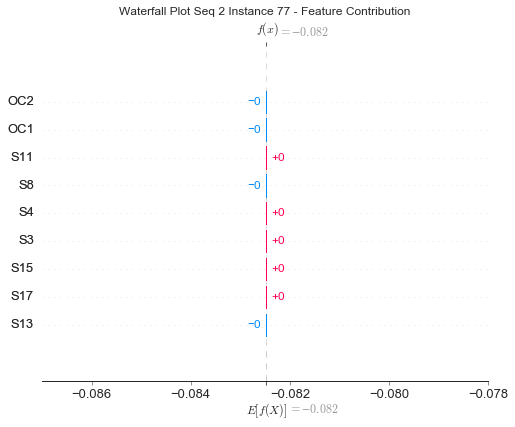

None

Contribution: [-6.48481751e-26 -1.48425128e-25 -3.75104038e-26  3.25049791e-25
 -4.70869743e-25  2.69898306e-25 -1.14305551e-25  6.56697491e-26
 -2.20114429e-25]


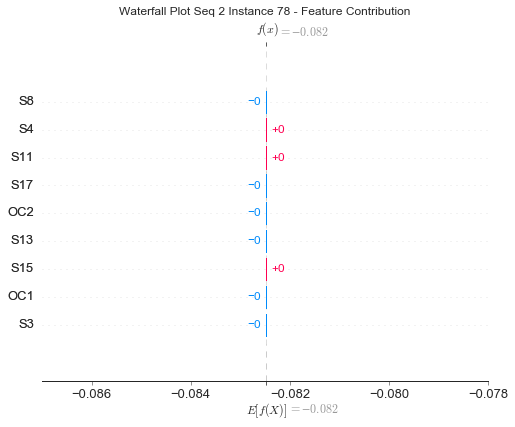

None

Contribution: [-3.02385792e-25 -4.20033624e-25  4.05265773e-27  3.21828354e-25
 -5.66158323e-25  4.38653403e-25 -1.30482056e-25  1.01165840e-25
 -1.54161355e-25]


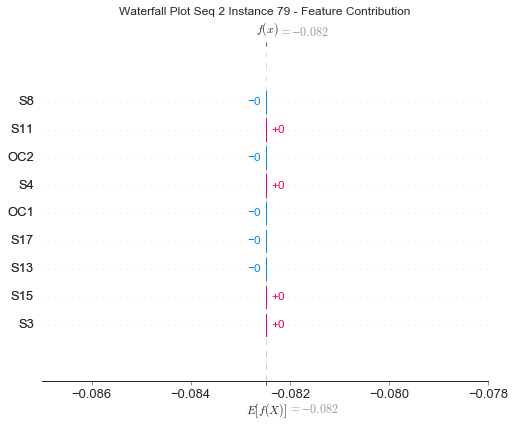

None

Contribution: [-3.81982154e-25 -7.89886671e-25  8.24362481e-26  4.45098742e-25
 -6.60587586e-25  5.46972880e-25 -1.30675339e-25  1.79532576e-25
 -1.06930219e-25]


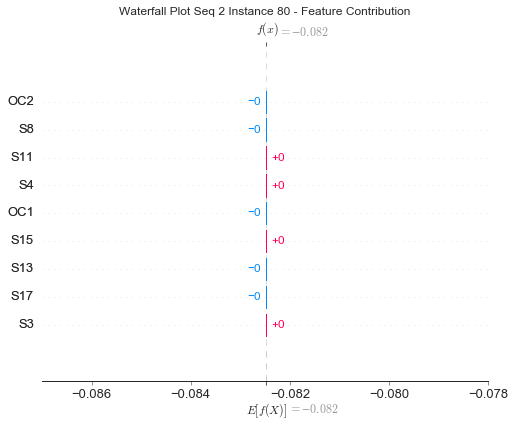

None

Contribution: [-5.18178323e-25 -8.71393012e-25  2.07137149e-25  3.19207043e-25
 -3.10120894e-25  5.35486523e-25  3.85598877e-26  4.83416231e-25
  1.15336703e-25]


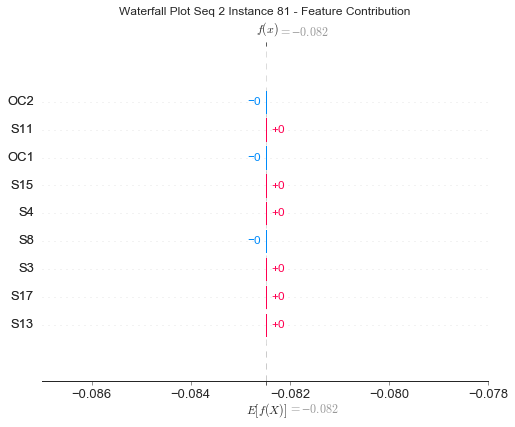

None

Contribution: [-7.23625362e-25 -1.12210139e-24  2.62179426e-25  5.14687614e-25
 -6.02327792e-25  9.55875874e-25 -2.58659479e-26  3.32138248e-25
  1.57521545e-25]


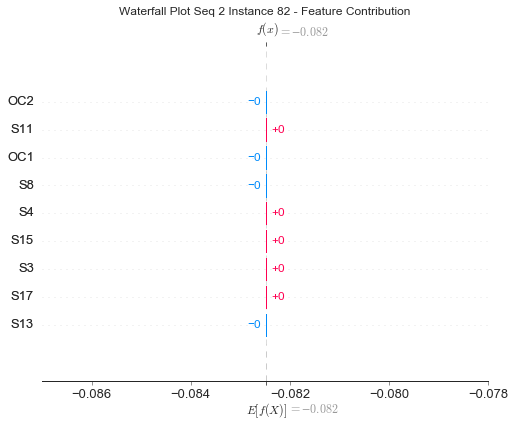

None

Contribution: [-6.06038446e-25 -9.72404876e-25  2.84658905e-25  3.91262560e-25
 -2.93300950e-25  7.14548630e-25  6.69065844e-26  7.28030855e-25
  1.88381993e-25]


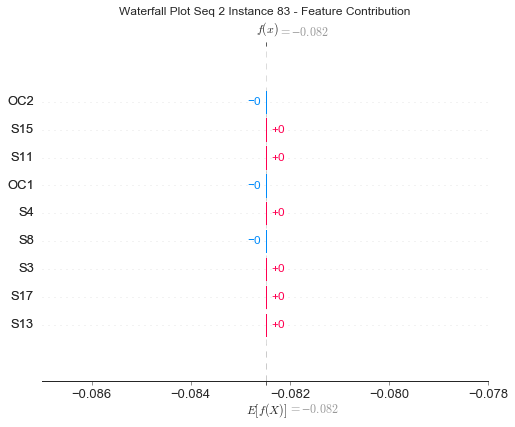

None

Contribution: [-7.32534708e-25 -1.17908190e-24  3.27303419e-25  6.42598846e-25
 -7.93329359e-25  1.18161030e-24 -7.79802810e-26  1.69267696e-25
  1.63952512e-25]


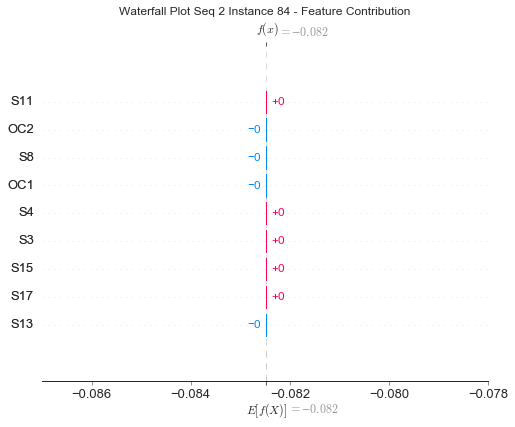

None

Contribution: [ 2.49628353e-25  1.22039260e-25 -1.57999965e-25  1.05267305e-24
 -1.23810457e-24  8.13459955e-25 -2.98056696e-25  4.94176984e-26
 -7.72424742e-25]


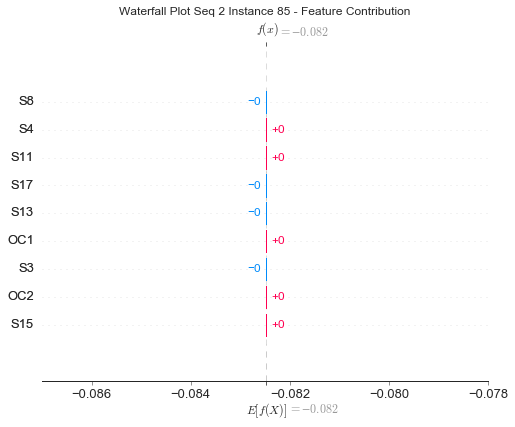

None

Contribution: [-2.15901394e-25 -8.12929101e-25  8.23490851e-26  7.36626628e-25
 -9.83876787e-25  7.66485950e-25 -2.30205340e-25  3.65913328e-25
 -2.56448869e-25]


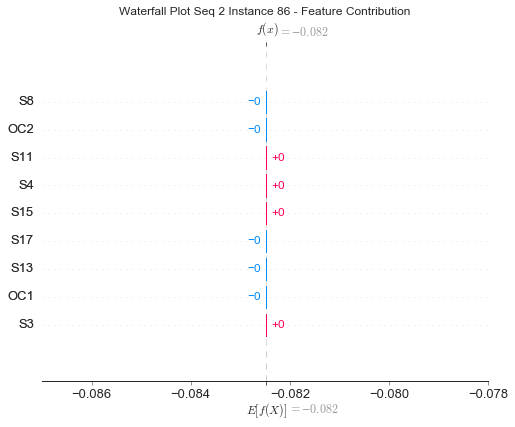

None

Contribution: [-2.29863344e-25 -7.77356651e-25 -7.16593974e-26  8.50987350e-25
 -1.18363501e-24  6.35019519e-25 -3.05364556e-25  3.28515232e-25
 -5.12252449e-25]


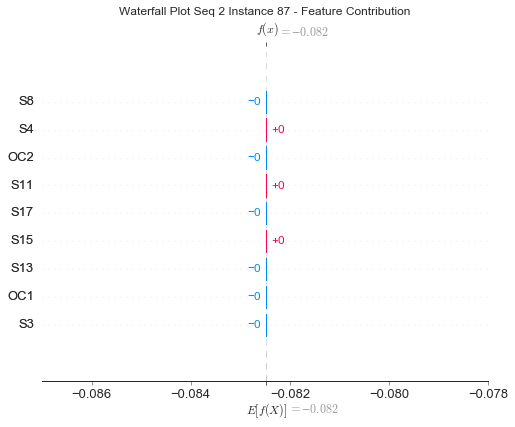

None

Contribution: [-1.73847700e-25 -3.28888684e-25 -1.73045625e-25  9.01684088e-25
 -1.16274518e-24  4.72099577e-25 -2.64493870e-25  1.50594755e-25
 -6.61856518e-25]


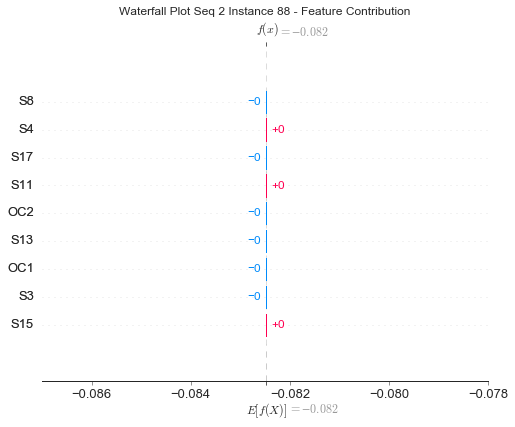

None

Contribution: [-1.43917230e-24 -2.59348495e-24 -3.14393026e-26  1.23208793e-24
 -2.49950558e-24  1.11212999e-24 -5.76241050e-25 -4.16885625e-25
 -8.94110727e-25]


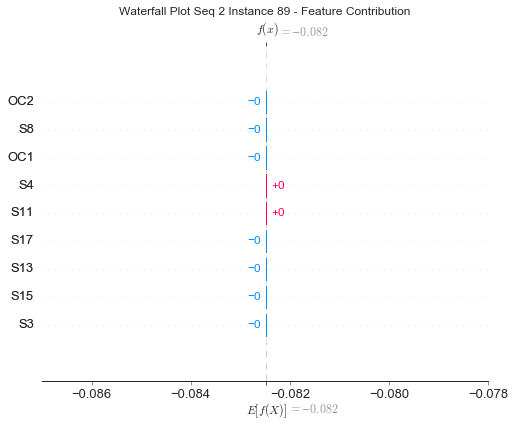

None

Contribution: [-9.02023199e-25 -7.15995041e-27 -7.16258141e-25  2.81092992e-24
 -3.78831162e-24  1.87616071e-24 -7.05367325e-25 -4.50182655e-25
 -2.35933269e-24]


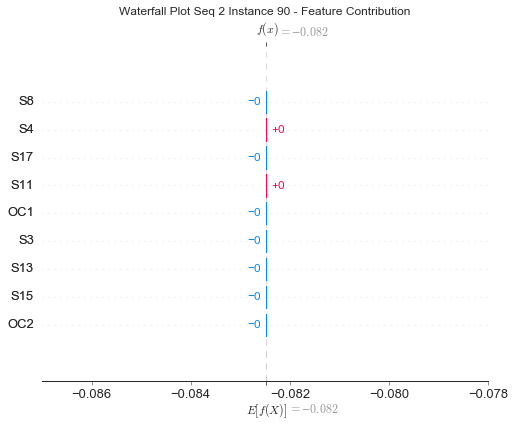

None

Contribution: [-1.60946202e-24 -2.77032232e-24 -7.73867926e-26 -4.39235829e-25
  1.52781413e-24 -1.86082742e-24  1.28438598e-25  5.35331147e-24
  1.07432292e-25]


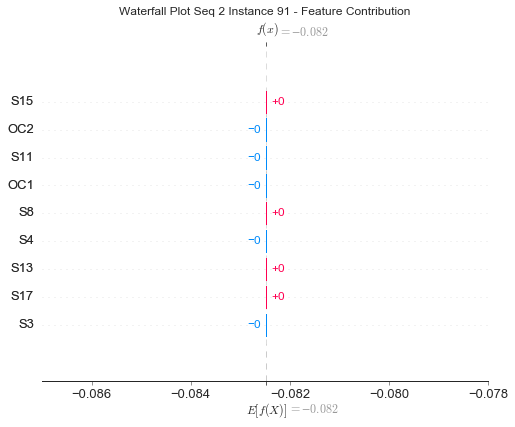

None

Contribution: [-5.53962780e-24 -7.38246958e-24  1.28354592e-24  2.27030441e-24
 -3.56711700e-24  3.41238824e-24 -1.01912763e-24  1.78067021e-25
  5.79377610e-25]


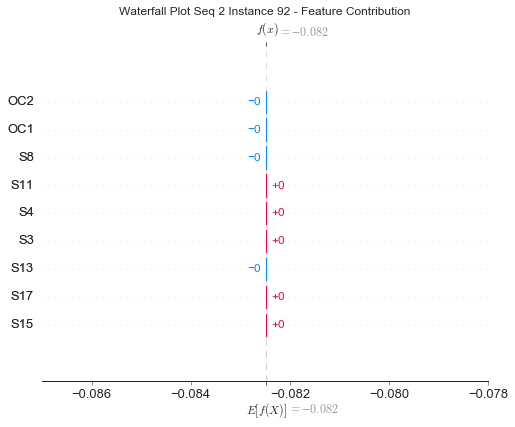

None

Contribution: [-1.85241659e-24 -9.58470339e-25 -1.41923699e-24  5.55875018e-24
 -8.16472930e-24  4.20137852e-24 -2.11640948e-24 -9.01064635e-25
 -4.68074129e-24]


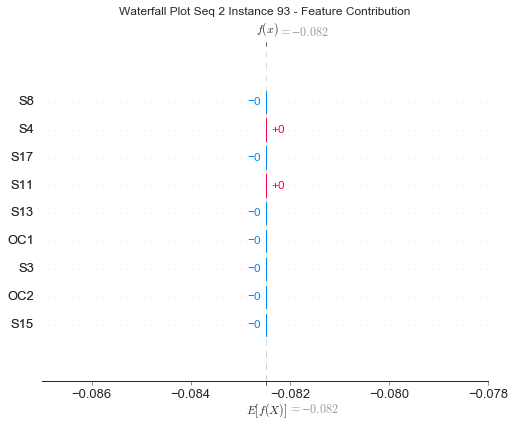

None

Contribution: [-3.82437361e-24 -7.36661900e-24  6.32564831e-25  2.10481520e-24
 -1.31125732e-24  8.33990528e-26  9.44479249e-26  7.36819278e-24
  1.11092348e-25]


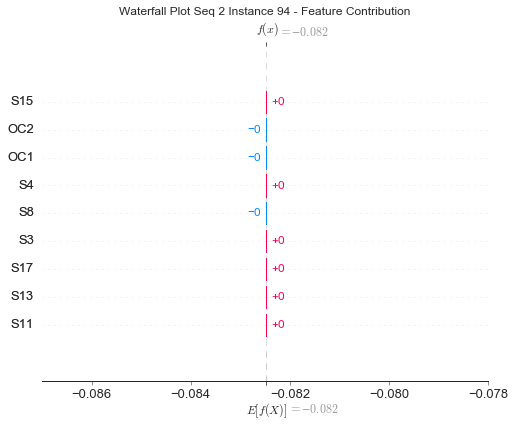

None

Contribution: [-5.01802705e-24 -9.13214651e-24  8.73890053e-25  1.16631211e-24
  1.24353016e-24  2.17344245e-25  3.42396029e-25  1.31676970e-23
  1.20202148e-24]


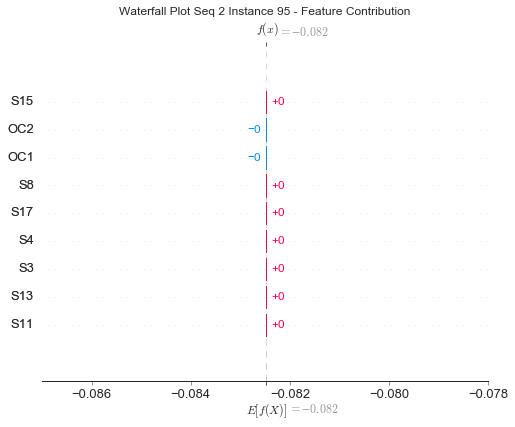

None

Contribution: [-8.19328607e-24 -1.29800830e-23  3.42787397e-24  7.75898579e-24
 -8.60809595e-24  1.10977260e-23 -3.60279826e-25  3.26064552e-24
  5.46552368e-25]


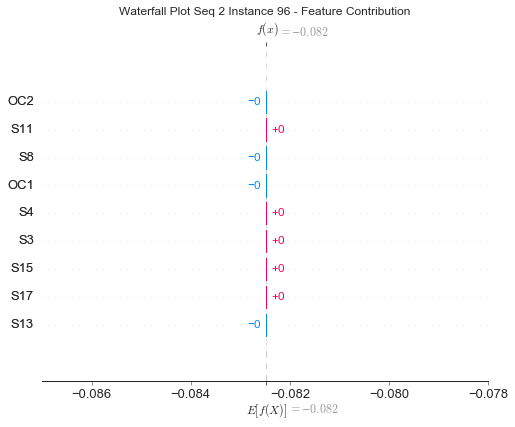

None

Contribution: [-1.30332088e-23 -1.40669614e-23  3.87379811e-24  9.72546615e-24
 -8.36378179e-24  1.44153255e-23  7.44216062e-25  2.64248978e-24
  1.69365458e-24]


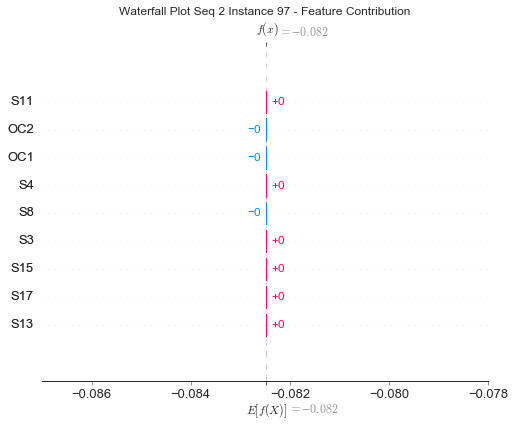

None

Contribution: [-1.52668535e-23 -1.69755641e-23  5.43859759e-24  9.28627809e-24
 -8.37103378e-24  1.54229060e-23  1.26698437e-24  4.90717355e-24
  2.65127019e-24]


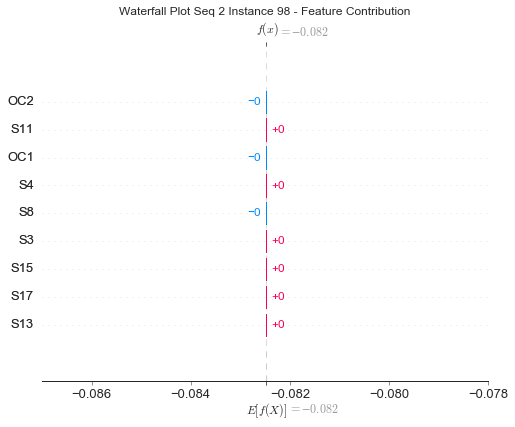

None

Contribution: [-1.82016085e-23 -2.14636147e-23  5.12427399e-24  9.89682804e-24
 -1.10546510e-23  1.66667329e-23 -9.39126286e-25  4.30214485e-24
  2.62617909e-24]


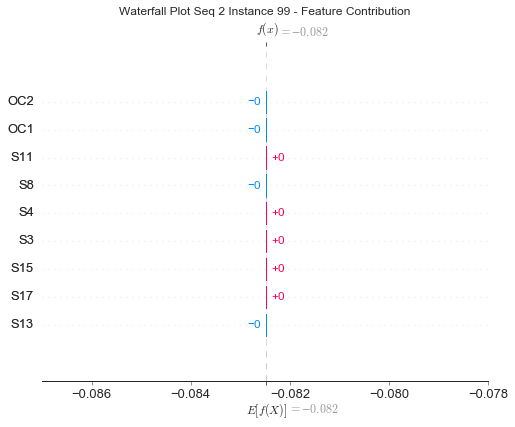

None

Contribution: [ 4.51675564e-24  6.28297892e-24 -4.94451823e-24  2.08280263e-23
 -2.77543702e-23  1.37770834e-23 -6.46191348e-24 -6.71924355e-25
 -1.81811029e-23]


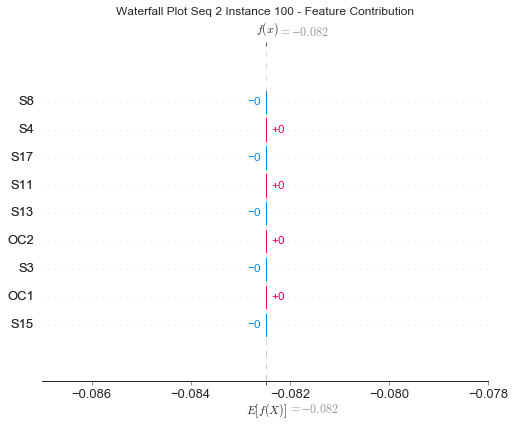

None

Contribution: [-2.17592466e-23 -3.13934045e-23  8.08146582e-24  1.51775308e-23
 -1.80179570e-23  2.18780727e-23 -1.25684978e-24  5.79494894e-24
  3.33288250e-24]


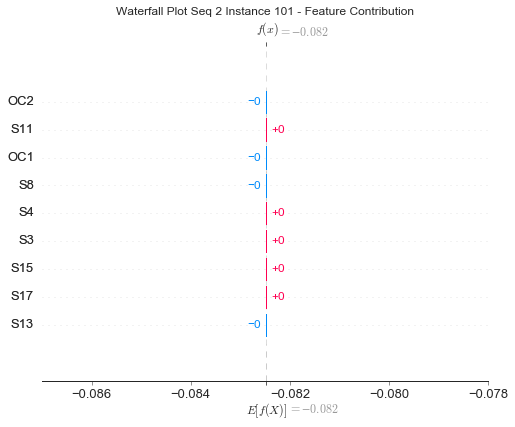

None

Contribution: [-3.21778789e-24 -3.57898856e-24 -1.45816107e-25  2.66923678e-23
 -2.98809246e-23  2.11447445e-23 -4.77625380e-24  2.09889322e-24
 -1.38772797e-23]


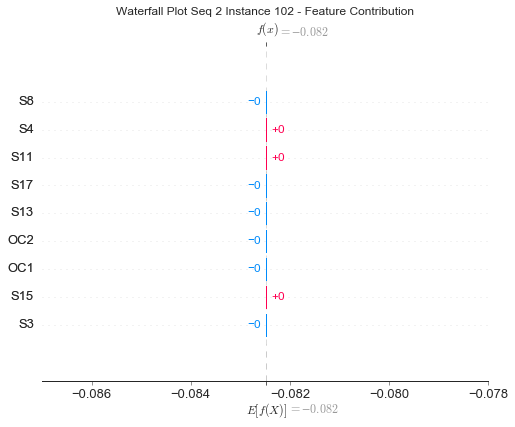

None

Contribution: [-4.77445914e-23 -5.44393794e-23  1.28638483e-23  2.37906833e-23
 -2.71130136e-23  3.60018920e-23 -3.08065744e-24  8.80500826e-24
  6.17258020e-24]


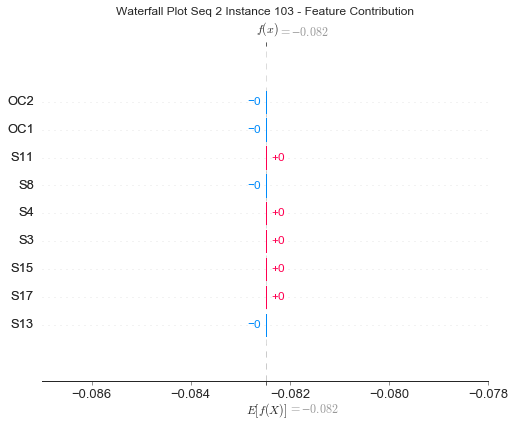

None

Contribution: [-5.64448674e-24  4.52648782e-24 -9.97826136e-24  5.59838113e-23
 -7.22301303e-23  4.69844987e-23 -1.29766246e-23 -1.89342690e-24
 -4.10956805e-23]


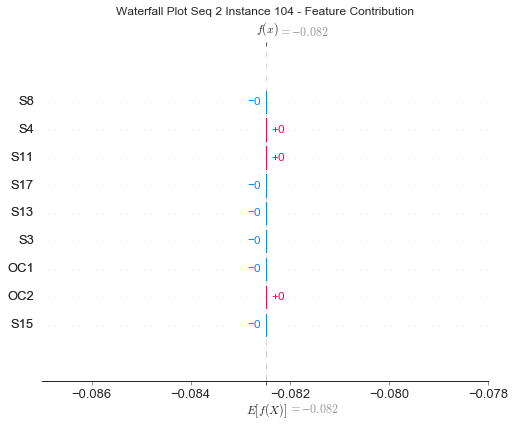

None

Contribution: [-5.07030092e-23 -6.26720896e-23  1.11676656e-23  1.72424767e-23
  3.46372849e-24  8.84962228e-24  5.84358616e-24  7.29943282e-23
  9.12530472e-24]


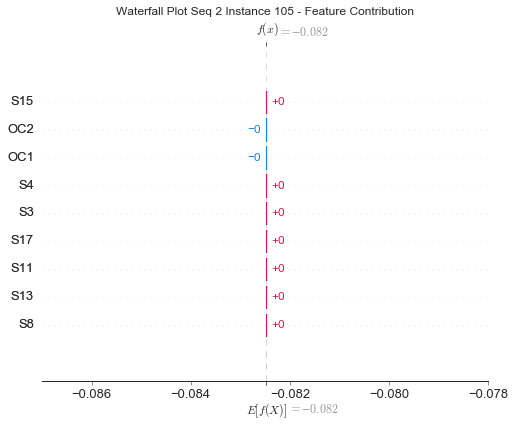

None

Contribution: [ 6.06409763e-24 -1.14295367e-23 -4.17196623e-24  6.39187549e-23
 -7.96273042e-23  5.55455707e-23 -1.63846236e-23  9.76528627e-24
 -3.67896043e-23]


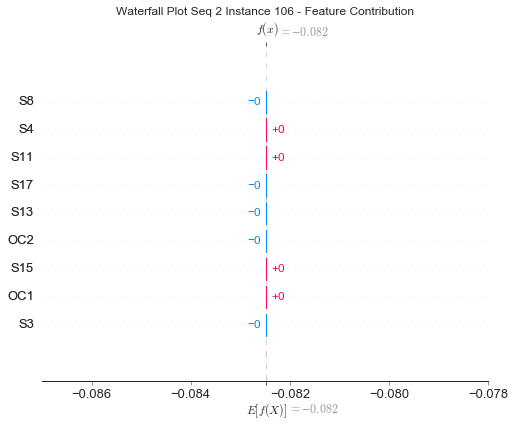

None

Contribution: [-6.98401026e-23 -1.06459682e-22  3.02770937e-23  5.64483494e-23
 -6.54384102e-23  9.23684870e-23 -2.12620280e-24  2.56234486e-23
  1.49269396e-23]


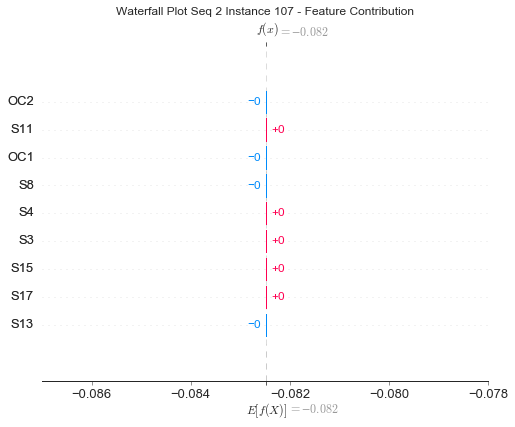

None

Contribution: [-2.85830812e-23 -9.76575091e-23  1.04553187e-23  7.93758343e-23
 -1.11736606e-22  8.55679948e-23 -1.58752798e-23  3.99379356e-23
 -2.52896768e-23]


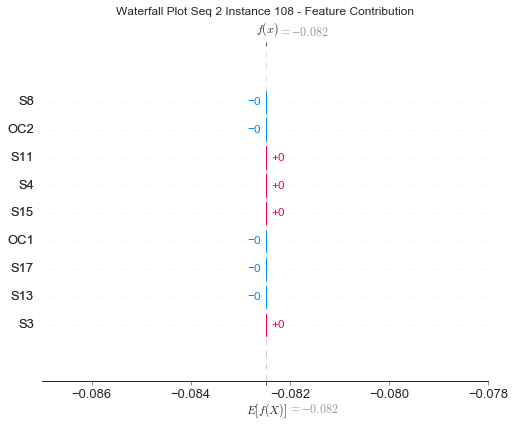

None

Contribution: [-3.38561809e-23 -5.77091637e-23 -7.96204411e-24  7.06831109e-23
 -5.75928099e-23  5.05534317e-23 -1.85071091e-23  1.17477128e-22
 -2.94071032e-23]


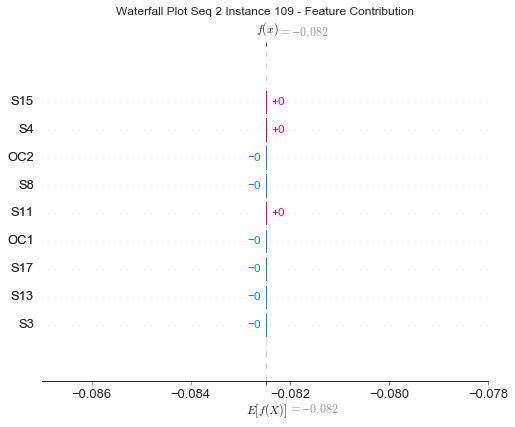

None

Contribution: [-1.15372501e-23 -5.42889216e-23  3.21207121e-24  1.12187809e-22
 -1.49655989e-22  1.21080910e-22 -2.98216023e-23  2.70765335e-23
 -5.37022299e-23]


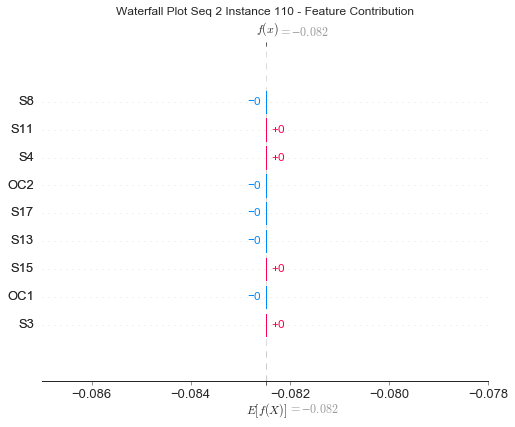

None

Contribution: [-2.00820084e-23 -7.62727994e-24 -6.00013048e-24  1.61275834e-22
 -2.07558291e-22  1.62751168e-22 -4.49003850e-23  2.53903777e-24
 -9.69903915e-23]


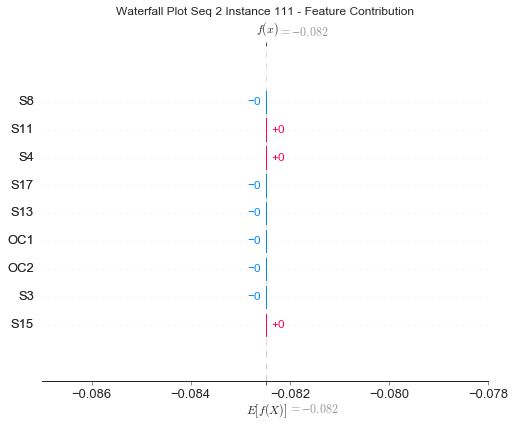

None

Contribution: [ 1.14792002e-23  3.26518332e-23 -3.38904995e-23  2.17039011e-22
 -2.88624010e-22  1.86796305e-22 -5.89722752e-23 -3.09976077e-23
 -1.60075478e-22]


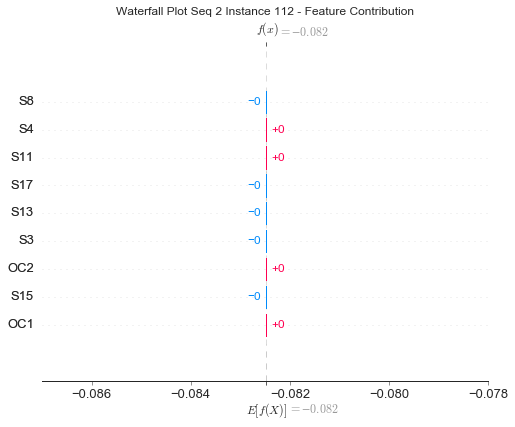

None

Contribution: [-4.60942787e-23 -7.94491794e-23  6.09419622e-24  1.89302636e-22
 -2.38934937e-22  1.80521882e-22 -4.32409151e-23  2.72713917e-23
 -8.62247499e-23]


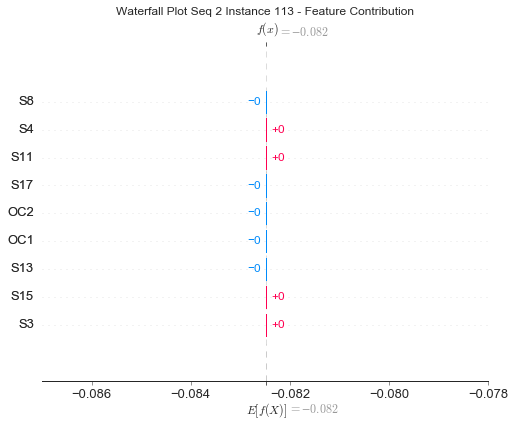

None

Contribution: [-1.04600021e-22 -1.33292552e-22 -4.51031933e-24  2.18334207e-22
 -3.08355227e-22  2.73314278e-22 -6.51951318e-23  1.40230297e-23
 -1.02011908e-22]


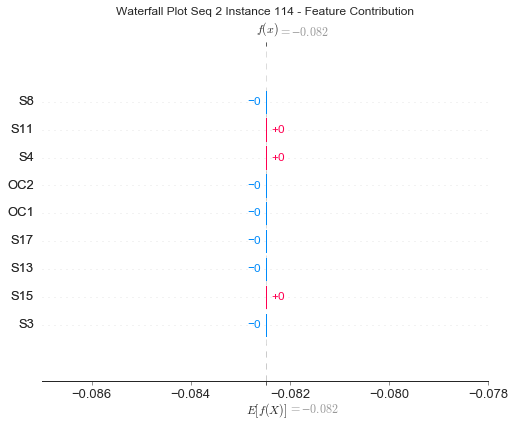

None

Contribution: [-4.30228140e-23 -2.19230857e-22  2.89696199e-23  1.85640441e-22
 -2.28284355e-22  1.92148190e-22 -2.10040764e-23  1.18086697e-22
 -4.86723329e-23]


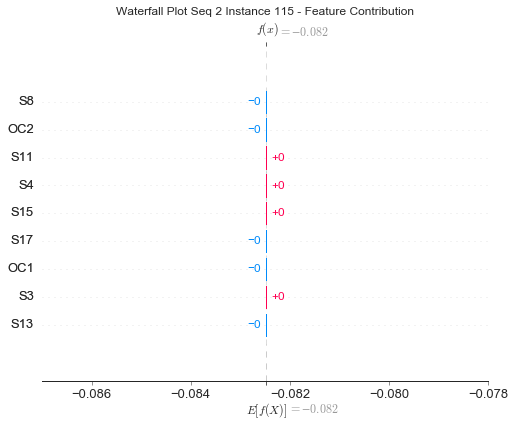

None

Contribution: [-8.72856353e-23 -3.05082754e-22  2.25766154e-23  3.13414564e-22
 -4.33952510e-22  3.59434159e-22 -7.10531750e-23  1.07927456e-22
 -1.21043511e-22]


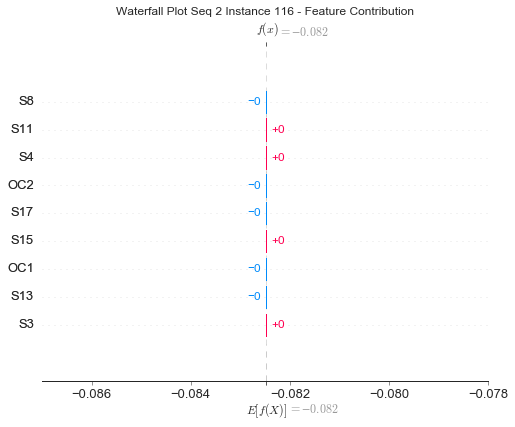

None

Contribution: [-2.85926712e-22 -4.36673714e-22  1.47247565e-22  2.53647963e-22
 -2.58681198e-22  4.62365134e-22  4.13145704e-23  2.00353403e-22
  7.53839583e-23]


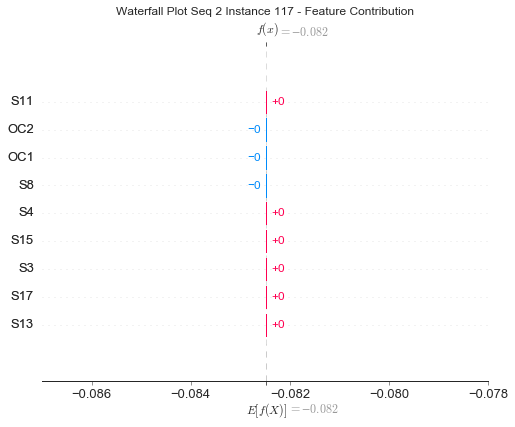

None

Contribution: [-4.80872190e-22 -6.03955039e-22  2.01719218e-22  3.59312536e-22
 -3.44239487e-22  6.31007894e-22  2.85440136e-23  1.26061449e-22
  1.13381489e-22]


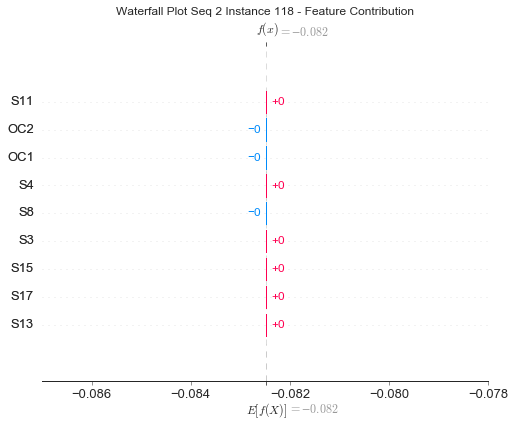

None

Contribution: [ 7.31642930e-23  4.62186031e-23 -1.20572694e-22  5.39547639e-22
 -6.89188721e-22  4.26575133e-22 -1.40825190e-22  2.91287552e-23
 -4.77568112e-22]


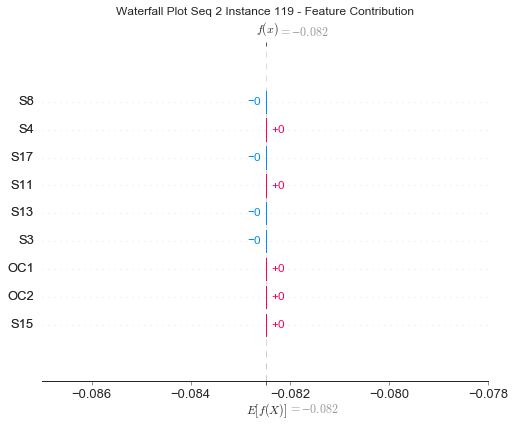

None

Contribution: [ 3.01580110e-22 -1.94572719e-22 -1.42518300e-22  3.85855194e-22
 -7.34641397e-22  2.26021044e-22 -2.33858535e-22  3.08923333e-22
 -4.38400575e-22]


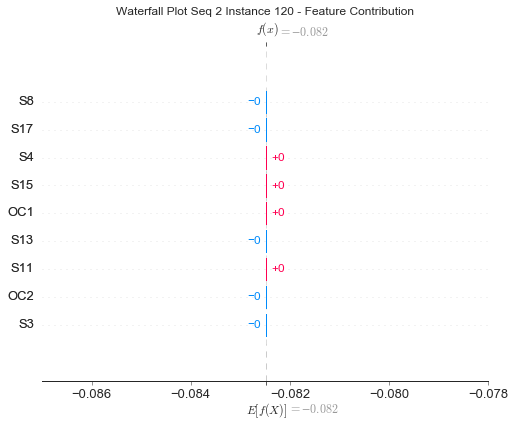

None

Contribution: [-4.85121790e-22 -1.24792120e-21  9.01720079e-24  2.99464777e-22
 -7.83488876e-22  4.23632493e-22 -2.15896589e-22  3.87343150e-22
 -1.93514901e-22]


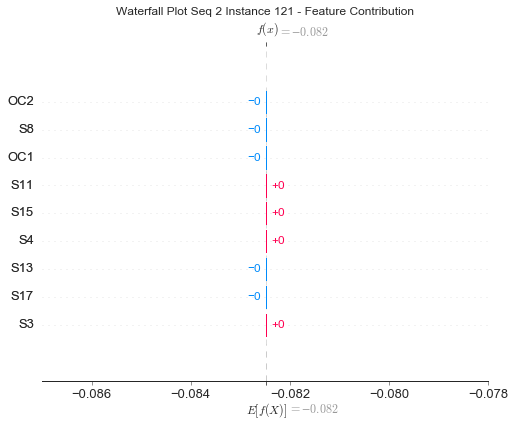

None

Contribution: [ 1.31096323e-21  1.55085712e-21 -5.76146089e-22  1.47137256e-21
 -1.81754704e-21  4.81085245e-22 -4.54632682e-22 -2.90454218e-22
 -1.60720193e-21]


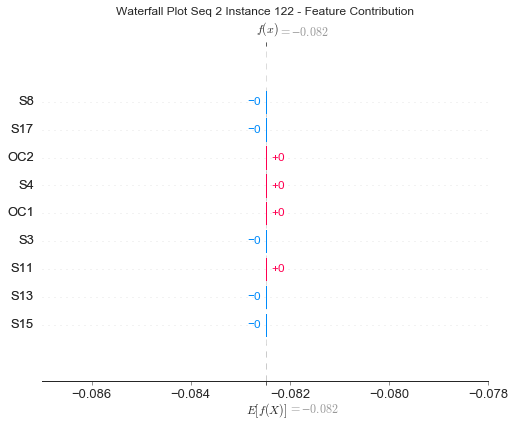

None

Contribution: [-1.91743637e-21 -1.75138168e-21  6.13812039e-22  4.82606220e-22
 -8.45426334e-23  1.41518698e-21  3.54114738e-22  3.88177827e-22
  7.47578060e-22]


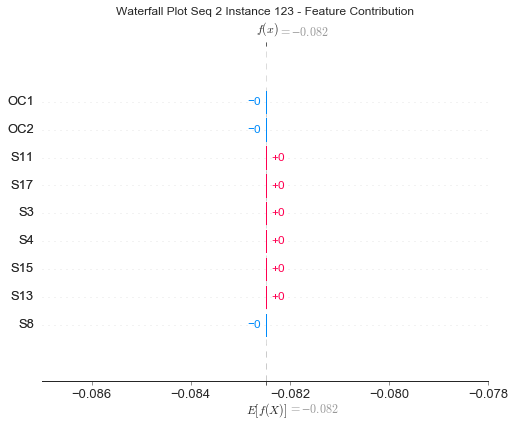

None

Contribution: [-6.56751770e-22 -1.56852750e-21  3.75934050e-22  7.75414727e-22
 -9.87698686e-22  9.58366490e-22 -1.62203282e-22  3.94885972e-22
  6.09455381e-23]


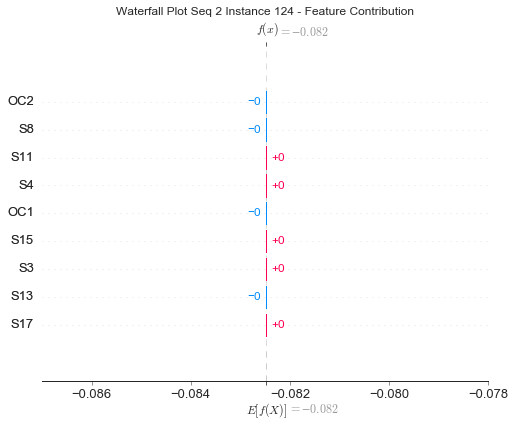

None

Contribution: [-2.42858794e-22 -1.26586270e-21  1.10927109e-22  1.17013957e-21
 -1.51432415e-21  1.15718791e-21 -2.23348408e-22  5.38976074e-22
 -4.75982615e-22]


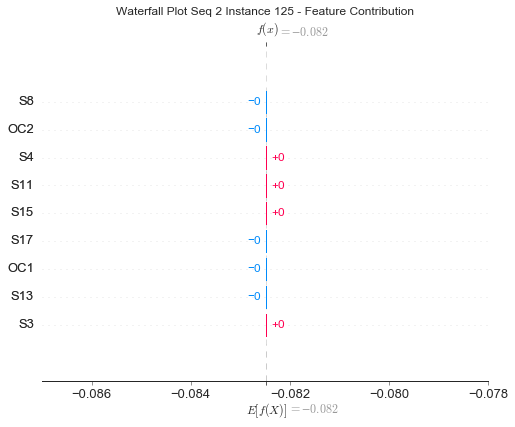

None

Contribution: [-1.88961030e-21 -2.33822633e-21  1.03791113e-21  5.24158313e-22
  3.37238744e-22  1.59725214e-21  5.94804202e-22  1.10182780e-21
  1.40333958e-21]


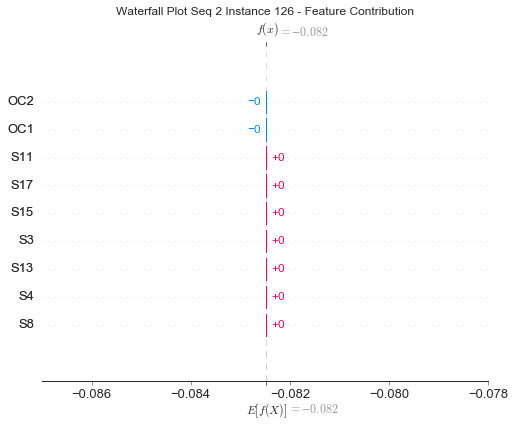

None

Contribution: [-1.71429264e-21 -2.56954630e-21  7.78369383e-22  1.03947593e-21
 -1.09270882e-21  2.11569112e-21  4.15819312e-23  7.46424732e-22
  5.40978544e-22]


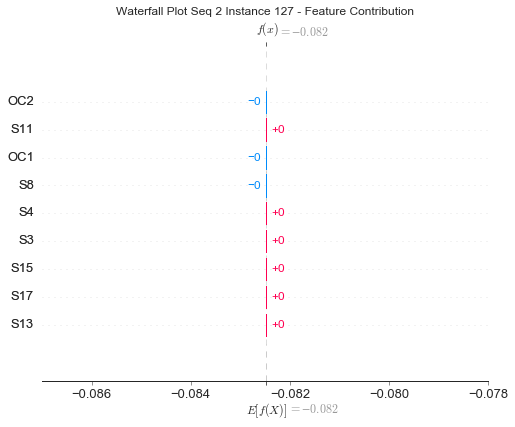

None

Contribution: [-1.23154024e-22 -3.20909808e-21  9.19915213e-22 -5.14251829e-23
 -2.85232943e-22  1.05400581e-21  2.57664868e-22  1.93592030e-21
  1.02178778e-21]


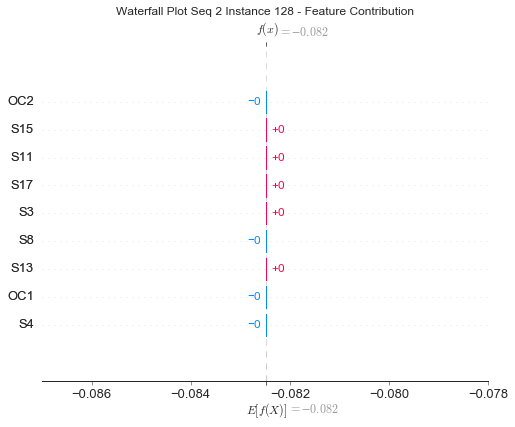

None

Contribution: [-1.06916093e-21 -2.25064172e-21  7.00906221e-22  1.36752827e-21
 -1.76506227e-21  2.05083560e-21 -2.25013120e-22  6.88935680e-22
  1.45139009e-22]


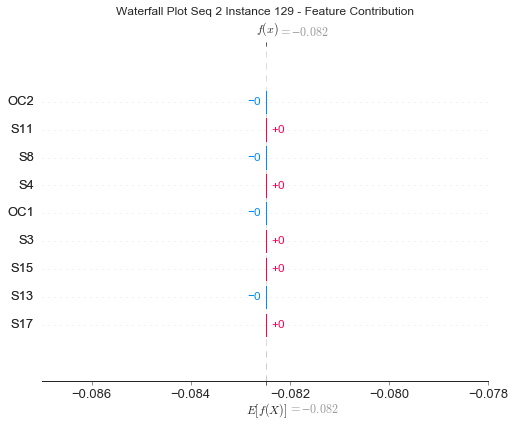

None

Contribution: [ 1.50210691e-22  3.72813846e-22 -2.46257585e-22  2.96739736e-21
 -3.21483765e-21  1.57779855e-21 -6.28930653e-22 -3.18236997e-23
 -2.29640403e-21]


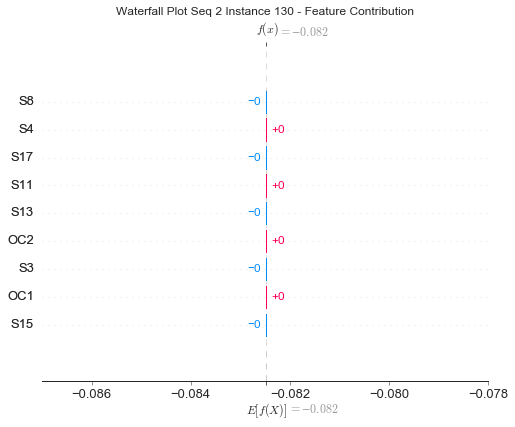

None

Contribution: [-2.81792647e-21 -3.32745337e-21 -6.70547925e-23  3.56838567e-21
 -4.28171748e-21  2.63522618e-21 -9.08808052e-22 -9.71842001e-22
 -1.90311035e-21]


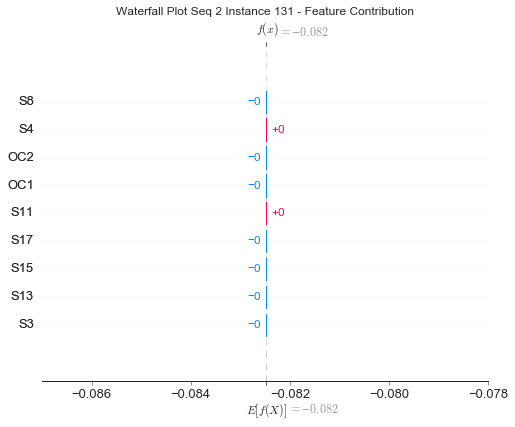

None

Contribution: [ 2.42974450e-21  3.57152032e-21 -1.16209395e-21  6.84742696e-21
 -9.03776326e-21  4.82695955e-21 -1.22008363e-21 -1.12349747e-21
 -5.32790143e-21]


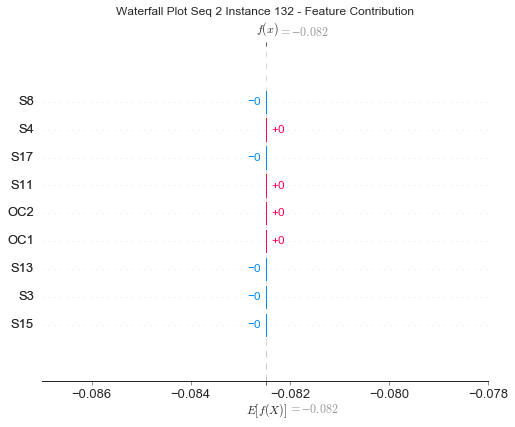

None

Contribution: [-5.09840243e-21 -7.92153472e-21  1.33378754e-21 -8.62281565e-22
  7.02194753e-21 -2.50900884e-21  1.53358730e-21  1.43429289e-20
  3.31613133e-21]


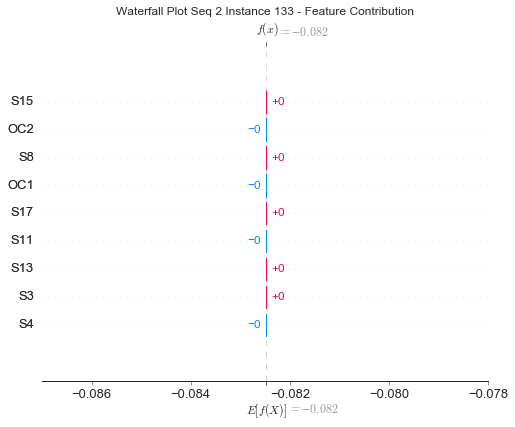

None

Contribution: [-1.13402673e-20 -1.50662871e-20  3.51078393e-21  1.71307873e-21
 -1.44261016e-21  6.82170439e-21  1.49922255e-21  2.38801287e-21
  4.06291891e-21]


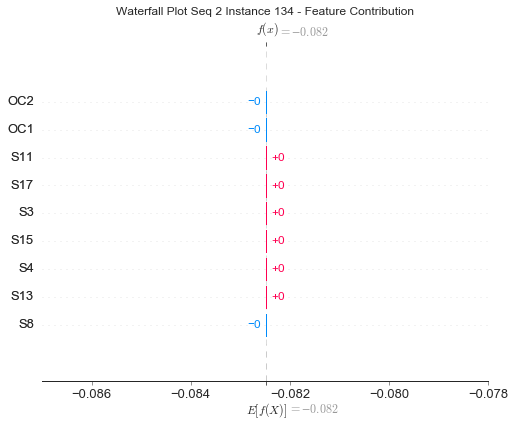

None

Contribution: [ 2.64622308e-21  5.05524767e-21 -3.23672482e-22  1.21677137e-20
 -1.42227163e-20  1.07290891e-20 -2.35673935e-21 -2.66959557e-21
 -7.50211457e-21]


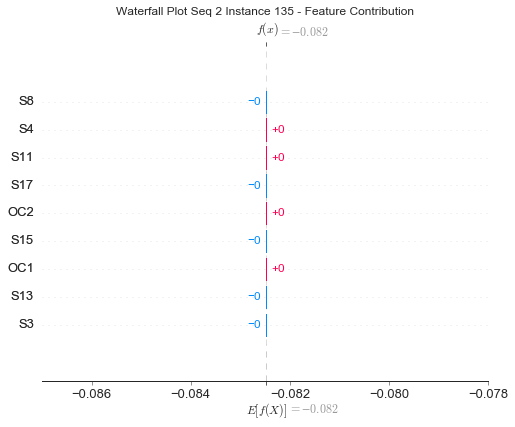

None

Contribution: [-5.99600527e-21 -1.67947036e-20  4.56926290e-21  1.35346792e-21
 -1.18860442e-21  6.04594509e-21  3.59664593e-21  8.57369555e-21
  4.58461825e-21]


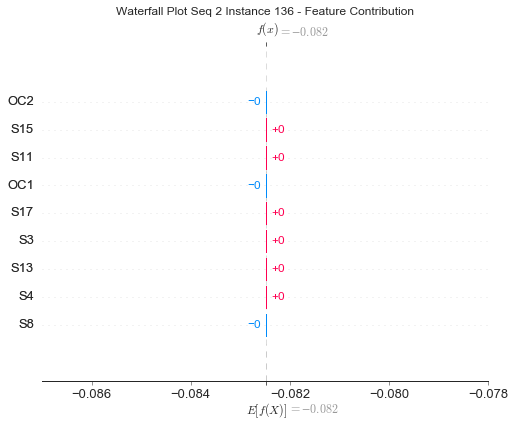

None

Contribution: [-2.37226211e-21 -1.62365796e-20  1.69311906e-21  7.86187512e-21
 -1.41600445e-20  9.37405095e-21 -8.01098978e-22  7.67567790e-21
 -4.21475502e-21]


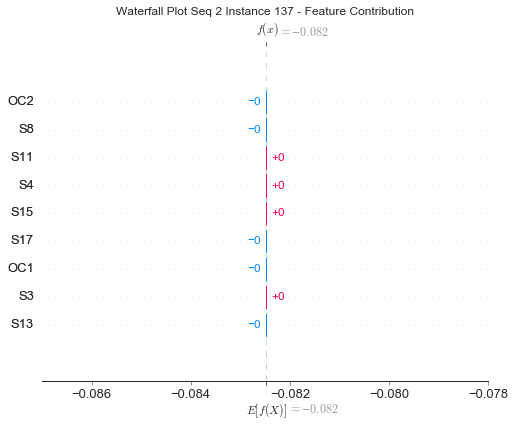

None

Contribution: [-4.91092041e-21 -1.31858503e-20  3.23871583e-21  1.02187106e-20
 -1.39316392e-20  1.50220749e-20  1.93783757e-22  7.09223042e-21
 -1.62241077e-21]


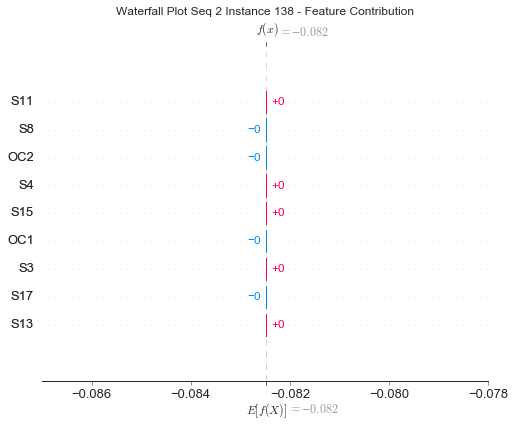

None

Contribution: [ 1.22961666e-20 -9.09211080e-21 -1.91487440e-22  4.33813459e-21
 -1.57800034e-20  5.94291869e-21 -1.49252806e-21  1.43363260e-20
 -7.23555884e-21]


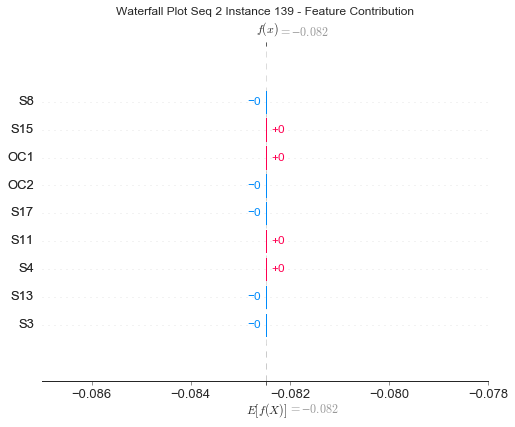

None

Contribution: [-5.43675282e-21 -2.20986196e-20  1.75901946e-22  1.29696750e-20
 -2.78535494e-20  2.12506092e-20 -5.87430511e-21  1.04373165e-20
 -9.57752607e-21]


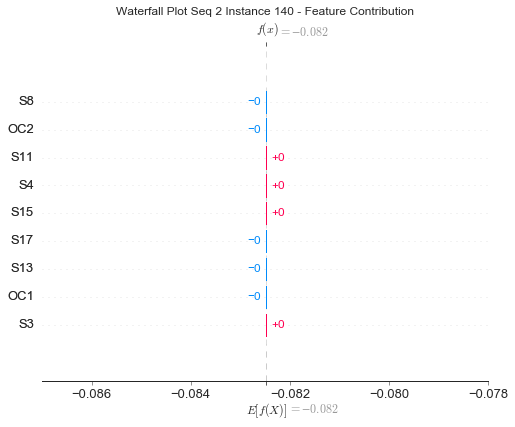

None

Contribution: [ 6.02581883e-20  2.12544995e-20 -1.03078353e-20  1.52126593e-20
 -3.83636028e-20  1.07138460e-20 -8.18316451e-21  1.78403277e-20
 -2.63278874e-20]


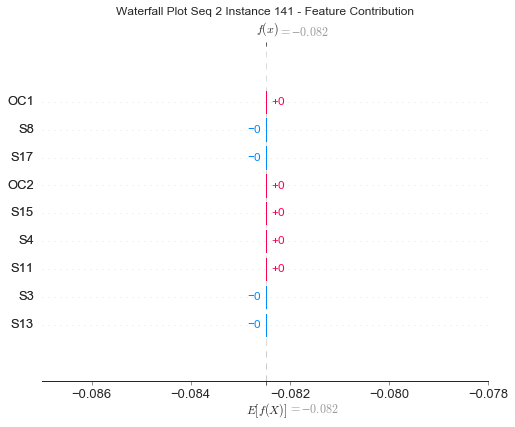

None

Contribution: [ 5.78215210e-20  1.19936035e-20 -9.29063657e-21 -2.03568551e-20
  9.52806649e-21 -2.40071111e-20 -1.72395474e-20  5.81239783e-20
 -1.30107416e-20]


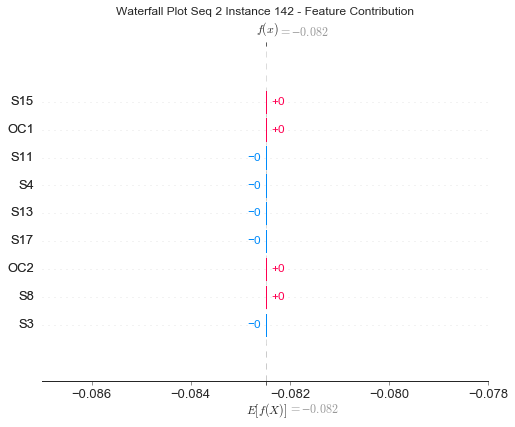

None

Contribution: [ 5.50798503e-20  6.08592772e-20 -1.76836965e-20  6.15612498e-20
 -1.17011935e-19  6.53372001e-20 -2.45124489e-20 -6.06466207e-20
 -6.86638167e-20]


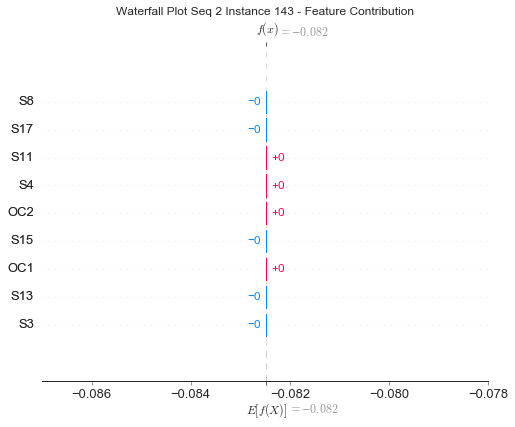

None

Contribution: [ 1.52215288e-20  2.47428810e-22 -1.04594080e-20  4.93636267e-21
 -2.73643690e-20  2.57753162e-20 -9.47883308e-21  1.71724230e-20
 -1.21493510e-20]


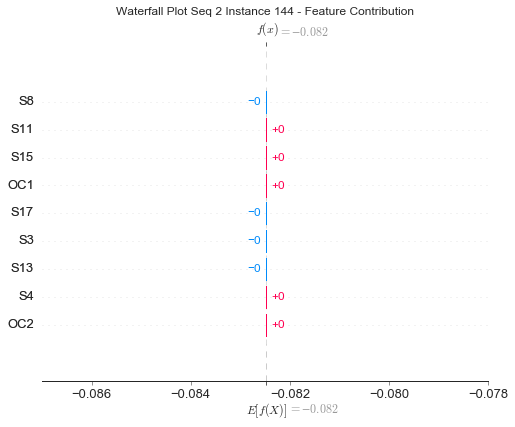

None

Contribution: [ 7.89145426e-20  7.77431256e-20 -3.18552456e-20 -6.30188067e-20
  9.10357177e-20 -1.11898150e-19 -1.16810343e-20  1.46954129e-19
 -1.32225346e-20]


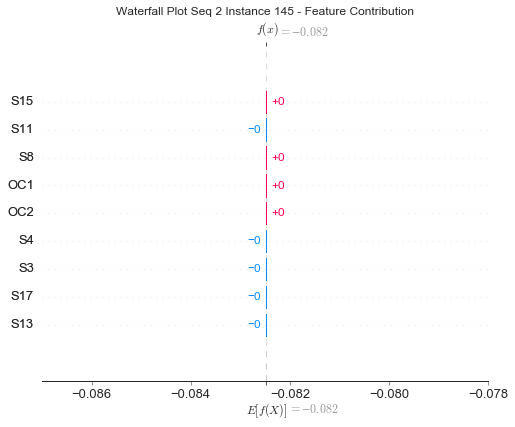

None

Contribution: [ 4.61357757e-20  1.16902683e-19 -2.26600975e-20  1.08920442e-19
 -1.96517305e-19  1.60335546e-19 -4.87035867e-20 -2.24115669e-19
 -9.88136647e-20]


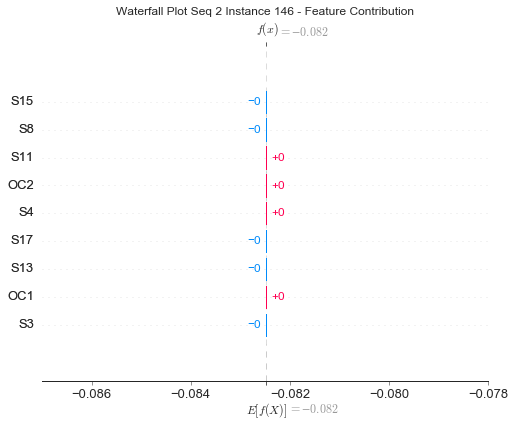

None

Contribution: [ 2.05301769e-20 -9.75207039e-20  3.77618451e-20 -1.24918037e-19
  1.51162087e-19 -7.24355342e-20  4.03248481e-20  5.33941402e-20
  1.25437494e-19]


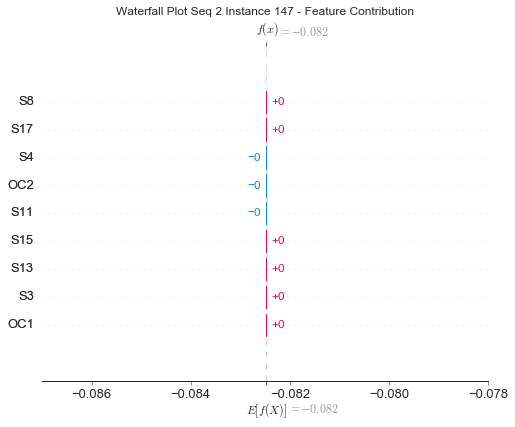

None

Contribution: [ 9.58884956e-20  9.82834355e-20  3.91507654e-21 -8.96274751e-20
  1.23878646e-19 -7.03627165e-20  1.92272657e-20 -2.00450742e-20
  5.12693168e-20]


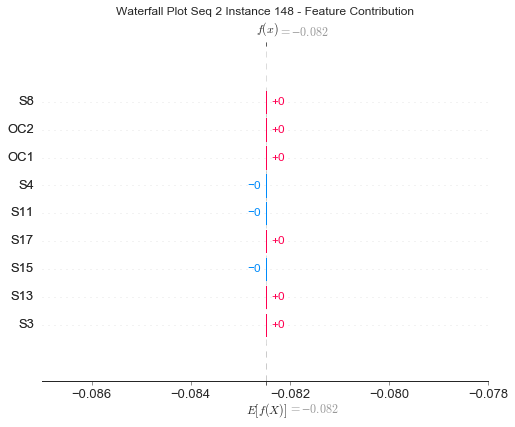

None

Contribution: [ 1.49281686e-19  6.35641772e-20 -1.23811812e-20 -1.75898510e-19
  1.75862618e-19 -1.61060996e-19  1.20535168e-20  4.71045593e-20
  6.22340384e-20]


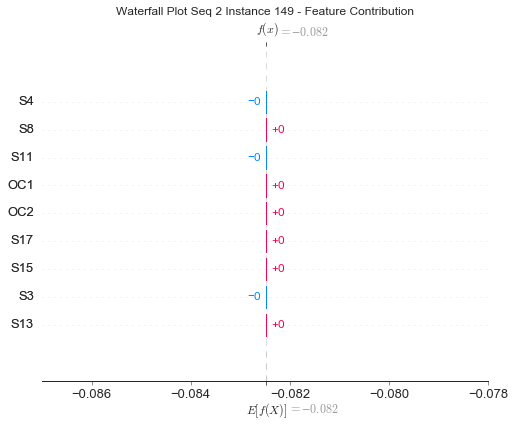

None

Contribution: [ 1.10744285e-19  2.24542804e-19 -2.23057718e-20 -1.49791307e-19
  2.21347251e-19 -1.67124230e-19  1.67551863e-20 -5.59327833e-20
  4.33482934e-20]


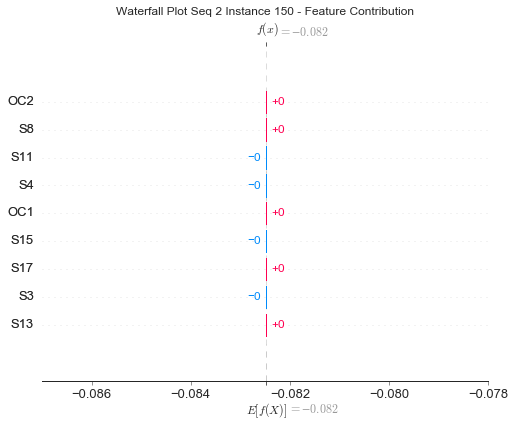

None

Contribution: [ 1.44502236e-19  1.23550100e-19  1.66912656e-20 -2.83025714e-19
  3.08819506e-19 -3.05914991e-19  6.85060708e-20 -4.82559527e-20
  1.35897012e-19]


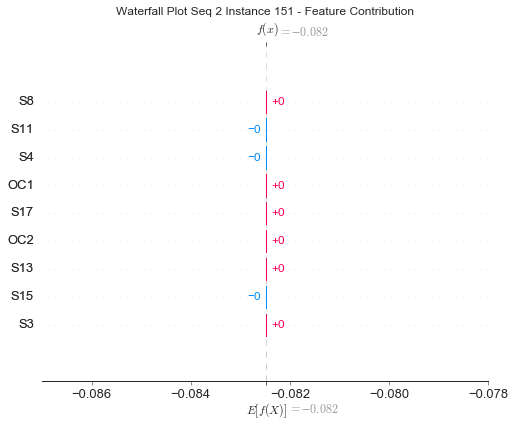

None

Contribution: [ 2.58461526e-19  3.57823185e-19 -6.67244595e-20 -2.93296609e-19
  3.22256771e-19 -4.12021300e-19  2.51347109e-21 -5.95719451e-20
  1.97990139e-20]


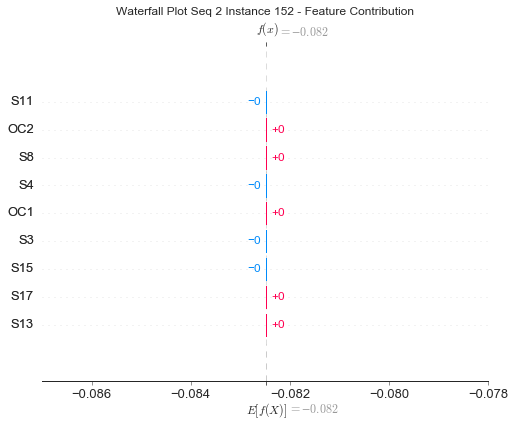

None

Contribution: [ 2.04037656e-19  4.37268455e-19 -9.02266059e-20 -1.94319615e-19
  2.60612041e-19 -3.85321228e-19  2.63382587e-21 -2.56961512e-19
 -3.62330570e-20]


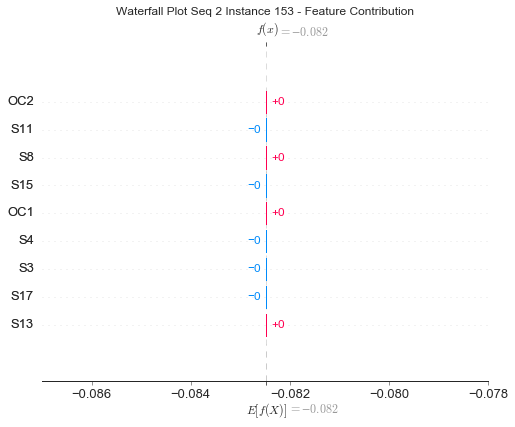

None

Contribution: [ 7.06138757e-20  2.52478270e-19 -3.53899112e-20 -1.84895107e-19
  1.16695177e-19 -1.61469649e-19  2.60439011e-20 -5.78512284e-19
  4.66380036e-20]


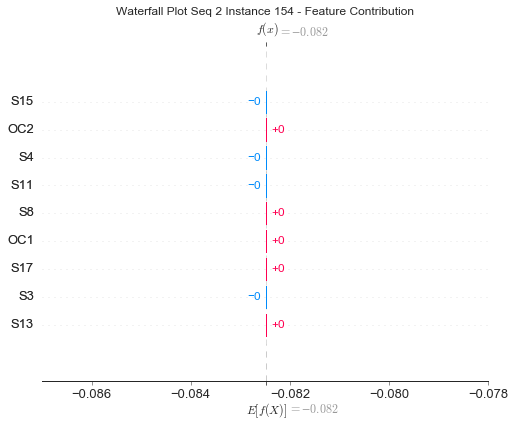

None

Contribution: [ 2.16576225e-20  2.06957474e-19  2.32033742e-20 -3.08175624e-19
  4.64081256e-19 -4.73583338e-19  1.17245058e-19 -1.16718196e-19
  1.36282607e-19]


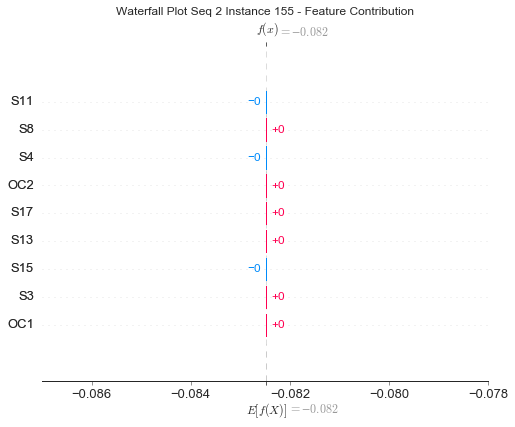

None

Contribution: [-3.67270984e-19 -3.89278227e-19  1.51891738e-19 -5.48267252e-19
  6.98352350e-19 -4.87780808e-19  1.91644319e-19 -1.21129114e-20
  4.43084362e-19]


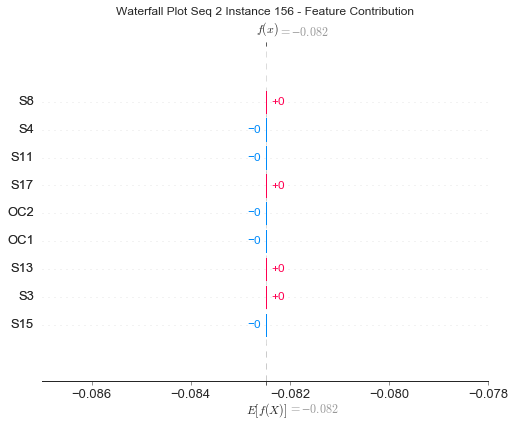

None

Contribution: [-3.55505878e-20  5.24569097e-19 -1.42089192e-21 -1.88843557e-20
  1.68604457e-19 -2.11556146e-19  4.49226636e-20 -3.12685464e-19
 -4.17951454e-20]


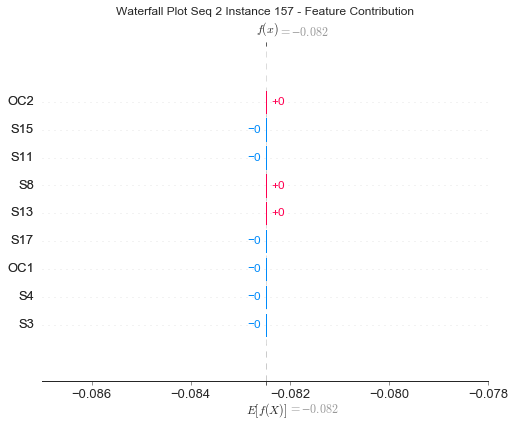

None

Contribution: [-1.15607874e-19 -2.47551990e-20  9.46844050e-20 -3.07506021e-19
  4.13877002e-19 -2.78486716e-19  1.70371263e-19 -5.66439002e-20
  2.32304990e-19]


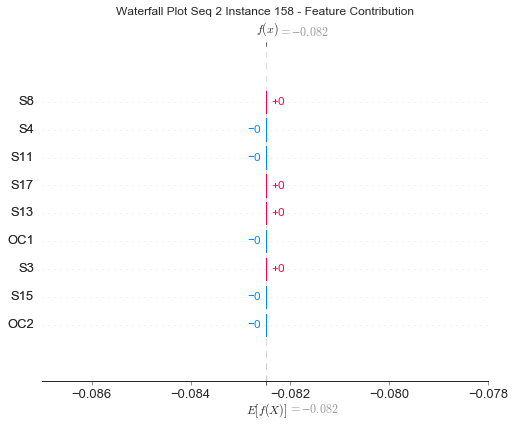

None

Contribution: [-1.49843106e-20 -6.33901694e-19  1.62236381e-19 -5.58016248e-19
  4.52312130e-19 -3.44973813e-19  1.59950106e-19  3.73592375e-19
  4.13700709e-19]


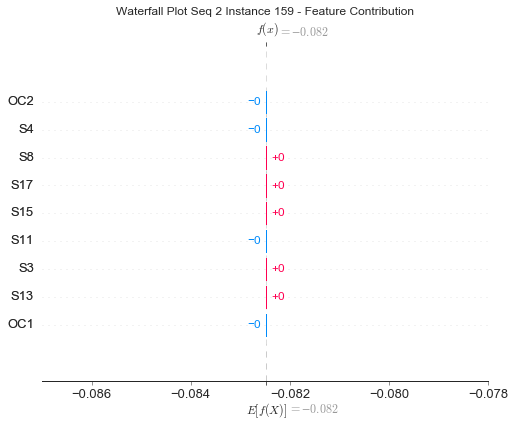

None

Contribution: [-3.41449235e-20 -1.42002887e-20  9.85605669e-20  1.87185480e-19
 -2.88845576e-19  3.06162602e-19 -2.02329913e-20  1.67518259e-20
 -1.50451681e-20]


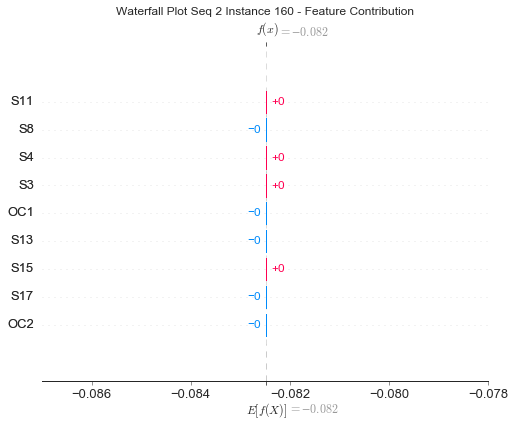

None

Contribution: [ 9.38479212e-19  4.57781203e-20 -1.35356036e-19 -1.75111115e-20
 -4.50409615e-19  3.37183892e-19 -2.62227033e-19 -7.37073437e-20
 -1.66232297e-19]


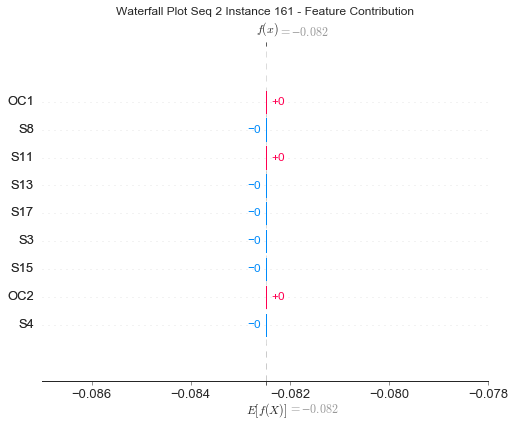

None

Contribution: [ 9.29278792e-19  3.12448994e-19  2.82999296e-20 -3.44775548e-19
  2.55382502e-19 -5.37356947e-19  2.12371488e-19  1.09280682e-18
 -2.52104424e-20]


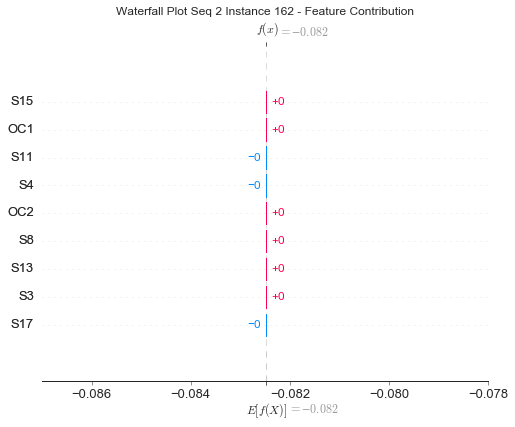

None

Contribution: [ 1.01422424e-19  1.73300297e-19 -3.58861484e-21  3.52841749e-19
 -7.26040619e-19  6.53565742e-19  1.46571441e-19  3.63775713e-20
 -2.51288759e-19]


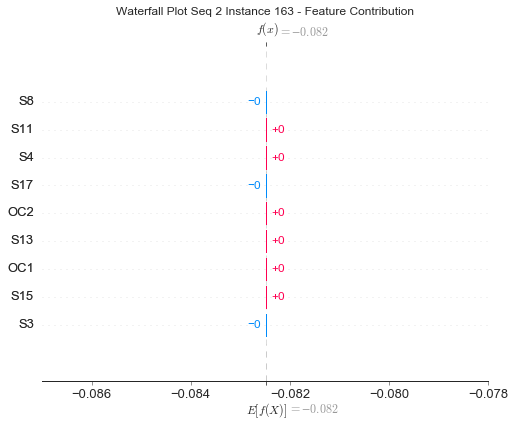

None

Contribution: [ 4.39365875e-19  5.13377395e-19 -1.11743480e-19 -4.09688547e-19
  5.39157254e-19  4.35611502e-20 -2.24949028e-19  1.12829028e-18
  2.04710632e-19]


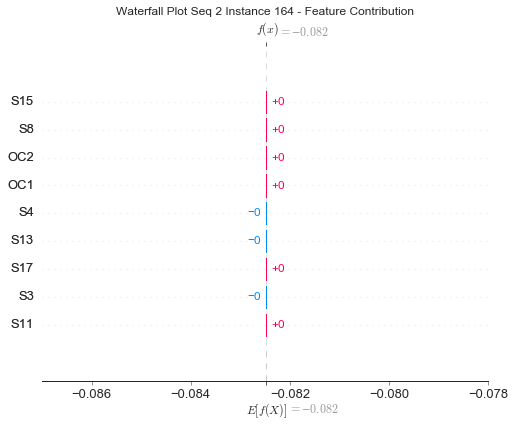

None

Contribution: [ 3.86763226e-18  3.62181403e-18 -1.04352588e-18  9.20563940e-20
 -1.04180151e-18 -6.50195601e-19 -1.18712009e-18 -3.73962306e-19
 -1.79132765e-18]


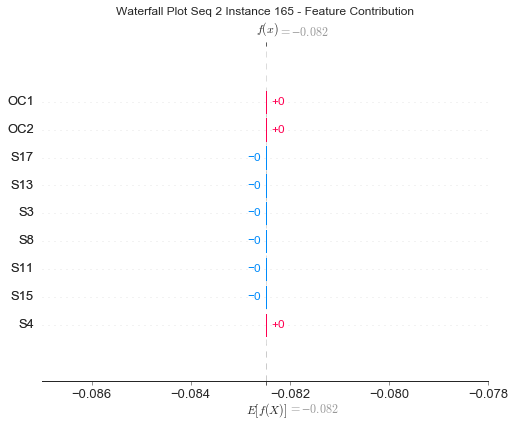

None

Contribution: [ 1.45958521e-18  1.19619436e-18 -2.27706589e-19  3.03904942e-19
 -1.85957398e-18  1.65807899e-18 -1.14727560e-19 -3.42662691e-18
 -3.40101694e-19]


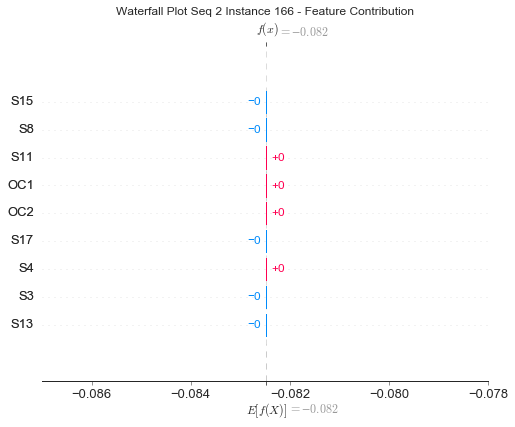

None

Contribution: [ 1.46653487e-18  2.57819127e-18  4.86511137e-19 -1.73440222e-18
  3.60564844e-18 -9.18671545e-19  1.07432471e-18  4.86567695e-19
  1.88022186e-18]


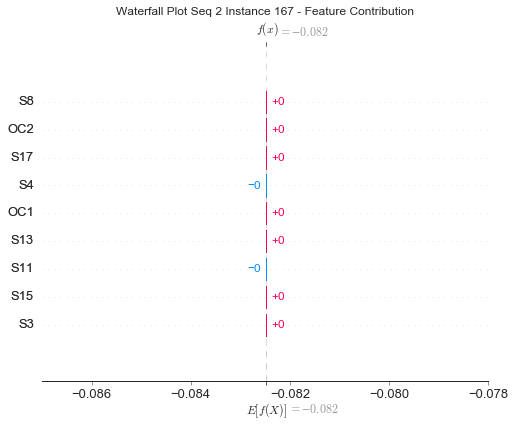

None

Contribution: [ 1.50981420e-18  1.24129010e-19  2.37790154e-19 -4.59305642e-18
  5.09716055e-18 -3.17428616e-18  4.60422998e-19  1.12334395e-18
  2.62969175e-18]


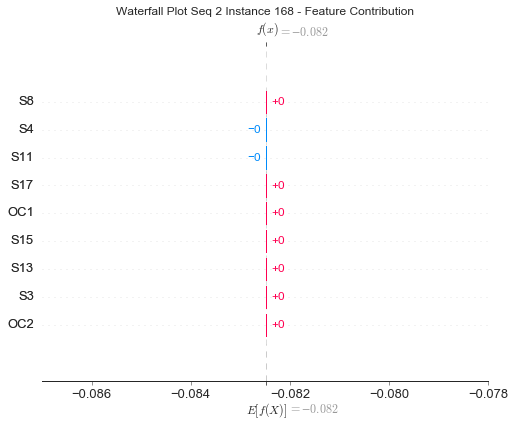

None

Contribution: [ 4.88288893e-18  9.16706536e-18 -1.71598411e-18 -1.27754354e-18
  2.59586937e-18 -4.06373114e-18 -1.14538262e-18 -3.16825271e-18
 -1.54467180e-18]


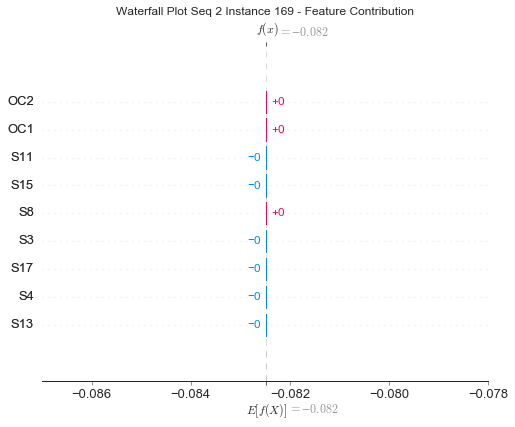

None

Contribution: [ 5.91410853e-18  7.46658633e-18 -1.20146485e-18 -1.24607594e-18
 -1.42362219e-18  1.78091017e-19 -7.95485843e-19 -1.28304969e-17
 -8.85572326e-19]


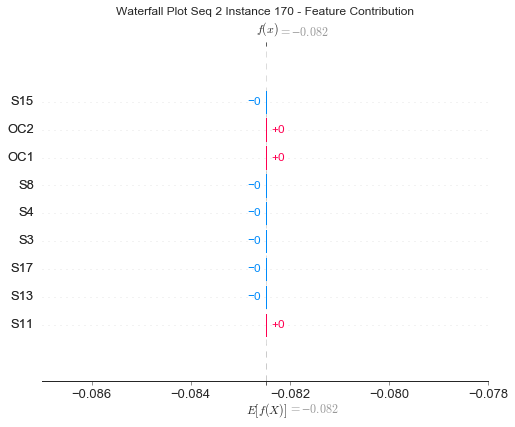

None

Contribution: [ 7.39645796e-18  6.45962173e-18 -5.56804222e-19 -8.94131867e-18
  1.11863199e-17 -1.04255106e-17  2.49703721e-18 -6.24727330e-19
  3.62831609e-18]


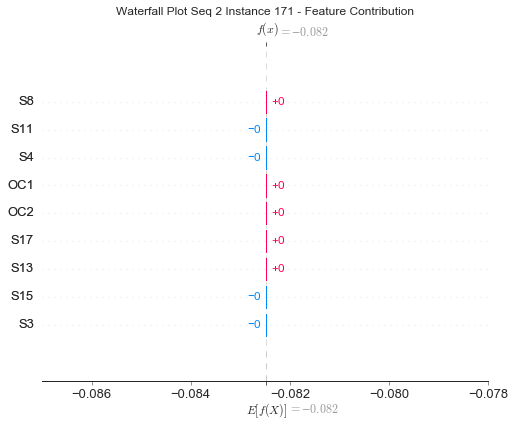

None

Contribution: [ 3.47851120e-18  1.07833448e-17  2.18118238e-20 -8.33530878e-18
  1.45837550e-17 -1.02805952e-17  2.97844557e-18 -3.15614299e-18
  4.81245781e-18]


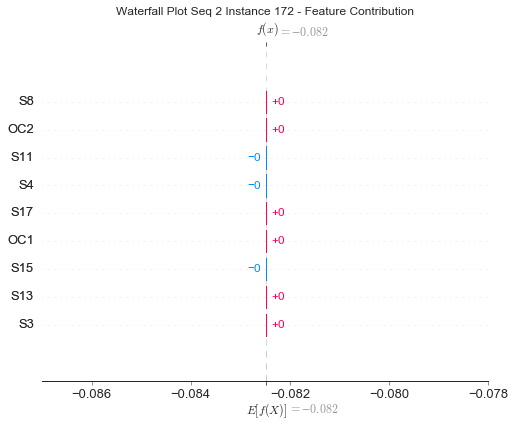

None

Contribution: [ 1.32571856e-17  1.43787218e-17 -2.92024555e-18 -1.30590196e-17
  1.37749693e-17 -1.73248579e-17  8.93631443e-19 -1.98340127e-18
  1.23674834e-18]


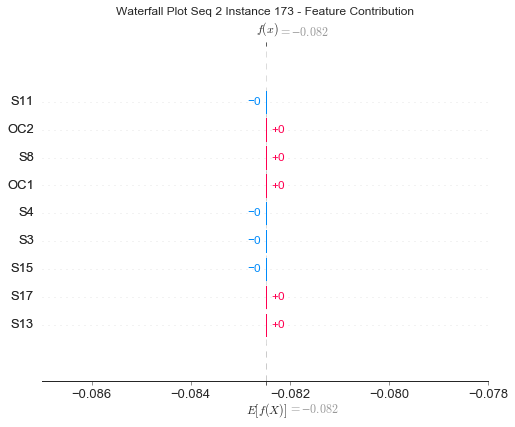

None

Contribution: [-4.74864589e-19  1.13626169e-17 -6.64110795e-19 -3.98134106e-18
  6.51086185e-18 -7.79707973e-18  2.41645906e-18 -1.60419421e-17
  7.41755603e-19]


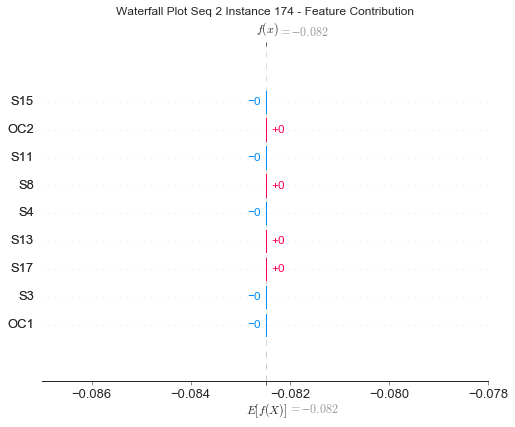

None

Contribution: [ 9.77915874e-19  1.00769392e-17 -5.59224500e-19 -3.65292719e-18
  1.93683927e-18 -3.96849908e-18  6.66339685e-19 -2.36319049e-17
  3.47968879e-19]


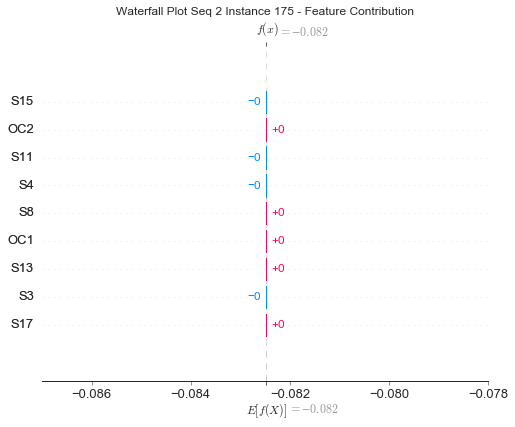

None

Contribution: [-9.24661532e-18 -8.82251651e-18  4.77661359e-18 -1.35860999e-17
  2.04607360e-17 -1.54343796e-17  7.12659277e-18 -3.39794070e-18
  1.36389808e-17]


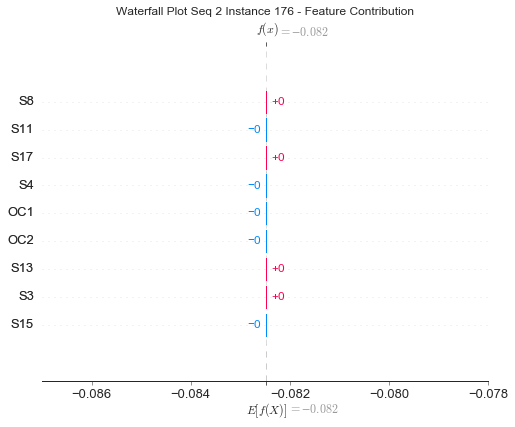

None

Contribution: [-1.22599551e-18  6.90948060e-18 -3.26775985e-18 -7.02425729e-18
  1.37637982e-17 -1.72777483e-17  3.76909034e-19  4.41734196e-19
 -4.97546347e-19]


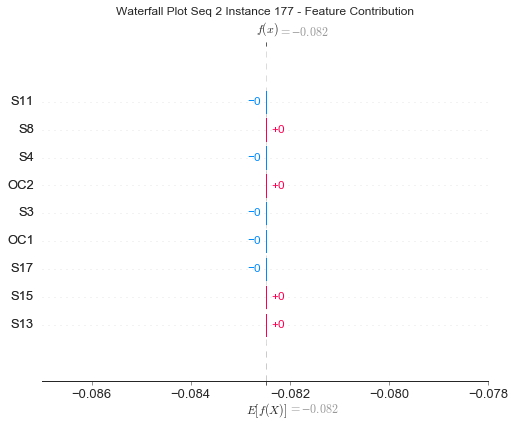

None

Contribution: [ 7.05129700e-18  1.04692081e-17 -4.59900385e-18 -7.63035651e-18
  1.31193385e-17 -2.19287152e-17  2.60827651e-19  9.53932889e-18
 -3.41264942e-18]


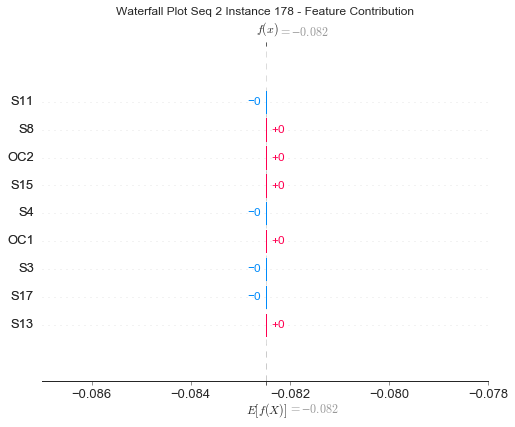

None

Contribution: [ 7.62705916e-19  3.21458619e-18 -1.53766693e-18 -1.06921618e-19
 -1.08157474e-18 -4.50432559e-18  1.43268551e-18 -3.51252031e-18
 -2.64388265e-18]


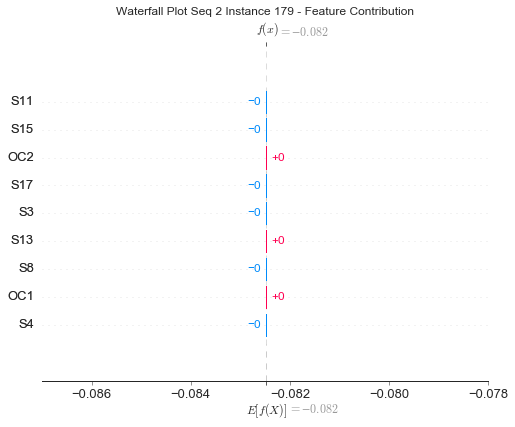

None

Contribution: [-1.63123127e-17 -1.88324028e-17  8.00888594e-18 -3.76462966e-18
  4.95401240e-18  6.54224798e-18  5.15726598e-18  8.37731870e-19
  1.23460685e-17]


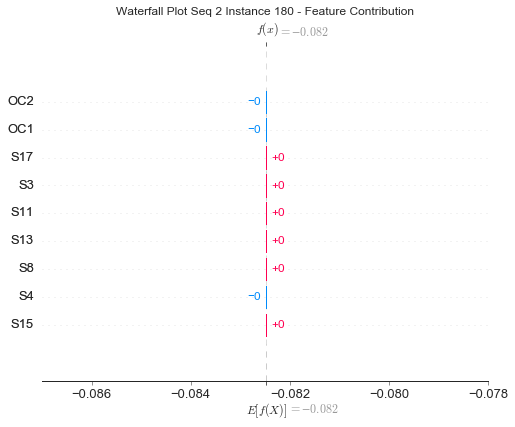

None

Contribution: [ 1.21768133e-17  1.22031549e-17 -5.94676148e-18  9.56886604e-20
  2.73937776e-18 -1.52789077e-17  2.18760708e-19  2.26156705e-17
 -1.20569871e-17]


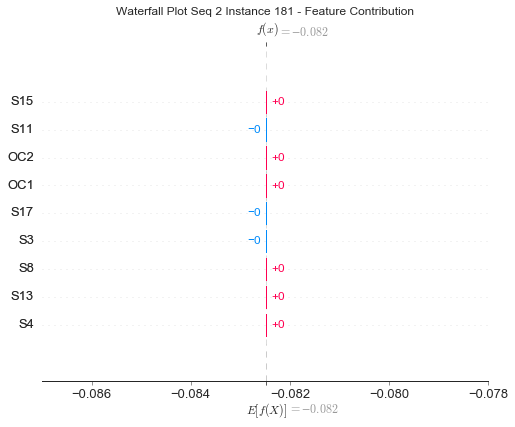

None

Contribution: [-1.18363590e-17 -2.24225288e-17  4.78740003e-18  9.71269354e-18
 -1.42837945e-17  1.82273400e-17 -4.01935771e-19  1.26934406e-19
  1.03557233e-18]


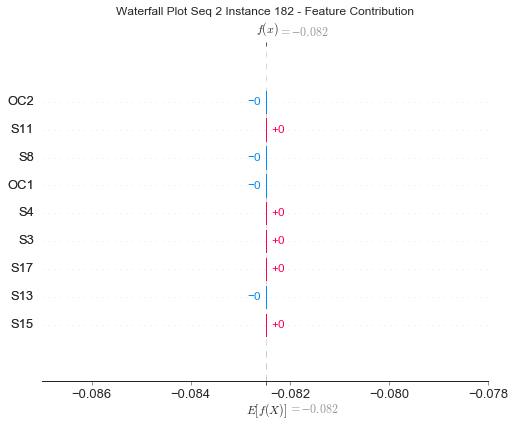

None

Contribution: [-6.35640614e-18 -3.55131757e-18 -7.40881438e-18  2.43314317e-17
 -3.97322906e-17  2.96354792e-17 -1.09230664e-17 -2.83928711e-18
 -1.59211042e-17]


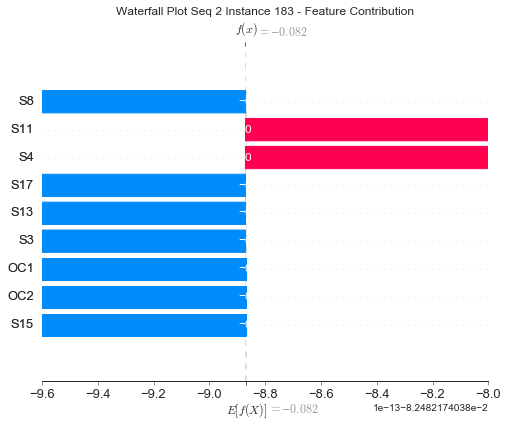

None

Contribution: [-4.70045848e-19 -1.25191734e-17  1.38967915e-18  9.92643205e-18
 -1.73074011e-17  2.90073183e-17 -2.42091508e-18  1.25240406e-17
  1.49332798e-18]


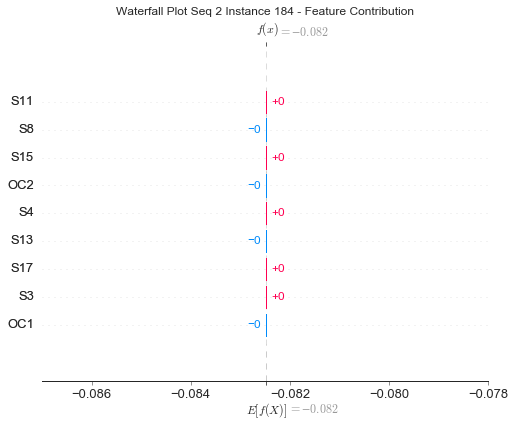

None

Contribution: [-5.39163644e-18 -3.10475096e-17  1.18057475e-17  2.86489352e-19
 -1.78030320e-18  3.56462500e-17 -9.29285099e-19  1.46498898e-17
  2.35862313e-17]


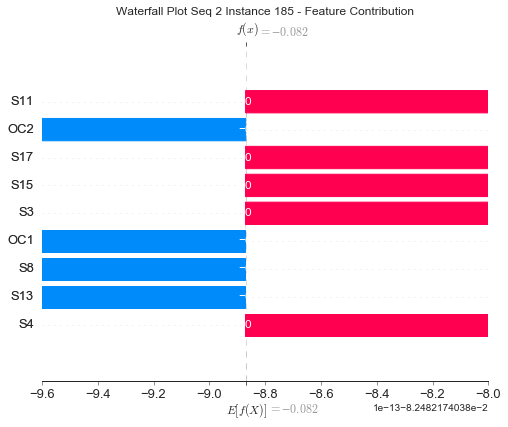

None

Contribution: [-8.45270556e-18 -4.11381833e-17  2.03721118e-17 -2.51659362e-17
  4.44617785e-17  2.43004339e-17  6.44615275e-18  2.30397197e-17
  5.40017882e-17]


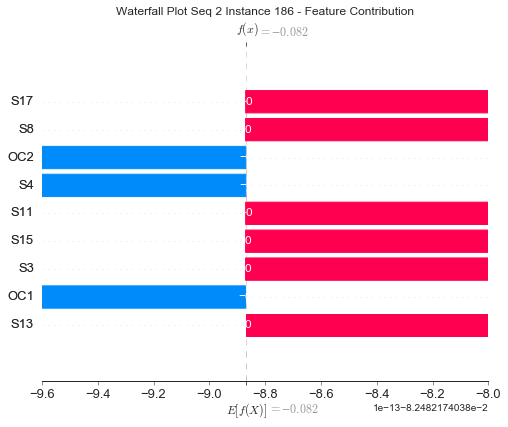

None

Contribution: [ 4.23549495e-17  1.26359556e-17 -5.00986612e-18 -6.31637300e-17
  6.72262455e-17 -3.56741525e-17 -2.93046248e-18  2.94922281e-17
  3.20955375e-17]


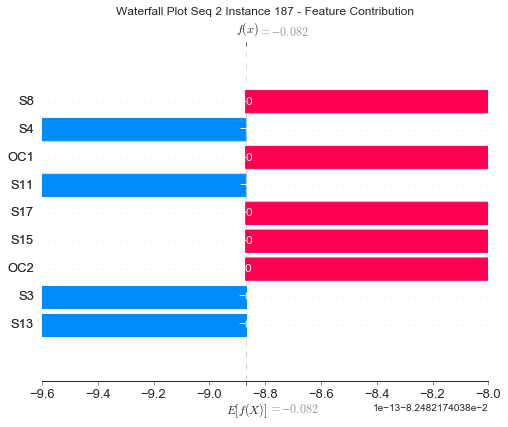

None

Contribution: [ 1.86274615e-16  1.81822610e-16 -4.70047401e-17 -7.89509285e-17
  6.47506859e-17 -1.15063669e-16 -3.09057772e-17 -1.37803302e-17
 -3.08534365e-17]


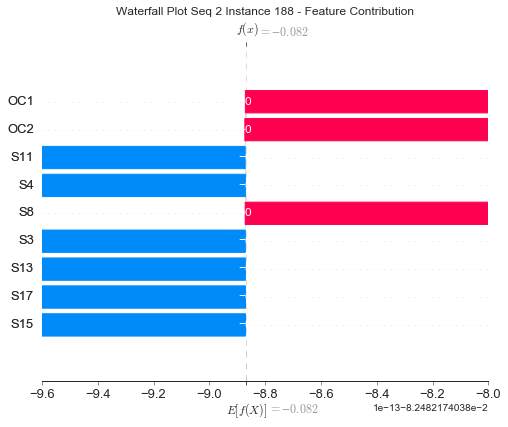

None

Contribution: [ 1.40025134e-16  1.70151026e-16 -3.37670148e-17 -4.17842511e-17
 -1.56484093e-17 -1.80192429e-17 -7.06171699e-18 -2.19971796e-16
 -2.26135182e-17]


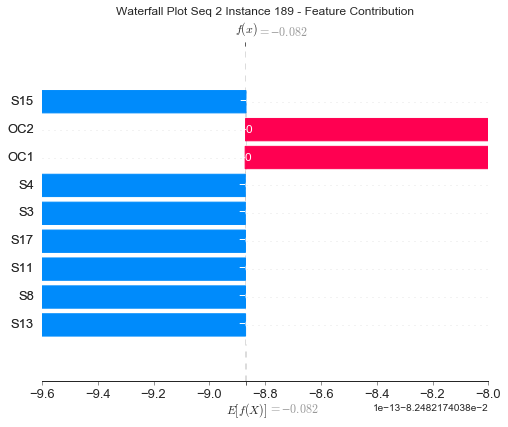

None

Contribution: [ 9.31775947e-17  5.57068886e-17  1.44392019e-17 -2.42951019e-16
  3.27963507e-16 -2.40665460e-16  6.40456898e-17  1.10541249e-17
  1.58083863e-16]


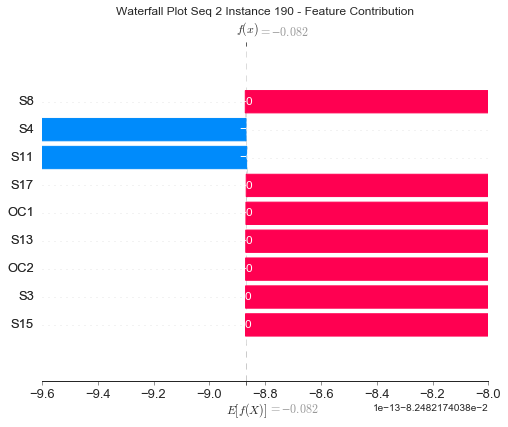

None

Contribution: [ 2.75103913e-16  2.47864737e-16 -5.79895696e-17 -2.79349587e-16
  3.15597462e-16 -3.59547010e-16  3.12638041e-17 -1.71414984e-17
  5.19248865e-17]


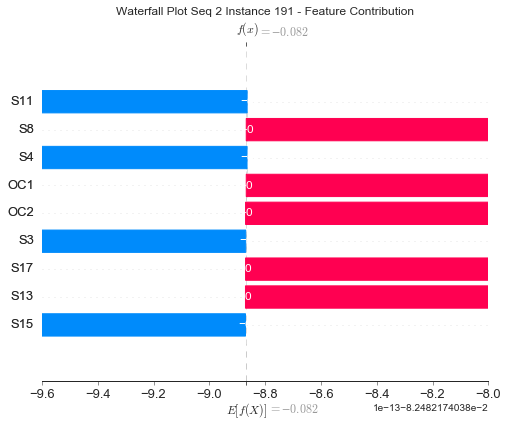

None

Contribution: [ 2.44125377e-16  4.15827876e-16 -6.82933879e-17 -1.63247336e-16
  2.52659605e-16 -2.81670298e-16  4.42689660e-17 -1.97135325e-16
 -1.56490197e-17]


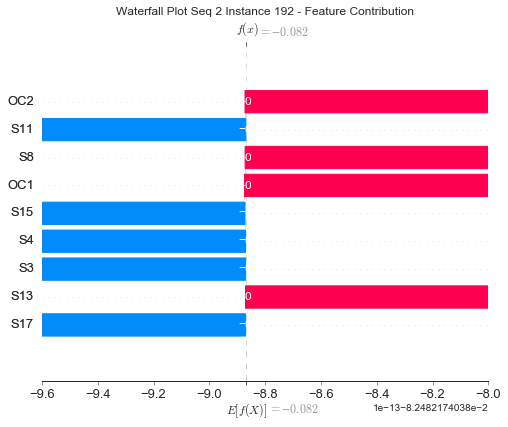

None

Contribution: [-3.02809223e-16  4.50086574e-17  1.06442164e-16 -2.54928515e-16
  5.39877519e-16 -2.88975348e-16  1.17269700e-16 -1.94190218e-16
  2.87304126e-16]


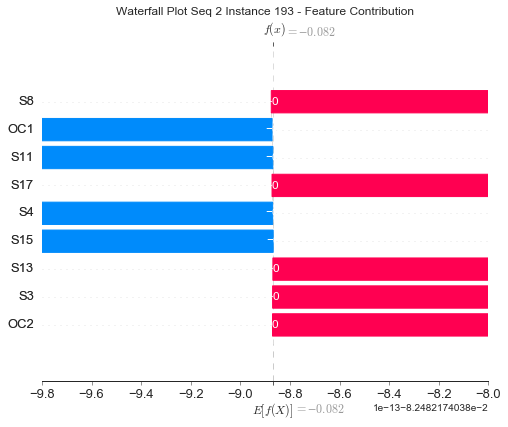

None

Contribution: [-2.51224202e-16  1.50608652e-16  1.92366658e-17 -1.10465114e-16
  1.80373416e-16 -2.12823765e-16  5.41583668e-17 -6.57887208e-16
  8.31244452e-17]


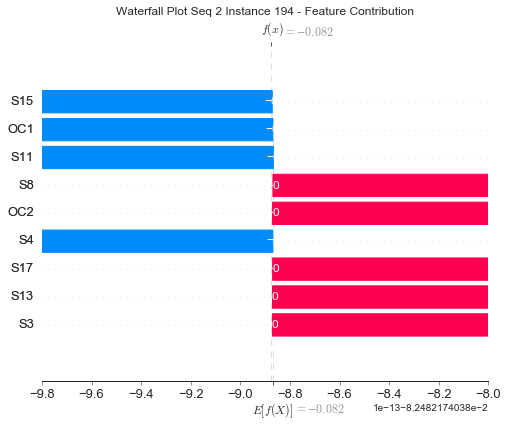

None

Contribution: [ 5.26008784e-16  7.08599917e-16 -3.30926085e-16 -4.44471328e-16
  1.73230136e-16 -9.16729042e-16 -1.10846953e-16 -1.55152309e-16
 -3.34675449e-16]


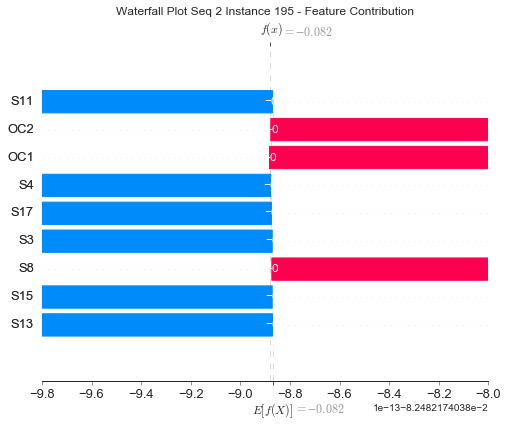

None

Contribution: [-3.47428060e-16 -1.71016468e-16 -1.97251143e-17 -2.00041243e-16
  1.64879476e-16 -2.23782928e-16  2.35796370e-17 -7.42195309e-16
  7.92054487e-17]


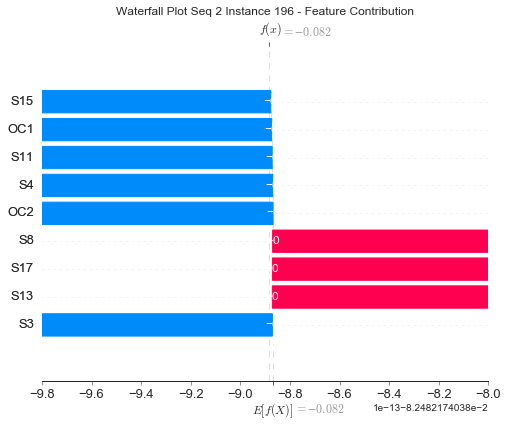

None

Contribution: [-3.07053811e-16 -1.17913657e-16  8.92080806e-17 -4.90812606e-16
  9.65919209e-16 -7.54701591e-16  2.23569397e-16  5.38303043e-16
  3.23260833e-16]


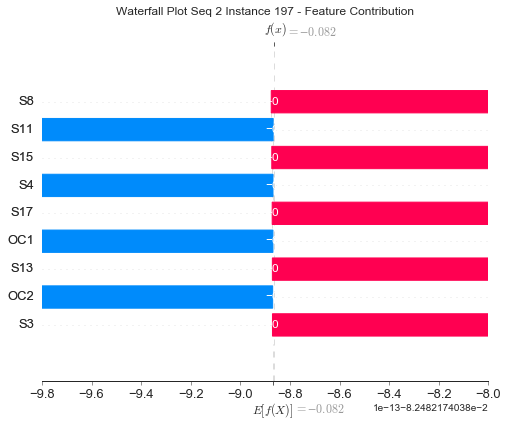

None

Contribution: [-5.95926854e-16 -8.48138961e-16  2.43933604e-16 -7.94689276e-16
  1.14947083e-15 -7.80845263e-16  2.18784547e-16  1.18403708e-15
  6.68263256e-16]


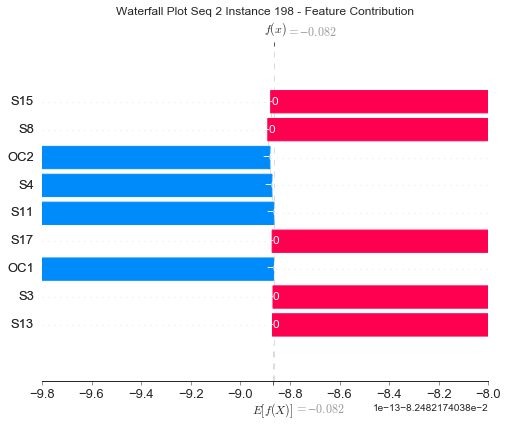

None

Contribution: [-4.38263767e-16 -4.38361811e-16  1.69338099e-16  1.24118530e-16
 -5.29280382e-17  1.47502992e-16  1.10697783e-16 -1.84088039e-16
  1.52492440e-16]


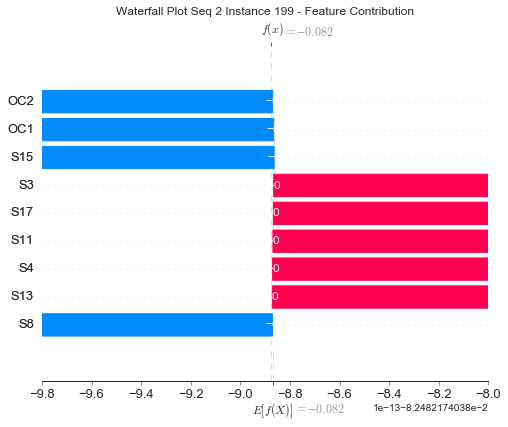

None

Contribution: [-5.40860395e-16 -6.34219519e-16  1.29541023e-16  2.38747724e-16
 -2.85383373e-16  2.99614691e-16  7.10501824e-17  3.15624295e-17
  4.95952647e-17]


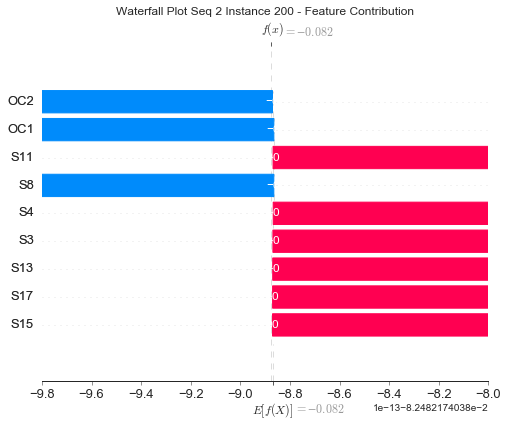

None

Contribution: [-1.21221405e-15 -1.19682251e-15  2.20919282e-16  3.84662066e-16
 -4.66082367e-16  7.16551280e-16  3.57595671e-17  8.21844504e-17
  1.44866510e-16]


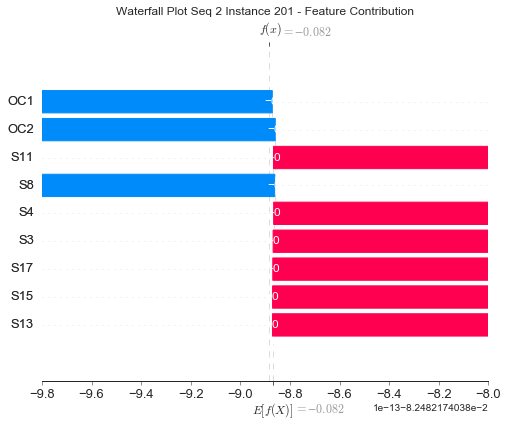

None

Contribution: [-7.08132355e-16  7.02849675e-17 -1.42301429e-16  1.16774630e-15
 -1.38160518e-15  1.22173089e-15 -1.76036091e-16 -3.37529818e-16
 -7.27968438e-16]


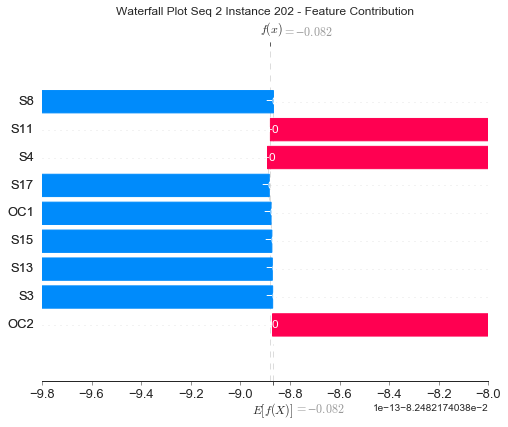

None

Contribution: [-1.09949038e-15 -1.31104098e-15  4.00494515e-17  9.97369860e-16
 -1.54842790e-15  1.58399439e-15 -2.32801156e-16  2.34198866e-16
 -2.04611052e-16]


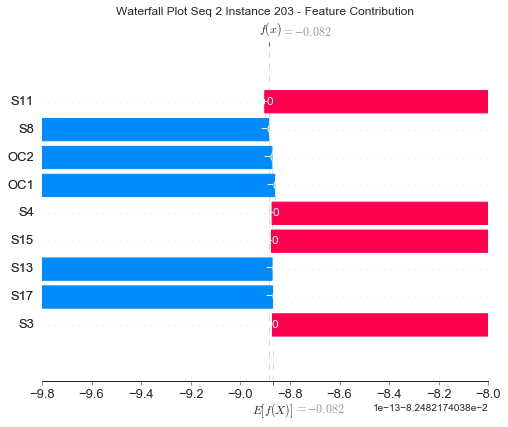

None

Contribution: [-2.55547220e-16 -1.34460721e-15  1.46514770e-16 -3.15639602e-16
  4.48817771e-16 -3.86768690e-16  8.24107273e-17  3.12341515e-15
  3.39447898e-16]


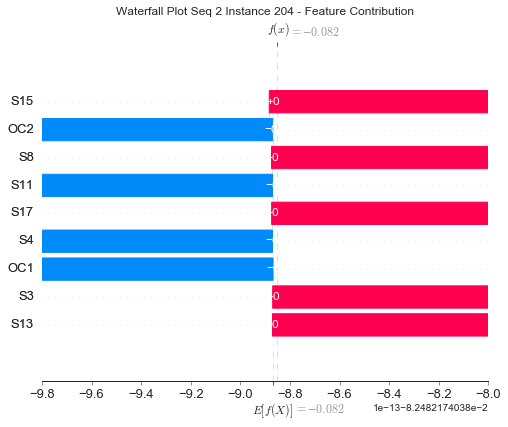

None

Contribution: [-1.20172990e-15 -1.53618001e-15  1.51275237e-17  1.36730504e-15
 -2.08012848e-15  2.42789755e-15 -4.89976584e-16  4.76950118e-16
 -4.25702295e-16]


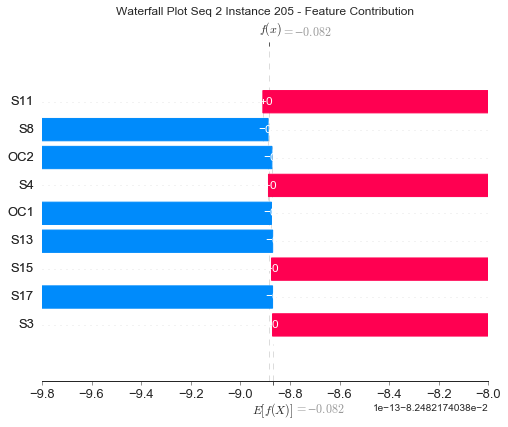

None

Contribution: [-2.32094810e-16 -1.62314245e-15  5.47498751e-16  2.50335611e-16
 -3.72010200e-16  1.85451045e-15  1.02200646e-17  1.06473916e-15
  8.75855096e-16]


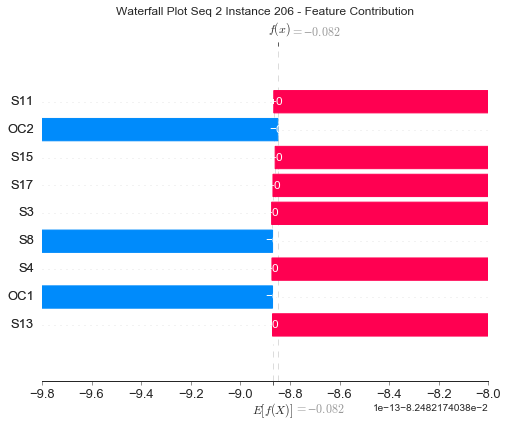

None

Contribution: [-5.60947569e-16 -4.52646678e-16  6.70184445e-17  4.62215397e-16
 -2.87907584e-16  1.76994544e-15 -1.82606592e-16  7.68711847e-17
  3.78112172e-16]


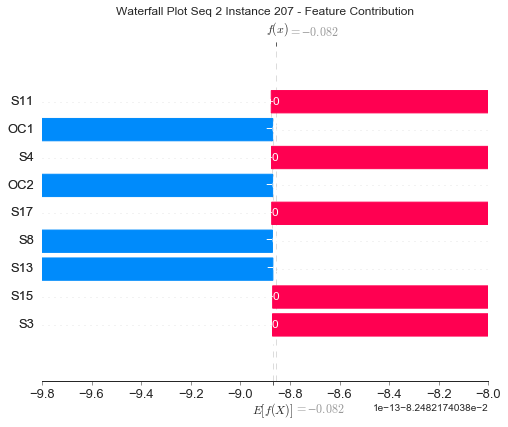

None

Contribution: [ 1.67430859e-16 -1.54162273e-15 -3.07309324e-16 -1.68868967e-15
  4.50387800e-16 -2.28530627e-16 -5.86585668e-16  8.85283685e-16
  7.33836417e-16]


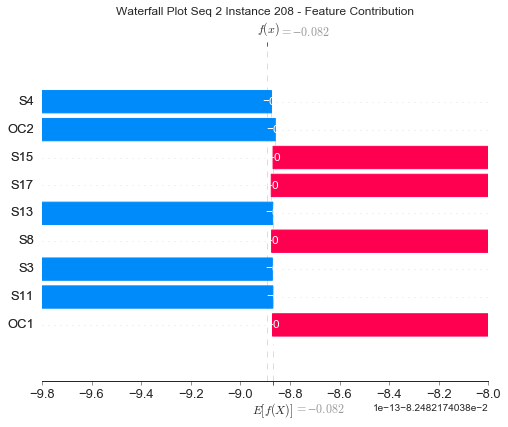

None

Contribution: [ 2.92655410e-15  3.93264904e-15 -1.36002797e-15 -2.84775389e-16
  8.68781643e-17 -1.55705334e-15 -1.03909894e-15 -1.18028419e-15
 -1.40368489e-15]


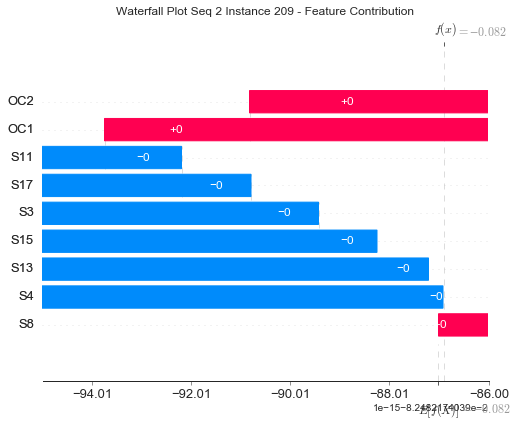

None

Contribution: [ 1.45727699e-15  4.39509133e-15 -6.93887061e-16 -1.70194912e-15
  3.24036456e-15 -2.53099670e-15 -3.06502379e-17 -1.60822493e-15
  5.07078709e-16]


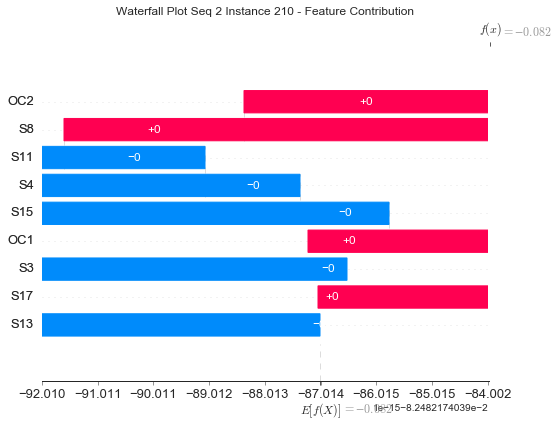

None

Contribution: [ 8.30596696e-16  3.53504542e-15 -2.73745378e-16 -2.74530853e-15
  3.04529838e-15 -1.98074208e-15  2.12115658e-16 -5.06772274e-15
  1.40996607e-15]


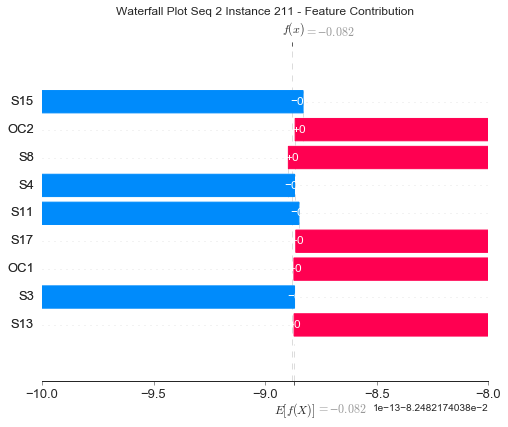

None

Contribution: [ 5.70548688e-16  5.32237726e-15 -2.37257793e-16 -3.99132259e-15
  7.30496630e-15 -5.43952489e-15  1.04308719e-15 -2.78522560e-15
  2.23478018e-15]


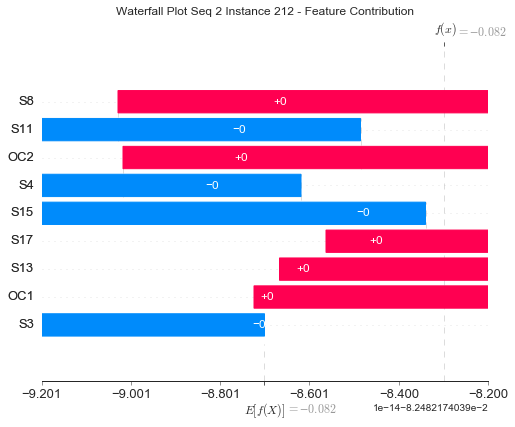

None

Contribution: [ 1.08787925e-15  1.58462987e-15 -2.50371822e-16 -9.86406035e-15
  1.14268421e-14 -1.07862954e-14  1.75431958e-15 -4.77247003e-16
  4.66618169e-15]


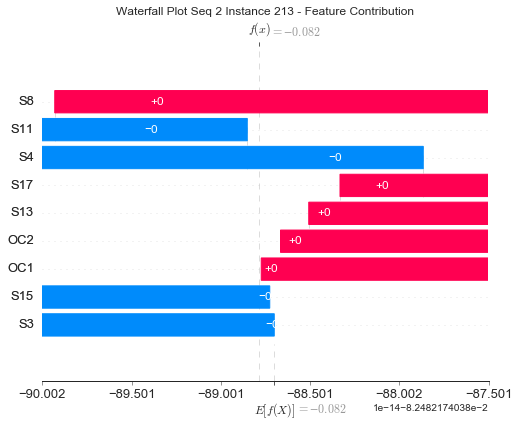

None

Contribution: [-4.66289139e-15  5.90544806e-15 -8.56670647e-16 -3.90979693e-15
  8.22395723e-15 -8.53908653e-15  9.14721785e-16 -6.06982243e-15
  1.05408401e-15]


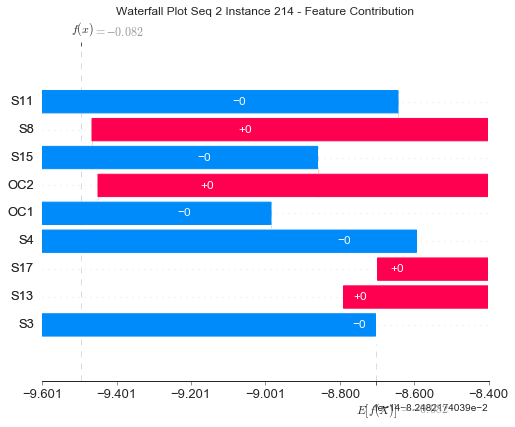

None

Contribution: [-1.06545776e-14  1.39650957e-15  1.18629651e-16 -3.95090175e-15
  9.47342993e-15 -9.54352953e-15  2.63002735e-15 -7.78634105e-15
  2.50621675e-15]


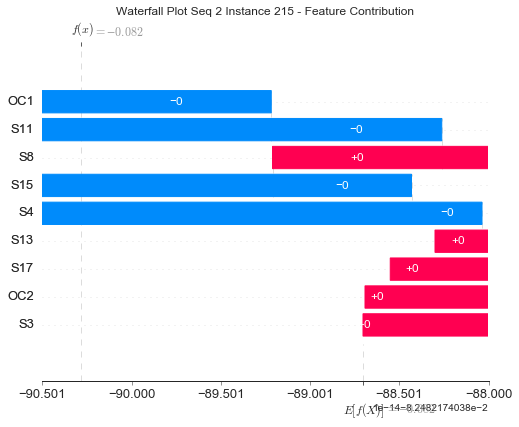

None

Contribution: [-1.63971060e-14 -3.66889356e-15  1.53804857e-15 -2.25882469e-15
  8.75718142e-15 -8.33378776e-15  2.59636859e-15 -8.97772338e-15
  3.58673137e-15]


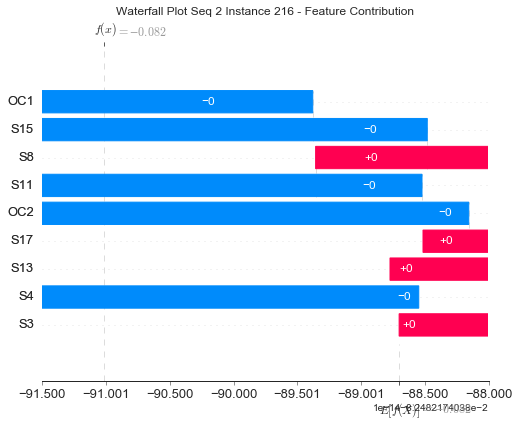

None

Contribution: [-3.57285062e-15 -4.63017643e-15 -1.97765168e-15 -7.11513351e-15
  5.12933464e-15 -1.55768004e-14  2.77928472e-15 -6.77701638e-16
  3.70347607e-16]


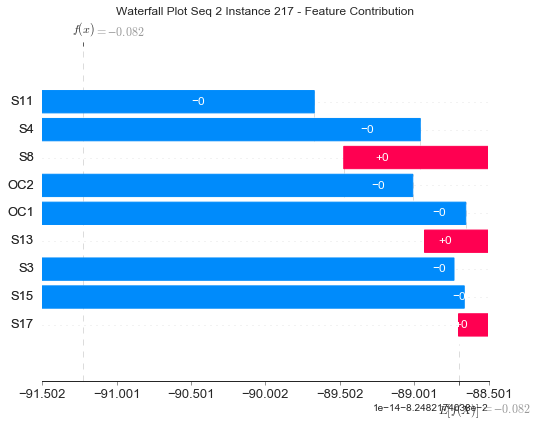

None

Contribution: [-2.18713055e-14 -2.42869943e-14  4.59463366e-15 -7.35775678e-15
  1.60000085e-14 -9.03130754e-15  3.03036837e-15  1.80809567e-14
  1.07902053e-14]


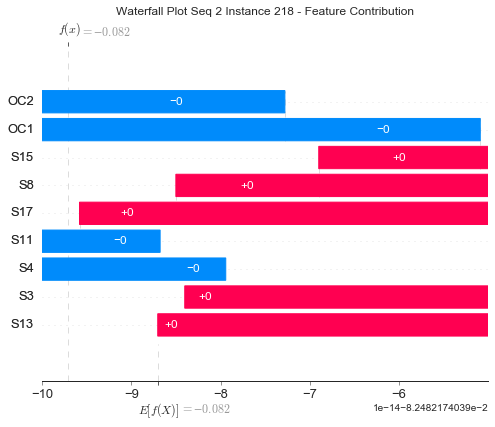

None

Contribution: [-2.35495319e-14 -2.47598318e-14  5.49919412e-15 -1.64824046e-15
  1.41164554e-14 -1.04248258e-14  2.25297847e-15  2.27190228e-14
  7.50410713e-15]


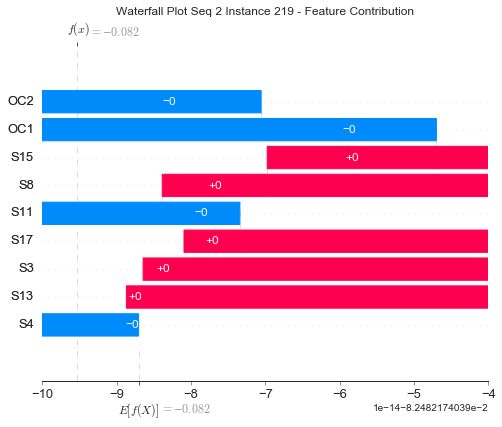

None

Contribution: [-4.68879323e-15 -5.54957691e-15 -6.42670325e-15  2.52967000e-14
 -4.40914056e-14  2.20331735e-14 -9.09125460e-15 -1.82966096e-14
 -2.41185618e-14]


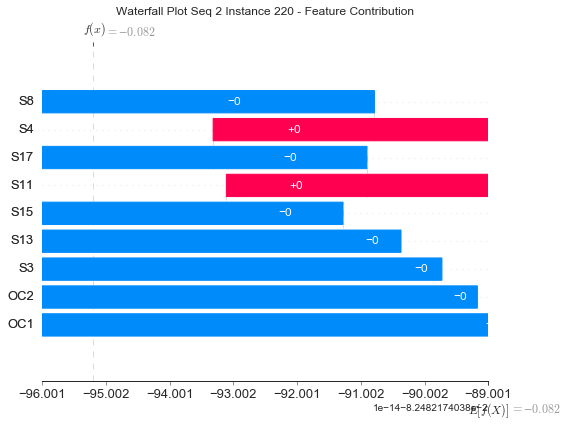

None

Contribution: [-2.80268972e-14 -4.99400360e-14  4.81692602e-15  1.56665046e-14
 -3.29744031e-14  2.21292575e-14 -1.94032802e-15  1.33655489e-14
 -2.65671270e-15]


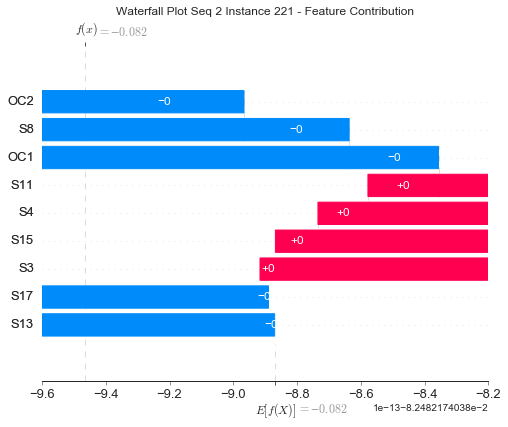

None

Contribution: [-2.52986854e-14 -2.15038236e-14 -8.83711676e-15  5.46947843e-14
 -7.27985922e-14  5.09693301e-14 -1.66984024e-14 -9.56122850e-16
 -3.82894976e-14]


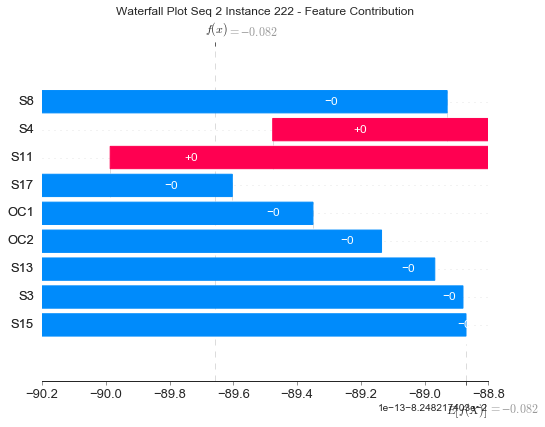

None

Contribution: [-6.69021655e-14 -6.86986614e-14  7.57581609e-15  6.76397889e-14
 -7.97600782e-14  7.53294386e-14 -1.23900820e-14  7.44520785e-16
 -1.63880174e-14]


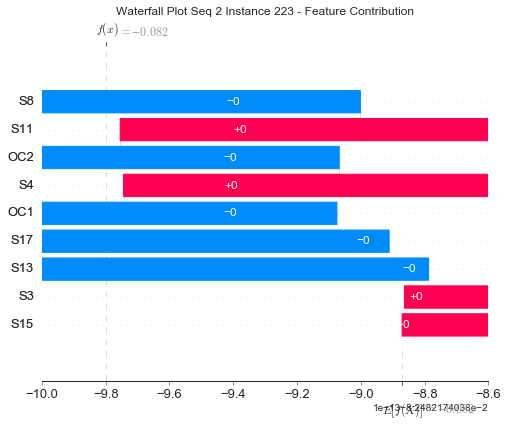

None

Contribution: [-3.67546603e-14 -8.69443338e-14  4.62654647e-15  6.63735763e-14
 -1.00811490e-13  8.79842667e-14 -1.39503269e-14  3.28970046e-14
 -1.72887793e-14]


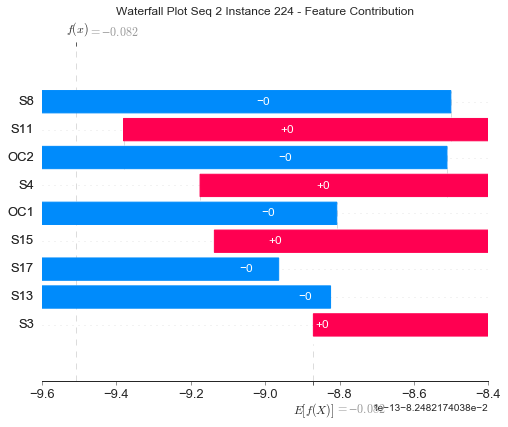

None

Contribution: [-4.66248676e-14 -1.07567059e-13  1.05140955e-14  2.11334890e-14
  3.31146790e-15  1.54056286e-14  1.02160125e-15  1.80935467e-13
  9.15483628e-15]


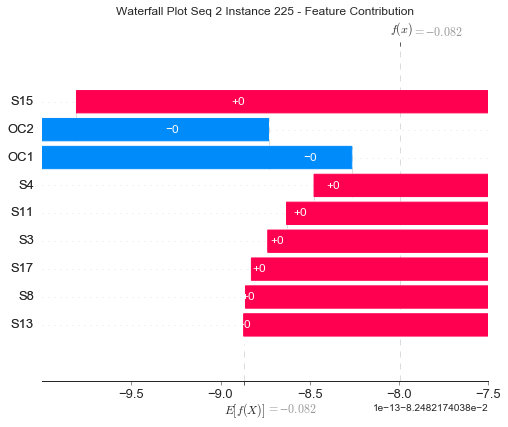

None

Contribution: [-7.78105268e-14 -1.23290294e-13  1.58206019e-14  1.02328275e-13
 -1.32497122e-13  1.54552247e-13 -2.73909838e-14  2.65034458e-14
 -1.65231039e-14]


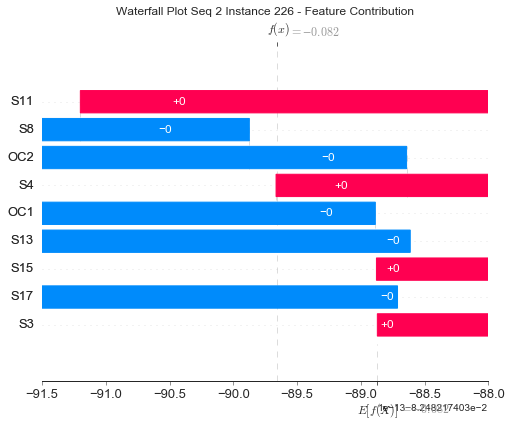

None

Contribution: [-2.56073035e-14 -8.76478862e-14  9.04907003e-16  6.87077009e-14
 -7.70242838e-14  7.69469463e-14 -2.54363604e-14  1.21223290e-13
 -2.06705313e-14]


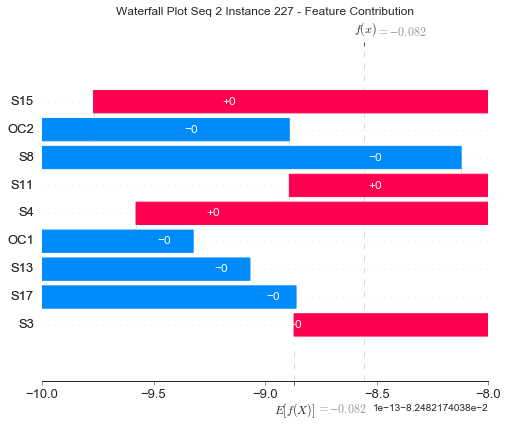

None

Contribution: [-3.28108478e-14 -9.54672268e-14  4.06032909e-15  9.51621797e-14
 -1.27537520e-13  1.32658777e-13 -3.94950491e-14  3.95594371e-14
 -2.33183715e-14]


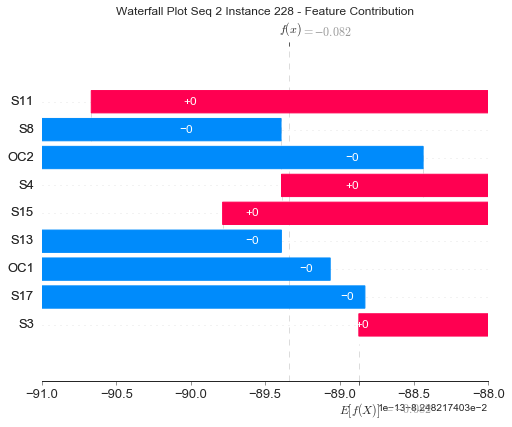

None

Contribution: [-3.72720823e-14 -6.63854415e-14 -4.68955821e-16  1.12351196e-13
 -1.36355635e-13  1.38808507e-13 -4.51009774e-14  1.89178320e-14
 -3.99700855e-14]


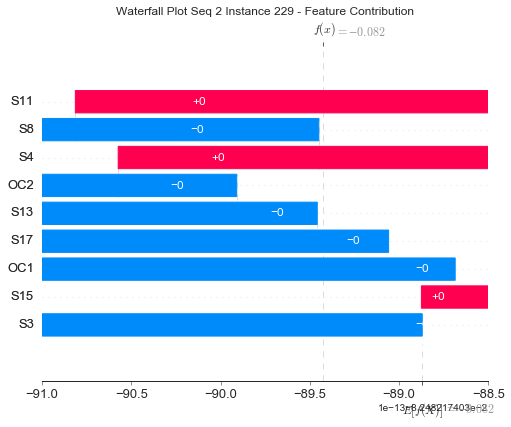

None

Contribution: [-8.49082022e-14 -1.32902492e-13  1.55918793e-14  6.56773626e-14
 -6.62036479e-14  9.99472654e-14 -2.22191379e-14  2.73739907e-14
  6.31251516e-15]


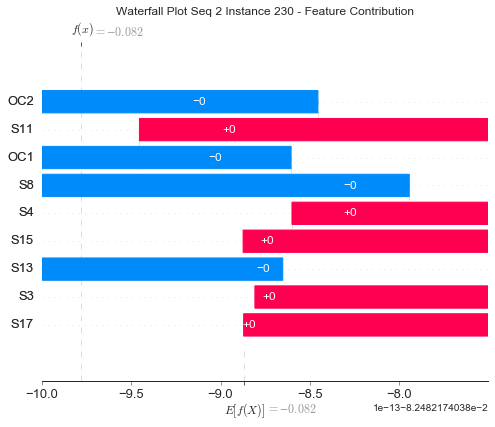

None

Contribution: [-6.08861309e-14 -9.40639914e-14  1.56600908e-14  4.12989718e-14
 -1.42087744e-14  4.04142729e-14 -1.75279289e-14  4.87561516e-14
  1.56784850e-14]


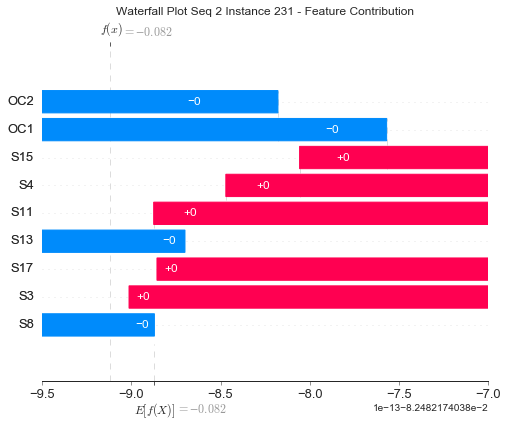

None

Contribution: [-5.08927007e-14 -8.35384618e-14  2.33299703e-15  9.06072414e-15
  3.16029687e-14 -3.12191984e-14 -5.03812444e-15  4.52313934e-14
  3.41759752e-15]


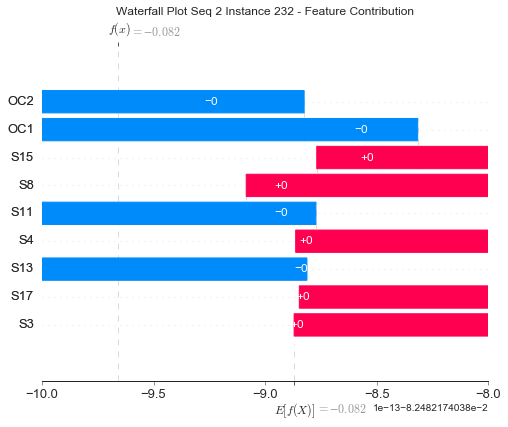

None

Contribution: [-1.42949075e-13 -9.80903862e-14  2.45043244e-14  4.13047079e-14
  1.79517097e-14 -1.88177475e-15 -1.12392895e-14 -2.99380848e-14
  2.34371594e-14]


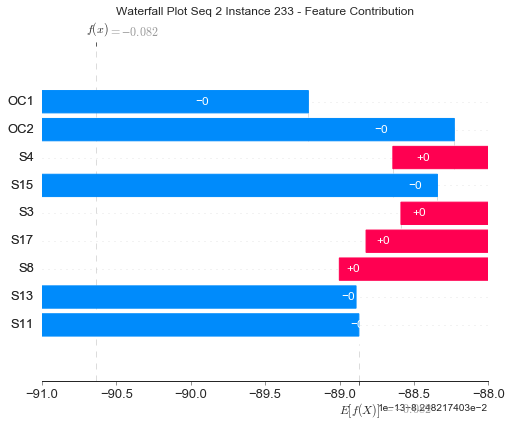

None

Contribution: [-3.66565312e-13 -2.09355536e-13  6.14259078e-14  9.61819193e-14
 -9.20138667e-15  4.55698508e-14 -9.34205597e-15 -8.25201994e-14
  4.86152188e-14]


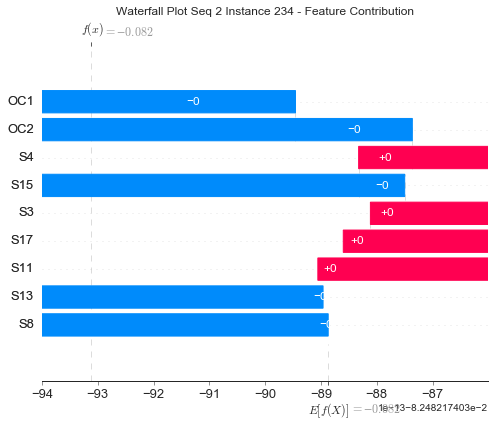

None

Contribution: [-2.11243742e-13 -1.35122111e-13 -1.95630306e-14  5.45676649e-14
 -5.12493456e-14 -1.22866927e-13 -2.99783053e-14 -4.32893230e-14
 -9.49781093e-14]


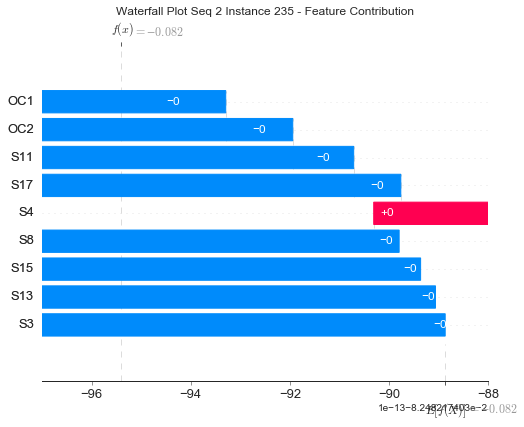

None

Contribution: [-5.88250856e-13 -5.43425656e-13  7.02892741e-14  1.78644236e-13
 -1.70075596e-13  4.48399998e-14 -4.51439931e-14 -1.03540820e-13
  2.42491324e-15]


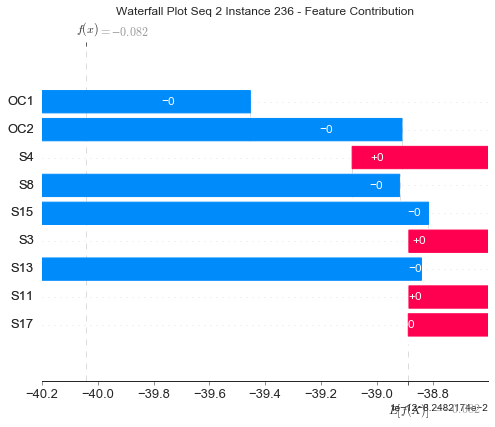

None

Contribution: [-7.97237168e-13 -5.96976299e-13  7.61252565e-14  3.99847039e-13
 -4.56367962e-13  2.34613679e-13 -9.38940698e-14 -1.16865176e-13
 -1.32353235e-13]


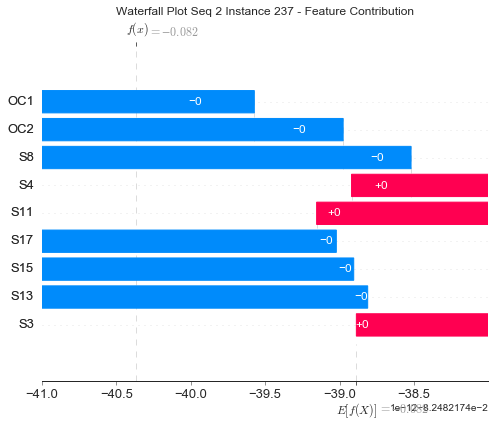

None

Contribution: [-1.21380369e-12 -1.35234651e-12  2.67265864e-13  5.65251784e-13
 -6.42679757e-13  6.20119461e-13 -4.44574941e-15  3.98381550e-14
  6.31259368e-14]


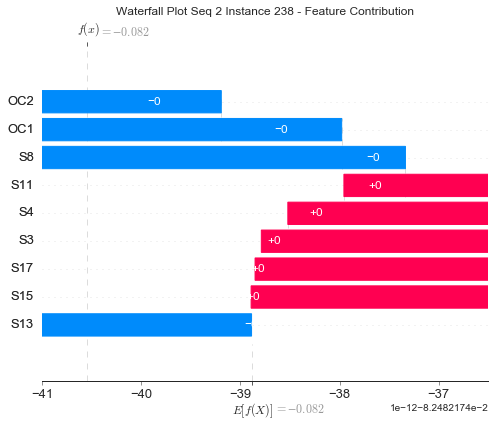

None

Contribution: [-1.33454955e-12 -1.67859867e-12  2.05145701e-13  6.07349891e-13
 -5.13150232e-13  4.36750489e-13 -9.88082568e-14  1.06249308e-12
  3.06686303e-14]


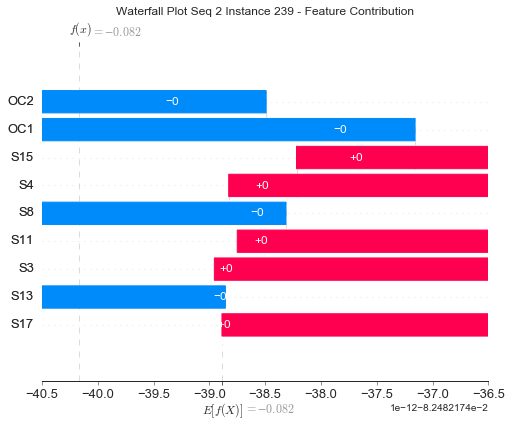

None

Contribution: [-1.08805890e-12 -1.94670148e-12  1.65258567e-13  7.28216532e-13
 -5.02110560e-13  4.56091057e-13 -6.77615245e-14  1.89584958e-12
 -4.20862143e-14]


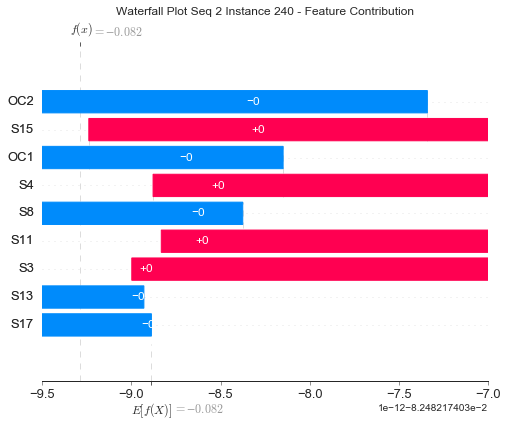

None

Contribution: [-8.63712151e-13 -1.73034774e-12  3.09351035e-14  1.57031755e-12
 -1.97926636e-12  1.56551876e-12 -5.16709722e-13  1.23670182e-12
 -6.97574214e-13]


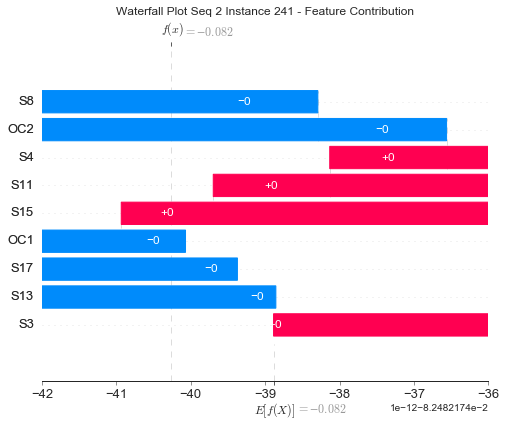

None

Contribution: [-1.56544352e-12 -2.18395831e-12  2.85025394e-13  2.14017497e-12
 -2.27747053e-12  2.50886876e-12 -3.29397181e-13  1.59262371e-12
 -6.09150588e-13]


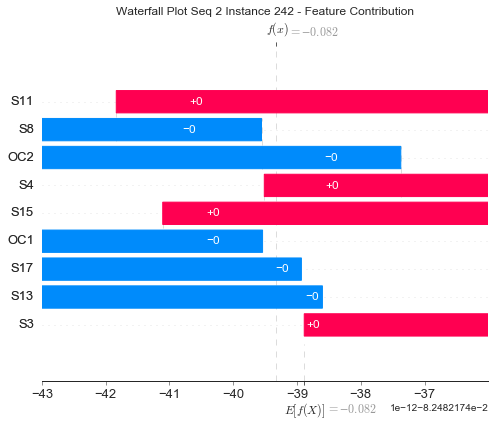

None

Contribution: [-6.38994933e-13 -1.34143272e-12 -1.31083710e-14  2.79533579e-12
 -2.88135639e-12  2.60089476e-12 -5.95471589e-13  2.02583740e-12
 -1.28411572e-12]


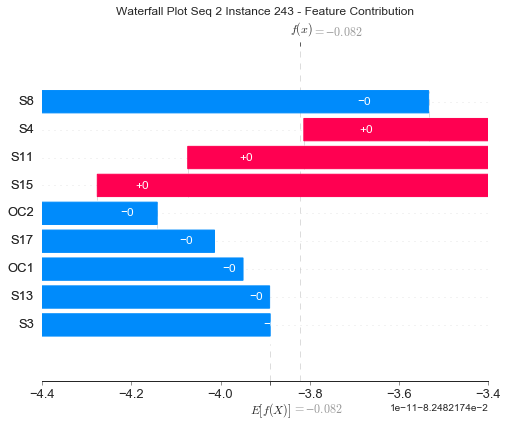

None

Contribution: [-1.36217892e-12 -2.93702931e-12  3.94899147e-13  3.14107486e-12
 -3.93941086e-12  3.93734177e-12 -6.68365808e-13  1.29683070e-12
 -8.76386583e-13]


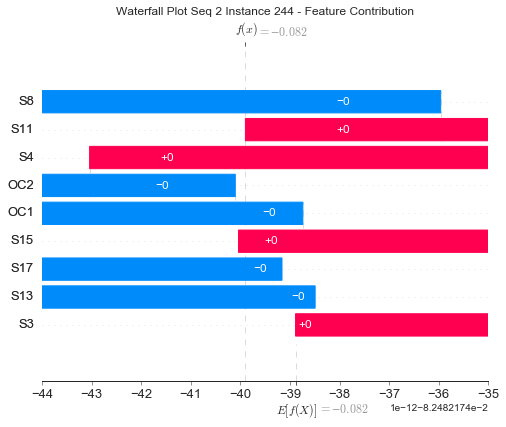

None

Contribution: [-3.49106681e-12 -5.43258884e-12  1.31655223e-12  2.86011601e-12
 -3.47715563e-12  4.84522101e-12 -5.47889587e-13  1.72750746e-12
  4.82115324e-13]


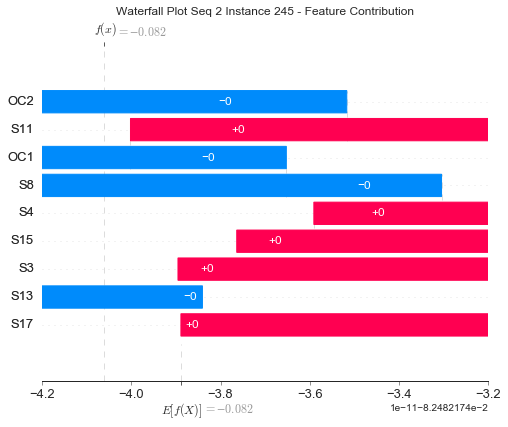

None

Contribution: [-6.12422819e-13 -2.29937055e-12 -3.21388369e-13  4.58383418e-12
 -6.36461587e-12  4.59663384e-12 -1.64851021e-12  1.16543331e-12
 -2.72248803e-12]


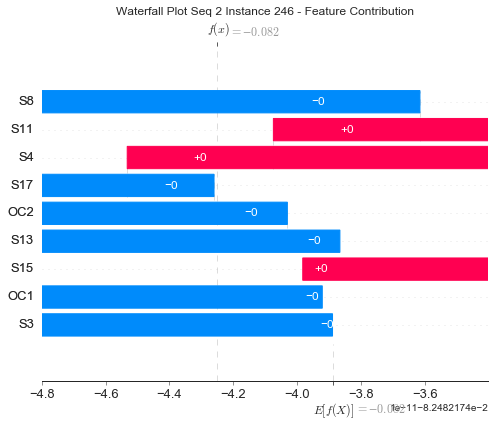

None

Contribution: [-1.55920551e-13 -1.09058910e-12 -9.26138289e-13  6.78801590e-12
 -8.40573965e-12  5.98792673e-12 -1.82051986e-12  1.11903781e-12
 -4.29106056e-12]


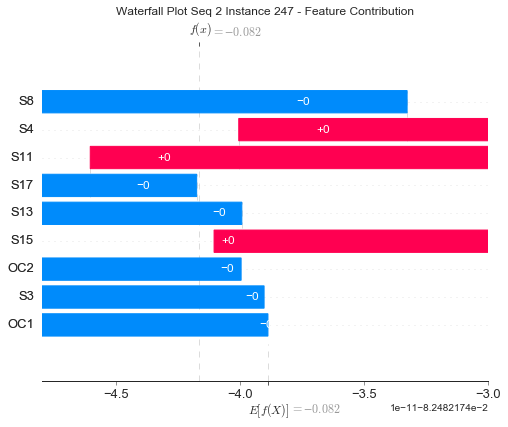

None

Contribution: [-1.38526115e-12 -3.50624694e-12  5.58979349e-13  4.61379676e-12
 -4.41899815e-12  4.57438471e-12 -8.95511963e-13  6.71236721e-12
 -1.45361240e-12]


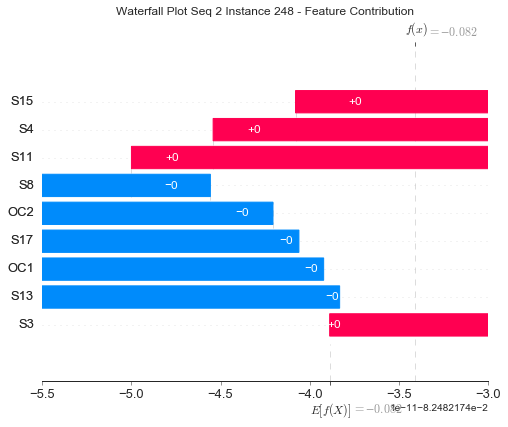

None

Contribution: [-4.11550958e-12 -8.36020662e-12  1.58834230e-12  5.14297199e-12
 -6.56823641e-12  8.01106924e-12 -1.34143337e-12  3.16266414e-12
 -1.39274334e-13]


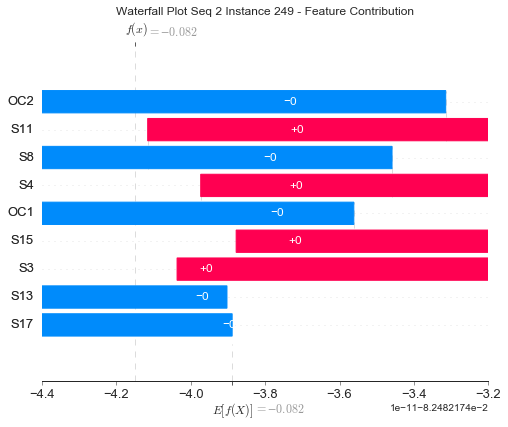

None

Contribution: [-1.16727591e-12 -4.26102122e-12  5.96569669e-13  5.09647879e-12
 -5.41445101e-12  5.69316989e-12 -1.21206994e-12  6.75561733e-12
 -1.49714735e-12]


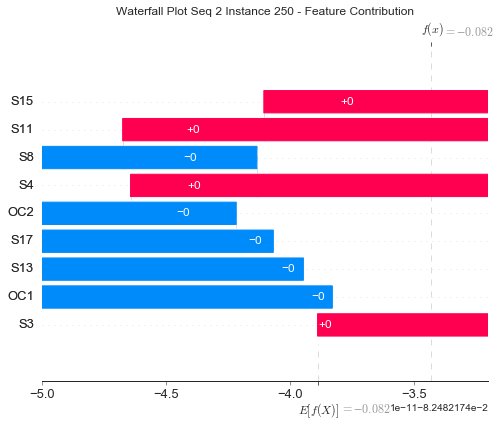

None

Contribution: [-1.43726871e-12 -4.14176289e-12 -2.46662798e-13  8.02559321e-12
 -1.02918360e-11  8.66819030e-12 -2.71163864e-12  2.23869100e-12
 -4.17172156e-12]


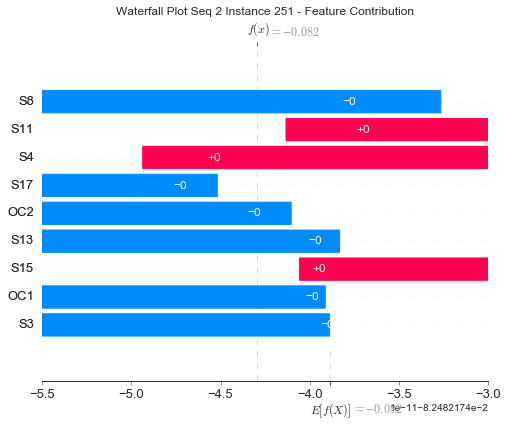

None

Contribution: [-8.68936054e-13 -4.62818759e-12 -1.13916933e-13  7.94031420e-12
 -9.99328485e-12  7.97146203e-12 -2.53510667e-12  2.86630702e-12
 -4.19675319e-12]


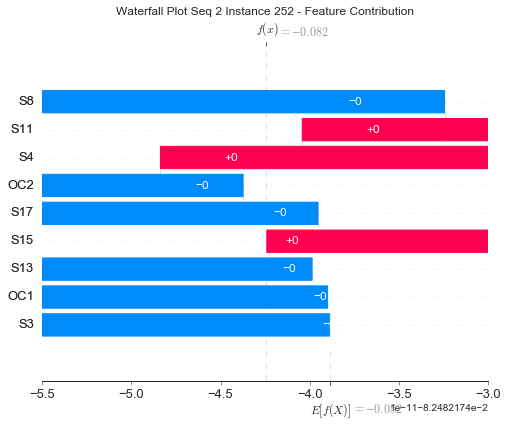

None

Contribution: [-4.38291417e-12 -7.38571877e-12  9.61110640e-13  8.52944278e-12
 -9.66533537e-12  9.70185043e-12 -1.98037138e-12  2.84234051e-12
 -2.78534097e-12]


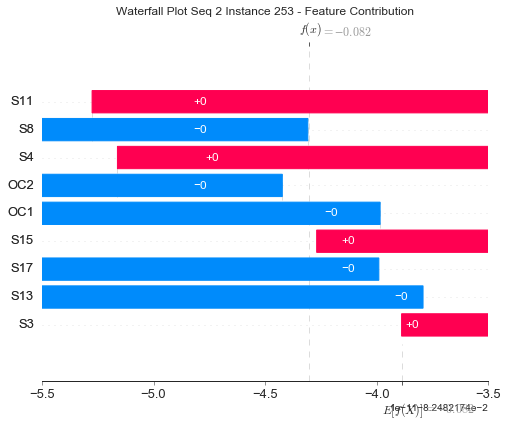

None

Contribution: [-8.85145473e-13 -3.43739100e-12  2.14205376e-13  8.89927628e-12
 -8.74764757e-12  7.26319612e-12 -1.66807301e-12  6.49563433e-12
 -4.21174901e-12]


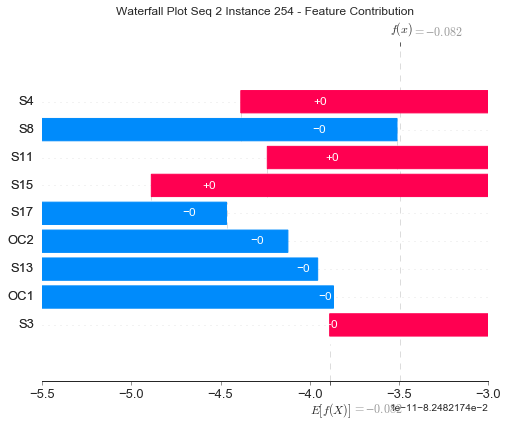

None

Contribution: [-5.00219571e-12 -1.04379248e-11  2.73349507e-12  9.50826397e-12
 -1.02797493e-11  1.17235206e-11 -1.53782163e-12  4.39646279e-12
 -1.35358944e-12]


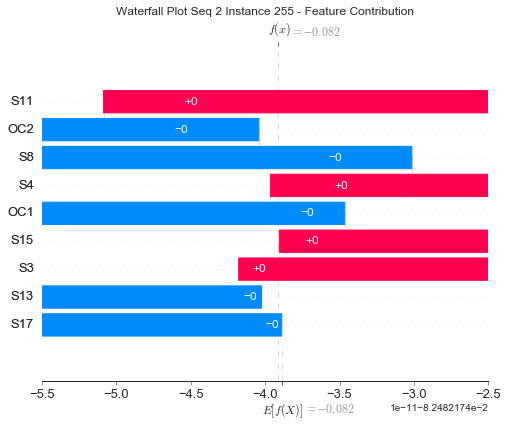

None

Contribution: [-5.26035292e-12 -7.91666125e-12  1.22310853e-12  1.35765140e-11
 -1.39287835e-11  1.38459001e-11 -2.09011562e-12  4.26688416e-12
 -5.15730384e-12]


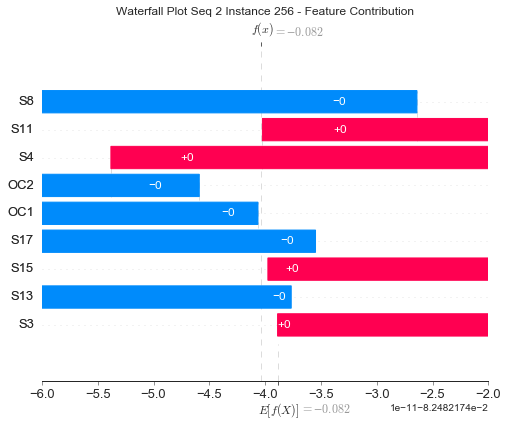

None

Contribution: [-1.04230704e-11 -1.79920315e-11  4.19107891e-12  1.12436848e-11
 -1.30607660e-11  1.58473443e-11 -1.46721882e-12  7.06310748e-12
 -5.43149727e-13]


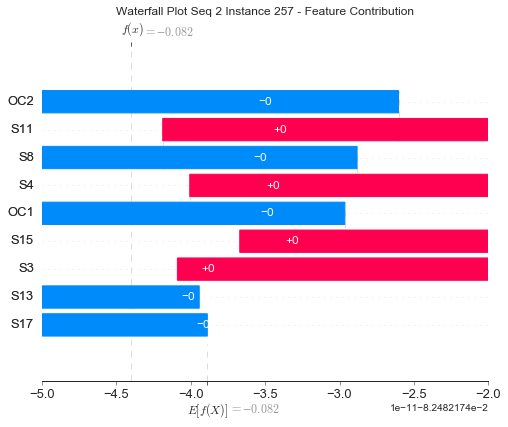

None

Contribution: [-8.11450820e-12 -1.32690473e-11  2.49303920e-12  1.66666507e-11
 -1.88251428e-11  1.83925965e-11 -3.20309751e-12  5.37648441e-12
 -6.26914536e-12]


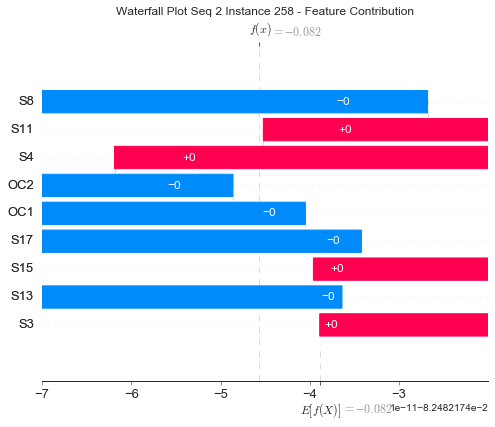

None

Contribution: [-7.80447495e-12 -1.59474725e-11  7.95764442e-13  1.95384230e-11
 -2.60001656e-11  2.05762820e-11 -5.14509008e-12  6.40905775e-12
 -1.02063557e-11]


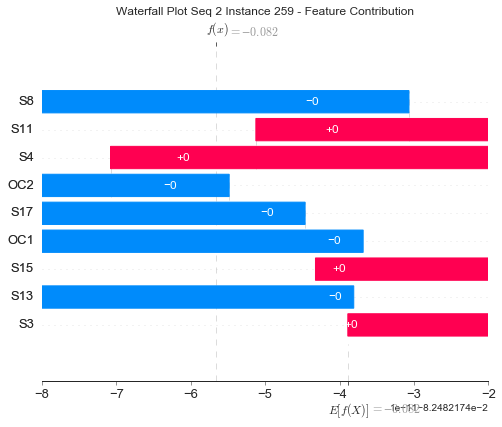

None

Contribution: [-8.50943274e-12 -2.02206567e-11  1.77423191e-12  2.55263987e-11
 -3.14888289e-11  2.72833995e-11 -4.78029855e-12  8.56546084e-12
 -1.11617703e-11]


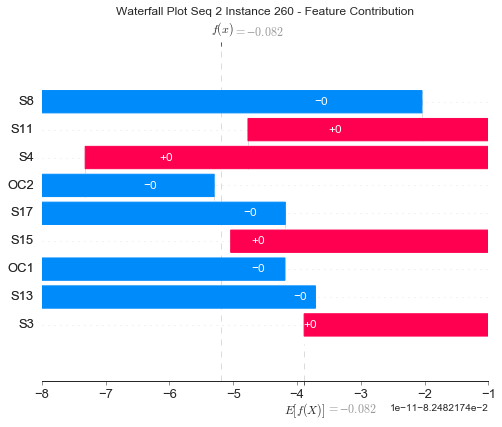

None

Contribution: [-6.67234714e-12 -1.87484802e-11  3.66258109e-12  2.13721315e-11
 -1.95039315e-11  2.14500674e-11 -1.44581862e-12  3.26697940e-11
 -6.30045408e-12]


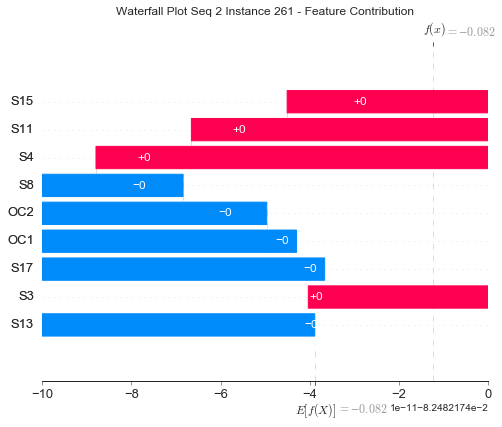

None

Contribution: [-1.99147417e-11 -3.56937327e-11  8.97403679e-12  3.25739678e-11
 -3.83642111e-11  4.85456328e-11 -4.40577002e-12  1.45372846e-11
 -5.08359847e-12]


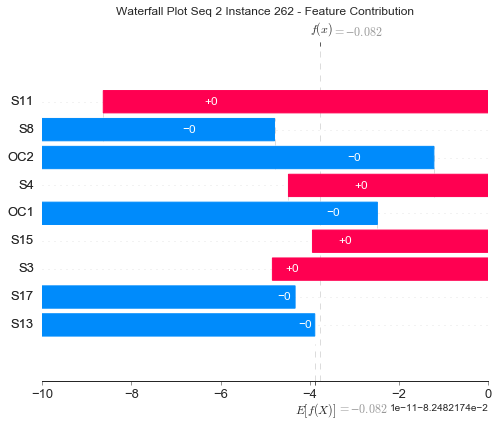

None

Contribution: [-2.08286964e-11 -4.05424028e-11  1.19410974e-11  4.15792886e-11
 -4.40947313e-11  5.89353011e-11 -4.46473674e-12  1.62428092e-11
 -4.75436097e-12]


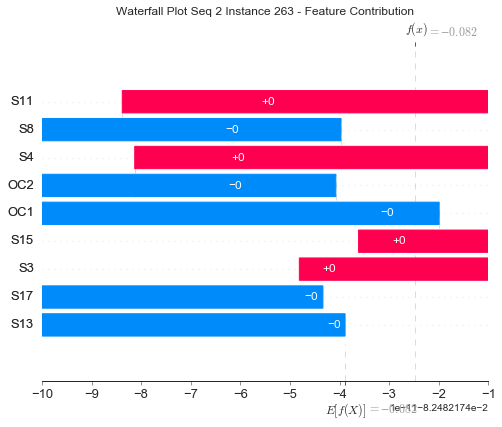

None

Contribution: [ 4.95110463e-12 -3.85033810e-11  6.59353475e-12  3.22813304e-11
 -4.58772083e-11  5.64773471e-11 -4.03092794e-12  3.13060793e-11
 -7.96503922e-12]


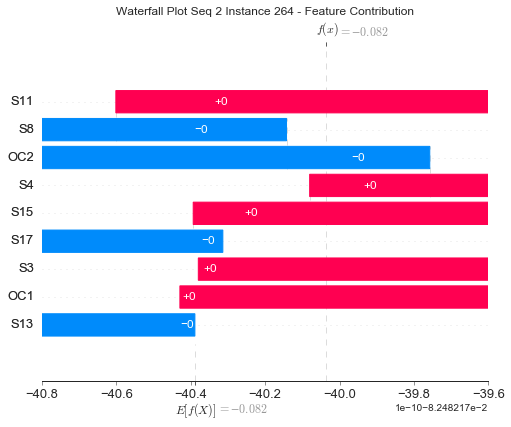

None

Contribution: [-2.52275983e-13 -3.00860517e-11  1.50371625e-11  2.89957867e-11
 -1.28717228e-11  4.88022782e-11  5.24916612e-12  6.81096290e-11
  6.23717224e-12]


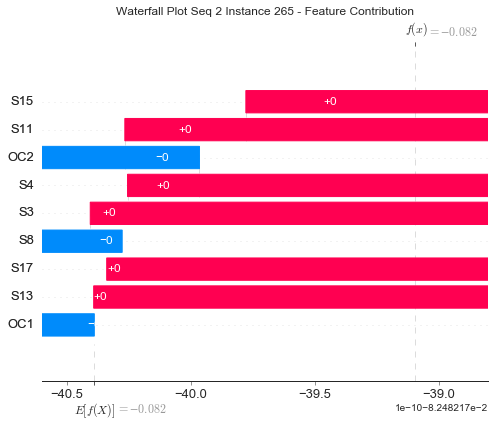

None

Contribution: [ 1.23402254e-12 -4.09406606e-11  1.51271808e-11  3.80520893e-11
 -3.83164785e-11  7.61835039e-11 -3.24512812e-12  2.95636363e-11
  7.48151974e-13]


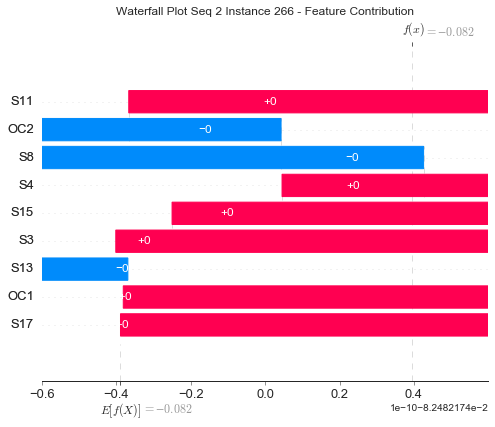

None

Contribution: [ 6.54305984e-11  5.37585809e-11 -1.52210761e-11  3.56158852e-11
 -4.59981393e-11  4.98987934e-11 -1.18685695e-11  1.96036781e-11
 -4.04026083e-11]


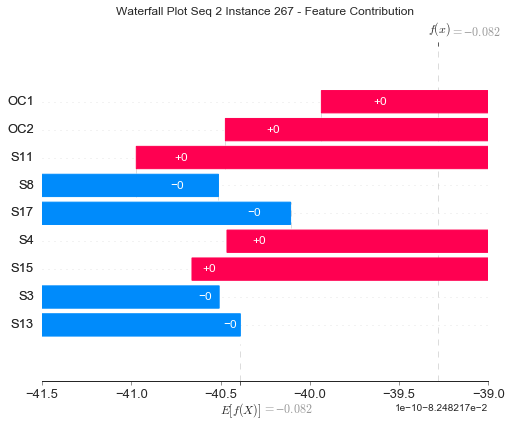

None

Contribution: [ 7.03258562e-11  3.23256005e-11 -3.45059376e-12  9.37954315e-12
 -3.55840010e-11  4.09339160e-11 -4.94931049e-12  2.04747903e-11
 -1.05697508e-11]


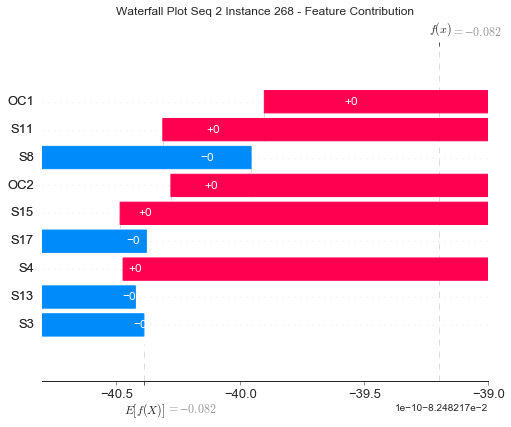

None

Contribution: [ 1.21734955e-10  8.37249714e-11 -2.13393192e-11 -1.99593102e-11
  6.21446991e-12 -9.19814312e-12 -8.27890707e-12  3.45129168e-11
 -2.50661974e-11]


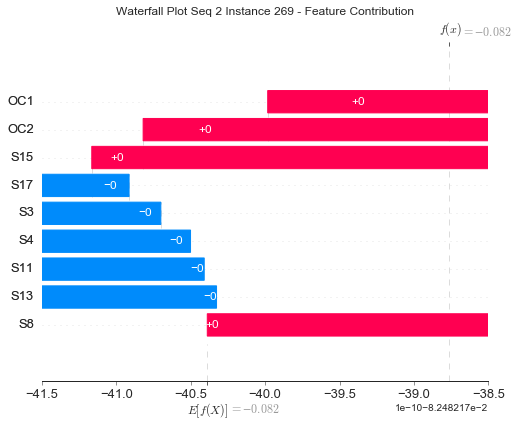

None

Contribution: [ 9.79324746e-11  1.11926080e-10 -1.47738488e-11 -3.09773908e-11
 -1.80206924e-13 -1.27629018e-11 -3.19770062e-13 -2.13462668e-11
 -9.51397728e-12]


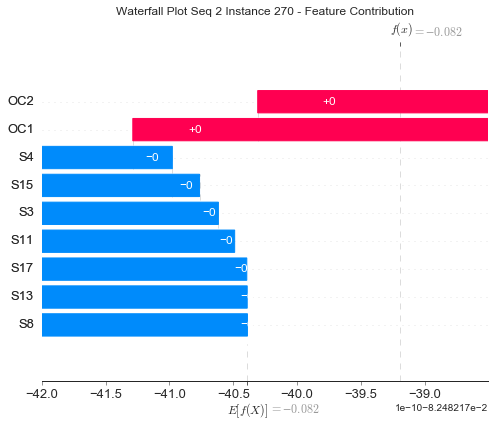

None

Contribution: [ 2.13565540e-10  1.94785008e-10 -5.28733550e-11 -7.64844021e-11
  5.60300244e-11 -9.60520344e-11 -7.32142905e-12  3.00663140e-11
 -5.30288487e-11]


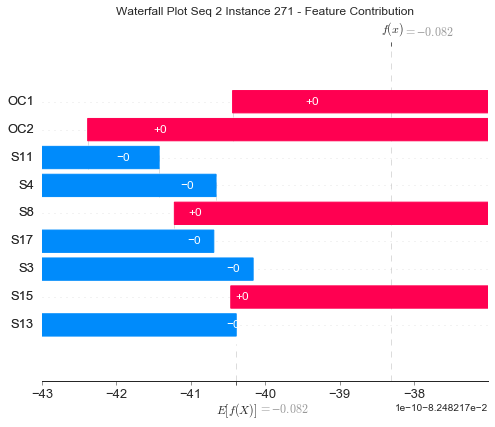

None

Contribution: [ 1.18528160e-10  1.82861309e-10 -1.61015645e-11 -7.81070000e-11
  5.29002189e-11 -4.10368996e-11  4.99696335e-12 -1.41336096e-10
 -4.02833582e-12]


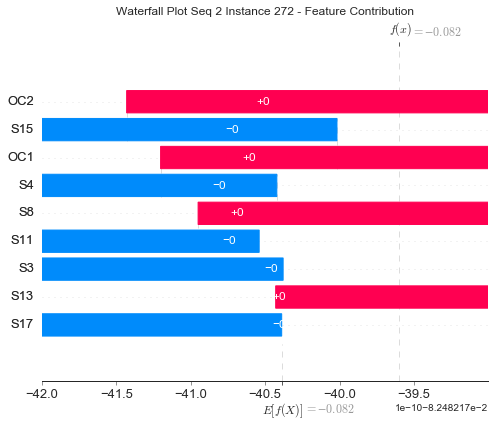

None

Contribution: [ 2.24756408e-10  2.81090234e-10 -5.99071695e-11 -1.19787250e-10
  7.63279995e-11 -1.35377265e-10 -3.91233617e-12 -2.14985918e-10
 -4.08040268e-11]


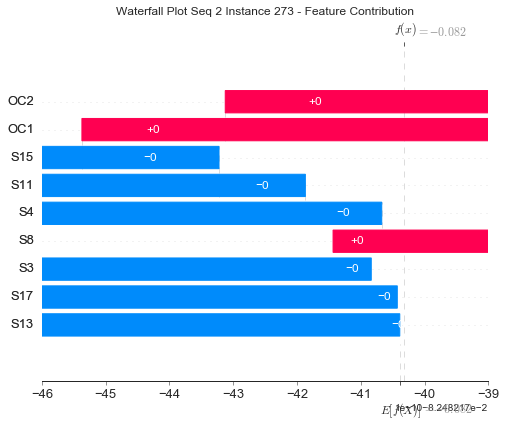

None

Contribution: [ 2.38613074e-10  3.32027655e-10 -7.99538213e-11 -1.89980573e-10
  1.05224732e-10 -2.12174639e-10  6.34255994e-13 -2.21316326e-10
 -6.08025852e-11]


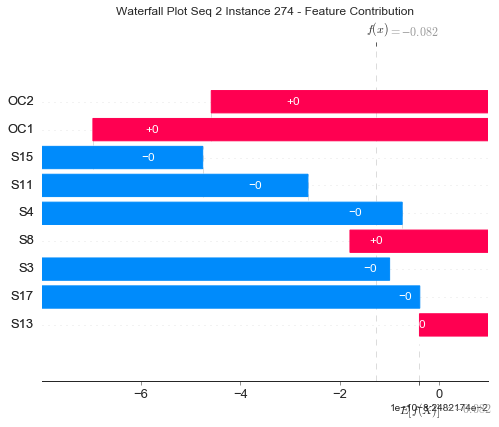

None

Contribution: [ 6.89752699e-11  1.35858505e-10  2.27077714e-11 -2.75599599e-10
  3.15139165e-10 -2.38152303e-10  7.25304677e-11 -3.08626819e-10
  1.26799377e-10]


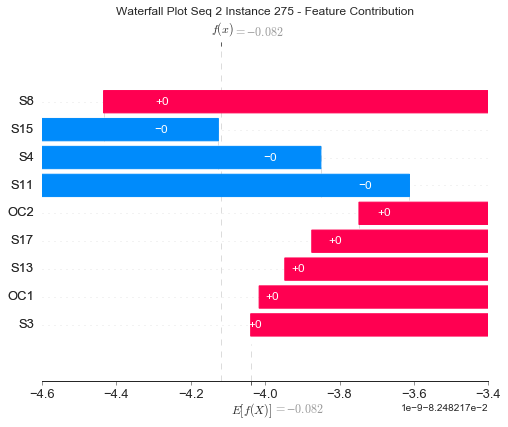

None

Contribution: [ 3.17999904e-10  4.70765482e-10 -8.34942115e-11 -2.10393647e-10
  1.51193849e-10 -2.43926684e-10  4.42987799e-11 -4.31836594e-10
 -5.79241828e-11]


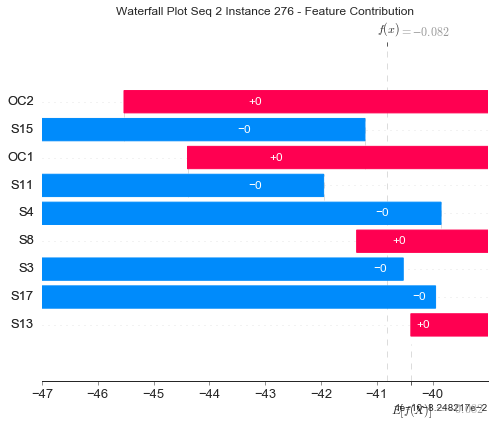

None

Contribution: [ 9.12903017e-11  1.10187713e-10  8.94033944e-11 -5.03219244e-10
  6.94638680e-10 -4.23452468e-10  2.11942242e-10 -2.97587580e-11
  3.38512773e-10]


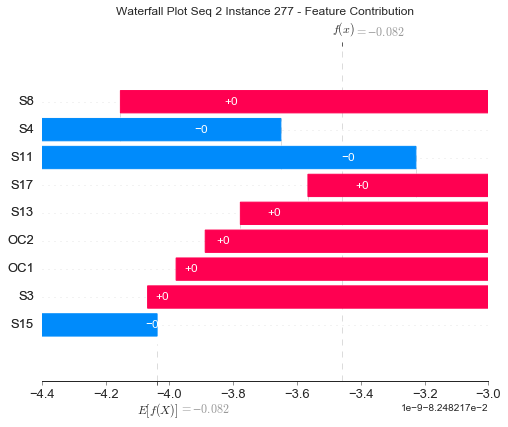

None

Contribution: [ 2.26282285e-10  4.68656280e-10 -7.60321753e-12 -4.85766816e-10
  6.84006962e-10 -4.81867823e-10  1.77563700e-10 -1.64322458e-10
  1.64074143e-10]


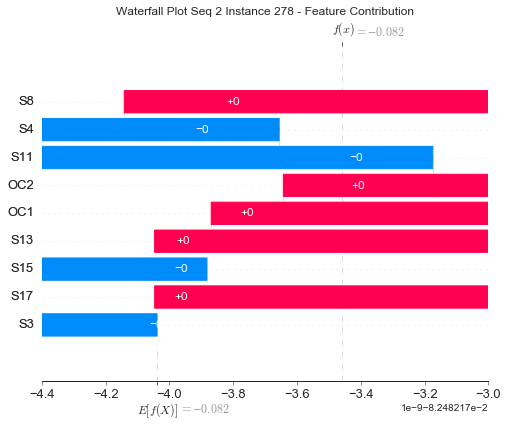

None

Contribution: [ 1.02391255e-10  3.61984109e-10 -1.90552400e-11 -4.41986781e-10
  4.11729484e-10 -2.96913188e-10  9.75343556e-11 -8.36214320e-10
  1.82636156e-10]


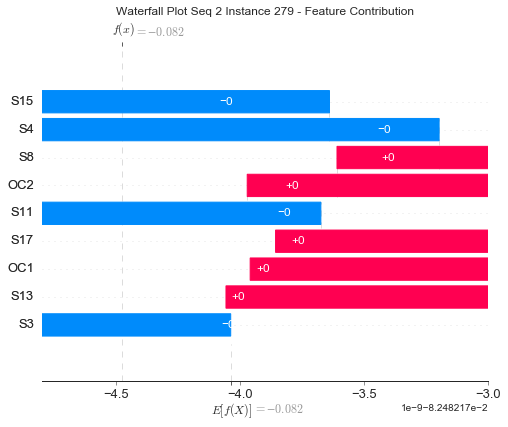

None

Contribution: [ 6.86631196e-10  7.33073269e-10 -1.17980486e-10 -8.64183392e-10
  9.42887546e-10 -1.03277409e-09  2.00417086e-10 -1.29516384e-10
  1.84021923e-10]


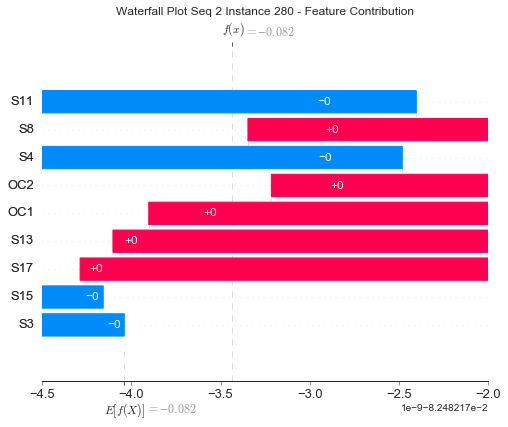

None

Contribution: [ 7.52117035e-10  1.29628031e-09 -2.91909302e-10 -7.03422098e-10
  8.63805472e-10 -1.10192422e-09  1.69580558e-10 -3.60804470e-10
 -1.02682293e-10]


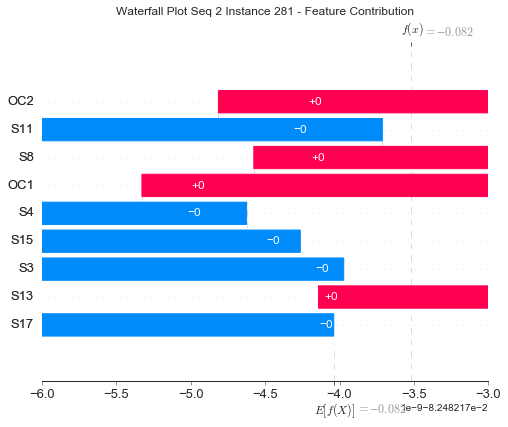

None

Contribution: [ 6.78198997e-10  1.42475209e-09 -2.53558730e-10 -9.38002120e-10
  1.23817234e-09 -1.34525380e-09  2.08597820e-10 -4.84662810e-10
  3.08018645e-11]


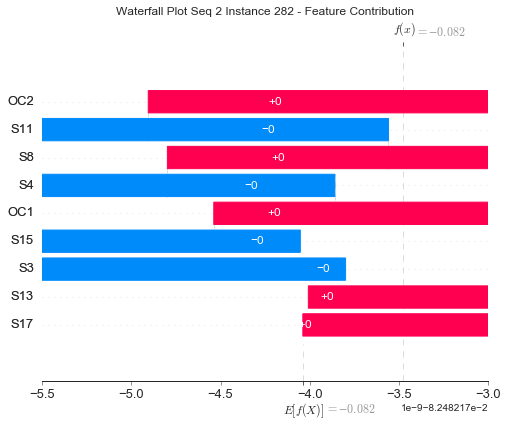

None

Contribution: [ 1.78779380e-10  9.96827176e-10 -1.71503145e-10 -7.37023109e-10
  4.73835471e-10 -7.38179018e-10  1.04300457e-10 -2.30299868e-09
  8.84834046e-12]


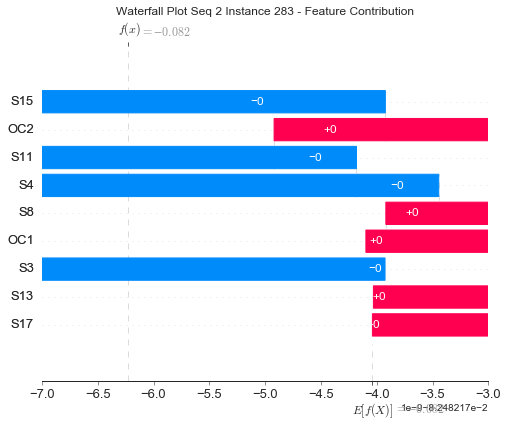

None

Contribution: [ 1.07247551e-10  9.75268755e-10 -1.71762410e-10 -5.31134081e-10
  3.13379032e-12 -3.23740257e-10 -6.97271180e-13 -3.09075254e-09
 -1.11649988e-10]


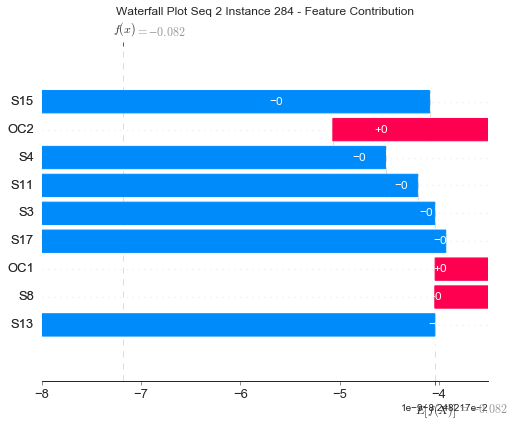

None

Contribution: [-5.16850833e-11  3.41705886e-10  8.26104671e-11 -1.58386604e-09
  1.90322846e-09 -1.84847648e-09  6.10829221e-10 -3.56124991e-10
  7.38716088e-10]


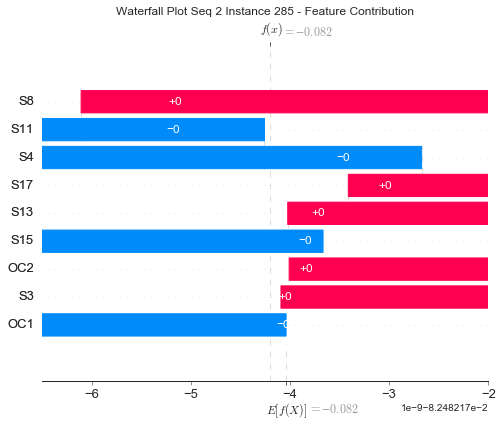

None

Contribution: [-1.29679975e-10  3.85646931e-10 -4.46462312e-11 -1.43122514e-09
  1.54077606e-09 -1.73920756e-09  4.08715450e-10 -5.60798907e-10
  4.66847949e-10]


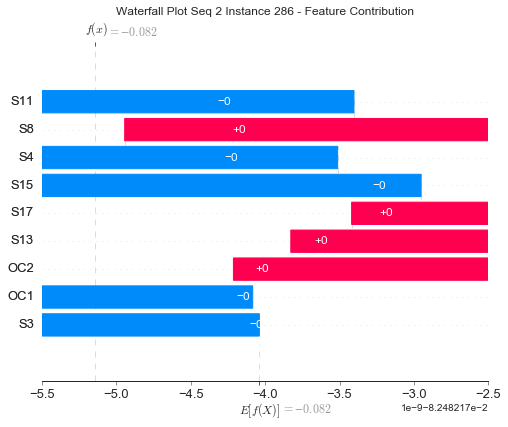

None

Contribution: [-8.26837765e-11  9.06450748e-11  1.16572325e-11 -1.72313874e-09
  1.62193525e-09 -1.80332638e-09  3.86882582e-10 -3.82564036e-10
  6.98709979e-10]


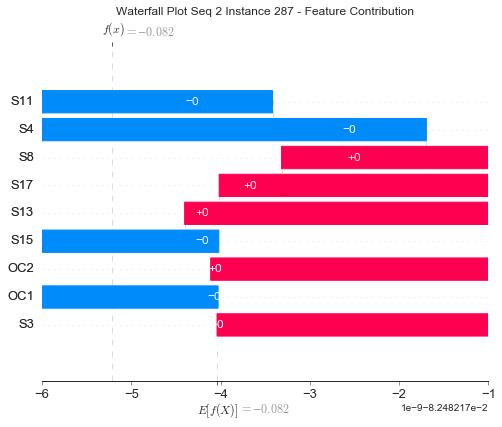

None

Contribution: [-1.01086250e-10  7.61952057e-10 -1.80629706e-10 -9.39077482e-10
  1.01866671e-09 -1.20454458e-09  2.78188056e-10 -8.49779525e-10
  1.25378929e-10]


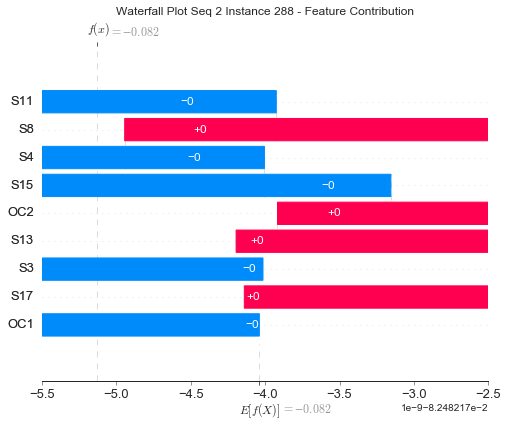

None

Contribution: [-1.79281381e-10  5.65982927e-10 -9.10280358e-12 -9.79309300e-10
  9.80066028e-10 -9.01512587e-10  3.56990187e-10 -6.67391031e-10
  4.08700462e-10]


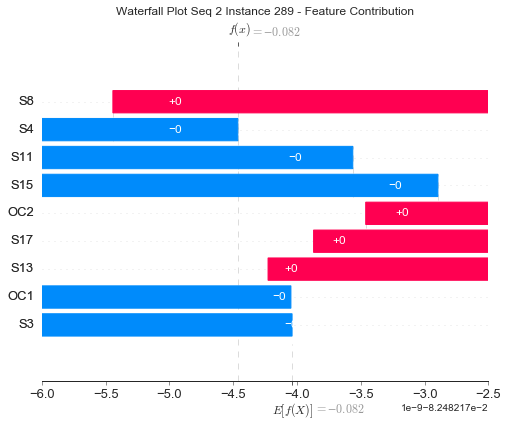

None

Contribution: [ 1.99671474e-10  4.96761965e-10  1.94397498e-10 -1.02417885e-09
  1.12389698e-09 -6.53849419e-10  4.79752404e-10 -1.21915034e-10
  7.25081439e-10]


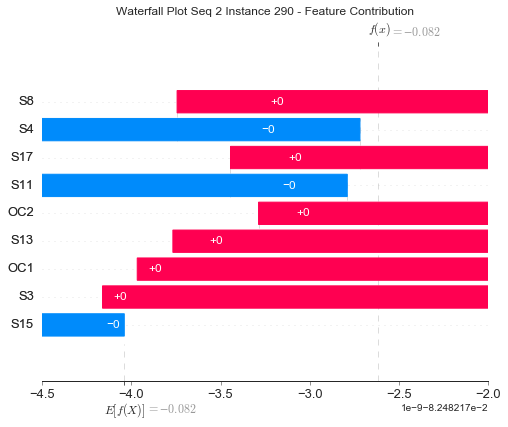

None

Contribution: [-8.13095355e-11  3.98405448e-10  2.13299475e-10 -8.28041025e-10
  1.05475761e-09 -2.47003751e-10  4.73739492e-10 -3.91924104e-10
  6.25492269e-10]


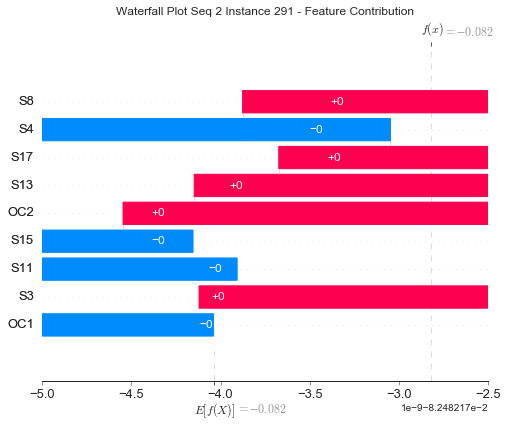

None

Contribution: [ 1.04661346e-09  1.15697285e-09 -1.26545247e-10 -6.85887735e-10
  1.26140431e-10 -4.41837511e-10  1.14236426e-10 -5.10402831e-10
  2.06438255e-10]


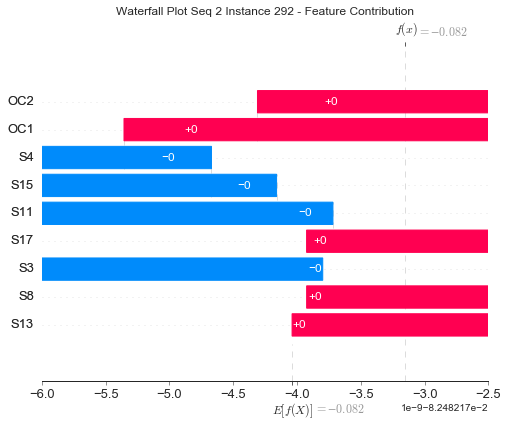

None

Contribution: [ 2.62894484e-09  2.29589370e-09 -5.48369350e-10 -1.46471546e-09
  1.27285438e-09 -1.91032656e-09  2.86910357e-10  1.19986465e-10
 -2.92261937e-10]


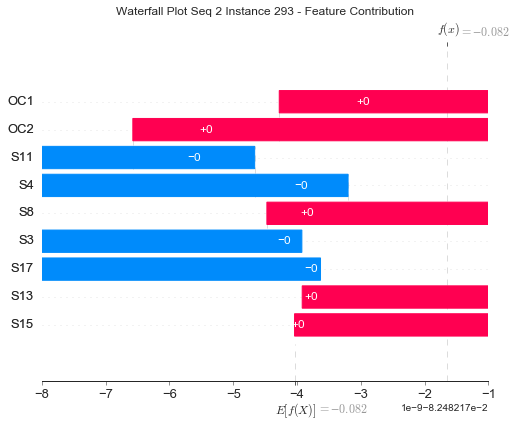

None

Contribution: [-1.01858827e-10 -2.07763806e-10  6.54534829e-11 -6.80113301e-12
 -1.65447864e-10  3.86739585e-10  4.08604470e-11 -7.39328182e-11
  4.21233354e-10]


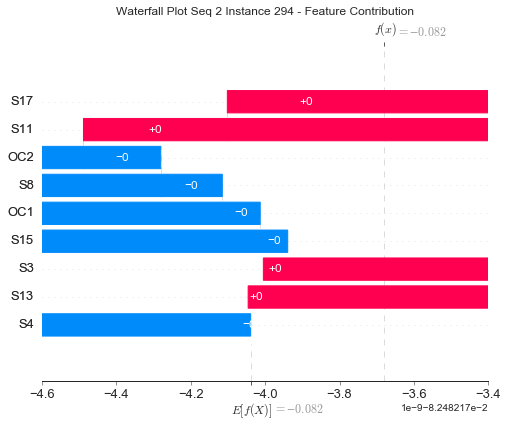

None

Contribution: [ 9.77400720e-15  0.00000000e+00  3.20508203e-10  5.47432266e-10
 -7.03320513e-10  1.33457856e-09 -1.33889566e-10  5.22045775e-11
  5.87793425e-10]


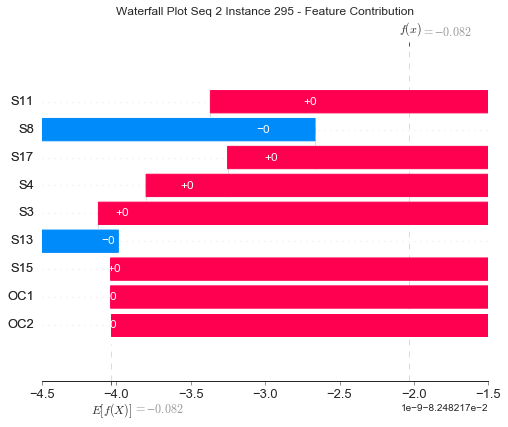

None

Contribution: [ 1.14906717e-09  3.34737432e-10 -1.26795047e-10 -1.85132187e-10
 -3.24683086e-10  3.66869757e-10 -2.19146312e-10  4.77067996e-10
  6.32701114e-11]


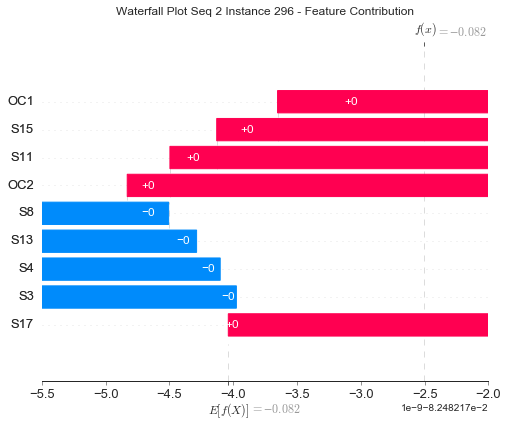

None

Contribution: [ 4.90566450e-14  3.47845288e-13  5.14676690e-10  1.25448254e-11
  3.33445875e-11  9.56281609e-10 -1.33286965e-10  7.88945020e-11
  1.26029465e-09]


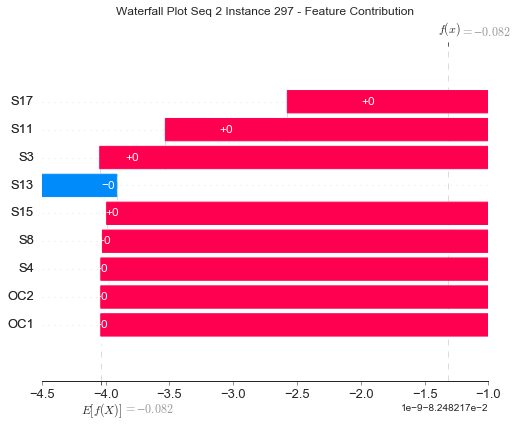

None

Contribution: [ 1.06859022e-09  1.66393843e-09 -7.48277218e-10 -1.62999891e-09
  6.57410737e-10 -2.28176833e-09 -8.74790795e-10 -3.55616758e-10
 -3.98084427e-10]


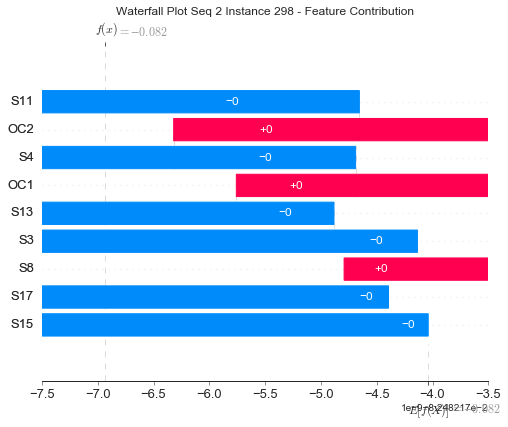

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


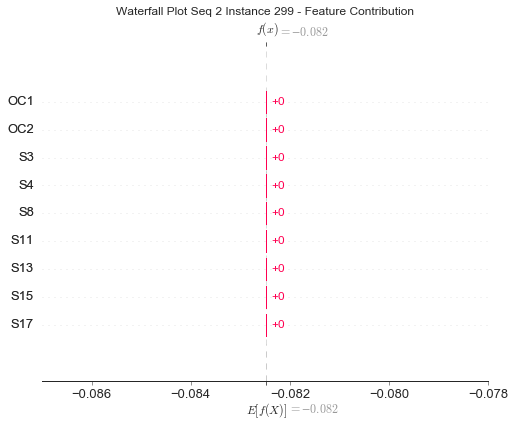

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


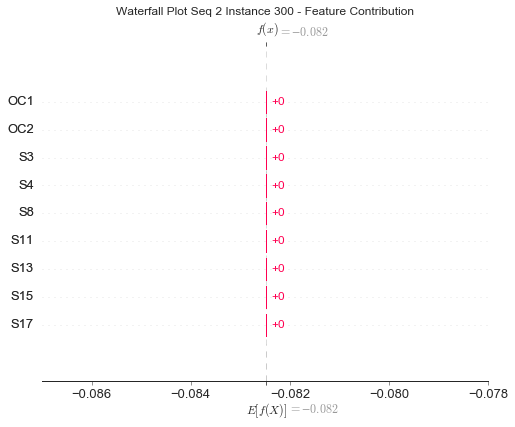

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


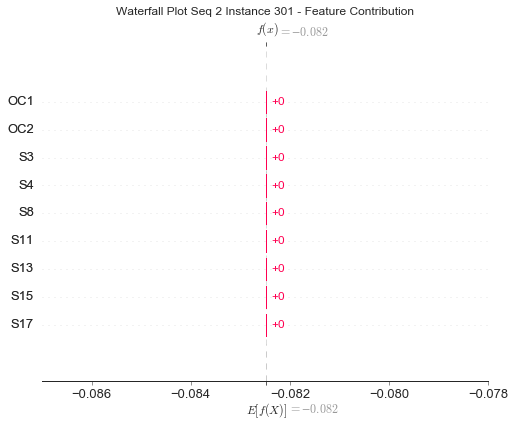

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


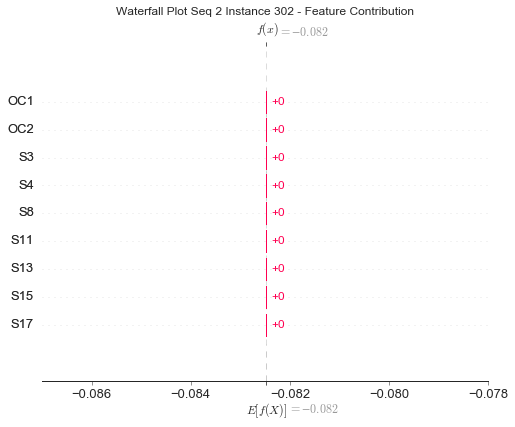

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


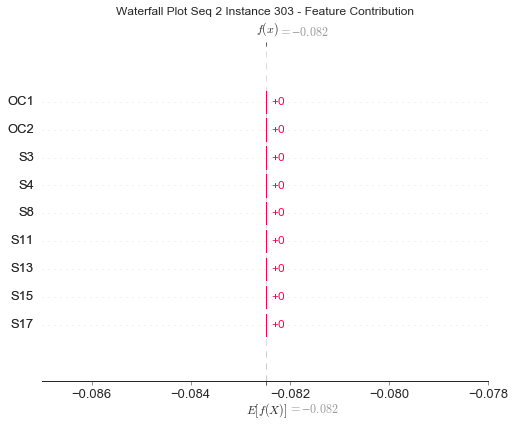

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


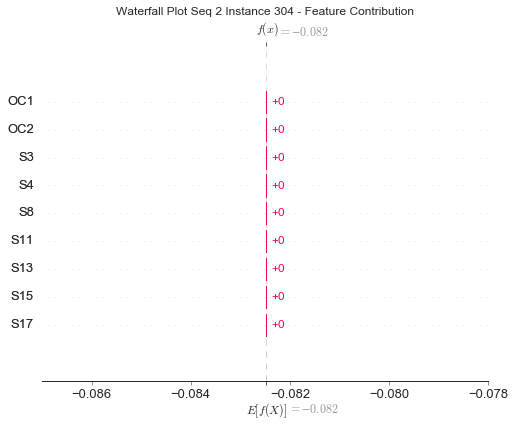

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


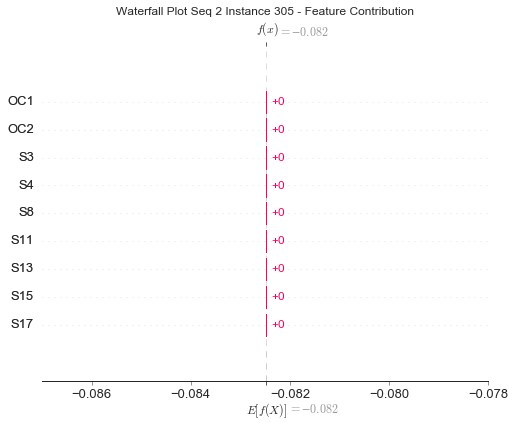

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


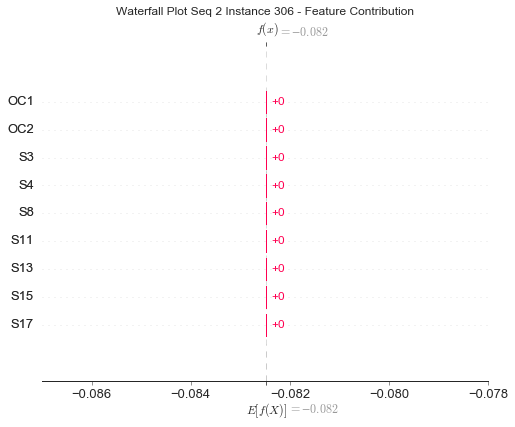

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


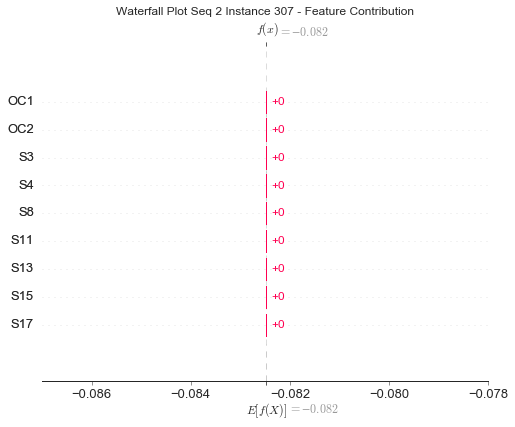

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


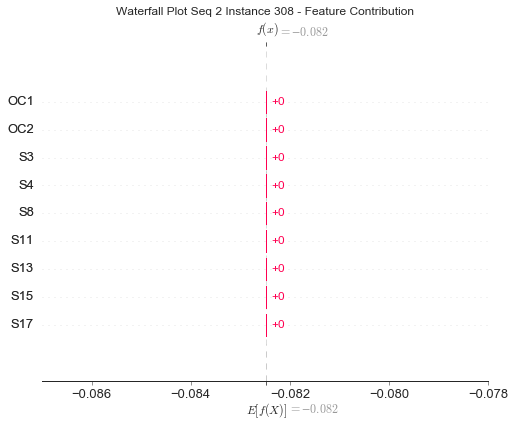

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


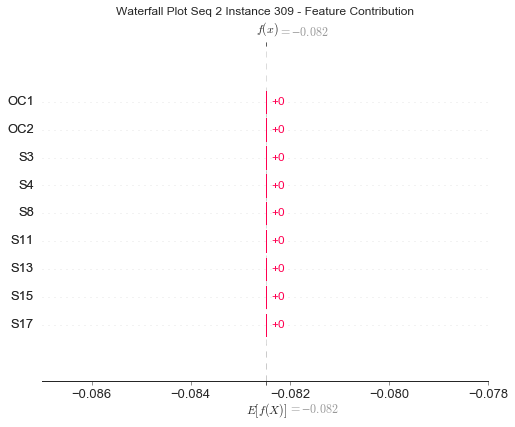

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


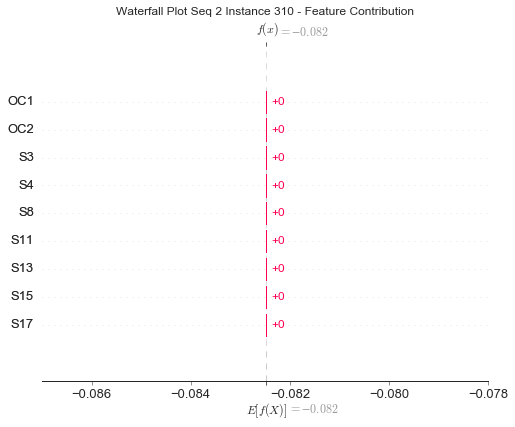

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


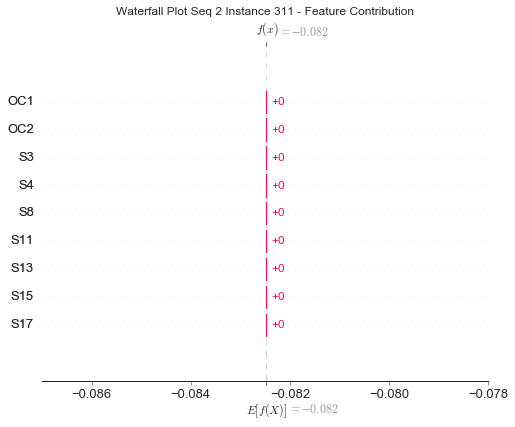

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


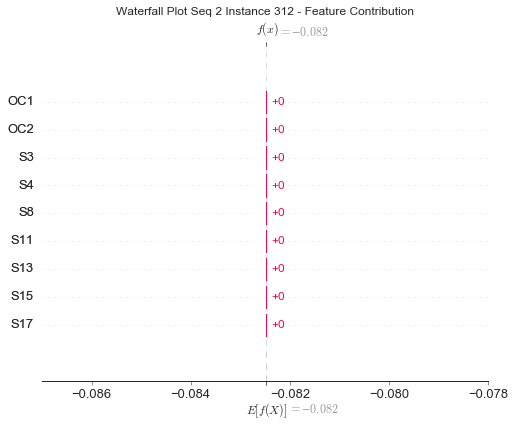

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


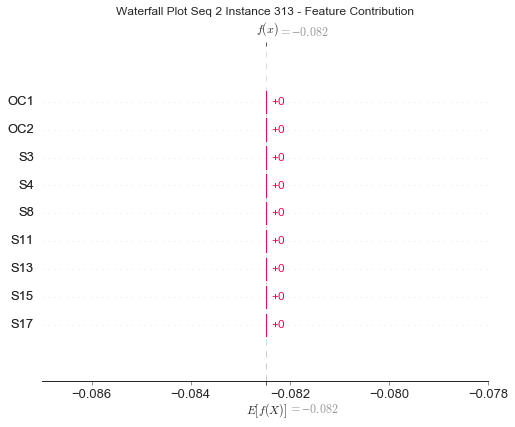

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


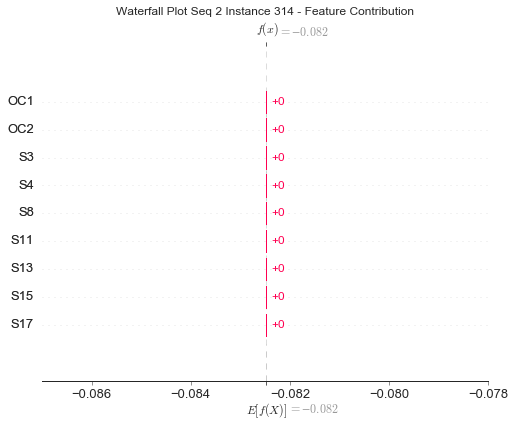

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


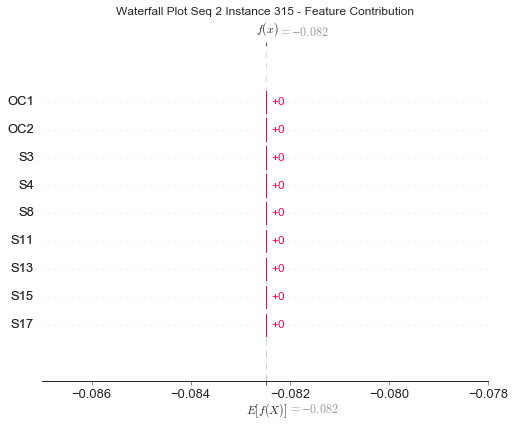

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


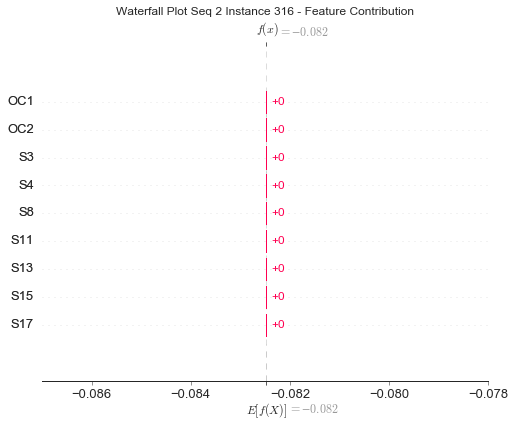

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


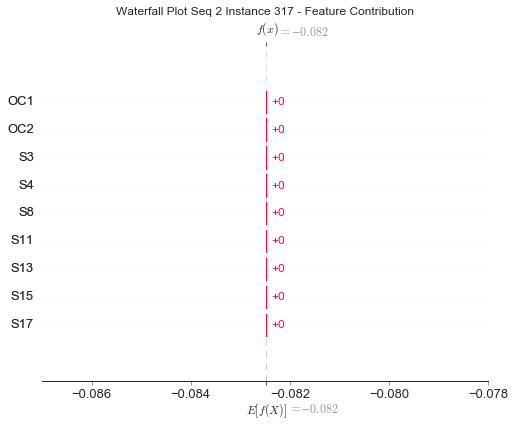

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


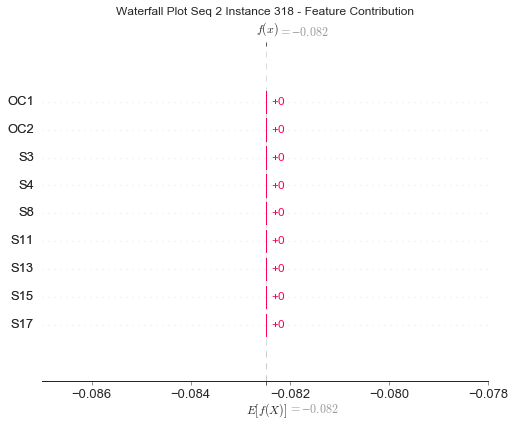

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


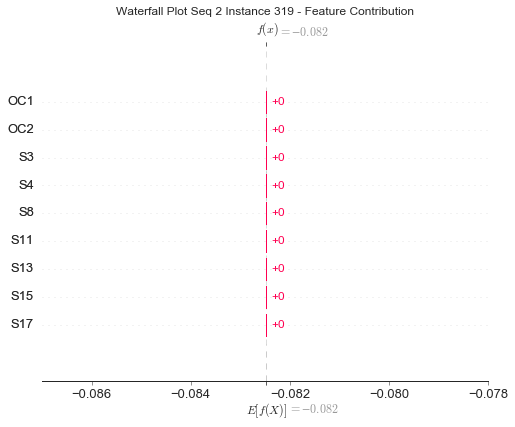

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


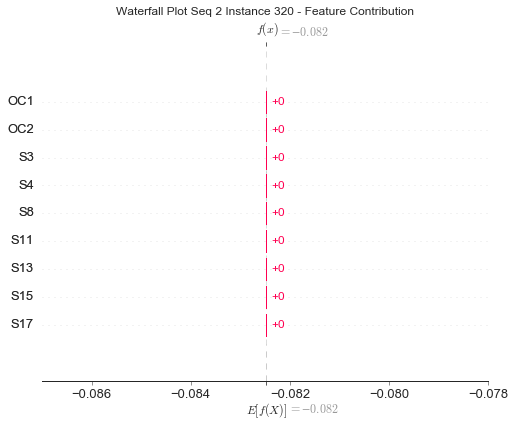

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


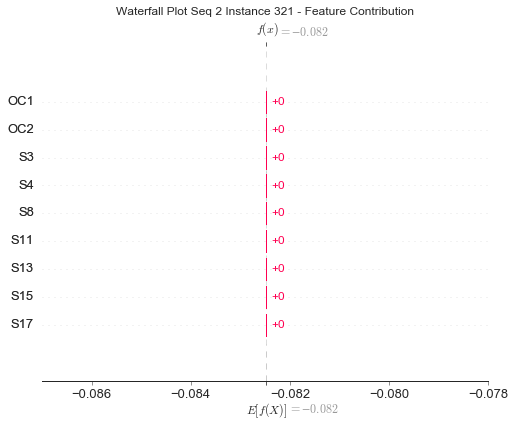

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


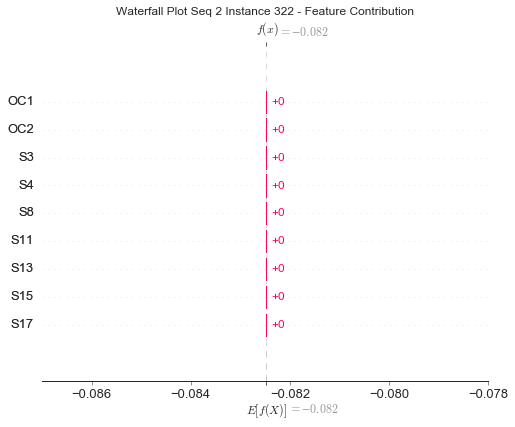

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


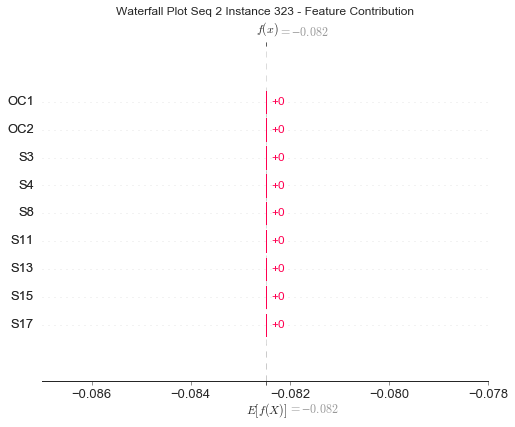

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


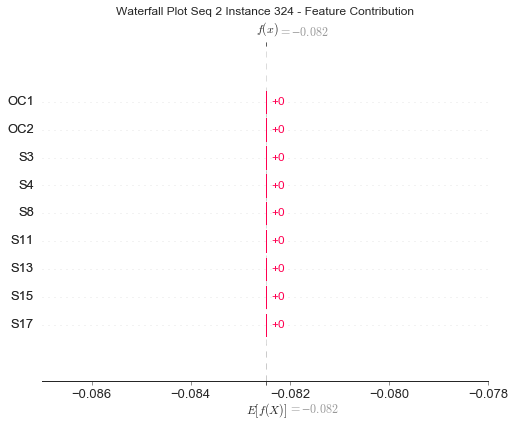

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


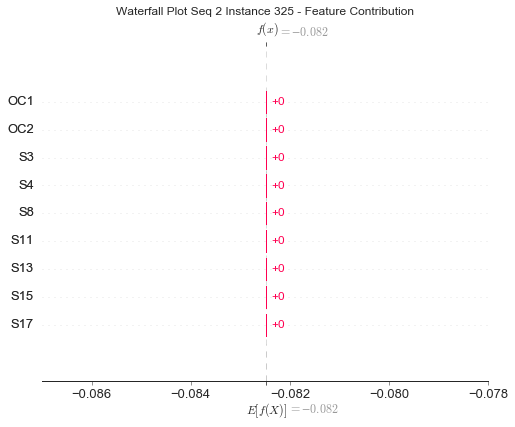

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


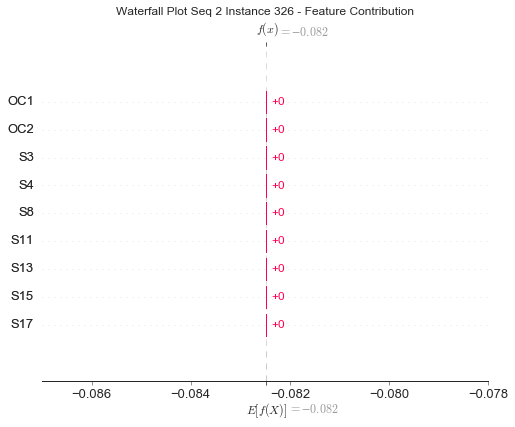

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


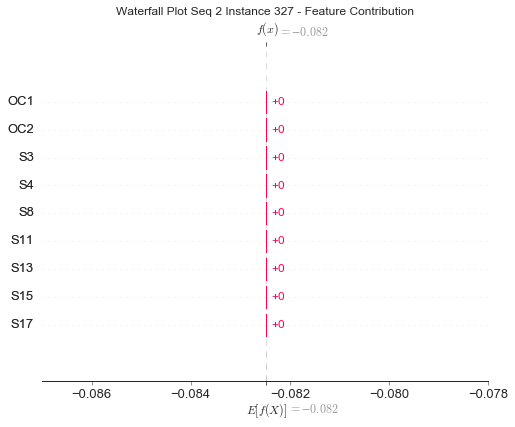

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


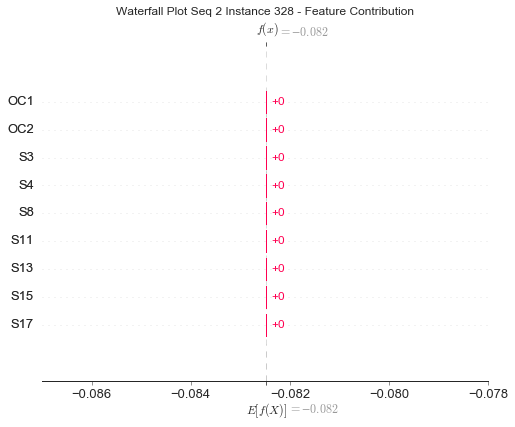

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


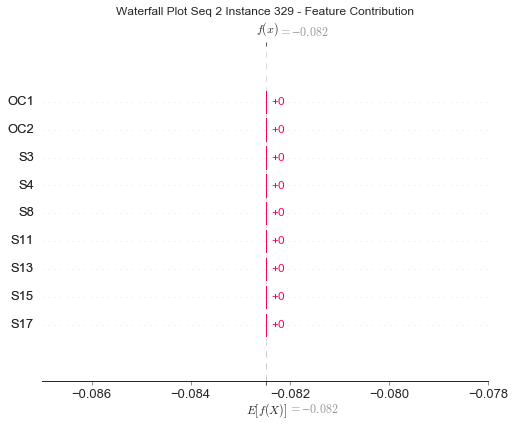

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


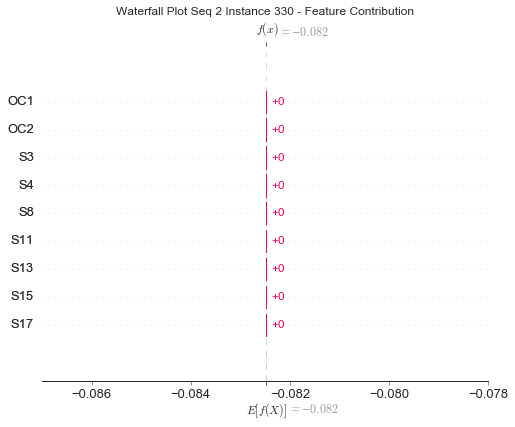

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


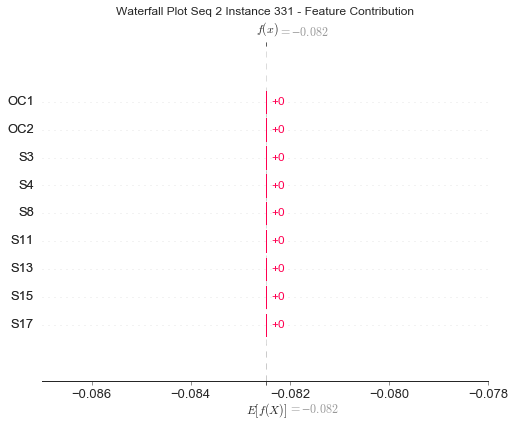

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


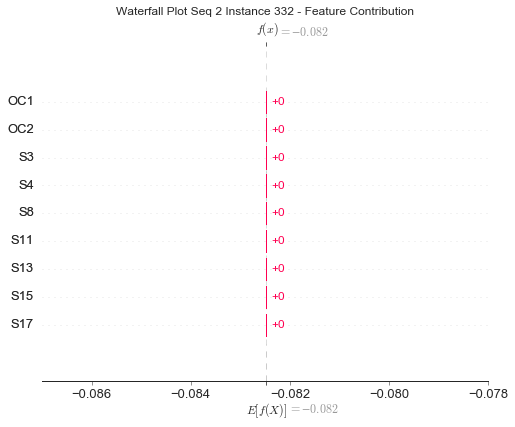

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


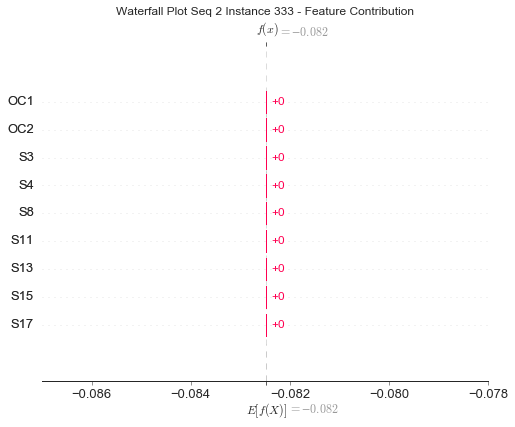

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


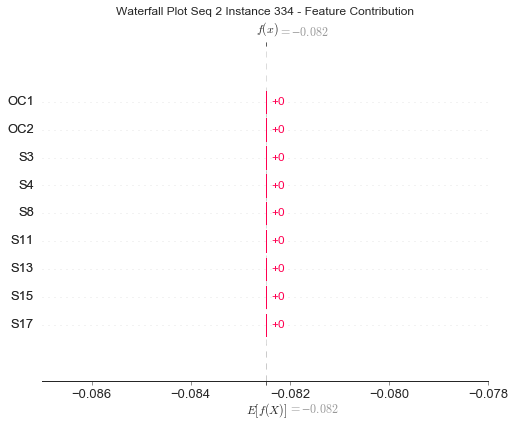

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


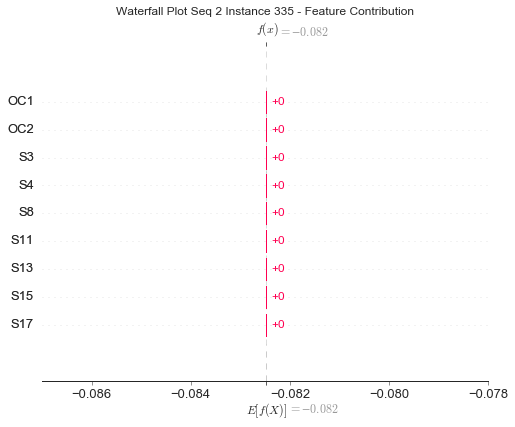

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


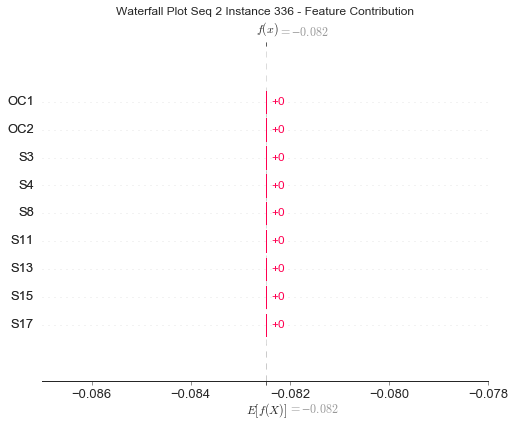

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


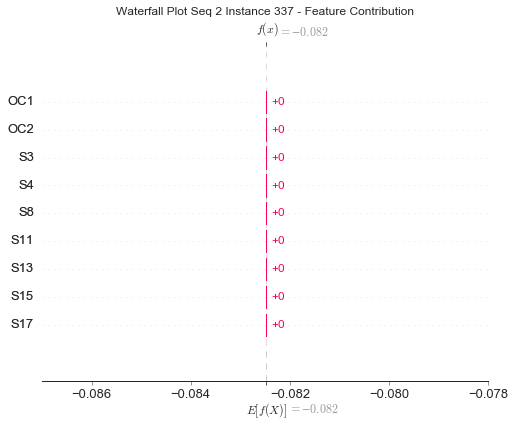

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


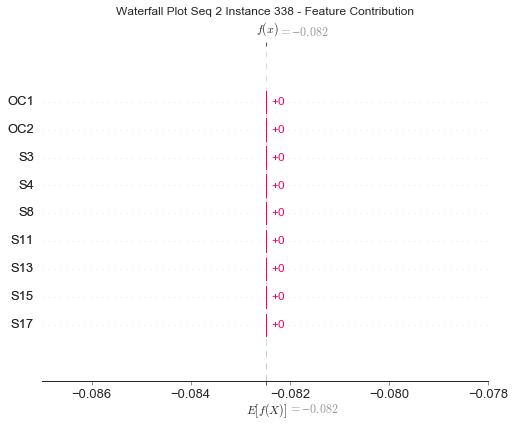

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


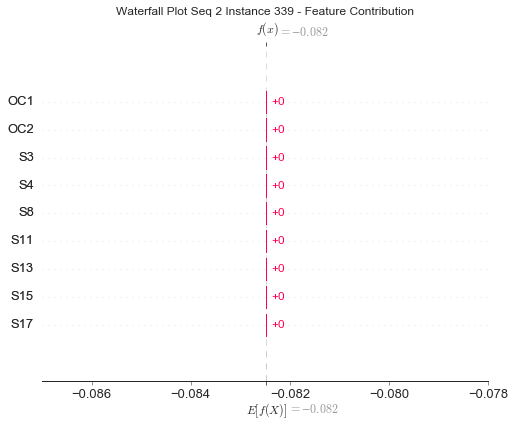

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


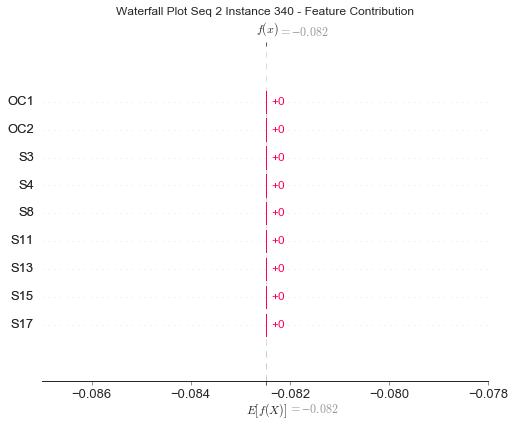

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


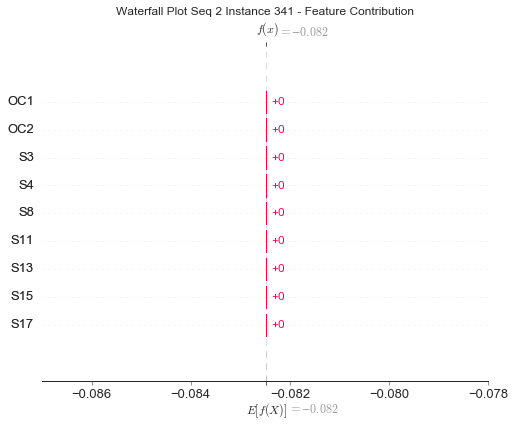

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


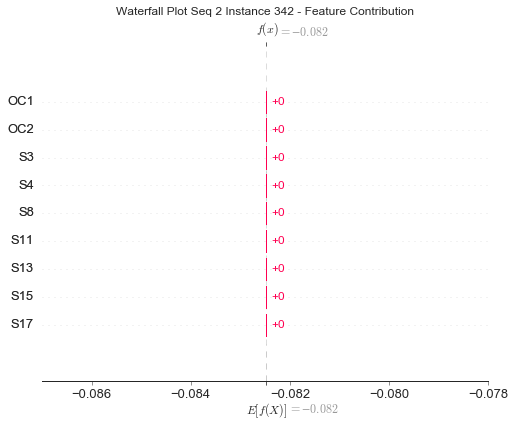

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


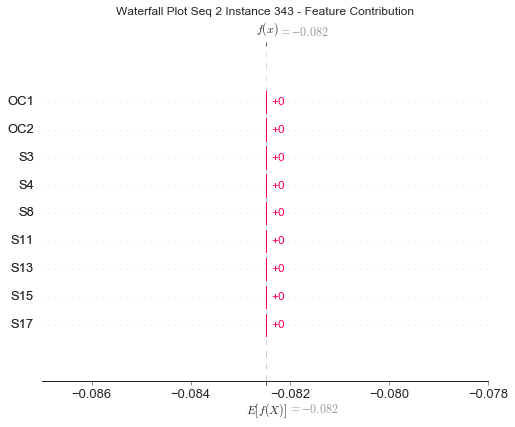

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


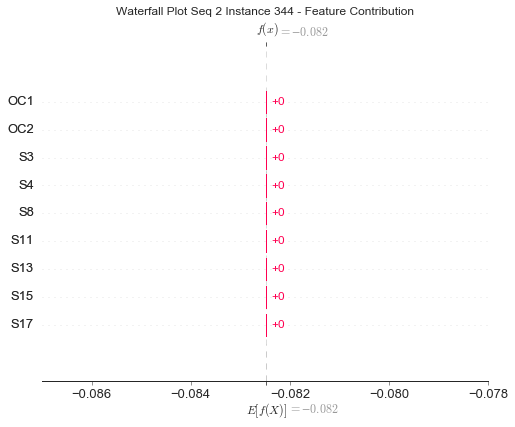

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


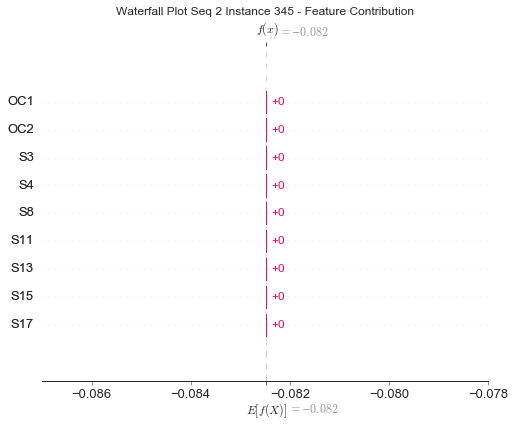

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


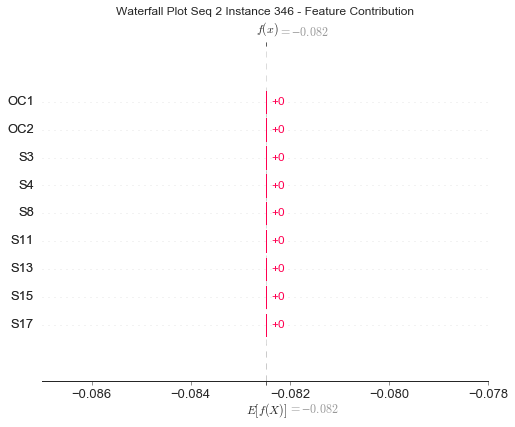

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


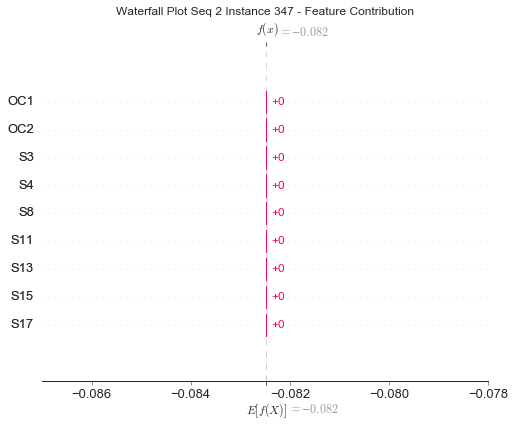

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


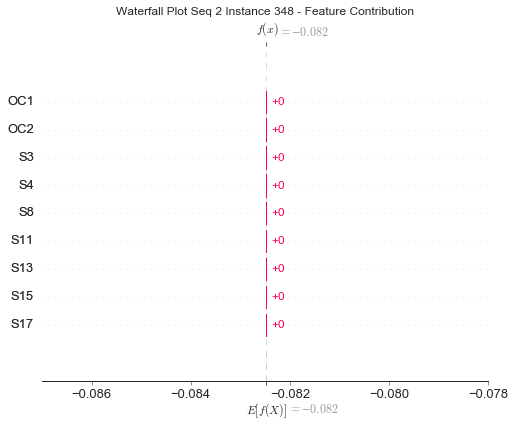

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


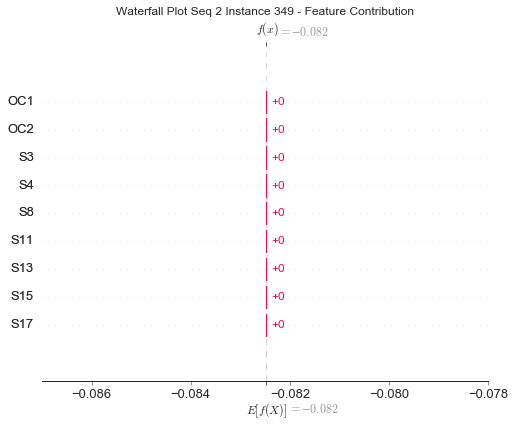

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


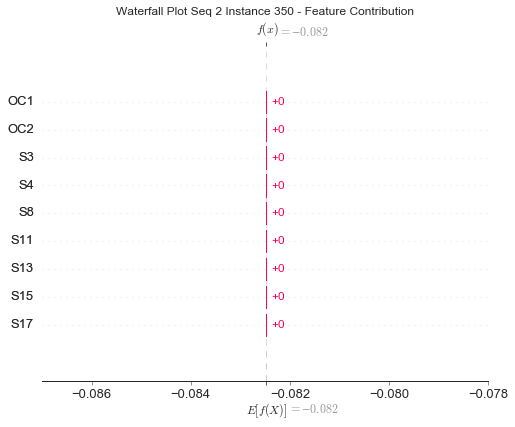

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


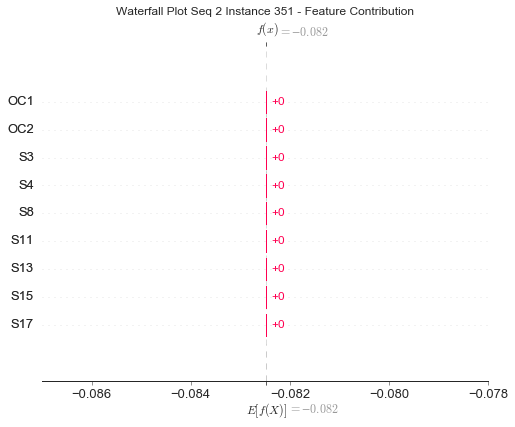

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


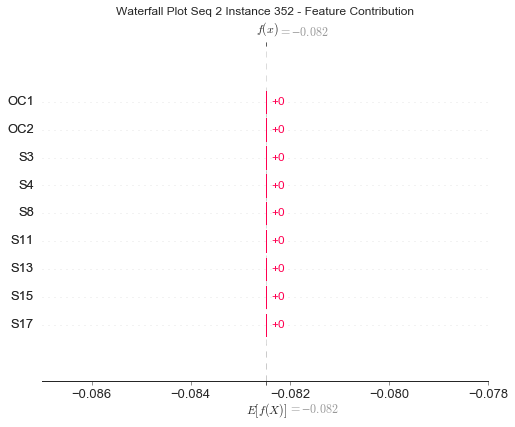

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


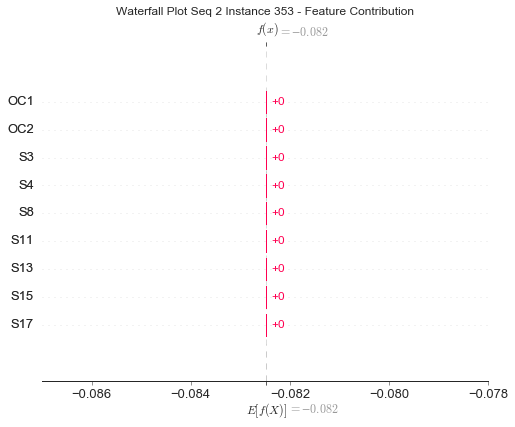

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


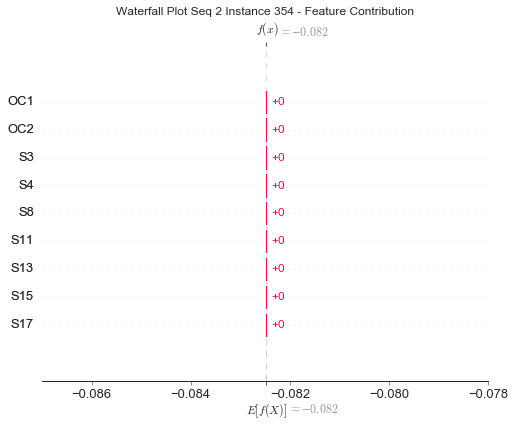

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


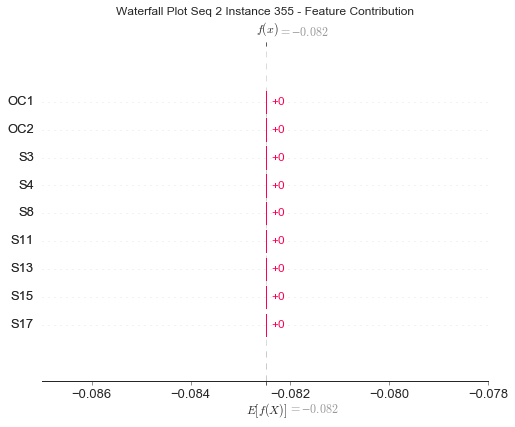

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


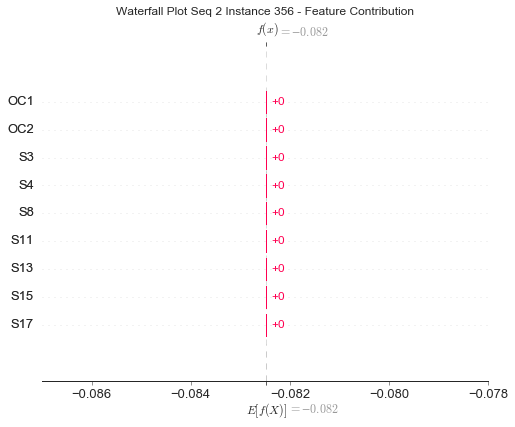

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


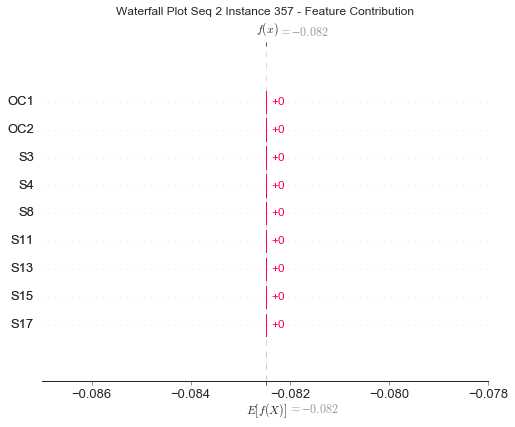

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


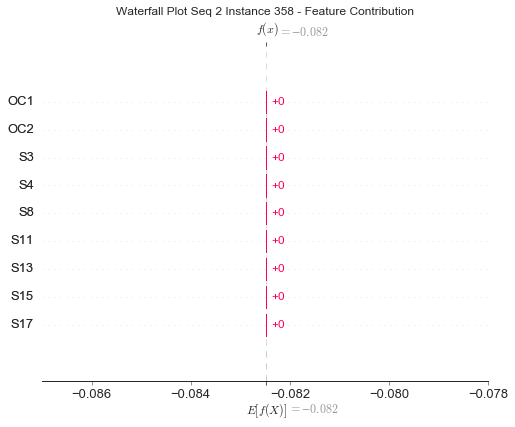

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


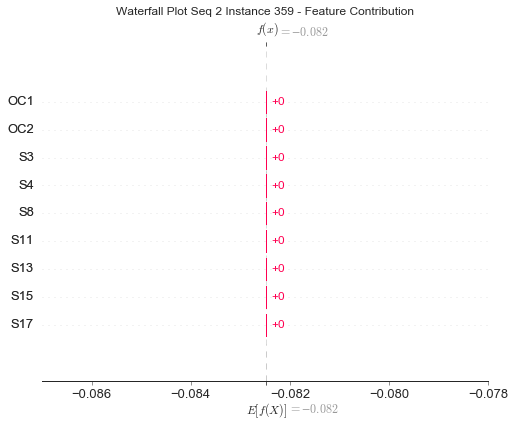

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


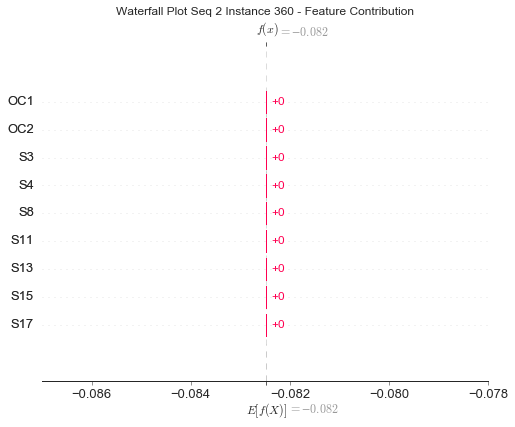

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


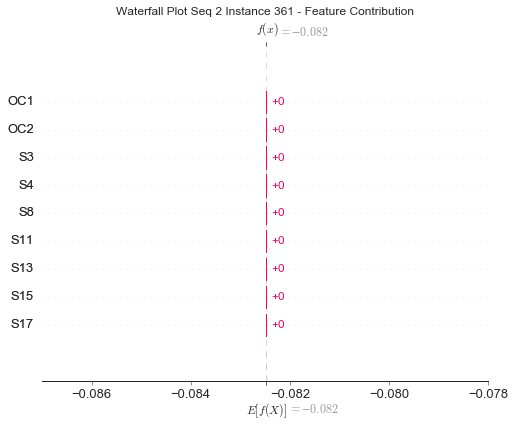

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


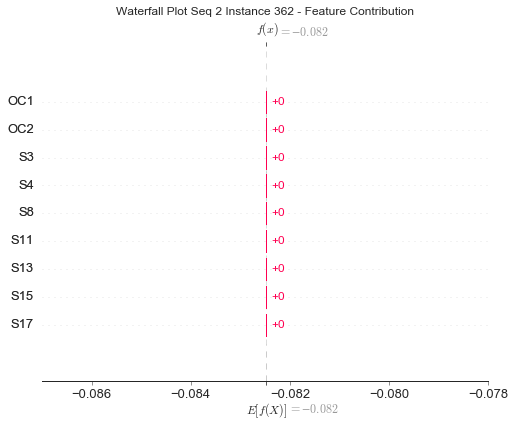

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


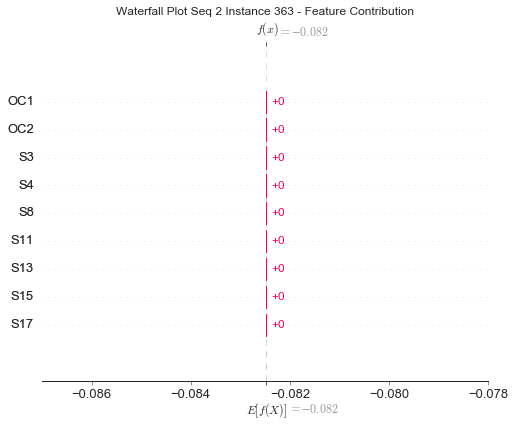

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


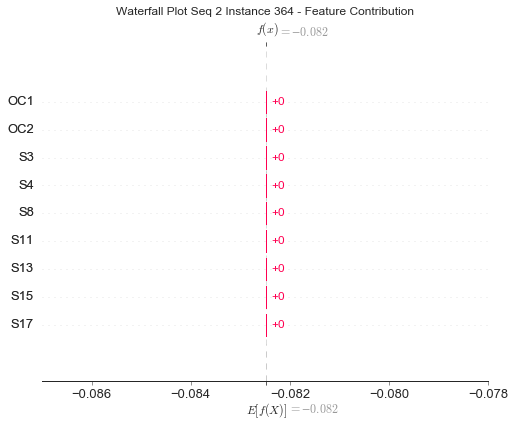

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


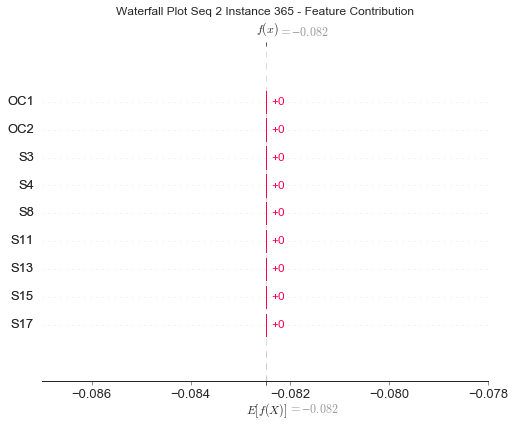

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


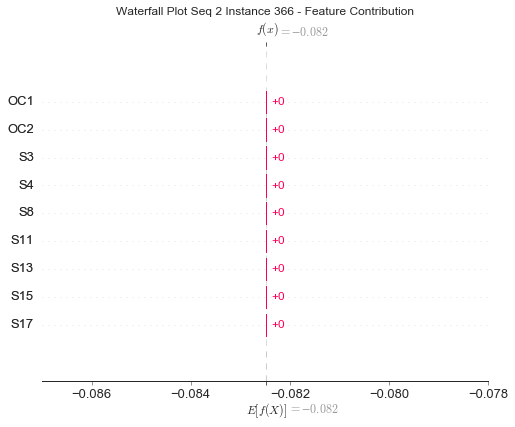

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


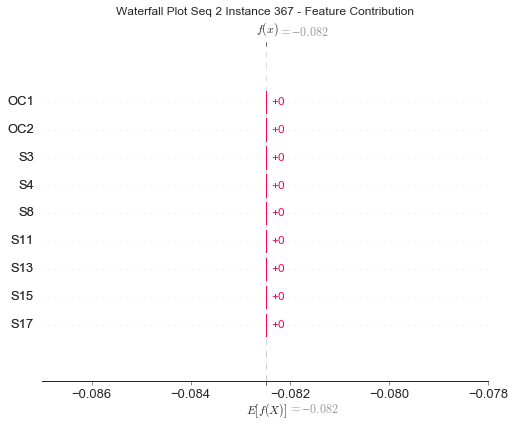

None

<Figure size 432x288 with 0 Axes>

In [57]:
#Waterfall Plot Fleet 2

for s in range(1,2):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(pad):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)
        plt.savefig("Waterfall_Plot %i" %i+'.tiff')
        plt.figure